<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Imports" data-toc-modified-id="Imports-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Imports</a></span></li><li><span><a href="#Loading-and-Reading-the-data-files" data-toc-modified-id="Loading-and-Reading-the-data-files-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Loading and Reading the data files</a></span><ul class="toc-item"><li><span><a href="#Additive-STL-Decomposition-using-Seasonal_Decompose" data-toc-modified-id="Additive-STL-Decomposition-using-Seasonal_Decompose-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Additive STL Decomposition using Seasonal_Decompose</a></span></li></ul></li><li><span><a href="#For-other-time-series" data-toc-modified-id="For-other-time-series-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>For other time series</a></span><ul class="toc-item"><li><span><a href="#A2-folder---Synthetic-Time-series-data-with-inserted-outliers" data-toc-modified-id="A2-folder---Synthetic-Time-series-data-with-inserted-outliers-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>A2 folder - Synthetic Time-series data with inserted outliers</a></span><ul class="toc-item"><li><span><a href="#Standardizing-the-Time-series-and-applying" data-toc-modified-id="Standardizing-the-Time-series-and-applying-3.1.1"><span class="toc-item-num">3.1.1&nbsp;&nbsp;</span>Standardizing the Time series and applying</a></span></li><li><span><a href="#Changing-Manual-threshold-to-k-std-devs" data-toc-modified-id="Changing-Manual-threshold-to-k-std-devs-3.1.2"><span class="toc-item-num">3.1.2&nbsp;&nbsp;</span>Changing Manual threshold to k std devs</a></span></li></ul></li><li><span><a href="#A1-Folder---real-Yahoo-server-traffic-dataset" data-toc-modified-id="A1-Folder---real-Yahoo-server-traffic-dataset-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>A1 Folder - real Yahoo server traffic dataset</a></span></li><li><span><a href="#A3-Folder---Synthetic-data-with-outliers-specified" data-toc-modified-id="A3-Folder---Synthetic-data-with-outliers-specified-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>A3 Folder - Synthetic data with outliers specified</a></span></li><li><span><a href="#A4-Folder---Synthetic-data-with-outliers,-changepoints-and-seasonalities." data-toc-modified-id="A4-Folder---Synthetic-data-with-outliers,-changepoints-and-seasonalities.-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>A4 Folder - Synthetic data with outliers, changepoints and seasonalities.</a></span></li></ul></li><li><span><a href="#Extracting-useful-features-from-Time-Series" data-toc-modified-id="Extracting-useful-features-from-Time-Series-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Extracting useful features from Time-Series</a></span></li></ul></div>

# Imports

In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import os
from statsmodels.tsa.seasonal import seasonal_decompose
import glob
from datetime import datetime
from sklearn.preprocessing import StandardScaler
from math import sqrt

# Loading and Reading the data files

In [2]:
start_time = datetime.now()
all_csv = glob.glob(f'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark/**/*.csv', recursive=True)
end_time = datetime.now()
print(f'Loaded the paths of {len(all_csv)} files from disk. Took {end_time-start_time}')

Loaded the paths of 100 files from disk. Took 0:00:00.005941


In [3]:
all_csv[0]

'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark\\synthetic_1.csv'

In [4]:
all_csv[0].split("/")[5].replace('\\','').split(".")[0]

'A2Benchmarksynthetic_1'

In [5]:
df= pd.read_csv(all_csv[0])
df

,timestamp,value,is_anomaly
0,1416726000,13.894031,0
1,1416729600,33.578274,0
2,1416733200,88.933746,0
3,1416736800,125.389424,0
4,1416740400,152.962000,0
...,...,...,...
1416,1421823600,-141.419766,0
1417,1421827200,-139.657834,0
1418,1421830800,-70.550652,0
1419,1421834400,-16.857148,0


In [6]:
df.describe()

,timestamp,value,is_anomaly
count,1.421000e+03,1421.000000,1421.000000
mean,1.419282e+09,6.368346,0.002815
std,1.477266e+06,987.768206,0.053000
min,1.416726e+09,-1421.039008,0.000000
25%,1.418004e+09,-976.854162,0.000000
50%,1.419282e+09,12.969502,0.000000
75%,1.420560e+09,989.025992,0.000000
max,1.421838e+09,1416.912543,1.000000


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1421 entries, 0 to 1420
Data columns (total 3 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   timestamp   1421 non-null   int64  
 1   value       1421 non-null   float64
 2   is_anomaly  1421 non-null   int64  
dtypes: float64(1), int64(2)
memory usage: 33.4 KB


Now we change the timestamp colump from unix seconds after epoch to a human readable date-time stamp   

In [8]:
df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')#format='%f' if formatting required upto nanoseconds

In [9]:
df

,timestamp,value,is_anomaly
0,2014-11-23 07:00:00,13.894031,0
1,2014-11-23 08:00:00,33.578274,0
2,2014-11-23 09:00:00,88.933746,0
3,2014-11-23 10:00:00,125.389424,0
4,2014-11-23 11:00:00,152.962000,0
...,...,...,...
1416,2015-01-21 07:00:00,-141.419766,0
1417,2015-01-21 08:00:00,-139.657834,0
1418,2015-01-21 09:00:00,-70.550652,0
1419,2015-01-21 10:00:00,-16.857148,0


In [10]:
df_indexed = df.set_index('timestamp')

print(df_indexed.info())


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1421 entries, 2014-11-23 07:00:00 to 2015-01-21 11:00:00
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   value       1421 non-null   float64
 1   is_anomaly  1421 non-null   int64  
dtypes: float64(1), int64(1)
memory usage: 33.3 KB
None


## Additive STL Decomposition using Seasonal_Decompose 

These series have the presence of 0 or negative values, which would make them unsuitable for multiplicative decomposition wiout some sort of preprocessing or normalization.

In [11]:
# Additive Decomposition
result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')

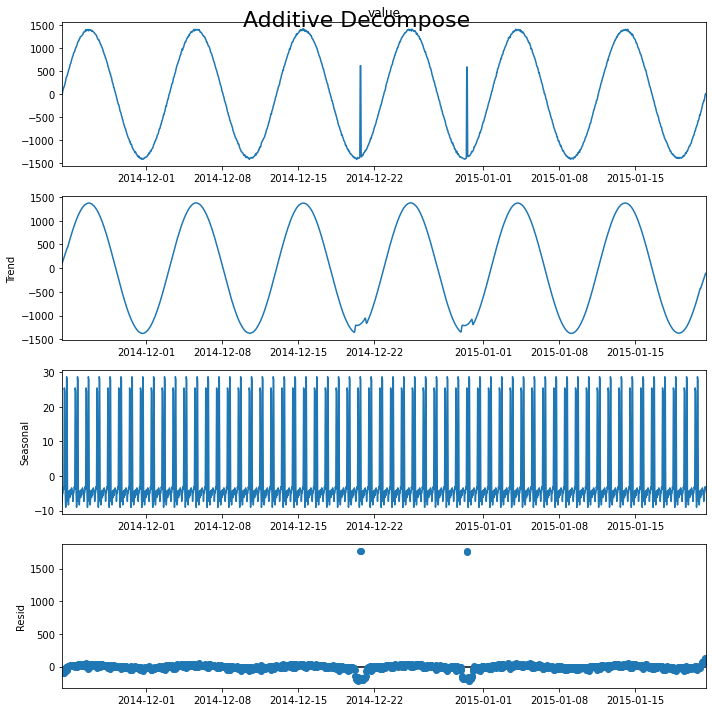

In [12]:
# Plot
plt.rcParams.update({'figure.figsize': (10,10)})
#result_mul.plot().suptitle('Multiplicative Decompose', fontsize=22)
result_add.plot().suptitle('Additive Decompose', fontsize=22)
plt.show()

In [13]:
threshold=500
residualdf = result_add.resid
outliers = residualdf[residualdf > threshold]
print(f"File: {all_csv[0]}")
print("threshold: 500")
print("Outliers:")
print(outliers)

File: ../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A2Benchmark\synthetic_1.csv
threshold: 500
Outliers:
timestamp
2014-12-20 17:00:00    1772.222450
2014-12-20 18:00:00    1766.344219
2014-12-30 12:00:00    1760.350798
2014-12-30 13:00:00    1755.882094
Name: resid, dtype: float64


In [14]:
outliers = residualdf[residualdf > threshold]
not_outliers = residualdf[residualdf < threshold]
print(outliers,not_outliers)

timestamp
2014-12-20 17:00:00    1772.222450
2014-12-20 18:00:00    1766.344219
2014-12-30 12:00:00    1760.350798
2014-12-30 13:00:00    1755.882094
Name: resid, dtype: float64 timestamp
2014-11-23 07:00:00    -77.726068
2014-11-23 08:00:00    -89.931661
2014-11-23 09:00:00    -63.993065
2014-11-23 10:00:00    -58.757070
2014-11-23 11:00:00    -59.813391
                          ...    
2015-01-21 07:00:00     92.011122
2015-01-21 08:00:00     62.403172
2015-01-21 09:00:00    102.613431
2015-01-21 10:00:00    125.607205
2015-01-21 11:00:00    122.113068
Name: resid, Length: 1417, dtype: float64


In [15]:
anomalies = df_indexed.join(outliers,on='timestamp',how='inner')
not_anomalies = df_indexed.join(not_outliers,on='timestamp',how='inner')
print(anomalies,not_anomalies)

                          value  is_anomaly        resid
timestamp                                               
2014-12-20 17:00:00  616.412915           1  1772.222450
2014-12-20 18:00:00  616.412915           1  1766.344219
2014-12-30 12:00:00  587.893627           1  1760.350798
2014-12-30 13:00:00  587.893627           1  1755.882094                           value  is_anomaly       resid
timestamp                                              
2014-11-23 07:00:00   13.894031           0  -77.726068
2014-11-23 08:00:00   33.578274           0  -89.931661
2014-11-23 09:00:00   88.933746           0  -63.993065
2014-11-23 10:00:00  125.389424           0  -58.757070
2014-11-23 11:00:00  152.962000           0  -59.813391
...                         ...         ...         ...
2015-01-21 07:00:00 -141.419766           0   92.011122
2015-01-21 08:00:00 -139.657834           0   62.403172
2015-01-21 09:00:00  -70.550652           0  102.613431
2015-01-21 10:00:00  -16.857148           

In [16]:
p = df_indexed.loc[df_indexed['is_anomaly'] == 1]

n = df_indexed.loc[df_indexed['is_anomaly'] == 0]

In [17]:
print(p,n)

                          value  is_anomaly
timestamp                                  
2014-12-20 17:00:00  616.412915           1
2014-12-20 18:00:00  616.412915           1
2014-12-30 12:00:00  587.893627           1
2014-12-30 13:00:00  587.893627           1                           value  is_anomaly
timestamp                                  
2014-11-23 07:00:00   13.894031           0
2014-11-23 08:00:00   33.578274           0
2014-11-23 09:00:00   88.933746           0
2014-11-23 10:00:00  125.389424           0
2014-11-23 11:00:00  152.962000           0
...                         ...         ...
2015-01-21 07:00:00 -141.419766           0
2015-01-21 08:00:00 -139.657834           0
2015-01-21 09:00:00  -70.550652           0
2015-01-21 10:00:00  -16.857148           0
2015-01-21 11:00:00    7.757660           0

[1417 rows x 2 columns]


In [18]:
truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]

falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]

In [19]:
print(truepositives,falsepositives,sep="\n")

                          value  is_anomaly        resid
timestamp                                               
2014-12-20 17:00:00  616.412915           1  1772.222450
2014-12-20 18:00:00  616.412915           1  1766.344219
2014-12-30 12:00:00  587.893627           1  1760.350798
2014-12-30 13:00:00  587.893627           1  1755.882094
Empty DataFrame
Columns: [value, is_anomaly, resid]
Index: []


In [20]:
truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]

falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]

In [21]:
print(truenegatives,falsenegatives,sep="\n")

                          value  is_anomaly       resid
timestamp                                              
2014-11-23 07:00:00   13.894031           0  -77.726068
2014-11-23 08:00:00   33.578274           0  -89.931661
2014-11-23 09:00:00   88.933746           0  -63.993065
2014-11-23 10:00:00  125.389424           0  -58.757070
2014-11-23 11:00:00  152.962000           0  -59.813391
...                         ...         ...         ...
2015-01-21 07:00:00 -141.419766           0   92.011122
2015-01-21 08:00:00 -139.657834           0   62.403172
2015-01-21 09:00:00  -70.550652           0  102.613431
2015-01-21 10:00:00  -16.857148           0  125.607205
2015-01-21 11:00:00    7.757660           0  122.113068

[1417 rows x 3 columns]
Empty DataFrame
Columns: [value, is_anomaly, resid]
Index: []


In [22]:
#Traditional FPR and TPR formmulae
#tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
#fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())

#IDEAL Paper based TRP/FPR rates
fpr = len(falsepositives)/len(n)
tpr = len(truepositives)/len(p)
fnr = 1-tpr
tnr = 1-fpr

In [23]:
print(fpr,tpr,fnr,tnr,sep = "\n")

0.0
1.0
0.0
1.0


In [24]:
precision = len(truepositives)/(tpr + fpr)
recall = tpr/(tpr + fnr)

In [25]:
print(precision,recall,sep="\n")

4.0
1.0


In [26]:
f1 = 2 * ((precision * recall)/(precision + recall))

In [27]:
print(f1)

1.6


Note that the presence of negative and zero values make it such that multiplicative decomposition is not applicable for these time series.

# For other time series

Now Let's try doing this for all the other 99 time series in a loop

## A2 folder - Synthetic Time-series data with inserted outliers

Processing index: 0 of 100



A2Benchmark_A2Benchmarksynthetic_1add_STL


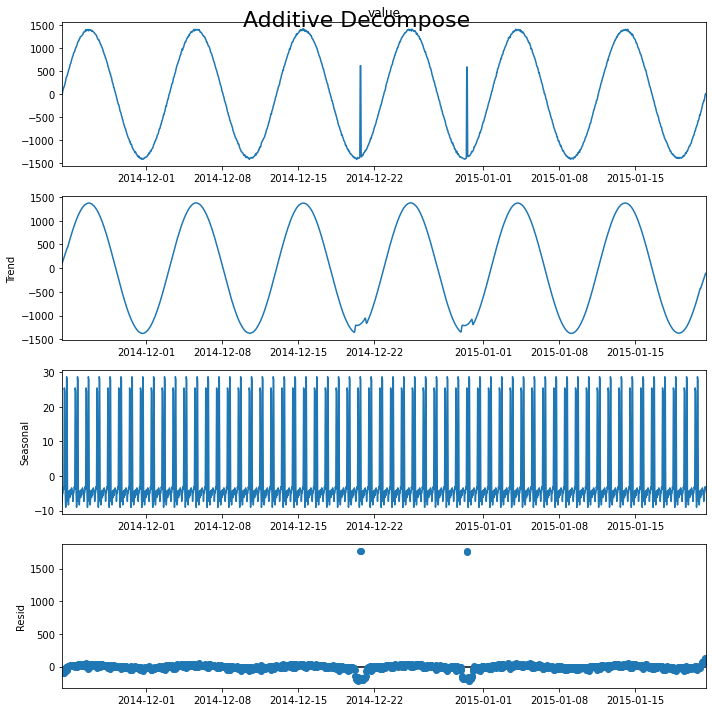



File: A2Benchmarksynthetic_1
threshold: 500
Actual Outliers: 4
                          value  is_anomaly
timestamp                                  
2014-12-20 17:00:00  616.412915           1
2014-12-20 18:00:00  616.412915           1
2014-12-30 12:00:00  587.893627           1
2014-12-30 13:00:00  587.893627           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    1772.222450
2014-12-20 18:00:00    1766.344219
2014-12-30 12:00:00    1760.350798
2014-12-30 13:00:00    1755.882094
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_10add_STL


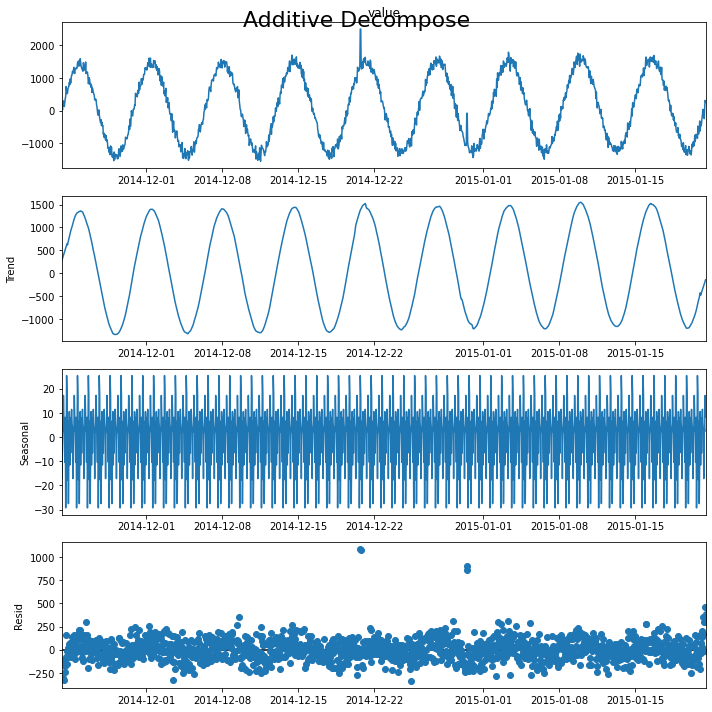



File: A2Benchmarksynthetic_10
threshold: 500
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  2490.312216           1
2014-12-20 18:00:00  2490.312216           1
2014-12-30 12:00:00   -83.613394           1
2014-12-30 13:00:00   -83.613394           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    1088.668787
2014-12-20 18:00:00    1077.463440
2014-12-30 12:00:00     861.051098
2014-12-30 13:00:00     900.266830
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_100add_STL


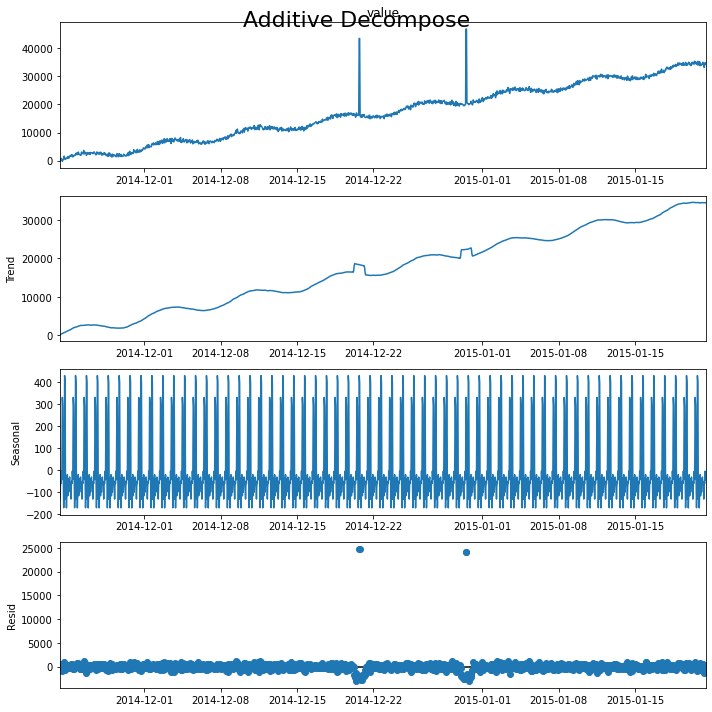



File: A2Benchmarksynthetic_100
threshold: 500
Actual Outliers: 4
                            value  is_anomaly
timestamp                                    
2014-12-20 17:00:00  43520.564531           1
2014-12-20 18:00:00  43520.564531           1
2014-12-30 12:00:00  46884.241246           1
2014-12-30 13:00:00  46884.241246           1
Detected outliers: 172
Outliers:
timestamp
2014-11-23 07:00:00     510.047397
2014-11-23 16:00:00    1023.235688
2014-11-24 09:00:00     525.001815
2014-11-24 19:00:00     564.290616
2014-11-24 21:00:00     714.436649
                          ...     
2015-01-19 22:00:00     698.636921
2015-01-20 11:00:00     888.408219
2015-01-20 14:00:00     565.266072
2015-01-20 22:00:00     825.323223
2015-01-21 05:00:00     574.096495
Name: resid, Length: 172, dtype: float64



A2Benchmark_A2Benchmarksynthetic_11add_STL


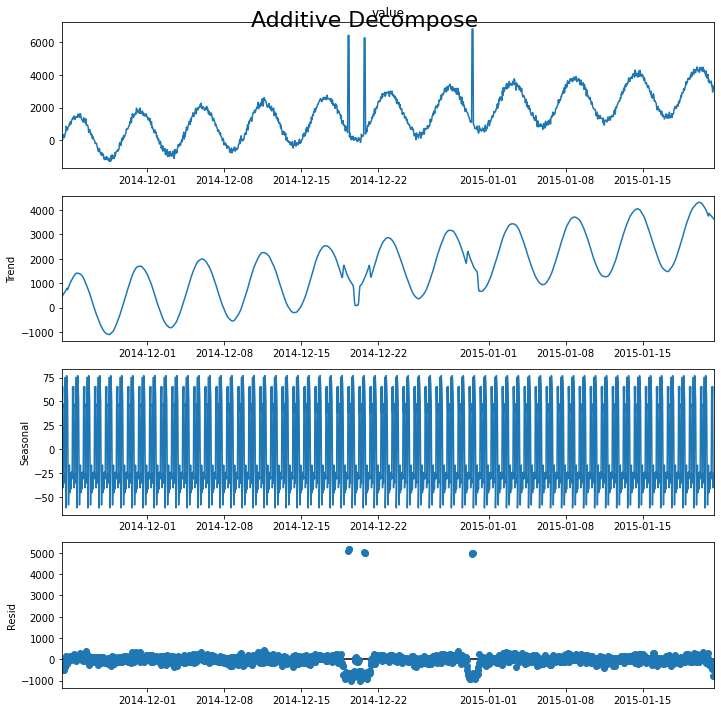



File: A2Benchmarksynthetic_11
threshold: 500
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  6424.119302           1
2014-12-19 07:00:00  6424.119302           1
2014-12-19 08:00:00  6424.119302           1
2014-12-20 17:00:00  6273.705277           1
2014-12-20 18:00:00  6273.705277           1
2014-12-20 19:00:00  6273.705277           1
2014-12-30 12:00:00  6819.510433           1
2014-12-30 13:00:00  6819.510433           1
2014-12-30 14:00:00  6819.510433           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    5097.655201
2014-12-19 07:00:00    5170.747173
2014-12-19 08:00:00    5184.493836
2014-12-20 17:00:00    5028.454984
2014-12-20 18:00:00    4999.506151
2014-12-20 19:00:00    4975.421031
2014-12-30 12:00:00    4941.587483
2014-12-30 13:00:00    4999.870276
2014-12-30 14:00:00    5013.014486
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_12add_STL


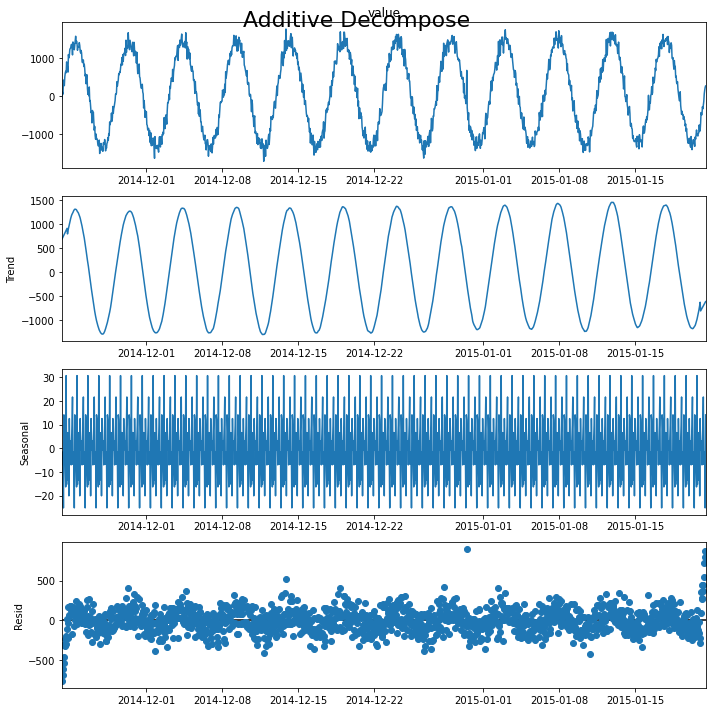



File: A2Benchmarksynthetic_12
threshold: 500
Actual Outliers: 1
                          value  is_anomaly
timestamp                                  
2014-12-30 12:00:00  670.885798           1
Detected outliers: 7
Outliers:
timestamp
2014-12-13 21:00:00    518.229909
2014-12-30 12:00:00    899.590151
2015-01-21 07:00:00    546.091961
2015-01-21 08:00:00    719.254489
2015-01-21 09:00:00    800.955609
2015-01-21 10:00:00    878.920756
2015-01-21 11:00:00    859.589505
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_13add_STL


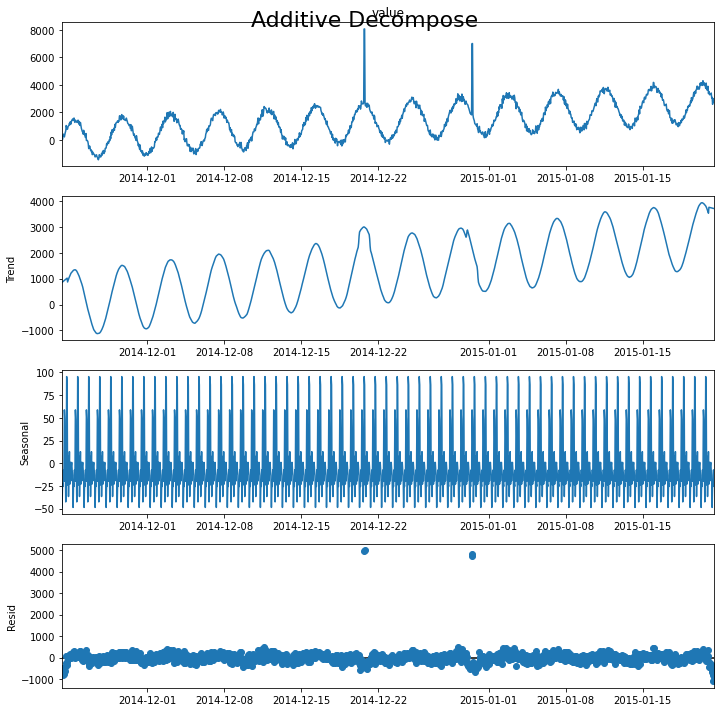



File: A2Benchmarksynthetic_13
threshold: 500
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  8056.267028           1
2014-12-20 18:00:00  8056.267028           1
2014-12-30 12:00:00  6995.828286           1
2014-12-30 13:00:00  6995.828286           1
Detected outliers: 5
Outliers:
timestamp
2014-12-20 17:00:00    4966.348775
2014-12-20 18:00:00    4986.096620
2014-12-29 05:00:00     505.866852
2014-12-30 12:00:00    4733.056532
2014-12-30 13:00:00    4821.207605
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_14add_STL


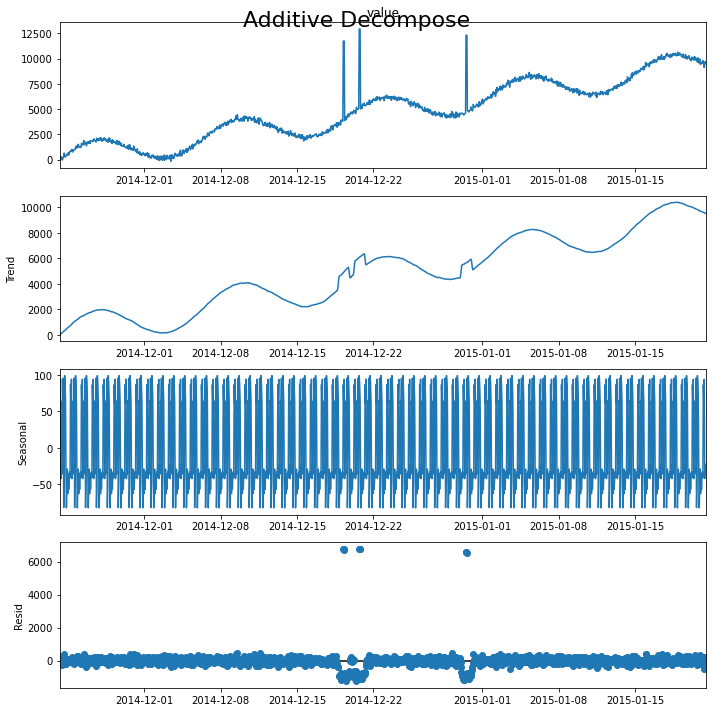



File: A2Benchmarksynthetic_14
threshold: 500
Actual Outliers: 9
                            value  is_anomaly
timestamp                                    
2014-12-19 06:00:00  11741.659149           1
2014-12-19 07:00:00  11741.659149           1
2014-12-19 08:00:00  11741.659149           1
2014-12-20 17:00:00  12933.153180           1
2014-12-20 18:00:00  12933.153180           1
2014-12-20 19:00:00  12933.153180           1
2014-12-30 12:00:00  12313.689897           1
2014-12-30 13:00:00  12313.689897           1
2014-12-30 14:00:00  12313.689897           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    6769.365597
2014-12-19 07:00:00    6762.466346
2014-12-19 08:00:00    6692.283881
2014-12-20 17:00:00    6760.127091
2014-12-20 18:00:00    6749.287440
2014-12-20 19:00:00    6749.407831
2014-12-30 12:00:00    6600.879257
2014-12-30 13:00:00    6598.191189
2014-12-30 14:00:00    6539.964757
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_15add_ST

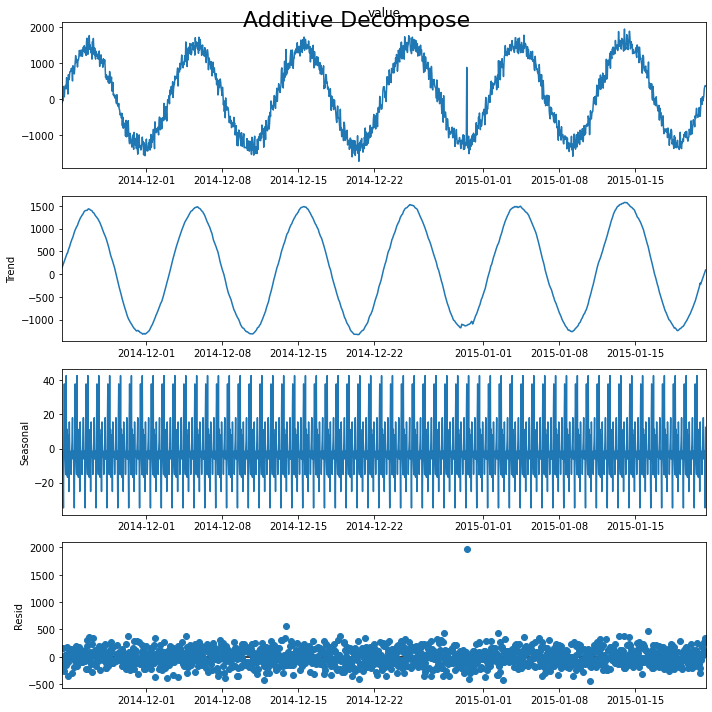



File: A2Benchmarksynthetic_15
threshold: 500
Actual Outliers: 1
                          value  is_anomaly
timestamp                                  
2014-12-30 12:00:00  884.662693           1
Detected outliers: 2
Outliers:
timestamp
2014-12-13 21:00:00     555.685017
2014-12-30 12:00:00    1973.810656
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_16add_STL


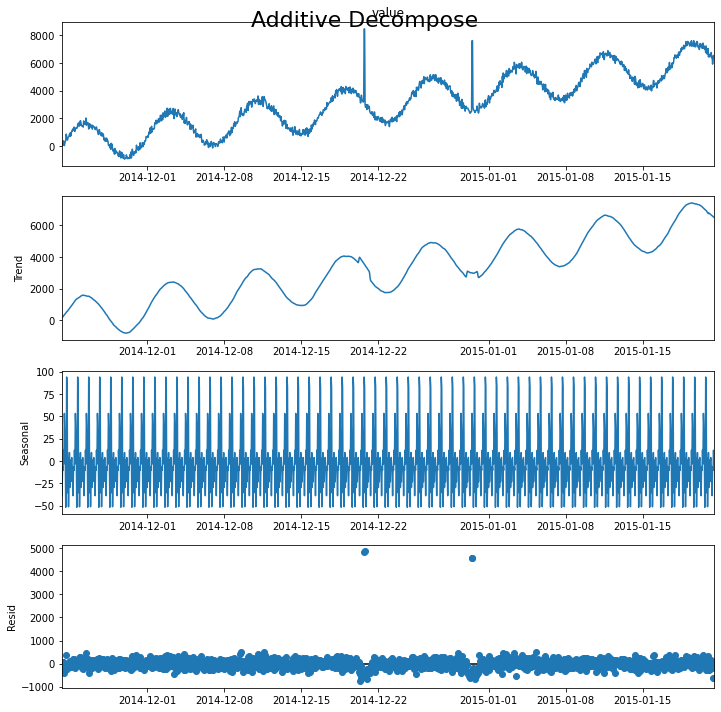



File: A2Benchmarksynthetic_16
threshold: 500
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  8470.624612           1
2014-12-20 18:00:00  8470.624612           1
2014-12-30 12:00:00  7612.932509           1
2014-12-30 13:00:00  7612.932509           1
Detected outliers: 7
Outliers:
timestamp
2014-12-09 13:00:00     514.105247
2014-12-11 15:00:00     513.102094
2014-12-20 17:00:00    4816.755116
2014-12-20 18:00:00    4877.904403
2014-12-30 12:00:00    4569.638451
2014-12-30 13:00:00    4593.284562
2015-01-05 07:00:00     502.952377
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_17add_STL


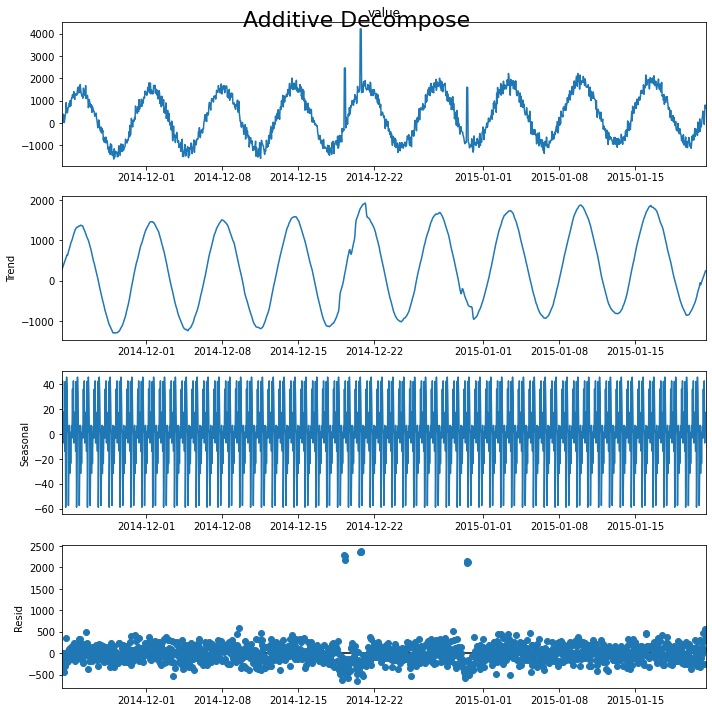



File: A2Benchmarksynthetic_17
threshold: 500
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  2455.065872           1
2014-12-19 07:00:00  2455.065872           1
2014-12-19 08:00:00  2455.065872           1
2014-12-20 17:00:00  4206.886469           1
2014-12-20 18:00:00  4206.886469           1
2014-12-20 19:00:00  4206.886469           1
2014-12-30 12:00:00  1591.137711           1
2014-12-30 13:00:00  1591.137711           1
2014-12-30 14:00:00  1591.137711           1
Detected outliers: 12
Outliers:
timestamp
2014-12-09 13:00:00     594.849188
2014-12-19 06:00:00    2287.358933
2014-12-19 07:00:00    2271.483046
2014-12-19 08:00:00    2174.836732
2014-12-20 17:00:00    2366.885292
2014-12-20 18:00:00    2364.824872
2014-12-20 19:00:00    2376.670578
2014-12-29 05:00:00     521.451642
2014-12-30 12:00:00    2094.114192
2014-12-30 13:00:00    2141.610494
2014-12-30 14:00:00    2120.512364
2015-01-21 1

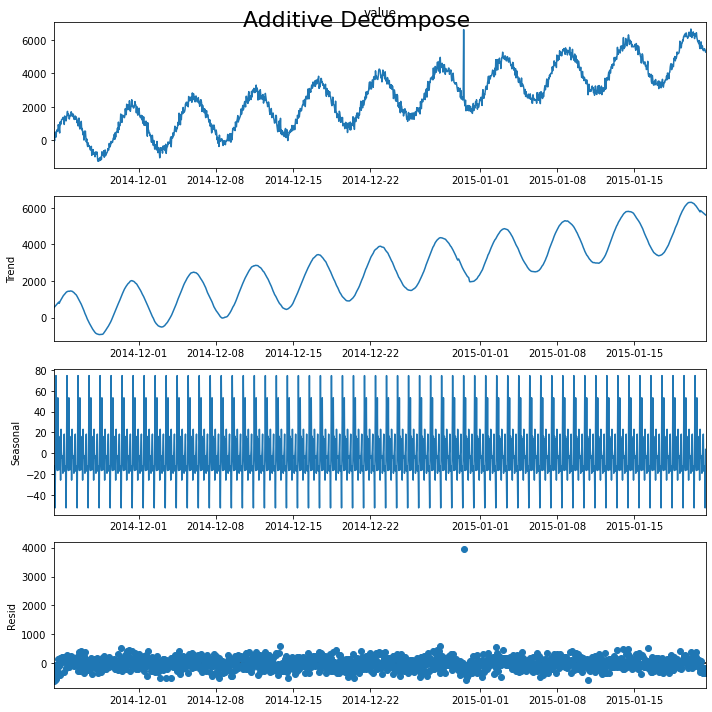



File: A2Benchmarksynthetic_18
threshold: 500
Actual Outliers: 1
                           value  is_anomaly
timestamp                                   
2014-12-30 12:00:00  6622.489879           1
Detected outliers: 6
Outliers:
timestamp
2014-11-29 09:00:00     519.952196
2014-12-13 21:00:00     588.323442
2014-12-28 09:00:00     613.806239
2014-12-30 12:00:00    3954.592070
2015-01-02 10:00:00     566.404252
2015-01-16 05:00:00     523.896653
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_19add_STL


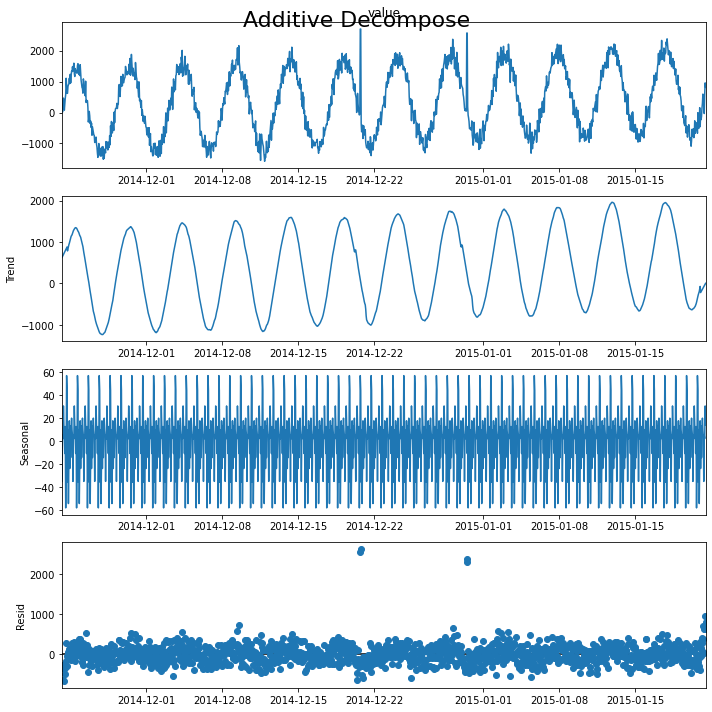



File: A2Benchmarksynthetic_19
threshold: 500
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  2701.113338           1
2014-12-20 18:00:00  2701.113338           1
2014-12-30 12:00:00  2570.985949           1
2014-12-30 13:00:00  2570.985949           1
Detected outliers: 21
Outliers:
timestamp
2014-11-25 11:00:00     520.980222
2014-11-29 16:00:00     539.124376
2014-11-30 01:00:00     515.787585
2014-12-04 08:00:00     541.564093
2014-12-09 10:00:00     570.088062
2014-12-09 13:00:00     738.338568
2014-12-14 10:00:00     502.951752
2014-12-20 17:00:00    2543.158313
2014-12-20 18:00:00    2630.254526
2014-12-29 05:00:00     646.398768
2014-12-30 12:00:00    2303.094641
2014-12-30 13:00:00    2389.841862
2015-01-02 08:00:00     569.731602
2015-01-02 15:00:00     529.947855
2015-01-03 08:00:00     561.546764
2015-01-17 10:00:00     509.745124
2015-01-21 05:00:00     704.575155
2015-01-21 07:00:00     617

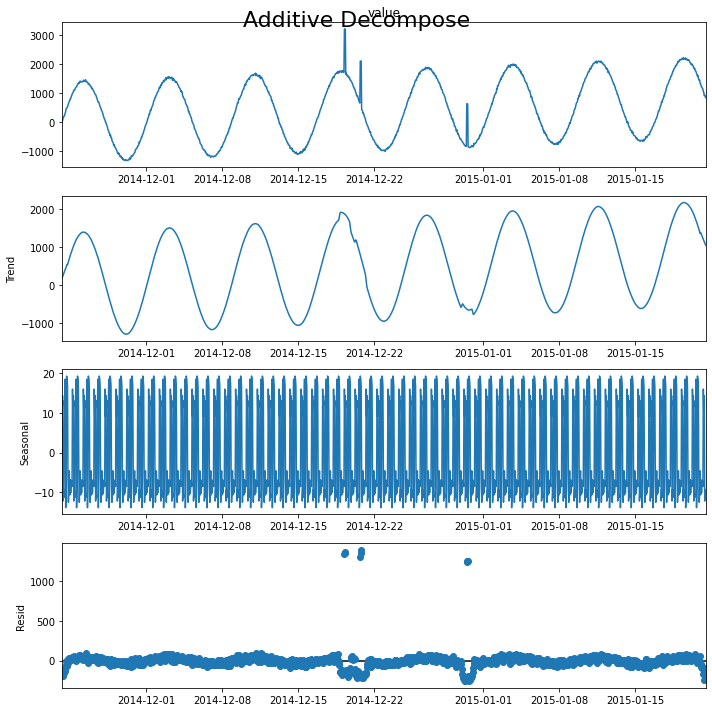



File: A2Benchmarksynthetic_2
threshold: 500
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  3225.596069           1
2014-12-19 07:00:00  3225.596069           1
2014-12-19 08:00:00  3225.596069           1
2014-12-20 17:00:00  2114.071753           1
2014-12-20 18:00:00  2114.071753           1
2014-12-20 19:00:00  2114.071753           1
2014-12-30 12:00:00   631.206140           1
2014-12-30 13:00:00   631.206140           1
2014-12-30 14:00:00   631.206140           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    1336.141758
2014-12-19 07:00:00    1354.743755
2014-12-19 08:00:00    1362.022586
2014-12-20 17:00:00    1301.462227
2014-12-20 18:00:00    1347.539611
2014-12-20 19:00:00    1394.729580
2014-12-30 12:00:00    1244.776908
2014-12-30 13:00:00    1255.079829
2014-12-30 14:00:00    1255.735410
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_20add_STL


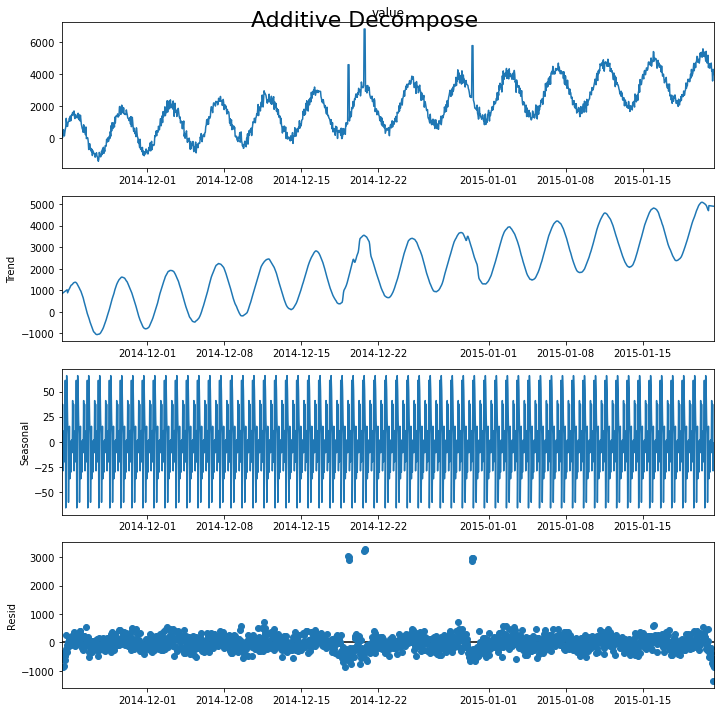



File: A2Benchmarksynthetic_20
threshold: 500
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  4595.357487           1
2014-12-19 07:00:00  4595.357487           1
2014-12-19 08:00:00  4595.357487           1
2014-12-20 17:00:00  6838.500015           1
2014-12-20 18:00:00  6838.500015           1
2014-12-20 19:00:00  6838.500015           1
2014-12-30 12:00:00  5794.273164           1
2014-12-30 13:00:00  5794.273164           1
2014-12-30 14:00:00  5794.273164           1
Detected outliers: 24
Outliers:
timestamp
2014-11-25 11:00:00     551.249943
2014-11-29 16:00:00     510.570394
2014-12-02 20:00:00     532.226013
2014-12-09 13:00:00     565.058796
2014-12-11 02:00:00     501.878878
2014-12-11 11:00:00     525.334884
2014-12-11 15:00:00     707.656900
2014-12-11 16:00:00     517.871707
2014-12-19 06:00:00    3032.112482
2014-12-19 07:00:00    3012.748989
2014-12-19 08:00:00    2888.293381
2014-12-20 1

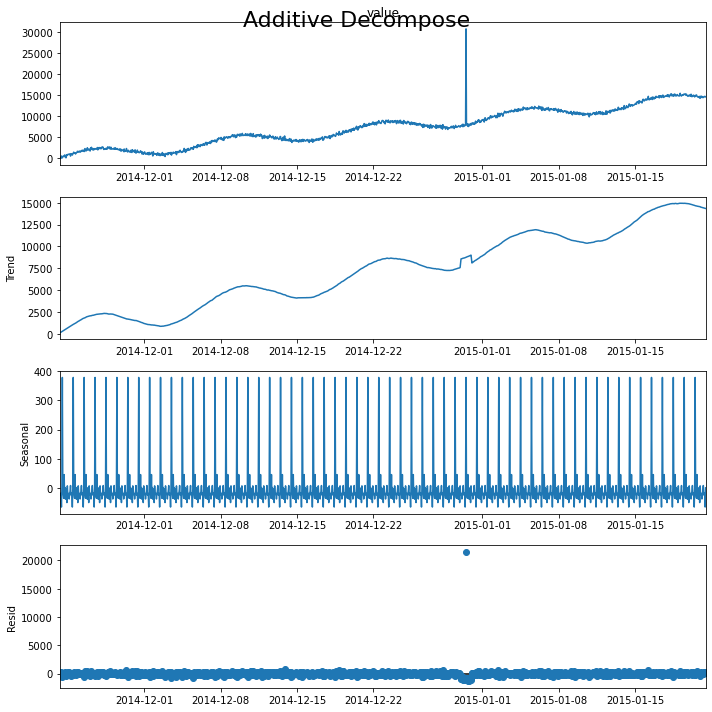



File: A2Benchmarksynthetic_21
threshold: 500
Actual Outliers: 1
                            value  is_anomaly
timestamp                                    
2014-12-30 12:00:00  30692.054083           1
Detected outliers: 12
Outliers:
timestamp
2014-11-29 09:00:00      571.813444
2014-12-01 20:00:00      505.341062
2014-12-13 21:00:00      767.416955
2014-12-18 21:00:00      563.583673
2014-12-21 04:00:00      543.353804
2014-12-28 09:00:00      623.978209
2014-12-30 12:00:00    21550.896677
2015-01-02 10:00:00      609.646952
2015-01-06 04:00:00      504.264110
2015-01-13 11:00:00      502.757588
2015-01-14 00:00:00      514.009796
2015-01-16 05:00:00      665.962688
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_22add_STL


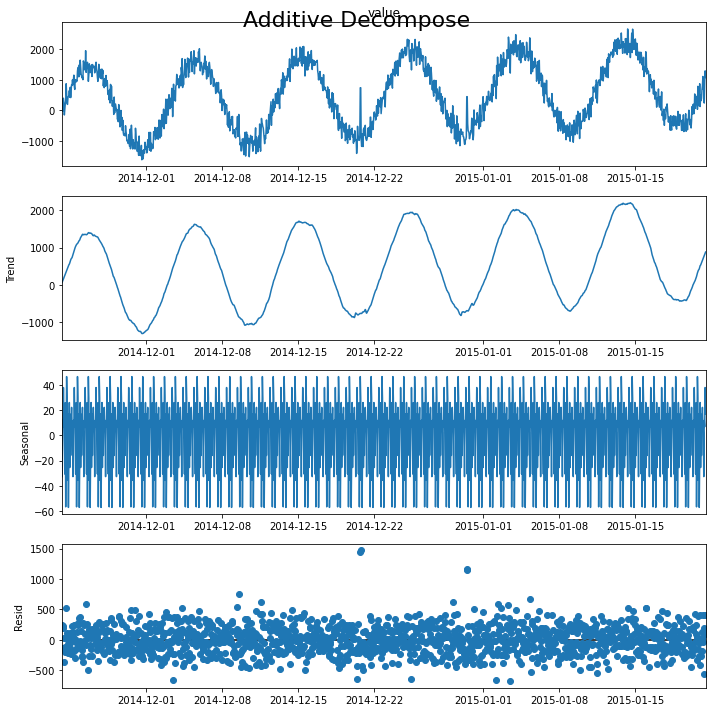



File: A2Benchmarksynthetic_22
threshold: 500
Actual Outliers: 4
                          value  is_anomaly
timestamp                                  
2014-12-20 17:00:00  737.743951           1
2014-12-20 18:00:00  737.743951           1
2014-12-30 12:00:00  446.493838           1
2014-12-30 13:00:00  446.493838           1
Detected outliers: 19
Outliers:
timestamp
2014-11-23 16:00:00     527.858507
2014-11-25 11:00:00     585.352726
2014-12-04 08:00:00     529.410373
2014-12-09 10:00:00     532.622709
2014-12-09 13:00:00     750.488923
2014-12-11 15:00:00     626.410056
2014-12-20 17:00:00    1446.657906
2014-12-20 18:00:00    1468.329618
2014-12-29 05:00:00     626.159432
2014-12-30 12:00:00    1141.111214
2014-12-30 13:00:00    1161.599383
2014-12-31 04:00:00     510.494395
2015-01-02 08:00:00     587.830825
2015-01-02 15:00:00     518.029876
2015-01-03 08:00:00     567.680685
2015-01-05 07:00:00     672.500216
2015-01-14 07:00:00     523.437345
2015-01-15 23:00:00     524.27878

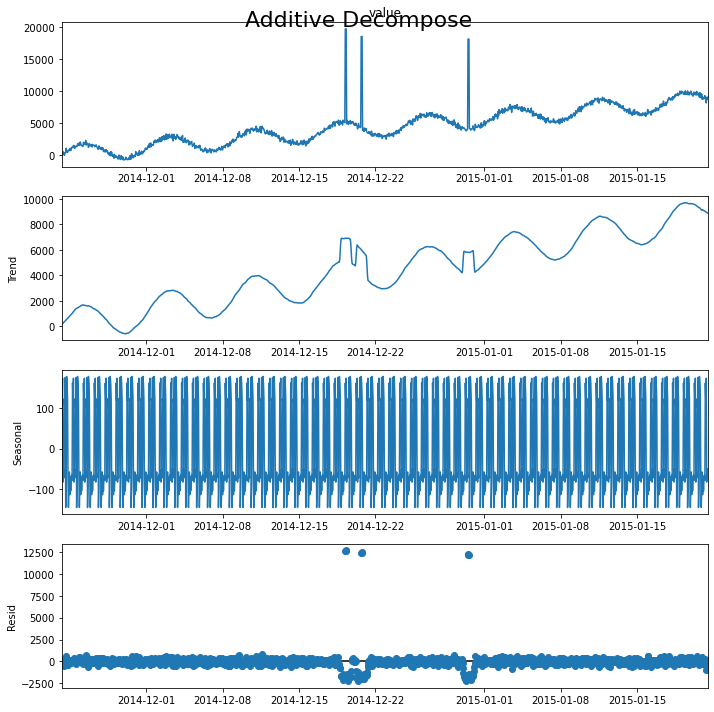



File: A2Benchmarksynthetic_23
threshold: 500
Actual Outliers: 9
                            value  is_anomaly
timestamp                                    
2014-12-19 06:00:00  19740.188389           1
2014-12-19 07:00:00  19740.188389           1
2014-12-19 08:00:00  19740.188389           1
2014-12-20 17:00:00  18553.830928           1
2014-12-20 18:00:00  18553.830928           1
2014-12-20 19:00:00  18553.830928           1
2014-12-30 12:00:00  18153.623148           1
2014-12-30 13:00:00  18153.623148           1
2014-12-30 14:00:00  18153.623148           1
Detected outliers: 46
Outliers:
timestamp
2014-11-23 16:00:00      609.412803
2014-11-25 11:00:00      713.714995
2014-11-29 16:00:00      584.137552
2014-11-30 01:00:00      597.544468
2014-11-30 09:00:00      500.131602
2014-12-02 15:00:00      519.078276
2014-12-02 20:00:00      601.428111
2014-12-03 00:00:00      516.338877
2014-12-03 03:00:00      519.186079
2014-12-03 20:00:00      503.576514
2014-12-05 22:00:00      5

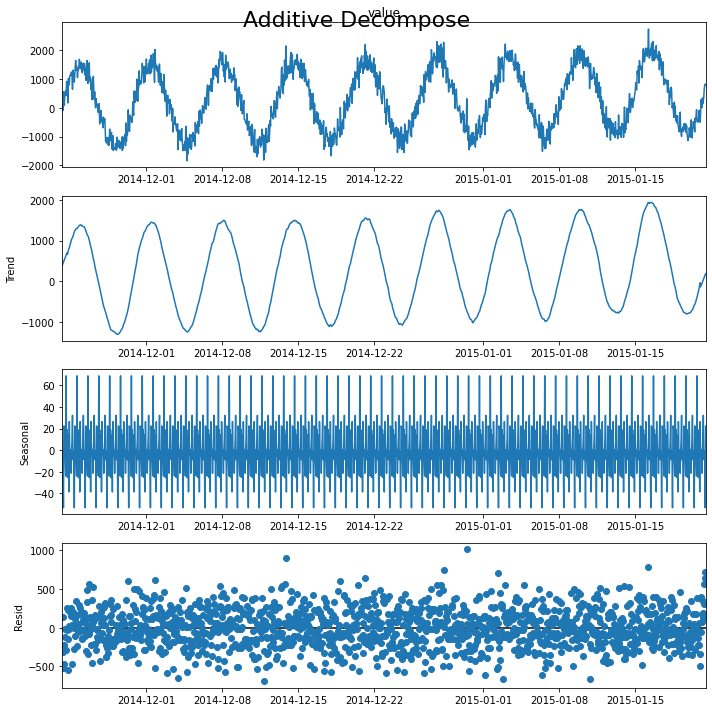



File: A2Benchmarksynthetic_24
threshold: 500
Actual Outliers: 1
                          value  is_anomaly
timestamp                                  
2014-12-30 12:00:00  313.432529           1
Detected outliers: 33
Outliers:
timestamp
2014-11-25 19:00:00     571.583155
2014-11-26 04:00:00     532.006943
2014-11-29 09:00:00     606.899393
2014-11-29 22:00:00     501.517400
2014-11-30 04:00:00     505.898106
2014-12-01 20:00:00     622.932354
2014-12-04 16:00:00     514.315289
2014-12-07 20:00:00     540.317676
2014-12-12 12:00:00     500.819043
2014-12-13 11:00:00     513.673147
2014-12-13 12:00:00     544.776760
2014-12-13 18:00:00     564.659184
2014-12-13 21:00:00     904.481717
2014-12-18 21:00:00     598.614684
2014-12-20 11:00:00     548.280040
2014-12-21 04:00:00     642.366090
2014-12-27 18:00:00     558.538346
2014-12-28 03:00:00     548.608256
2014-12-28 09:00:00     752.395125
2014-12-30 12:00:00    1014.024092
2015-01-02 10:00:00     703.877103
2015-01-03 01:00:00     5

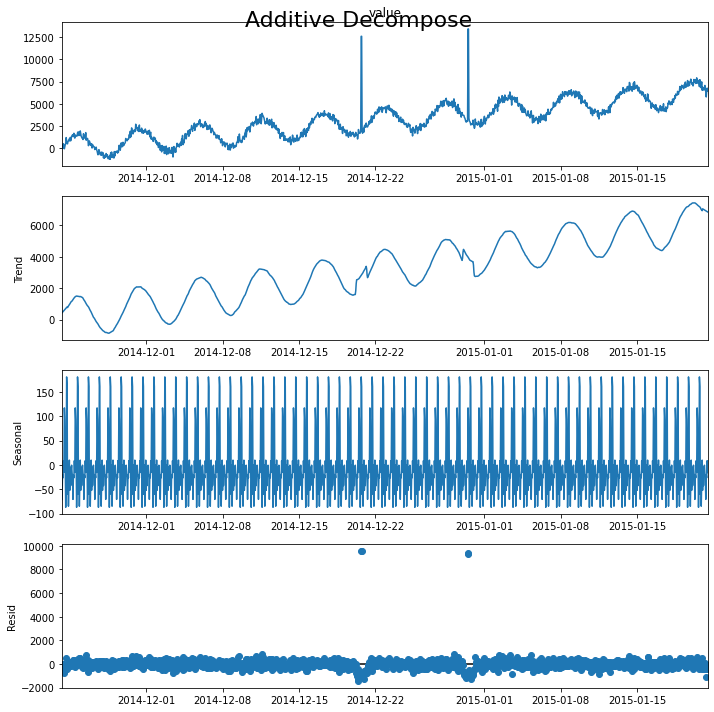



File: A2Benchmarksynthetic_25
threshold: 500
Actual Outliers: 4
                            value  is_anomaly
timestamp                                    
2014-12-20 17:00:00  12575.790049           1
2014-12-20 18:00:00  12575.790049           1
2014-12-30 12:00:00  13405.000517           1
2014-12-30 13:00:00  13405.000517           1
Detected outliers: 38
Outliers:
timestamp
2014-11-23 16:00:00     509.045420
2014-11-25 11:00:00     720.736139
2014-11-29 16:00:00     654.299623
2014-11-30 01:00:00     678.242954
2014-11-30 09:00:00     576.130935
2014-12-01 07:00:00     579.153078
2014-12-04 08:00:00     598.625072
2014-12-05 22:00:00     606.089905
2014-12-09 10:00:00     604.746528
2014-12-09 13:00:00     697.568592
2014-12-11 02:00:00     637.676085
2014-12-11 11:00:00     600.984781
2014-12-11 15:00:00     826.262024
2014-12-11 16:00:00     586.495840
2014-12-14 10:00:00     501.471280
2014-12-20 17:00:00    9570.089466
2014-12-20 18:00:00    9557.725565
2014-12-23 06:00:00  

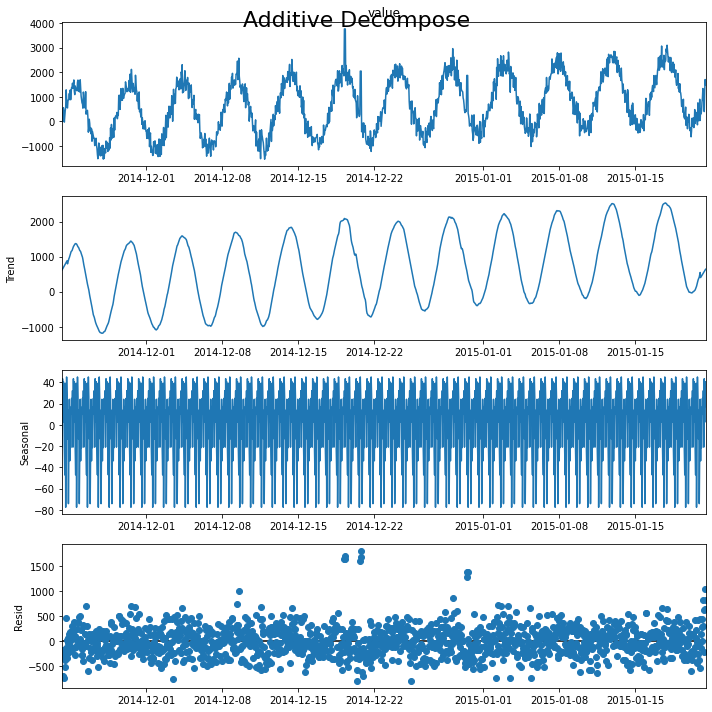



File: A2Benchmarksynthetic_26
threshold: 500
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  3755.844471           1
2014-12-19 07:00:00  3755.844471           1
2014-12-19 08:00:00  3755.844471           1
2014-12-20 17:00:00  2041.956620           1
2014-12-20 18:00:00  2041.956620           1
2014-12-20 19:00:00  2041.956620           1
2014-12-30 12:00:00  1865.879092           1
2014-12-30 13:00:00  1865.879092           1
2014-12-30 14:00:00  1865.879092           1
Detected outliers: 53
Outliers:
timestamp
2014-11-24 23:00:00     502.516154
2014-11-25 11:00:00     701.173642
2014-11-28 13:00:00     505.087059
2014-11-29 13:00:00     550.077490
2014-11-29 16:00:00     702.522741
2014-11-30 01:00:00     681.600866
2014-11-30 09:00:00     530.893397
2014-12-02 20:00:00     513.522555
2014-12-03 20:00:00     515.481229
2014-12-04 08:00:00     669.627722
2014-12-05 22:00:00     507.494970
2014-12-09 1

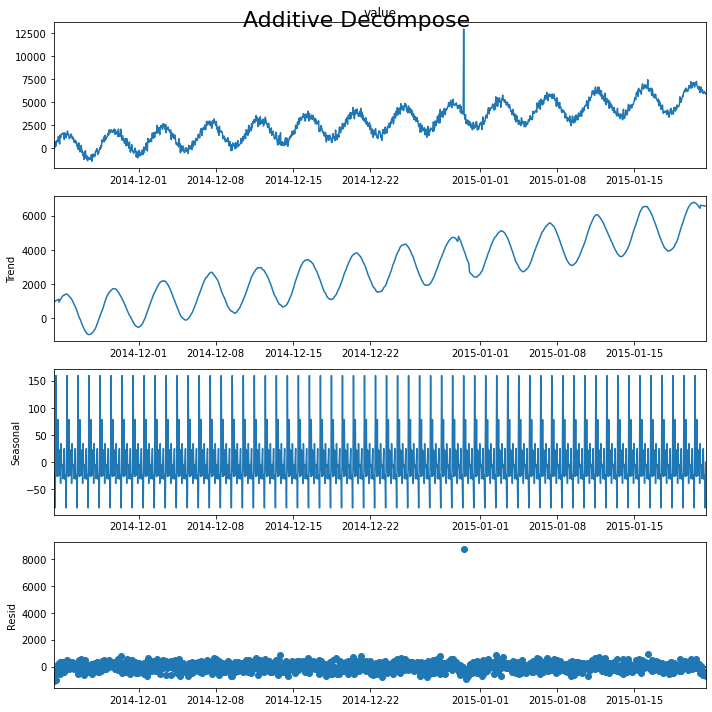



File: A2Benchmarksynthetic_27
threshold: 500
Actual Outliers: 1
                            value  is_anomaly
timestamp                                    
2014-12-30 12:00:00  12933.963939           1
Detected outliers: 53
Outliers:
timestamp
2014-11-25 19:00:00     547.450670
2014-11-29 04:00:00     543.954187
2014-11-29 09:00:00     808.240910
2014-11-29 22:00:00     547.990314
2014-11-30 04:00:00     510.958322
2014-12-01 20:00:00     602.401001
2014-12-02 16:00:00     577.045630
2014-12-04 16:00:00     570.078018
2014-12-07 04:00:00     519.970908
2014-12-07 20:00:00     652.033357
2014-12-07 21:00:00     503.454056
2014-12-08 01:00:00     532.969908
2014-12-11 00:00:00     517.559418
2014-12-11 16:00:00     600.533456
2014-12-12 12:00:00     535.330507
2014-12-13 11:00:00     508.465800
2014-12-13 21:00:00     858.316805
2014-12-16 09:00:00     613.015504
2014-12-17 08:00:00     518.804732
2014-12-18 21:00:00     606.035447
2014-12-20 11:00:00     708.851679
2014-12-21 04:00:00

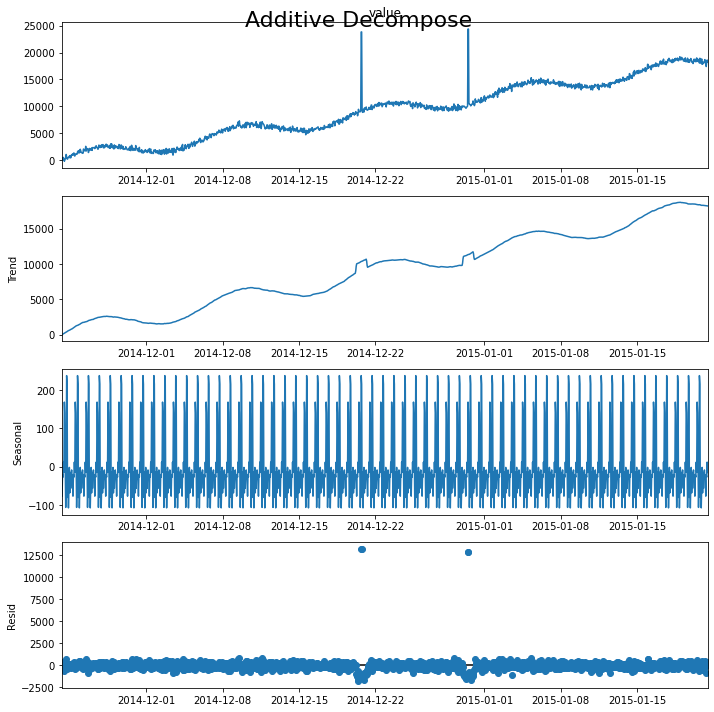



File: A2Benchmarksynthetic_28
threshold: 500
Actual Outliers: 4
                            value  is_anomaly
timestamp                                    
2014-12-20 17:00:00  23827.991635           1
2014-12-20 18:00:00  23827.991635           1
2014-12-30 12:00:00  24372.452465           1
2014-12-30 13:00:00  24372.452465           1
Detected outliers: 59
Outliers:
timestamp
2014-11-23 16:00:00      733.696088
2014-11-25 11:00:00      763.023418
2014-11-29 16:00:00      684.773270
2014-11-30 01:00:00      692.094102
2014-11-30 09:00:00      559.669203
2014-12-01 07:00:00      599.291925
2014-12-02 15:00:00      508.485578
2014-12-02 20:00:00      607.385130
2014-12-03 00:00:00      501.566847
2014-12-03 03:00:00      504.031142
2014-12-04 08:00:00      677.156019
2014-12-05 22:00:00      608.281826
2014-12-09 10:00:00      749.462802
2014-12-09 13:00:00      812.027728
2014-12-10 03:00:00      516.206885
2014-12-10 06:00:00      514.205830
2014-12-11 02:00:00      666.803711
2014

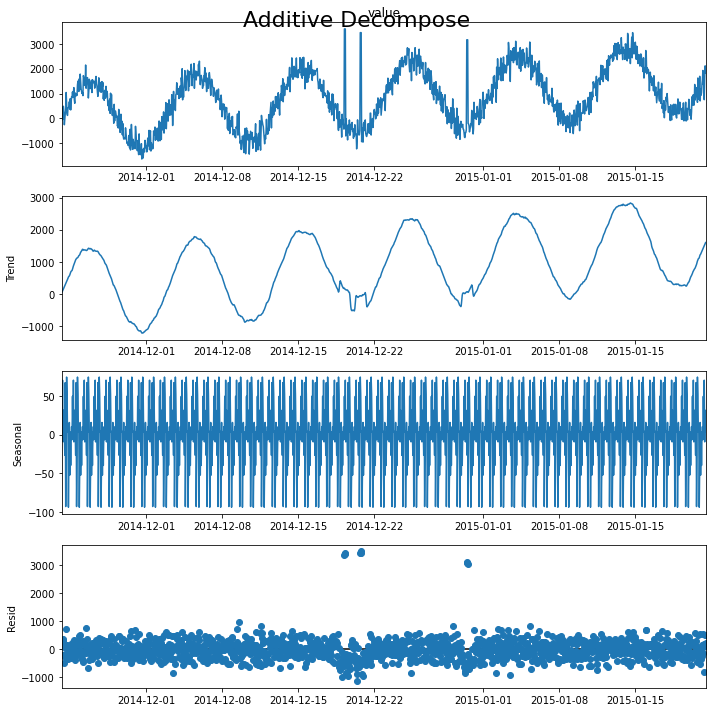



File: A2Benchmarksynthetic_29
threshold: 500
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  3599.566321           1
2014-12-19 07:00:00  3599.566321           1
2014-12-19 08:00:00  3599.566321           1
2014-12-20 17:00:00  3449.742128           1
2014-12-20 18:00:00  3449.742128           1
2014-12-20 19:00:00  3449.742128           1
2014-12-30 12:00:00  3161.305435           1
2014-12-30 13:00:00  3161.305435           1
2014-12-30 14:00:00  3161.305435           1
Detected outliers: 70
Outliers:
timestamp
2014-11-23 16:00:00    724.146516
2014-11-24 23:00:00    503.832489
2014-11-25 11:00:00    781.999790
2014-11-29 16:00:00    671.692031
2014-11-30 01:00:00    677.537136
                          ...    
2015-01-20 11:00:00    577.088336
2015-01-20 18:00:00    511.458008
2015-01-20 22:00:00    549.819676
2015-01-21 05:00:00    536.676871
2015-01-21 10:00:00    517.549910
Name: resid, Length: 70

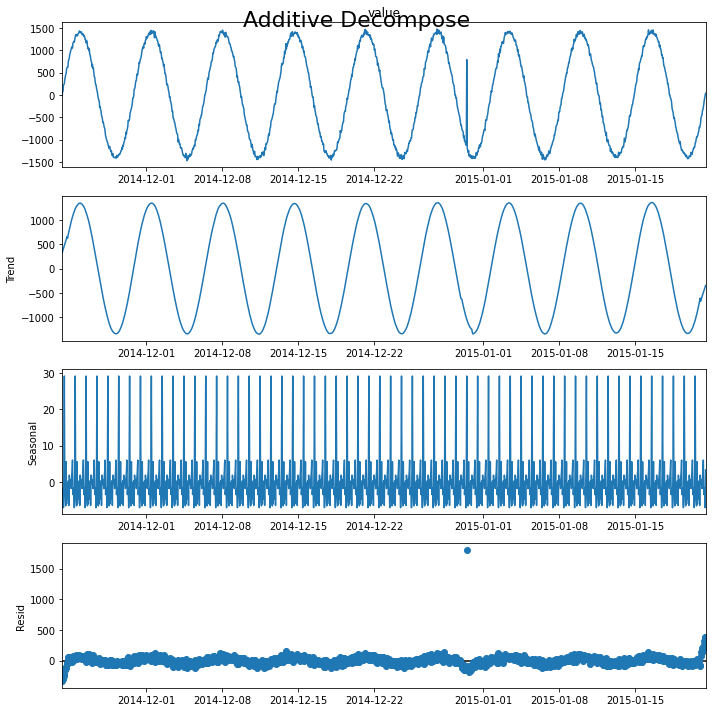



File: A2Benchmarksynthetic_3
threshold: 500
Actual Outliers: 1
                          value  is_anomaly
timestamp                                  
2014-12-30 12:00:00  791.823067           1
Detected outliers: 1
Outliers:
timestamp
2014-12-30 12:00:00    1810.40052
Name: resid, dtype: float64



A2Benchmark_A2Benchmarksynthetic_30add_STL


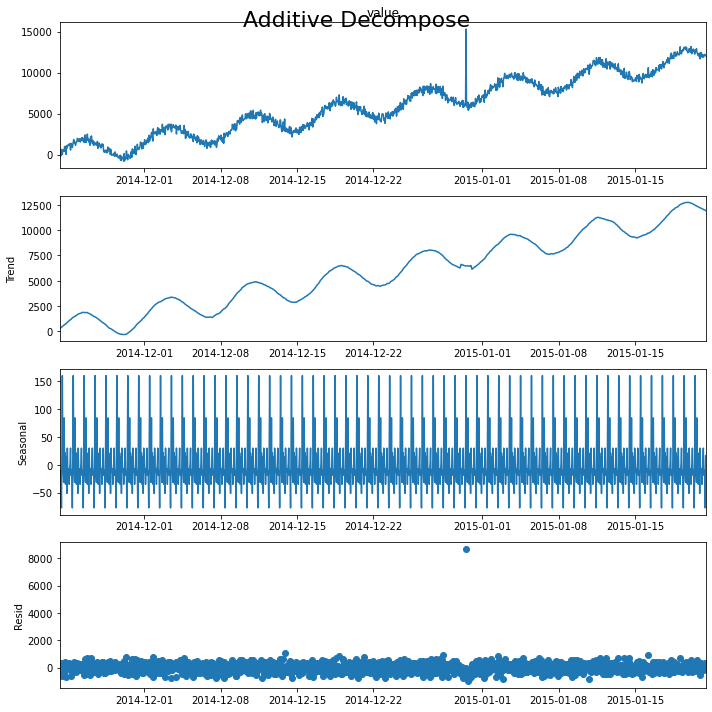



File: A2Benchmarksynthetic_30
threshold: 500
Actual Outliers: 1
                            value  is_anomaly
timestamp                                    
2014-12-30 12:00:00  15325.861692           1
Detected outliers: 70
Outliers:
timestamp
2014-11-25 14:00:00    599.521416
2014-11-25 19:00:00    705.495365
2014-11-26 04:00:00    675.838168
2014-11-29 09:00:00    760.974505
2014-11-29 22:00:00    595.097335
                          ...    
2015-01-16 05:00:00    890.478879
2015-01-18 07:00:00    533.735800
2015-01-19 03:00:00    666.928410
2015-01-20 03:00:00    537.410591
2015-01-20 15:00:00    557.159894
Name: resid, Length: 70, dtype: float64



A2Benchmark_A2Benchmarksynthetic_31add_STL


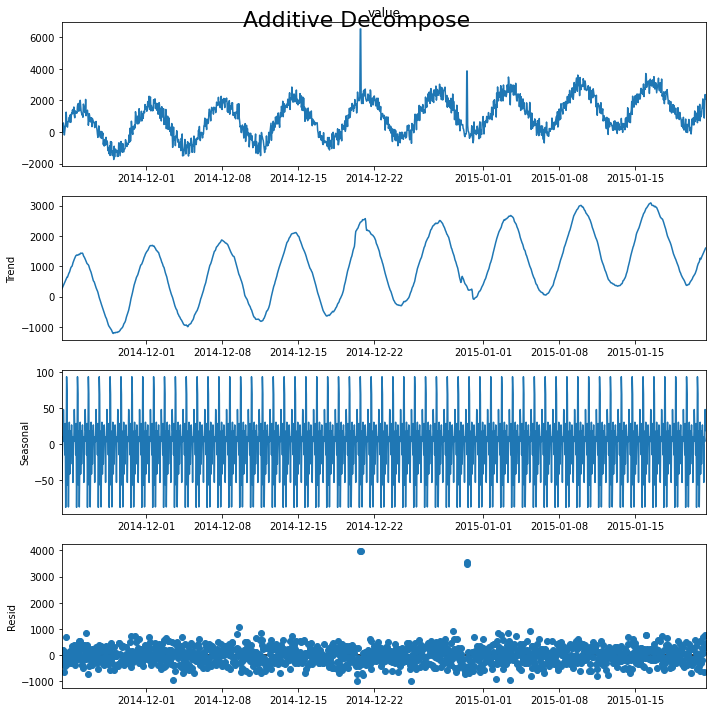



File: A2Benchmarksynthetic_31
threshold: 500
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  6519.797396           1
2014-12-20 18:00:00  6519.797396           1
2014-12-30 12:00:00  3853.824702           1
2014-12-30 13:00:00  3853.824702           1
Detected outliers: 79
Outliers:
timestamp
2014-11-23 16:00:00    695.402954
2014-11-24 21:00:00    533.763801
2014-11-24 23:00:00    555.346939
2014-11-25 11:00:00    842.200788
2014-11-29 16:00:00    715.377927
                          ...    
2015-01-20 11:00:00    573.491698
2015-01-20 18:00:00    510.507829
2015-01-20 22:00:00    556.102376
2015-01-21 05:00:00    686.533489
2015-01-21 10:00:00    752.530505
Name: resid, Length: 79, dtype: float64



A2Benchmark_A2Benchmarksynthetic_32add_STL


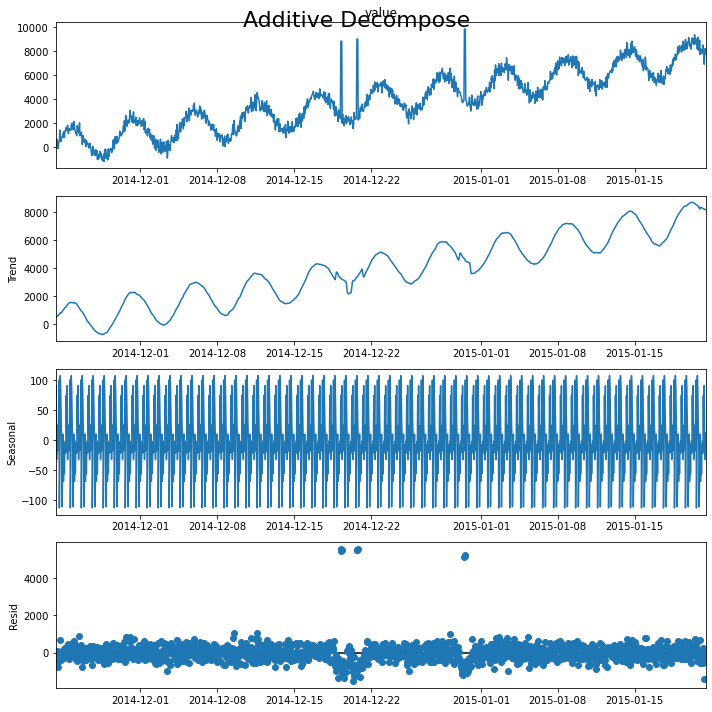



File: A2Benchmarksynthetic_32
threshold: 500
Actual Outliers: 9
                           value  is_anomaly
timestamp                                   
2014-12-19 06:00:00  8812.542813           1
2014-12-19 07:00:00  8812.542813           1
2014-12-19 08:00:00  8812.542813           1
2014-12-20 17:00:00  8987.656808           1
2014-12-20 18:00:00  8987.656808           1
2014-12-20 19:00:00  8987.656808           1
2014-12-30 12:00:00  9830.944052           1
2014-12-30 13:00:00  9830.944052           1
2014-12-30 14:00:00  9830.944052           1
Detected outliers: 99
Outliers:
timestamp
2014-11-23 16:00:00    695.167035
2014-11-24 21:00:00    588.645884
2014-11-24 23:00:00    609.253891
2014-11-25 11:00:00    907.384691
2014-11-29 13:00:00    555.566537
                          ...    
2015-01-19 15:00:00    641.445497
2015-01-19 22:00:00    576.881565
2015-01-20 11:00:00    739.261297
2015-01-20 18:00:00    601.695207
2015-01-20 22:00:00    663.562695
Name: resid, Length: 99

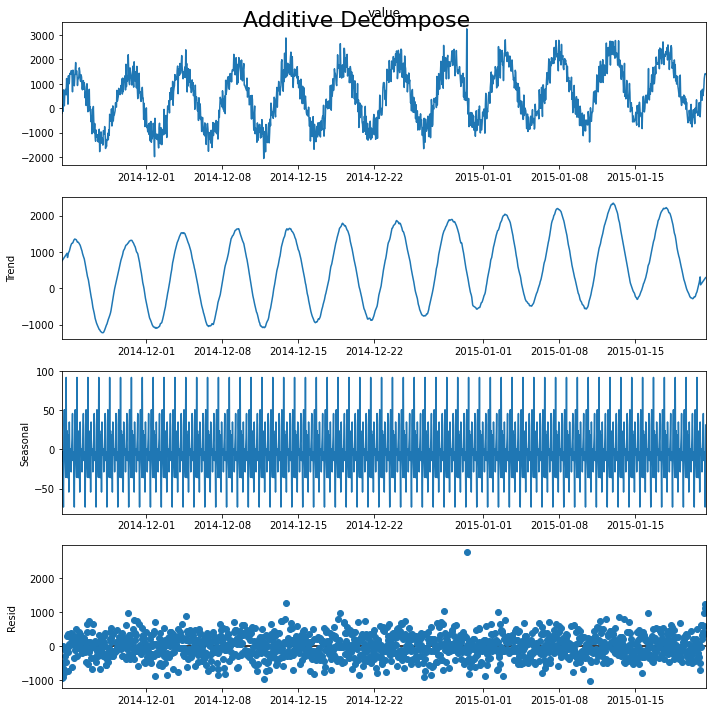



File: A2Benchmarksynthetic_33
threshold: 500
Actual Outliers: 1
                           value  is_anomaly
timestamp                                   
2014-12-30 12:00:00  3252.390692           1
Detected outliers: 99
Outliers:
timestamp
2014-11-24 13:00:00     510.567146
2014-11-25 14:00:00     641.994514
2014-11-25 19:00:00     732.470055
2014-11-26 04:00:00     655.356685
2014-11-27 20:00:00     521.464316
                          ...     
2015-01-21 07:00:00     592.278918
2015-01-21 08:00:00     973.001399
2015-01-21 09:00:00    1102.453058
2015-01-21 10:00:00    1220.958898
2015-01-21 11:00:00    1072.931758
Name: resid, Length: 99, dtype: float64



A2Benchmark_A2Benchmarksynthetic_34add_STL


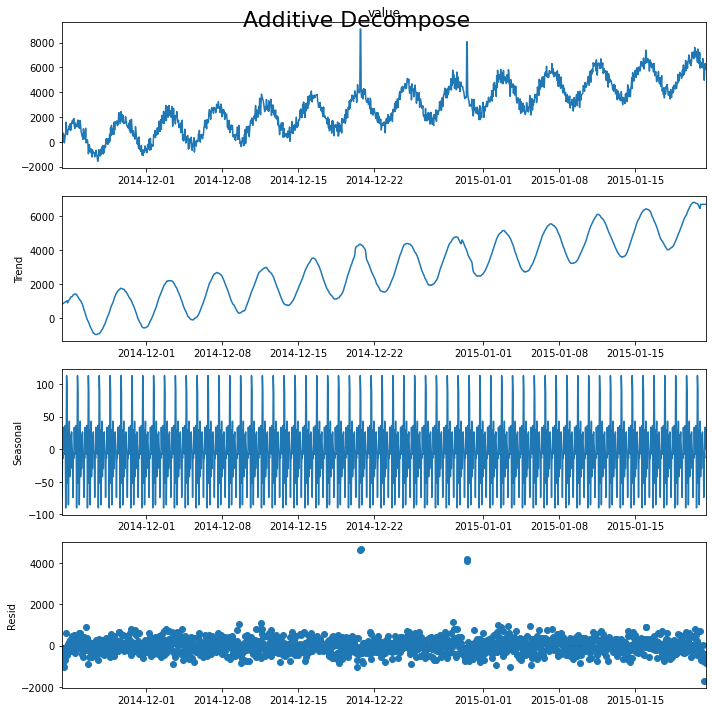



File: A2Benchmarksynthetic_34
threshold: 500
Actual Outliers: 4
                           value  is_anomaly
timestamp                                   
2014-12-20 17:00:00  9088.466267           1
2014-12-20 18:00:00  9088.466267           1
2014-12-30 12:00:00  8056.499950           1
2014-12-30 13:00:00  8056.499950           1
Detected outliers: 101
Outliers:
timestamp
2014-11-23 16:00:00    600.844712
2014-11-24 09:00:00    502.852877
2014-11-24 21:00:00    607.584511
2014-11-24 23:00:00    621.544601
2014-11-25 11:00:00    896.814294
                          ...    
2015-01-19 22:00:00    598.830476
2015-01-20 11:00:00    812.363889
2015-01-20 14:00:00    518.405623
2015-01-20 18:00:00    684.028728
2015-01-20 22:00:00    711.047690
Name: resid, Length: 101, dtype: float64



A2Benchmark_A2Benchmarksynthetic_35add_STL


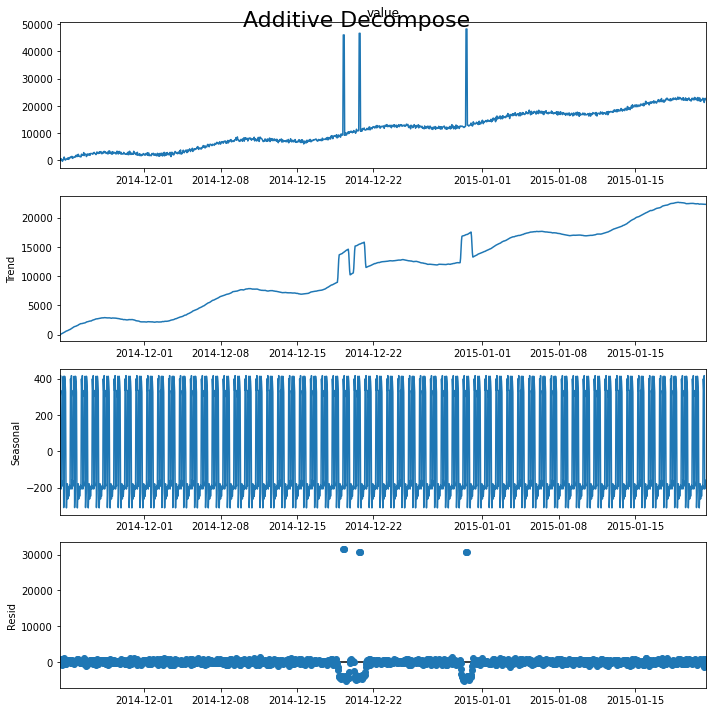



File: A2Benchmarksynthetic_35
threshold: 500
Actual Outliers: 9
                            value  is_anomaly
timestamp                                    
2014-12-19 06:00:00  45998.101187           1
2014-12-19 07:00:00  45998.101187           1
2014-12-19 08:00:00  45998.101187           1
2014-12-20 17:00:00  46597.041510           1
2014-12-20 18:00:00  46597.041510           1
2014-12-20 19:00:00  46597.041510           1
2014-12-30 12:00:00  48173.999054           1
2014-12-30 13:00:00  48173.999054           1
2014-12-30 14:00:00  48173.999054           1
Detected outliers: 192
Outliers:
timestamp
2014-11-23 09:00:00     687.644734
2014-11-23 10:00:00     619.654956
2014-11-23 16:00:00    1096.396638
2014-11-24 09:00:00     596.737716
2014-11-24 21:00:00     765.360436
                          ...     
2015-01-20 05:00:00     554.266562
2015-01-20 11:00:00     915.780859
2015-01-20 22:00:00     873.908082
2015-01-21 05:00:00     740.440334
2015-01-21 10:00:00     646.952454


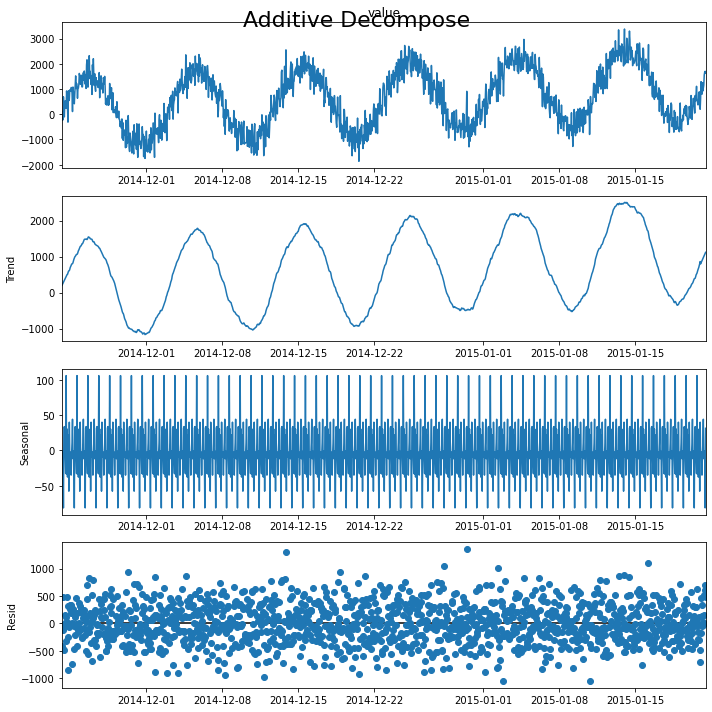



File: A2Benchmarksynthetic_36
threshold: 500
Actual Outliers: 1
                          value  is_anomaly
timestamp                                  
2014-12-30 12:00:00  908.522117           1
Detected outliers: 126
Outliers:
timestamp
2014-11-25 14:00:00    694.471686
2014-11-25 19:00:00    825.287534
2014-11-26 02:00:00    519.359067
2014-11-26 04:00:00    792.607138
2014-11-27 05:00:00    536.338228
                          ...    
2015-01-20 03:00:00    581.048749
2015-01-20 15:00:00    623.888986
2015-01-21 08:00:00    524.123126
2015-01-21 09:00:00    614.251371
2015-01-21 10:00:00    692.037916
Name: resid, Length: 126, dtype: float64
STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:0:00:20.624131
[0.7272727272727273, 1.0, 0.04545454545454545, 0.8181818181818181, 0.25, 0.6666666666666666, 0.782608695652174, 0.6666666666666666, 0.5714285714285714, 0.6923076923076924, 0.2857142857142857, 0.2857142857142857, 0.782608695652174, 0.545454545454

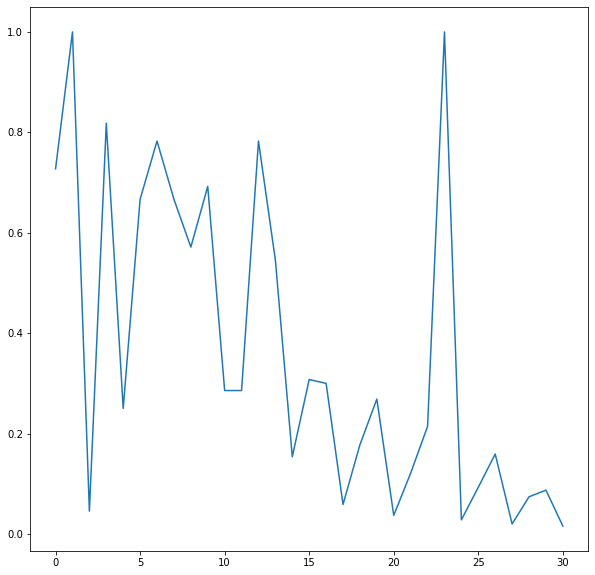

In [66]:
start_time = datetime.now() 
f1_plot = []
for index,file in enumerate(all_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
    if index > 30:
        break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A2Benchmark_" + fname +"add_STL")
    print("\n\n\nA2Benchmark_" + fname +"add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    
    outliers = residualdf[residualdf > threshold]
    anomalies = df_indexed.join(outliers,on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers,on='timestamp',how='inner')
    not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    f1 = 2 * (precision * recall)/(precision + recall)
    f1_plot.append(f1)
    
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print(f1_plot)
plt.plot(f1_plot)

In [69]:
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")

STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:0:00:20.624131


In [70]:
print(sum(f1_plot)/len(f1_plot))

0.36248695501582145


In [71]:
f1_plot

[0.7272727272727273,
 1.0,
 0.04545454545454545,
 0.8181818181818181,
 0.25,
 0.6666666666666666,
 0.782608695652174,
 0.6666666666666666,
 0.5714285714285714,
 0.6923076923076924,
 0.2857142857142857,
 0.2857142857142857,
 0.782608695652174,
 0.5454545454545454,
 0.15384615384615385,
 0.3076923076923077,
 0.30000000000000004,
 0.05882352941176471,
 0.17777777777777778,
 0.26865671641791045,
 0.037037037037037035,
 0.12121212121212119,
 0.21428571428571425,
 1.0,
 0.028169014084507043,
 0.09302325581395349,
 0.1592920353982301,
 0.02,
 0.07407407407407407,
 0.08737864077669903,
 0.015748031496062992]

### Standardizing the Time series and applying

In [32]:
from sklearn.preprocessing import StandardScaler
from math import sqrt

In [91]:
df_indexed

,value,is_anomaly
timestamp,,
2014-11-23 07:00:00,0.007622,0
2014-11-23 08:00:00,0.027557,0
2014-11-23 09:00:00,0.083617,0
2014-11-23 10:00:00,0.120537,0
2014-11-23 11:00:00,0.148461,0
...,...,...
2015-01-21 07:00:00,-0.149671,0
2015-01-21 08:00:00,-0.147887,0
2015-01-21 09:00:00,-0.077899,0


Processing index: 0 of 100
Mean: 6.368346, StandardDeviation: 987.420584
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00   13.894031           0
1    2014-11-23 08:00:00   33.578274           0
2    2014-11-23 09:00:00   88.933746           0
3    2014-11-23 10:00:00  125.389424           0
4    2014-11-23 11:00:00  152.962000           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00 -141.419766           0
1417 2015-01-21 08:00:00 -139.657834           0
1418 2015-01-21 09:00:00  -70.550652           0
1419 2015-01-21 10:00:00  -16.857148           0
1420 2015-01-21 11:00:00    7.757660           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_1add_STL


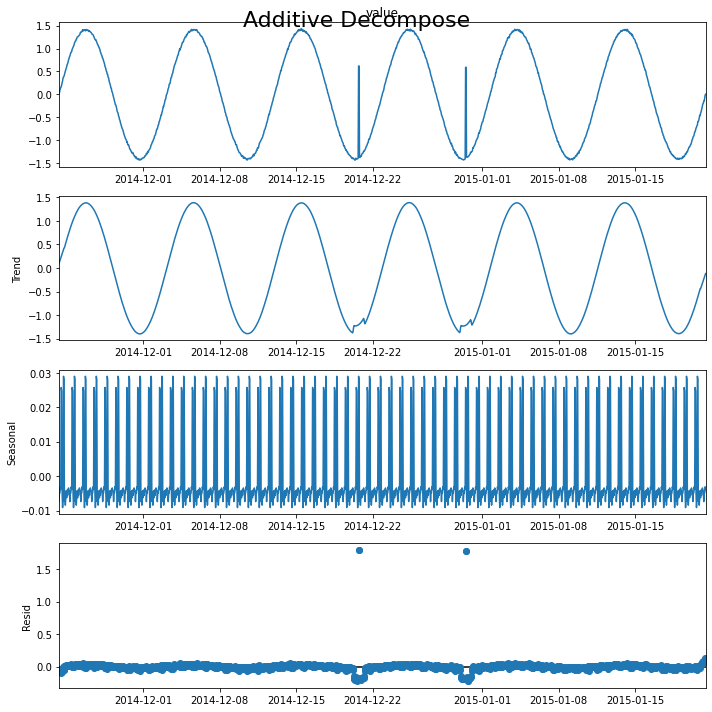



File: A2Benchmarksynthetic_1
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  0.617816           1
2014-12-20 18:00:00  0.617816           1
2014-12-30 12:00:00  0.588934           1
2014-12-30 13:00:00  0.588934           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.794800
659 2014-12-20 18:00:00  1.788847
893 2014-12-30 12:00:00  1.782777
894 2014-12-30 13:00:00  1.778251
Mean: 100.510082, StandardDeviation: 994.197252
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  127.699238           0
1    2014-11-23 08:00:00   23.069614           0
2    2014-11-23 09:00:00  246.118857           0
3    2014-11-23 10:00:00  295.937818           0
4    2014-11-23 11:00:00  264.649986           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00   21.595423           0
1417 2015-01-21 08:00:00 -246.681048       

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_10add_STL


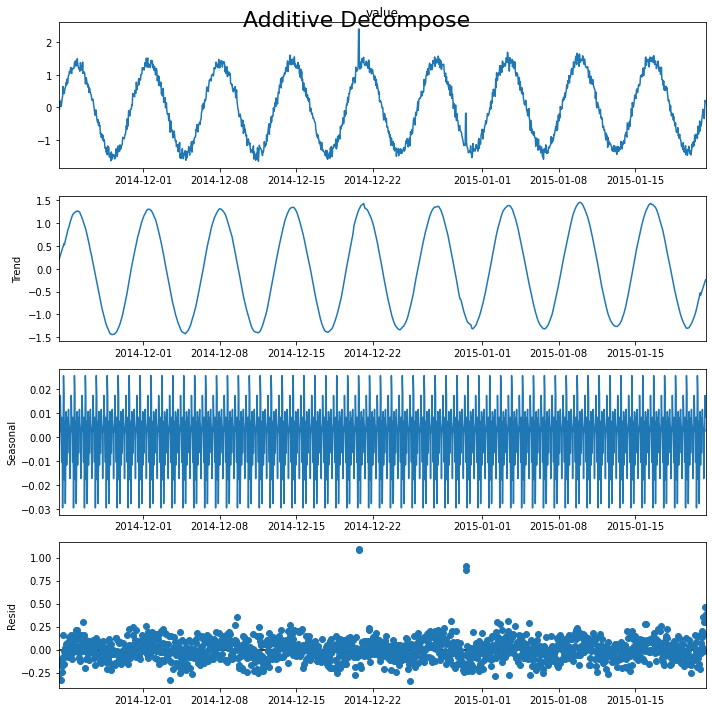



File: A2Benchmarksynthetic_10
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.403750           1
2014-12-20 18:00:00  2.403750           1
2014-12-30 12:00:00 -0.185198           1
2014-12-30 13:00:00 -0.185198           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.095023
659 2014-12-20 18:00:00  1.083752
893 2014-12-30 12:00:00  0.866077
894 2014-12-30 13:00:00  0.905521
Mean: 17255.105564, StandardDeviation: 10042.787001
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    530.537582           0
1    2014-11-23 08:00:00    -36.182104           0
2    2014-11-23 09:00:00    698.380385           0
3    2014-11-23 10:00:00    745.766197           0
4    2014-11-23 11:00:00    472.031180           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  34499.926302           0
1417 2015-01-21 08:00:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_100add_STL


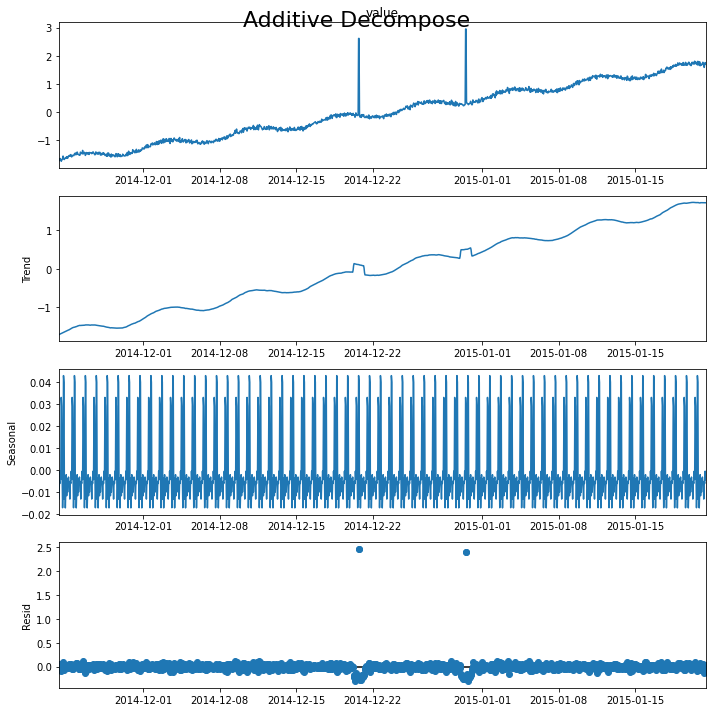



File: A2Benchmarksynthetic_100
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.615356           1
2014-12-20 18:00:00  2.615356           1
2014-12-30 12:00:00  2.950290           1
2014-12-30 13:00:00  2.950290           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.459075
659 2014-12-20 18:00:00  2.466446
893 2014-12-30 12:00:00  2.407609
894 2014-12-30 13:00:00  2.410951
Mean: 1613.761107, StandardDeviation: 1381.918933
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   142.349854           0
1    2014-11-23 08:00:00    33.132799           0
2    2014-11-23 09:00:00   283.994868           0
3    2014-11-23 10:00:00   344.388904           0
4    2014-11-23 11:00:00   315.516784           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3370.568406           0
1417 2015-01-21 08:00:00  2952.

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_11add_STL


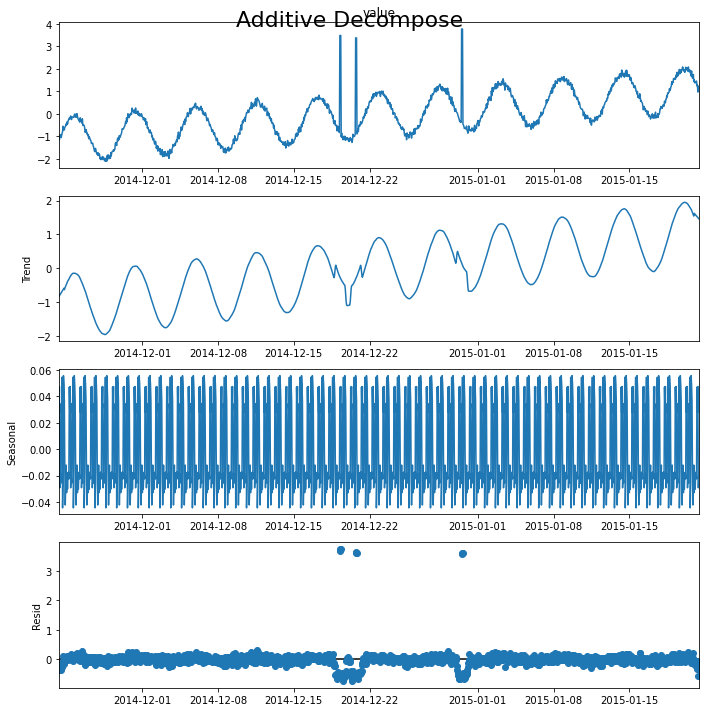



File: A2Benchmarksynthetic_11
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  3.480926           1
2014-12-19 07:00:00  3.480926           1
2014-12-19 08:00:00  3.480926           1
2014-12-20 17:00:00  3.372082           1
2014-12-20 18:00:00  3.372082           1
2014-12-20 19:00:00  3.372082           1
2014-12-30 12:00:00  3.767044           1
2014-12-30 13:00:00  3.767044           1
2014-12-30 14:00:00  3.767044           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  3.688824
624 2014-12-19 07:00:00  3.741715
625 2014-12-19 08:00:00  3.751663
658 2014-12-20 17:00:00  3.638748
659 2014-12-20 18:00:00  3.617800
660 2014-12-20 19:00:00  3.600371
893 2014-12-30 12:00:00  3.575888
894 2014-12-30 13:00:00  3.618063
895 2014-12-30 14:00:00  3.627575
Mean: 70.366661, StandardDeviation: 994.123425
               timestamp       value  is_anomaly
0    2

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_12add_STL


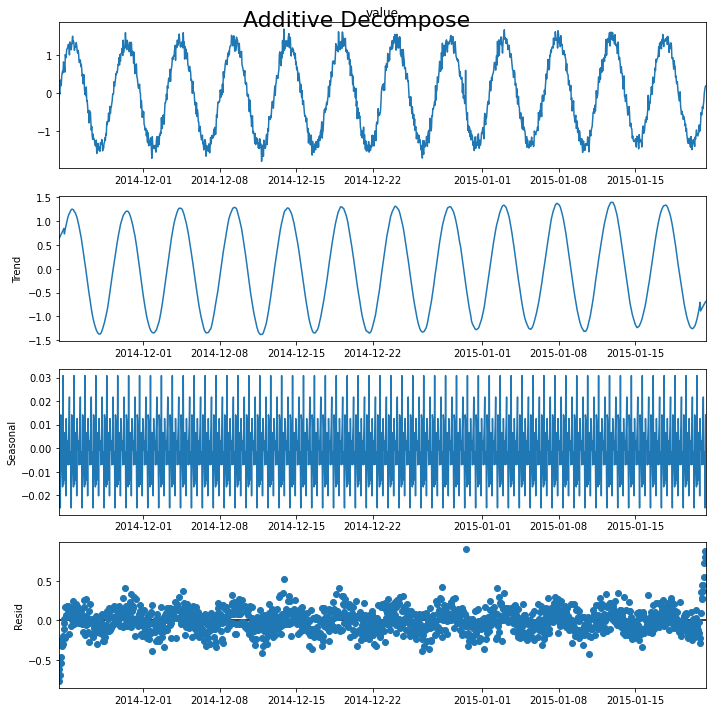



File: A2Benchmarksynthetic_12
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.604069           1
Detected outliers: 7
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.521293
893  2014-12-30 12:00:00  0.904908
1416 2015-01-21 07:00:00  0.549320
1417 2015-01-21 08:00:00  0.723506
1418 2015-01-21 09:00:00  0.805690
1419 2015-01-21 10:00:00  0.884116
1420 2015-01-21 11:00:00  0.864671
Mean: 1399.681750, StandardDeviation: 1305.117440
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   167.353006           0
1    2014-11-23 08:00:00    44.654007           0
2    2014-11-23 09:00:00   346.780724           0
3    2014-11-23 10:00:00   423.856495           0
4    2014-11-23 11:00:00   395.187353           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3089.294936           0
1417 2015-01-21 08:00:00  2589.654340           

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_13add_STL


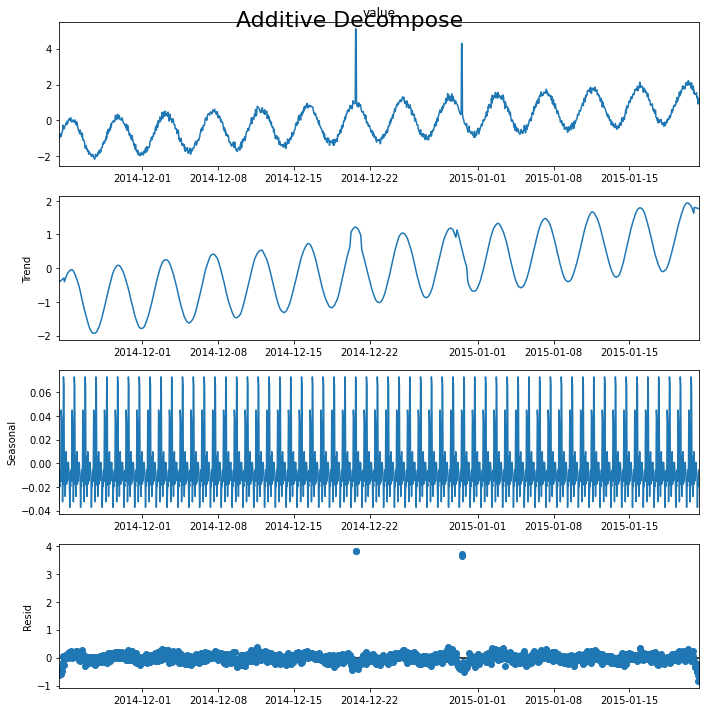



File: A2Benchmarksynthetic_13
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.100373           1
2014-12-20 18:00:00  5.100373           1
2014-12-30 12:00:00  4.287849           1
2014-12-30 13:00:00  4.287849           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  3.805289
659 2014-12-20 18:00:00  3.820420
893 2014-12-30 12:00:00  3.626537
894 2014-12-30 13:00:00  3.694080
Mean: 4873.417218, StandardDeviation: 2960.351286
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   184.728233           0
1    2014-11-23 08:00:00    -4.821284           0
2    2014-11-23 09:00:00   263.194207           0
3    2014-11-23 10:00:00   289.597838           0
4    2014-11-23 11:00:00   203.109403           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  9598.339840           0
1417 2015-01-21 08:00:00  9125.3

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_14add_STL


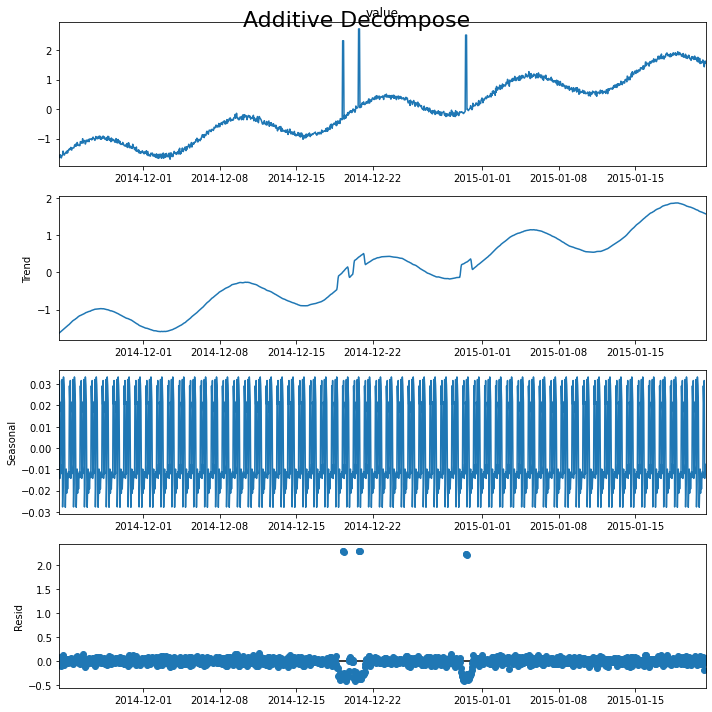



File: A2Benchmarksynthetic_14
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.320077           1
2014-12-19 07:00:00  2.320077           1
2014-12-19 08:00:00  2.320077           1
2014-12-20 17:00:00  2.722561           1
2014-12-20 18:00:00  2.722561           1
2014-12-20 19:00:00  2.722561           1
2014-12-30 12:00:00  2.513307           1
2014-12-30 13:00:00  2.513307           1
2014-12-30 14:00:00  2.513307           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.286676
624 2014-12-19 07:00:00  2.284346
625 2014-12-19 08:00:00  2.260638
658 2014-12-20 17:00:00  2.283556
659 2014-12-20 18:00:00  2.279894
660 2014-12-20 19:00:00  2.279935
893 2014-12-30 12:00:00  2.229762
894 2014-12-30 13:00:00  2.228854
895 2014-12-30 14:00:00  2.209185
Mean: 110.688388, StandardDeviation: 1004.712332
               timestamp       value  is_anomaly
0   

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_15add_STL


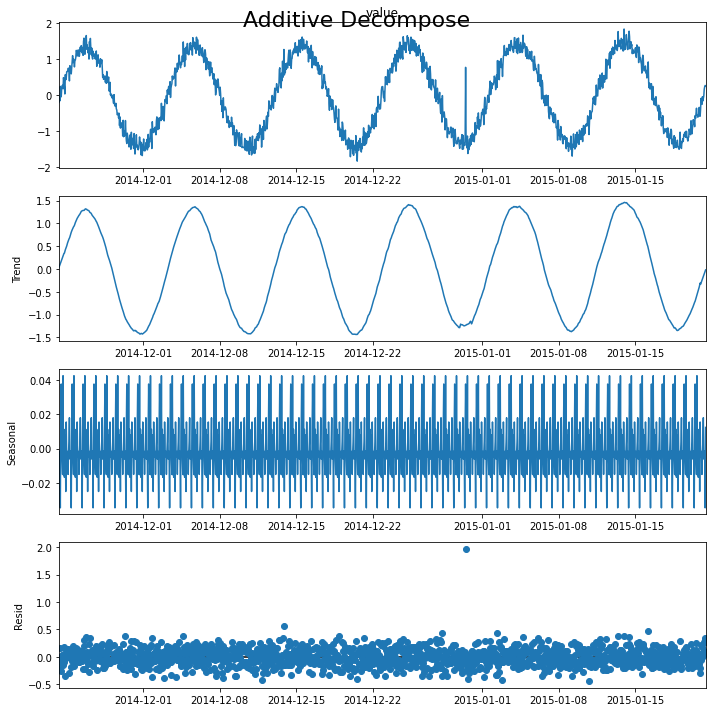



File: A2Benchmarksynthetic_15
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.770344           1
Detected outliers: 2
Outliers:
              timestamp     resid
494 2014-12-13 21:00:00  0.553079
893 2014-12-30 12:00:00  1.964553
Mean: 3191.408691, StandardDeviation: 2074.503331
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   207.726035           0
1    2014-11-23 08:00:00     2.708866           0
2    2014-11-23 09:00:00   320.121007           0
3    2014-11-23 10:00:00   361.573087           0
4    2014-11-23 11:00:00   274.004645           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  6476.736575           0
1417 2015-01-21 08:00:00  5919.104142           0
1418 2015-01-21 09:00:00  6345.859032           0
1419 2015-01-21 10:00:00  6546.145013           0
1420 2015-01-21 11:00:00  6320.390090           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_16add_STL


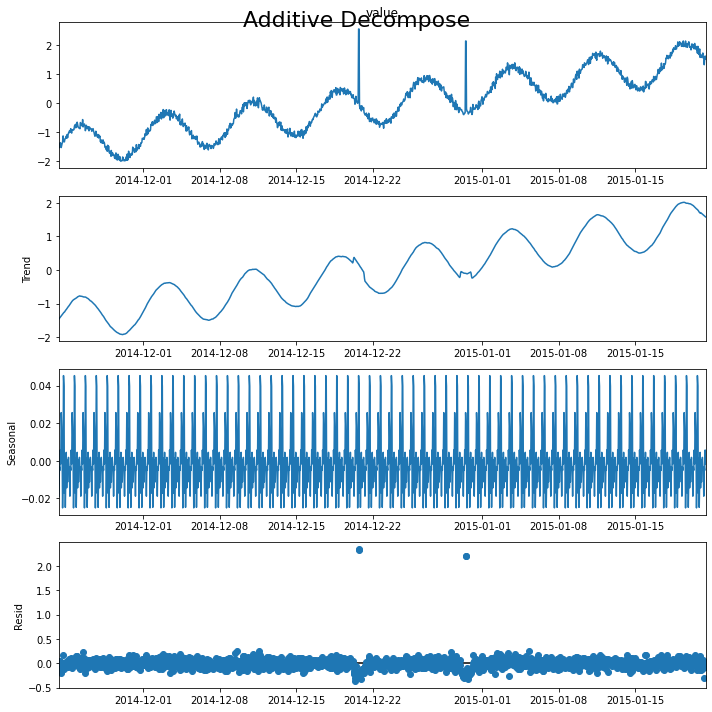



File: A2Benchmarksynthetic_16
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.544810           1
2014-12-20 18:00:00  2.544810           1
2014-12-30 12:00:00  2.131365           1
2014-12-30 13:00:00  2.131365           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.321884
659 2014-12-20 18:00:00  2.351360
893 2014-12-30 12:00:00  2.202763
894 2014-12-30 13:00:00  2.214161
Mean: 299.954448, StandardDeviation: 1024.294474
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  216.370595           0
1    2014-11-23 08:00:00    0.762393           0
2    2014-11-23 09:00:00  339.998476           0
3    2014-11-23 10:00:00  386.066099           0
4    2014-11-23 11:00:00  294.997672           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00  427.016575           0
1417 2015-01-21 08:00:00  -65.290041     

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_17add_STL


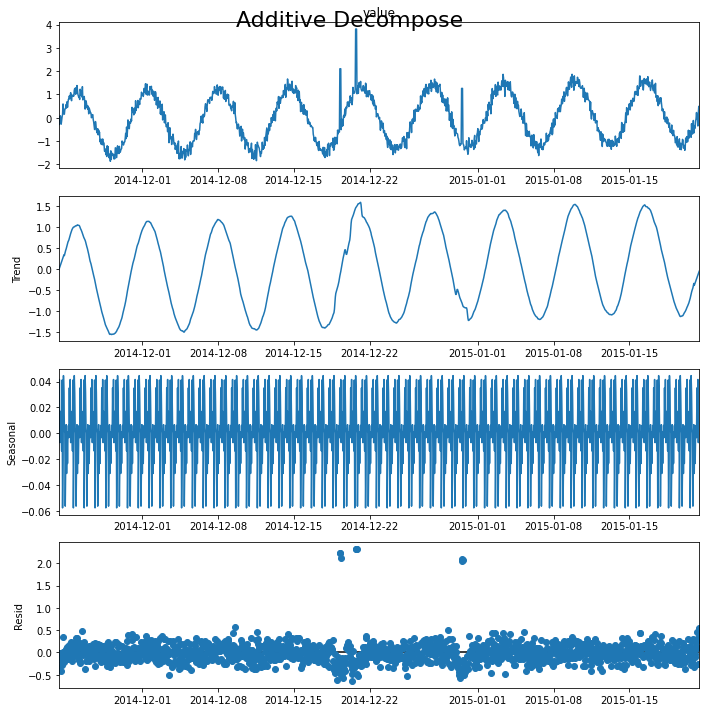



File: A2Benchmarksynthetic_17
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.103996           1
2014-12-19 07:00:00  2.103996           1
2014-12-19 08:00:00  2.103996           1
2014-12-20 17:00:00  3.814266           1
2014-12-20 18:00:00  3.814266           1
2014-12-20 19:00:00  3.814266           1
2014-12-30 12:00:00  1.260559           1
2014-12-30 13:00:00  1.260559           1
2014-12-30 14:00:00  1.260559           1
Detected outliers: 12
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.580740
623  2014-12-19 06:00:00  2.233107
624  2014-12-19 07:00:00  2.217607
625  2014-12-19 08:00:00  2.123253
658  2014-12-20 17:00:00  2.310747
659  2014-12-20 18:00:00  2.308735
660  2014-12-20 19:00:00  2.320300
862  2014-12-29 05:00:00  0.509084
893  2014-12-30 12:00:00  2.044445
894  2014-12-30 13:00:00  2.090815
895  2014-12-30 14:00:00  2.070218
1419 2015-01-21 10:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_18add_STL


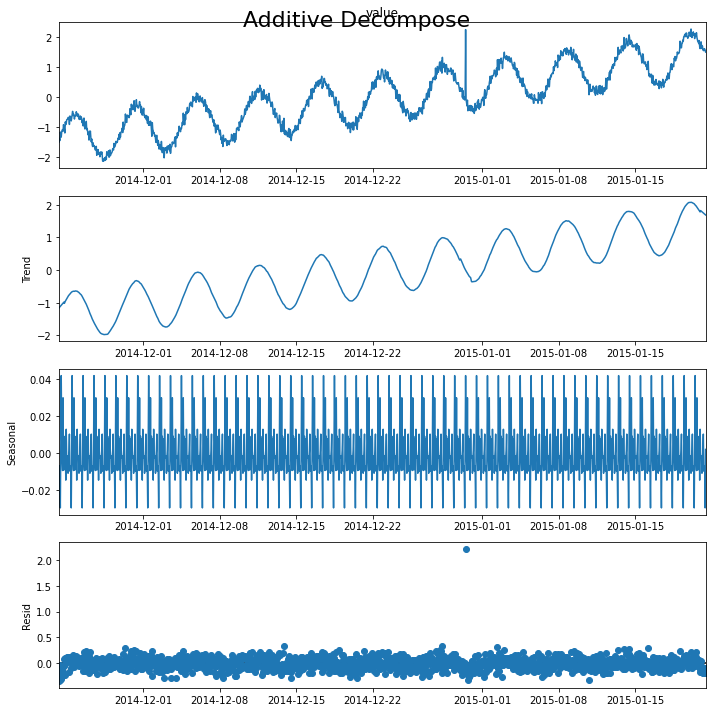



File: A2Benchmarksynthetic_18
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.254806           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.214789
Mean: 362.532163, StandardDeviation: 1021.057616
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  241.730372           0
1    2014-11-23 08:00:00   13.002987           0
2    2014-11-23 09:00:00  403.903242           0
3    2014-11-23 10:00:00  467.125337           0
4    2014-11-23 11:00:00  376.841672           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00  505.374338           0
1417 2015-01-21 08:00:00  -33.075959           0
1418 2015-01-21 09:00:00  597.094994           0
1419 2015-01-21 10:00:00  959.137435           0
1420 2015-01-21 11:00:00  816.022583           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_19add_STL


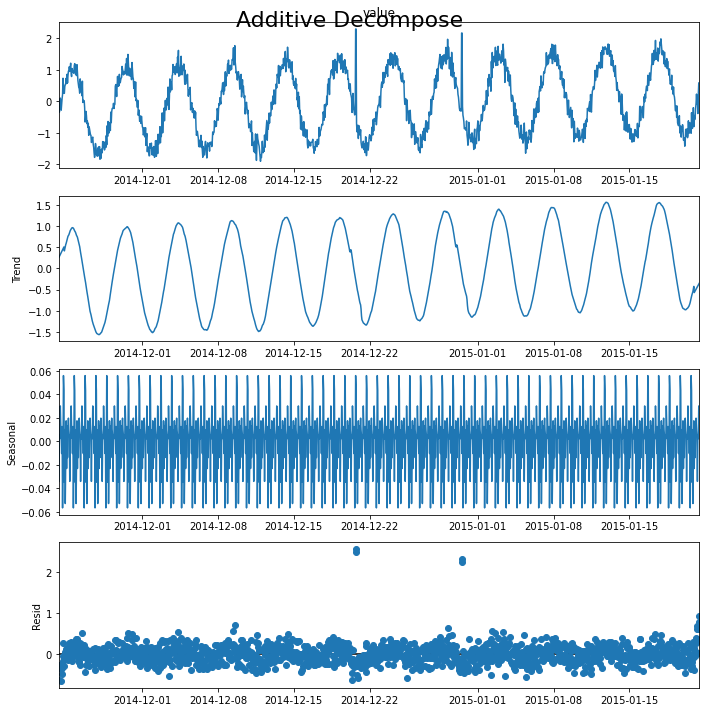



File: A2Benchmarksynthetic_19
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.290352           1
2014-12-20 18:00:00  2.290352           1
2014-12-30 12:00:00  2.162908           1
2014-12-30 13:00:00  2.162908           1
Detected outliers: 19
Outliers:
               timestamp     resid
52   2014-11-25 11:00:00  0.510236
153  2014-11-29 16:00:00  0.528006
162  2014-11-30 01:00:00  0.505150
265  2014-12-04 08:00:00  0.530395
387  2014-12-09 10:00:00  0.558331
390  2014-12-09 13:00:00  0.723112
658  2014-12-20 17:00:00  2.490710
659  2014-12-20 18:00:00  2.576010
862  2014-12-29 05:00:00  0.633068
893  2014-12-30 12:00:00  2.255597
894  2014-12-30 13:00:00  2.340555
961  2015-01-02 08:00:00  0.557982
968  2015-01-02 15:00:00  0.519019
985  2015-01-03 08:00:00  0.549966
1414 2015-01-21 05:00:00  0.690044
1416 2015-01-21 07:00:00  0.604629
1418 2015-01-21 09:00:00  0.618237
1419 2015-01-21 10:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_2add_STL


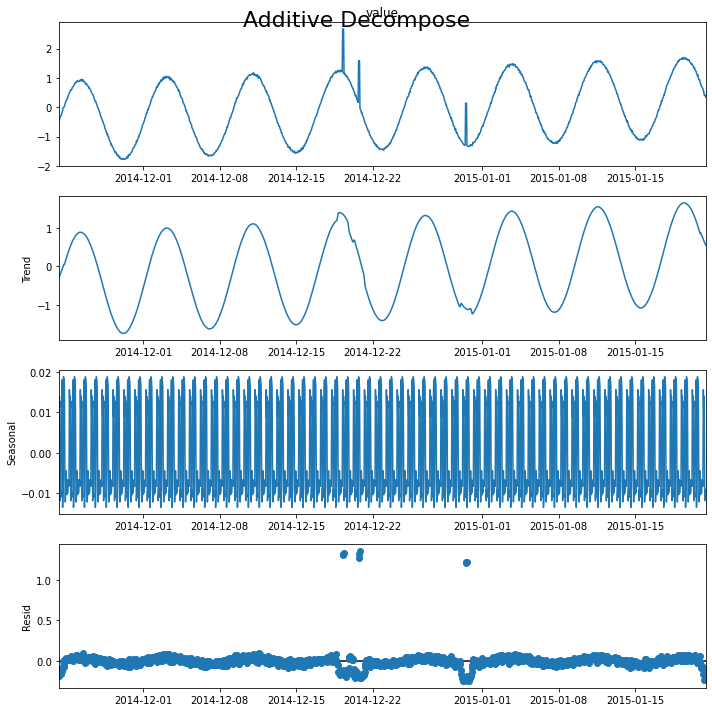



File: A2Benchmarksynthetic_2
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.673989           1
2014-12-19 07:00:00  2.673989           1
2014-12-19 08:00:00  2.673989           1
2014-12-20 17:00:00  1.588931           1
2014-12-20 18:00:00  1.588931           1
2014-12-20 19:00:00  1.588931           1
2014-12-30 12:00:00  0.141373           1
2014-12-30 13:00:00  0.141373           1
2014-12-30 14:00:00  0.141373           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  1.304327
624 2014-12-19 07:00:00  1.322486
625 2014-12-19 08:00:00  1.329592
658 2014-12-20 17:00:00  1.270474
659 2014-12-20 18:00:00  1.315454
660 2014-12-20 19:00:00  1.361520
893 2014-12-30 12:00:00  1.215138
894 2014-12-30 13:00:00  1.225196
895 2014-12-30 14:00:00  1.225835
Mean: 1995.674055, StandardDeviation: 1534.256092
               timestamp        value  is_anomaly
0  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_20add_STL


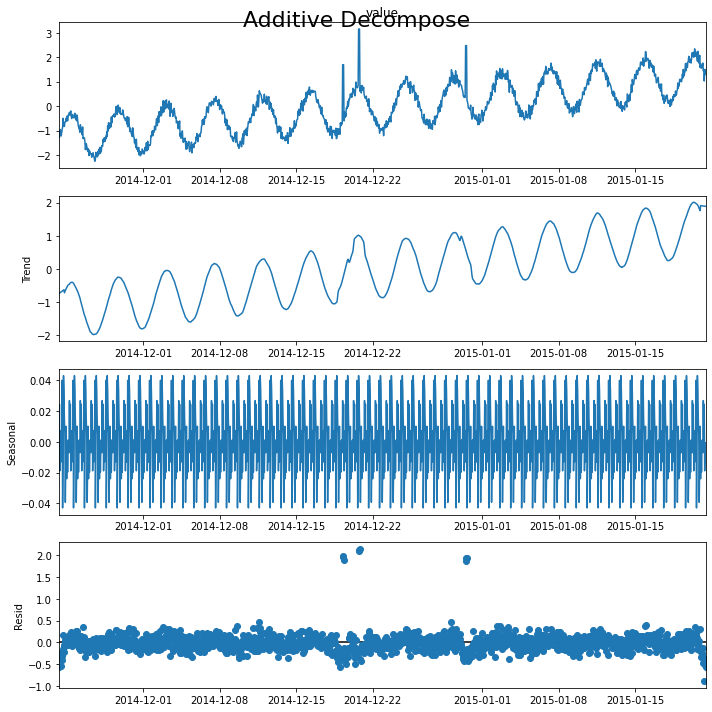



File: A2Benchmarksynthetic_20
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  1.694426           1
2014-12-19 07:00:00  1.694426           1
2014-12-19 08:00:00  1.694426           1
2014-12-20 17:00:00  3.156465           1
2014-12-20 18:00:00  3.156465           1
2014-12-20 19:00:00  3.156465           1
2014-12-30 12:00:00  2.475857           1
2014-12-30 13:00:00  2.475857           1
2014-12-30 14:00:00  2.475857           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  1.976275
624 2014-12-19 07:00:00  1.963655
625 2014-12-19 08:00:00  1.882537
658 2014-12-20 17:00:00  2.099450
659 2014-12-20 18:00:00  2.117918
660 2014-12-20 19:00:00  2.147444
893 2014-12-30 12:00:00  1.876114
894 2014-12-30 13:00:00  1.938604
895 2014-12-30 14:00:00  1.949961
Mean: 7282.327986, StandardDeviation: 4298.843109


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -122.097268           0
1    2014-11-23 08:00:00     86.791975           0
2    2014-11-23 09:00:00    -90.326707           0
3    2014-11-23 10:00:00    460.520779           0
4    2014-11-23 11:00:00    231.335134           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  14416.503266           0
1417 2015-01-21 08:00:00  14613.110972           0
1418 2015-01-21 09:00:00  14638.354905           0
1419 2015-01-21 10:00:00  14618.454059           0
1420 2015-01-21 11:00:00  14536.635241           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_21add_STL


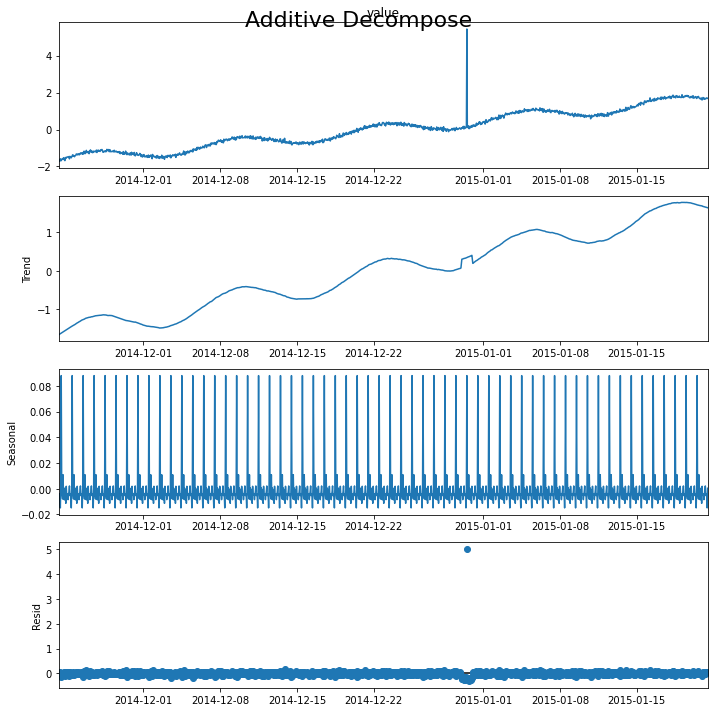



File: A2Benchmarksynthetic_21
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.445587           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.013185
Mean: 480.352675, StandardDeviation: 1013.895439
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   279.790955           0
1    2014-11-23 08:00:00   -33.577684           0
2    2014-11-23 09:00:00   370.221164           0
3    2014-11-23 10:00:00   395.305678           0
4    2014-11-23 11:00:00   243.419322           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00   908.846316           0
1417 2015-01-21 08:00:00   238.400663           0
1418 2015-01-21 09:00:00   919.483595           0
1419 2015-01-21 10:00:00  1289.891987           0
1420 2015-01-21 11:00:00  1075.582876           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_22add_STL


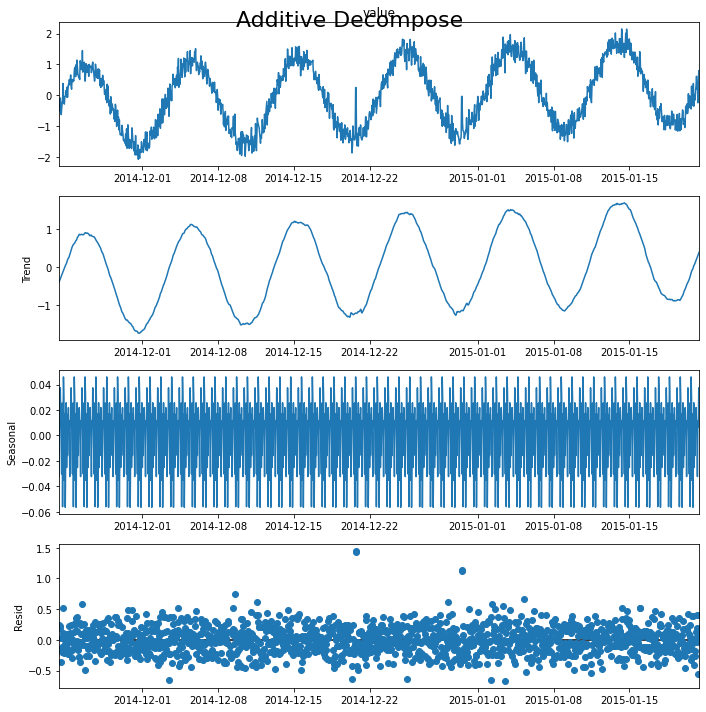



File: A2Benchmarksynthetic_22
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  0.253864           1
2014-12-20 18:00:00  0.253864           1
2014-12-30 12:00:00 -0.033395           1
2014-12-30 13:00:00 -0.033395           1
Detected outliers: 19
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.520624
52   2014-11-25 11:00:00  0.577330
265  2014-12-04 08:00:00  0.522155
387  2014-12-09 10:00:00  0.525323
390  2014-12-09 13:00:00  0.740203
440  2014-12-11 15:00:00  0.617825
658  2014-12-20 17:00:00  1.426831
659  2014-12-20 18:00:00  1.448206
862  2014-12-29 05:00:00  0.617578
893  2014-12-30 12:00:00  1.125472
894  2014-12-30 13:00:00  1.145680
909  2014-12-31 04:00:00  0.503498
961  2015-01-02 08:00:00  0.579775
968  2015-01-02 15:00:00  0.510930
985  2015-01-03 08:00:00  0.559901
1032 2015-01-05 07:00:00  0.663284
1248 2015-01-14 07:00:00  0.516264
1288 2015-01-15 23:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_23add_STL


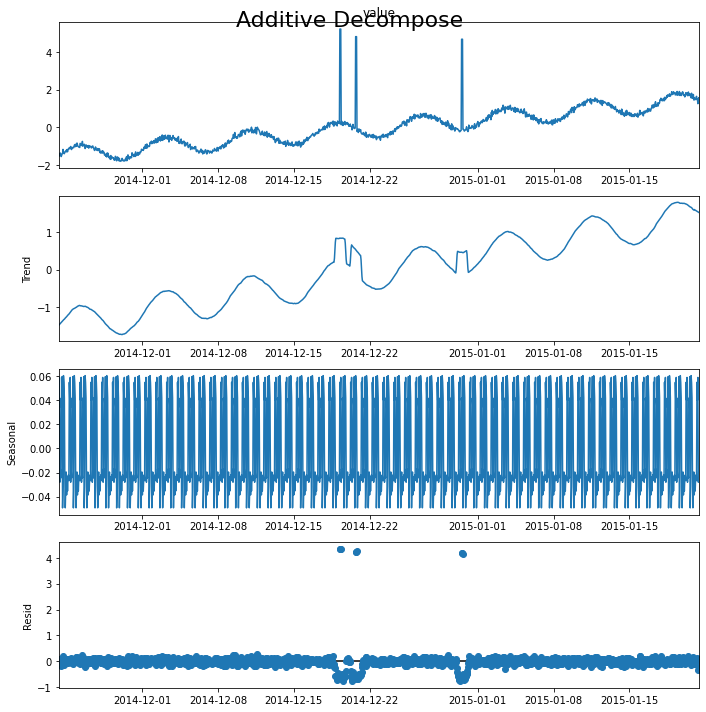



File: A2Benchmarksynthetic_23
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  5.219308           1
2014-12-19 07:00:00  5.219308           1
2014-12-19 08:00:00  5.219308           1
2014-12-20 17:00:00  4.813770           1
2014-12-20 18:00:00  4.813770           1
2014-12-20 19:00:00  4.813770           1
2014-12-30 12:00:00  4.676965           1
2014-12-30 13:00:00  4.676965           1
2014-12-30 14:00:00  4.676965           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.328168
624 2014-12-19 07:00:00  4.345846
625 2014-12-19 08:00:00  4.327784
658 2014-12-20 17:00:00  4.220636
659 2014-12-20 18:00:00  4.244184
660 2014-12-20 19:00:00  4.273628
893 2014-12-30 12:00:00  4.174008
894 2014-12-30 13:00:00  4.184441
895 2014-12-30 14:00:00  4.163538
Mean: 281.561558, StandardDeviation: 1014.996111
               timestamp       value  is_anomaly
0   

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_24add_STL


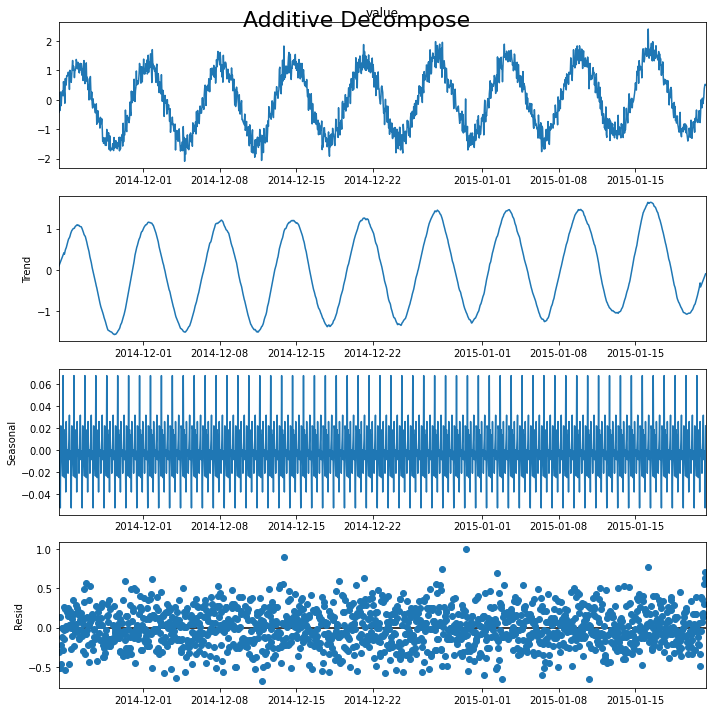



File: A2Benchmarksynthetic_24
threshold:0.5
Actual Outliers: 1
                      value  is_anomaly
timestamp                              
2014-12-30 12:00:00  0.0314           1
Detected outliers: 29
Outliers:
               timestamp     resid
60   2014-11-25 19:00:00  0.563138
69   2014-11-26 04:00:00  0.524147
146  2014-11-29 09:00:00  0.597933
205  2014-12-01 20:00:00  0.613729
273  2014-12-04 16:00:00  0.506717
349  2014-12-07 20:00:00  0.532335
484  2014-12-13 11:00:00  0.506084
485  2014-12-13 12:00:00  0.536728
491  2014-12-13 18:00:00  0.556317
494  2014-12-13 21:00:00  0.891118
614  2014-12-18 21:00:00  0.589770
652  2014-12-20 11:00:00  0.540179
669  2014-12-21 04:00:00  0.632875
827  2014-12-27 18:00:00  0.550286
836  2014-12-28 03:00:00  0.540503
842  2014-12-28 09:00:00  0.741279
893  2014-12-30 12:00:00  0.999042
963  2015-01-02 10:00:00  0.693478
978  2015-01-03 01:00:00  0.540092
1019 2015-01-04 18:00:00  0.543419
1188 2015-01-11 19:00:00  0.503044
1228 2015-01-

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_25add_STL


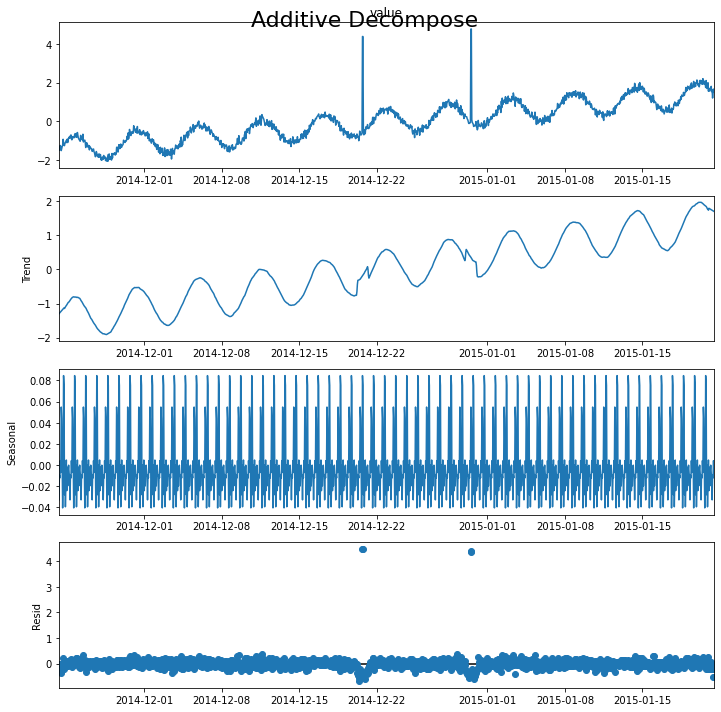



File: A2Benchmarksynthetic_25
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  4.382979           1
2014-12-20 18:00:00  4.382979           1
2014-12-30 12:00:00  4.771106           1
2014-12-30 13:00:00  4.771106           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.479447
659 2014-12-20 18:00:00  4.473660
893 2014-12-30 12:00:00  4.357858
894 2014-12-30 13:00:00  4.392092
Mean: 677.021695, StandardDeviation: 1078.857833
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   330.577449           0
1    2014-11-23 08:00:00    -8.952793           0
2    2014-11-23 09:00:00   498.310024           0
3    2014-11-23 10:00:00   557.956500           0
4    2014-11-23 11:00:00   408.067961           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1159.791552           0
1417 2015-01-21 08:00:00   397.48

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_26add_STL


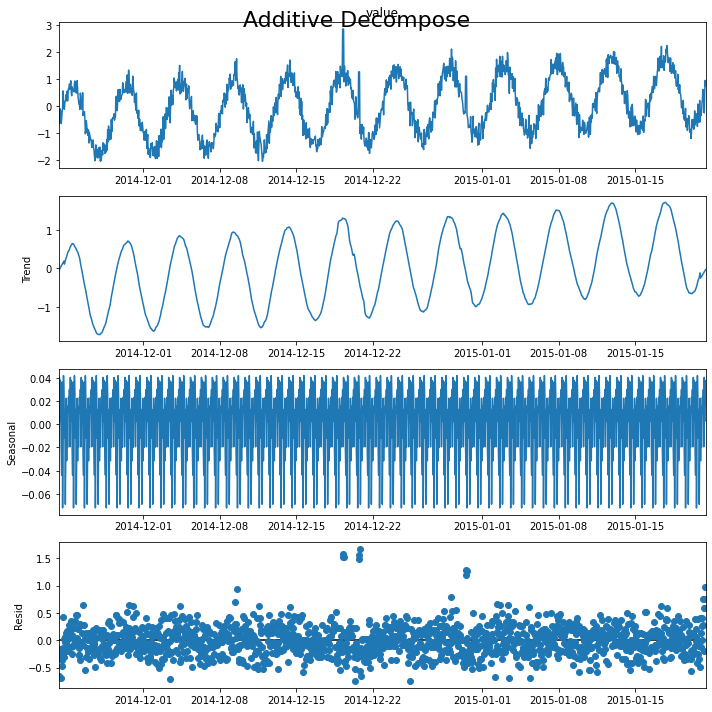



File: A2Benchmarksynthetic_26
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.853780           1
2014-12-19 07:00:00  2.853780           1
2014-12-19 08:00:00  2.853780           1
2014-12-20 17:00:00  1.265167           1
2014-12-20 18:00:00  1.265167           1
2014-12-20 19:00:00  1.265167           1
2014-12-30 12:00:00  1.101959           1
2014-12-30 13:00:00  1.101959           1
2014-12-30 14:00:00  1.101959           1
Detected outliers: 39
Outliers:
               timestamp     resid
52   2014-11-25 11:00:00  0.649922
150  2014-11-29 13:00:00  0.509870
153  2014-11-29 16:00:00  0.651173
162  2014-11-30 01:00:00  0.631780
265  2014-12-04 08:00:00  0.620682
387  2014-12-09 10:00:00  0.691914
390  2014-12-09 13:00:00  0.935120
440  2014-12-11 15:00:00  0.630923
507  2014-12-14 10:00:00  0.607359
608  2014-12-18 15:00:00  0.516726
623  2014-12-19 06:00:00  1.516674
624  2014-12-19 07:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_27add_STL


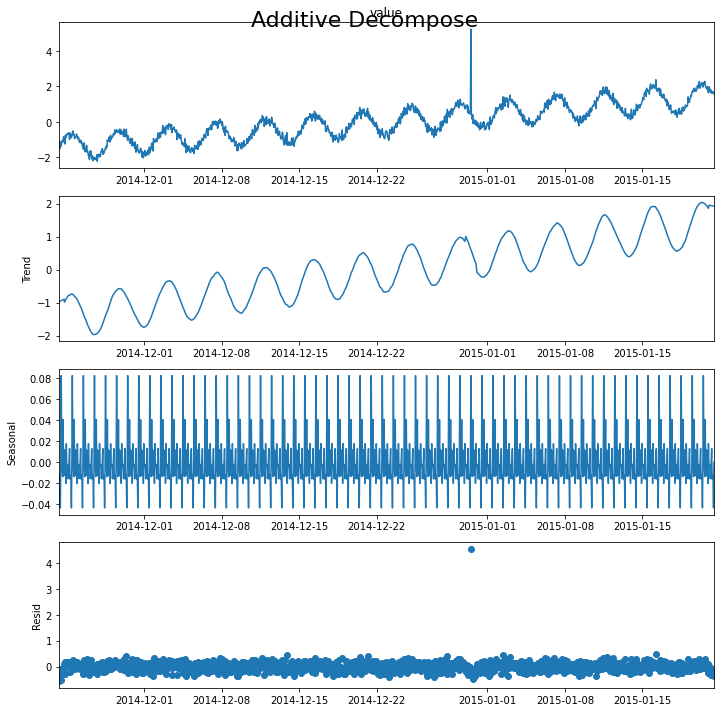



File: A2Benchmarksynthetic_27
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.229278           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.541667
Mean: 9202.203480, StandardDeviation: 5383.176339
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    367.646826           0
1    2014-11-23 08:00:00    -38.283968           0
2    2014-11-23 09:00:00    467.681082           0
3    2014-11-23 10:00:00    492.157914           0
4    2014-11-23 11:00:00    291.684169           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  18310.202361           0
1417 2015-01-21 08:00:00  17394.768033           0
1418 2015-01-21 09:00:00  18197.660173           0
1419 2015-01-21 10:00:00  18605.443064           0
1420 2015-01-21 11:00:00  18269.717263           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_28add_STL


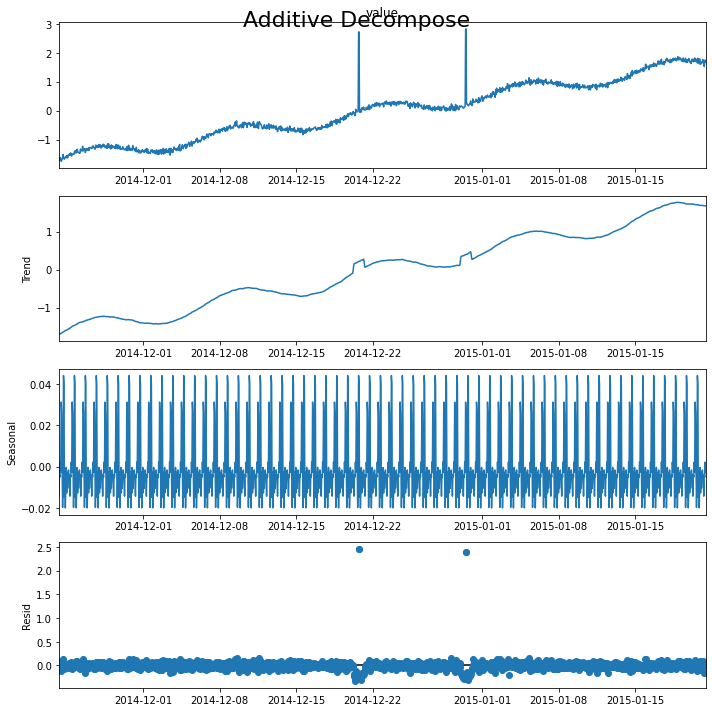



File: A2Benchmarksynthetic_28
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.716944           1
2014-12-20 18:00:00  2.716944           1
2014-12-30 12:00:00  2.818085           1
2014-12-30 13:00:00  2.818085           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.459186
659 2014-12-20 18:00:00  2.459552
893 2014-12-30 12:00:00  2.391466
894 2014-12-30 13:00:00  2.393025
Mean: 853.154308, StandardDeviation: 1095.773774
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   368.696606           0
1    2014-11-23 08:00:00   -55.416317           0
2    2014-11-23 09:00:00   464.803666           0
3    2014-11-23 10:00:00   486.371135           0
4    2014-11-23 11:00:00   274.938478           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1646.262217           0
1417 2015-01-21 08:00:00   752.02

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_29add_STL


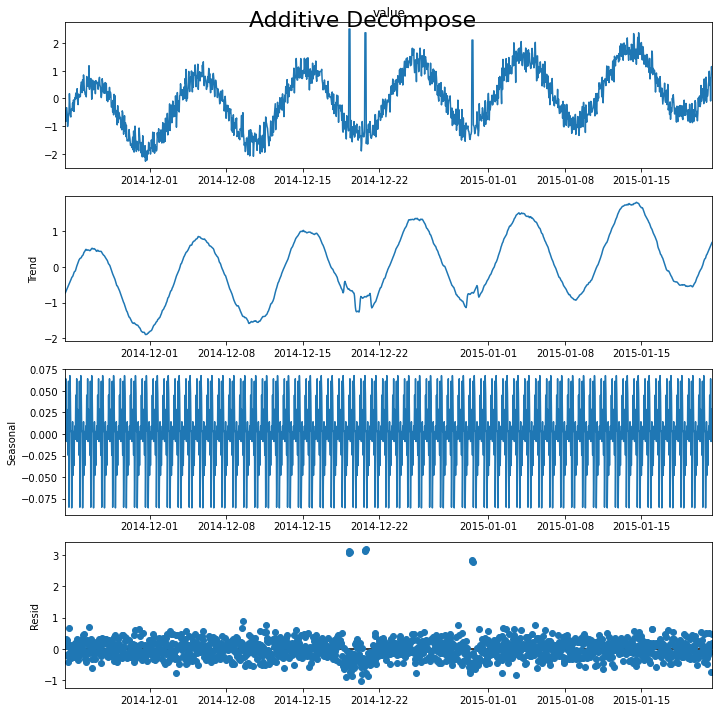



File: A2Benchmarksynthetic_29
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.506368           1
2014-12-19 07:00:00  2.506368           1
2014-12-19 08:00:00  2.506368           1
2014-12-20 17:00:00  2.369639           1
2014-12-20 18:00:00  2.369639           1
2014-12-20 19:00:00  2.369639           1
2014-12-30 12:00:00  2.106412           1
2014-12-30 13:00:00  2.106412           1
2014-12-30 14:00:00  2.106412           1
Detected outliers: 43
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.660854
52   2014-11-25 11:00:00  0.713651
153  2014-11-29 16:00:00  0.612984
162  2014-11-30 01:00:00  0.618318
229  2014-12-02 20:00:00  0.565982
265  2014-12-04 08:00:00  0.581557
303  2014-12-05 22:00:00  0.583048
387  2014-12-09 10:00:00  0.662057
390  2014-12-09 13:00:00  0.894954
427  2014-12-11 02:00:00  0.582609
436  2014-12-11 11:00:00  0.523226
440  2014-12-11 15:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_3add_STL


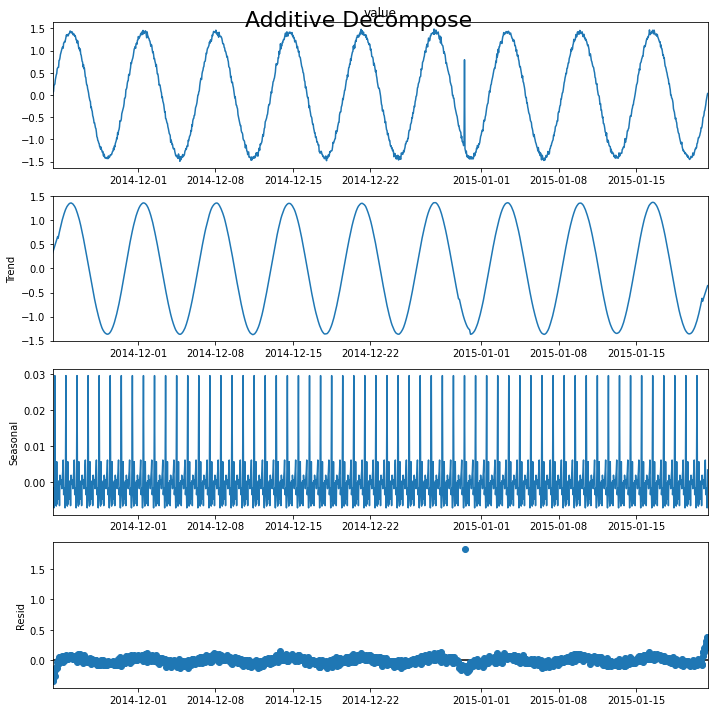



File: A2Benchmarksynthetic_3
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.794893           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  1.830217
Mean: 5950.417354, StandardDeviation: 3552.981132
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -180.280563           0
1    2014-11-23 08:00:00    118.292354           0
2    2014-11-23 09:00:00   -133.825972           0
3    2014-11-23 10:00:00    652.458040           0
4    2014-11-23 11:00:00    325.887404           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  11942.906157           0
1417 2015-01-21 08:00:00  12210.795268           0
1418 2015-01-21 09:00:00  12234.121089           0
1419 2015-01-21 10:00:00  12192.975338           0
1420 2015-01-21 11:00:00  12063.465718           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_30add_STL


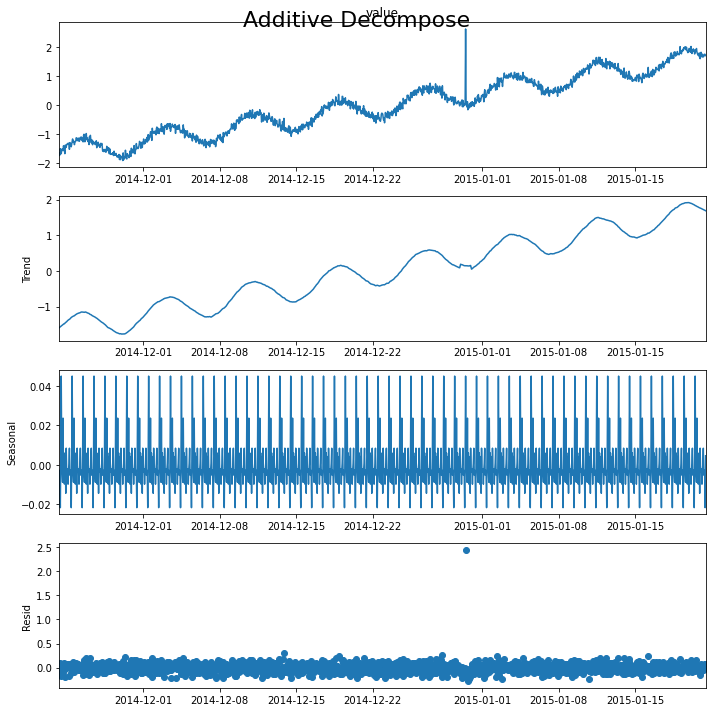



File: A2Benchmarksynthetic_30
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.638754           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.447457
Mean: 959.394771, StandardDeviation: 1155.849408


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   394.123324           0
1    2014-11-23 08:00:00   -43.032020           0
2    2014-11-23 09:00:00   528.987760           0
3    2014-11-23 10:00:00   567.962720           0
4    2014-11-23 11:00:00   357.743117           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1818.849690           0
1417 2015-01-21 08:00:00   878.892797           0
1418 2015-01-21 09:00:00  1841.014851           0
1419 2015-01-21 10:00:00  2366.046251           0
1420 2015-01-21 11:00:00  2068.291420           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_31add_STL


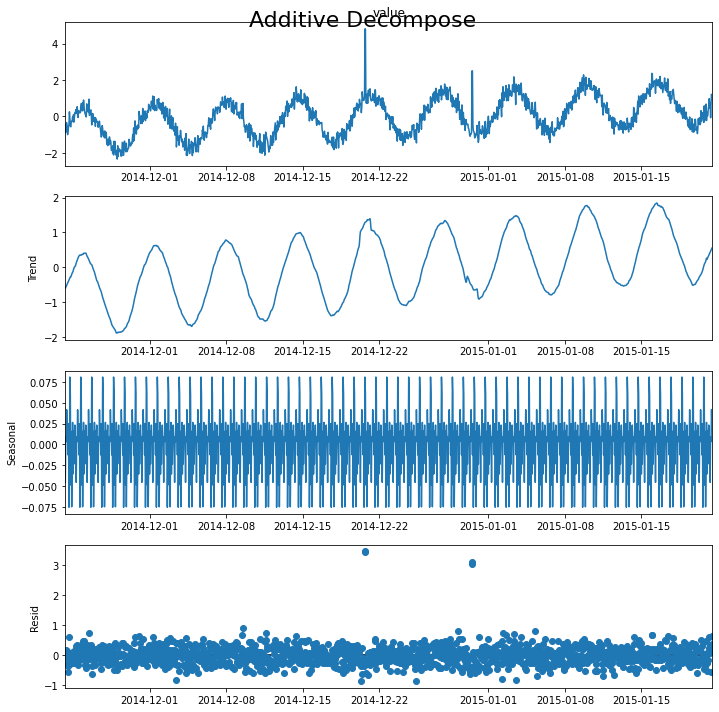



File: A2Benchmarksynthetic_31
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  4.810664           1
2014-12-20 18:00:00  4.810664           1
2014-12-30 12:00:00  2.504158           1
2014-12-30 13:00:00  2.504158           1
Detected outliers: 44
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.601638
52   2014-11-25 11:00:00  0.728642
153  2014-11-29 16:00:00  0.618920
162  2014-11-30 01:00:00  0.640955
170  2014-11-30 09:00:00  0.530632
192  2014-12-01 07:00:00  0.598285
229  2014-12-02 20:00:00  0.579578
265  2014-12-04 08:00:00  0.588821
303  2014-12-05 22:00:00  0.535320
387  2014-12-09 10:00:00  0.687937
390  2014-12-09 13:00:00  0.920031
427  2014-12-11 02:00:00  0.553476
440  2014-12-11 15:00:00  0.746885
461  2014-12-12 12:00:00  0.508204
487  2014-12-13 14:00:00  0.513233
507  2014-12-14 10:00:00  0.626519
533  2014-12-15 12:00:00  0.504377
658  2014-12-20 17:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_32add_STL


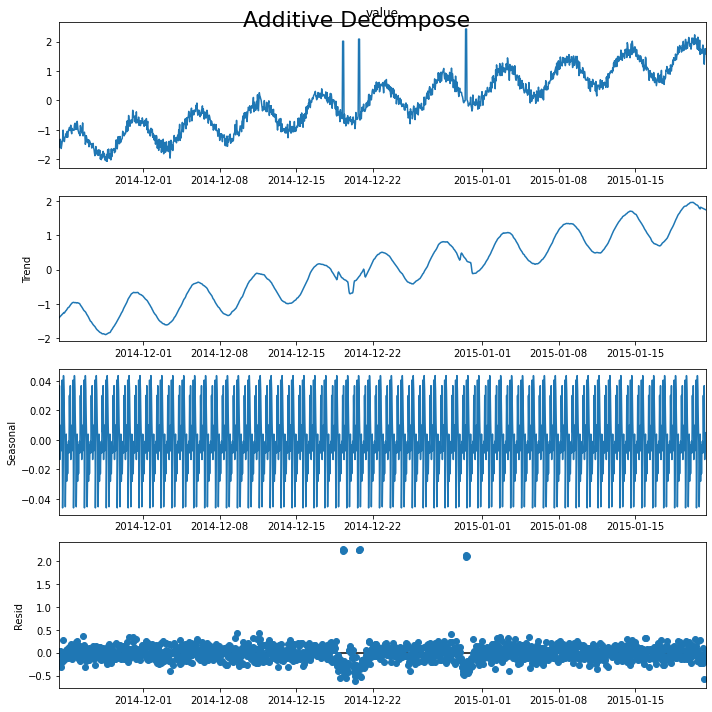



File: A2Benchmarksynthetic_32
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.011083           1
2014-12-19 07:00:00  2.011083           1
2014-12-19 08:00:00  2.011083           1
2014-12-20 17:00:00  2.082462           1
2014-12-20 18:00:00  2.082462           1
2014-12-20 19:00:00  2.082462           1
2014-12-30 12:00:00  2.426199           1
2014-12-30 13:00:00  2.426199           1
2014-12-30 14:00:00  2.426199           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.225130
624 2014-12-19 07:00:00  2.268422
625 2014-12-19 08:00:00  2.250446
658 2014-12-20 17:00:00  2.251123
659 2014-12-20 18:00:00  2.249546
660 2014-12-20 19:00:00  2.256528
893 2014-12-30 12:00:00  2.098356
894 2014-12-30 13:00:00  2.131279
895 2014-12-30 14:00:00  2.112369
Mean: 533.967462, StandardDeviation: 1069.884522
               timestamp        value  is_anomaly
0  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_33add_STL


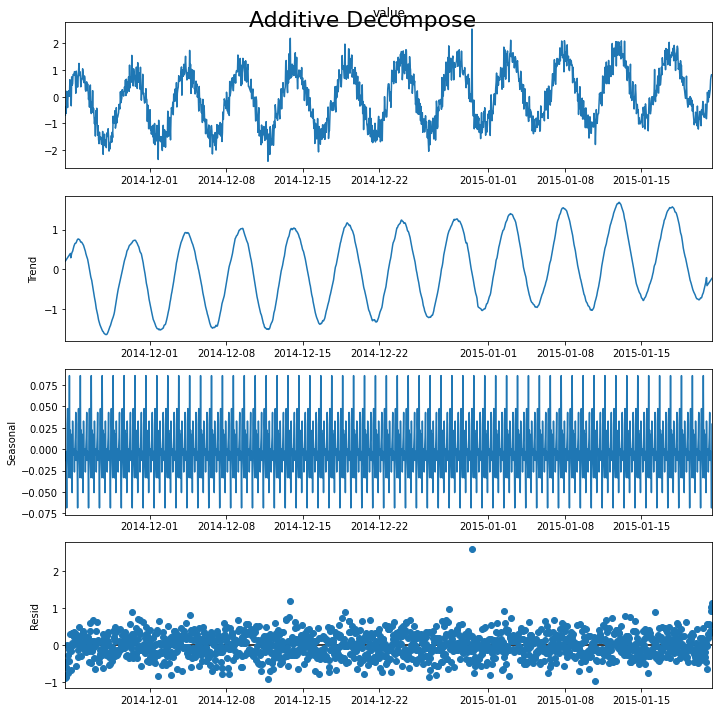



File: A2Benchmarksynthetic_33
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.540857           1
Detected outliers: 84
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.600060
60   2014-11-25 19:00:00  0.684625
69   2014-11-26 04:00:00  0.612549
141  2014-11-29 04:00:00  0.579407
146  2014-11-29 09:00:00  0.897084
...                  ...       ...
1416 2015-01-21 07:00:00  0.553591
1417 2015-01-21 08:00:00  0.909445
1418 2015-01-21 09:00:00  1.030441
1419 2015-01-21 10:00:00  1.141206
1420 2015-01-21 11:00:00  1.002848

[84 rows x 2 columns]
Mean: 2873.685166, StandardDeviation: 1957.027297
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   434.656572           0
1    2014-11-23 08:00:00   -19.688669           0
2    2014-11-23 09:00:00   632.288066           0
3    2014-11-23 10:00:00   699.399314           0
4    2014-11-23 11:00:00   492.677

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_34add_STL


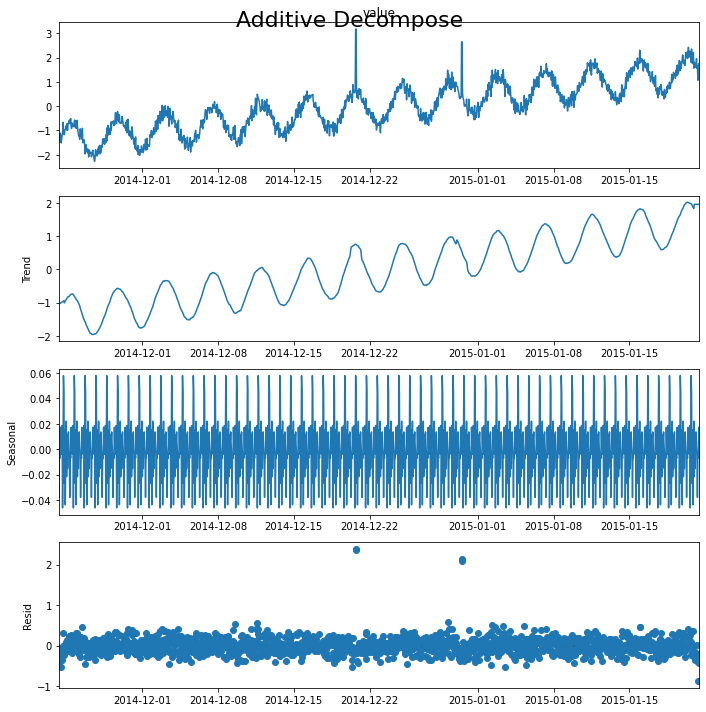



File: A2Benchmarksynthetic_34
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  3.175623           1
2014-12-20 18:00:00  3.175623           1
2014-12-30 12:00:00  2.648310           1
2014-12-30 13:00:00  2.648310           1
Detected outliers: 8
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.528567
440 2014-12-11 15:00:00  0.564329
658 2014-12-20 17:00:00  2.363915
659 2014-12-20 18:00:00  2.387377
862 2014-12-29 05:00:00  0.569166
893 2014-12-30 12:00:00  2.076552
894 2014-12-30 13:00:00  2.133641
961 2015-01-02 08:00:00  0.513981
Mean: 11410.899789, StandardDeviation: 7069.718250
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    458.901115           0
1    2014-11-23 08:00:00    -55.425325           0
2    2014-11-23 09:00:00    569.309498           0
3    2014-11-23 10:00:00    592.617923           0
4    2014-11-23 11:00:00    334.946515  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_35add_STL


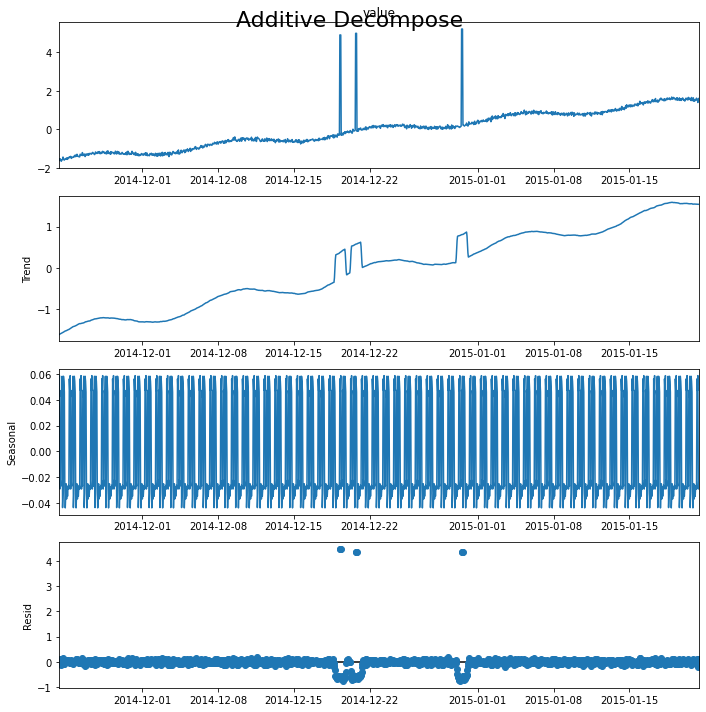



File: A2Benchmarksynthetic_35
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.892303           1
2014-12-19 07:00:00  4.892303           1
2014-12-19 08:00:00  4.892303           1
2014-12-20 17:00:00  4.977022           1
2014-12-20 18:00:00  4.977022           1
2014-12-20 19:00:00  4.977022           1
2014-12-30 12:00:00  5.200080           1
2014-12-30 13:00:00  5.200080           1
2014-12-30 14:00:00  5.200080           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.465019
624 2014-12-19 07:00:00  4.468640
625 2014-12-19 08:00:00  4.449730
658 2014-12-20 17:00:00  4.346615
659 2014-12-20 18:00:00  4.347828
660 2014-12-20 19:00:00  4.352873
893 2014-12-30 12:00:00  4.349485
894 2014-12-30 13:00:00  4.351485
895 2014-12-30 14:00:00  4.334026
Processing index: 30 of 100
Mean: 634.296881, StandardDeviation: 1095.076584
               timestamp 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_36add_STL


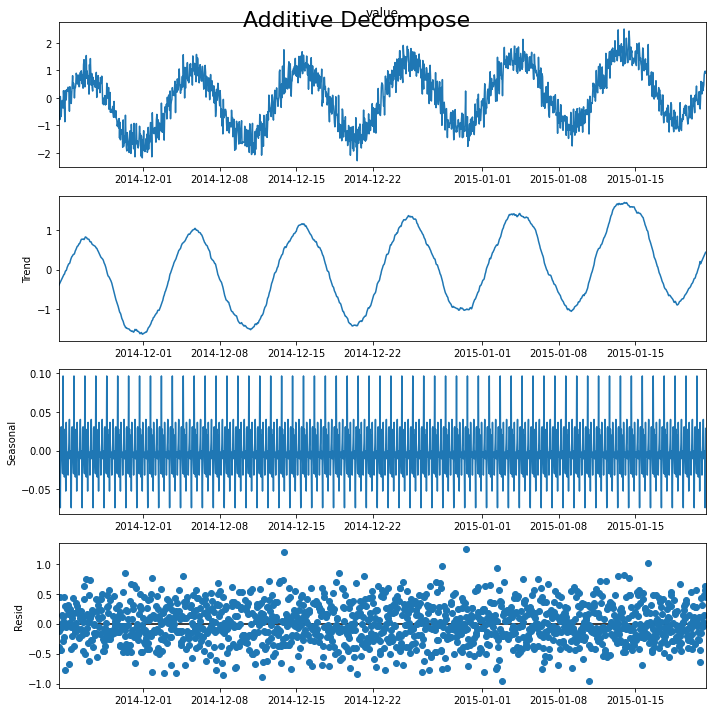



File: A2Benchmarksynthetic_36
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.250416           1
Detected outliers: 93
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.634176
60   2014-11-25 19:00:00  0.753635
69   2014-11-26 04:00:00  0.723792
109  2014-11-27 20:00:00  0.567187
141  2014-11-29 04:00:00  0.522568
...                  ...       ...
1364 2015-01-19 03:00:00  0.663696
1388 2015-01-20 03:00:00  0.530601
1400 2015-01-20 15:00:00  0.569722
1418 2015-01-21 09:00:00  0.560921
1419 2015-01-21 10:00:00  0.631954

[93 rows x 2 columns]
Mean: 6556.232773, StandardDeviation: 4013.701672
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    477.625219           0
1    2014-11-23 08:00:00    -56.442572           0
2    2014-11-23 09:00:00    613.415204           0
3    2014-11-23 10:00:00    647.498380           0
4    2014-11-23 11:00:00    3

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_37add_STL


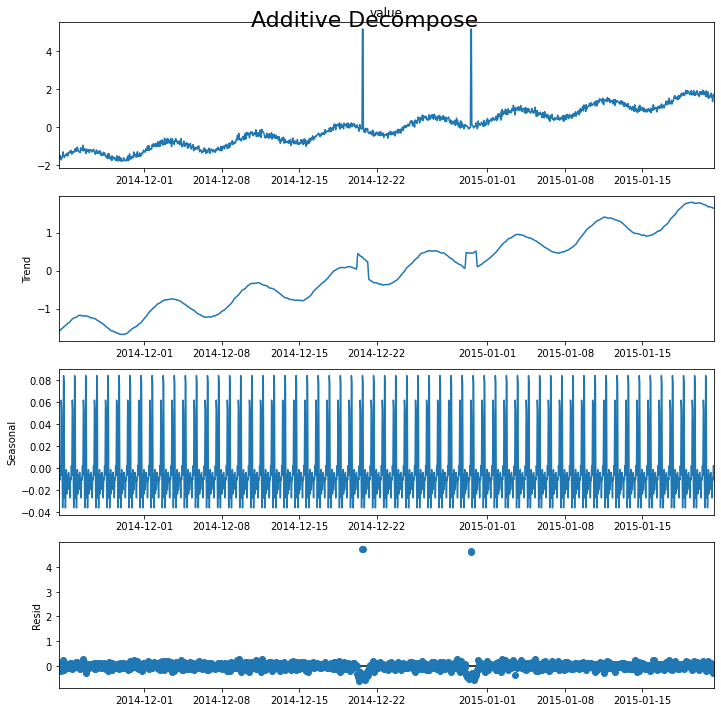



File: A2Benchmarksynthetic_37
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.143563           1
2014-12-20 18:00:00  5.143563           1
2014-12-30 12:00:00  5.148342           1
2014-12-30 13:00:00  5.148342           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.710554
659 2014-12-20 18:00:00  4.731673
893 2014-12-30 12:00:00  4.620442
894 2014-12-30 13:00:00  4.631571
Mean: 1442.278105, StandardDeviation: 1306.683693
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   483.204696           0
1    2014-11-23 08:00:00   -64.519211           0
2    2014-11-23 09:00:00   624.097423           0
3    2014-11-23 10:00:00   659.731059           0
4    2014-11-23 11:00:00   390.140876           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  2805.261653           0
1417 2015-01-21 08:00:00  1641.6

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_38add_STL


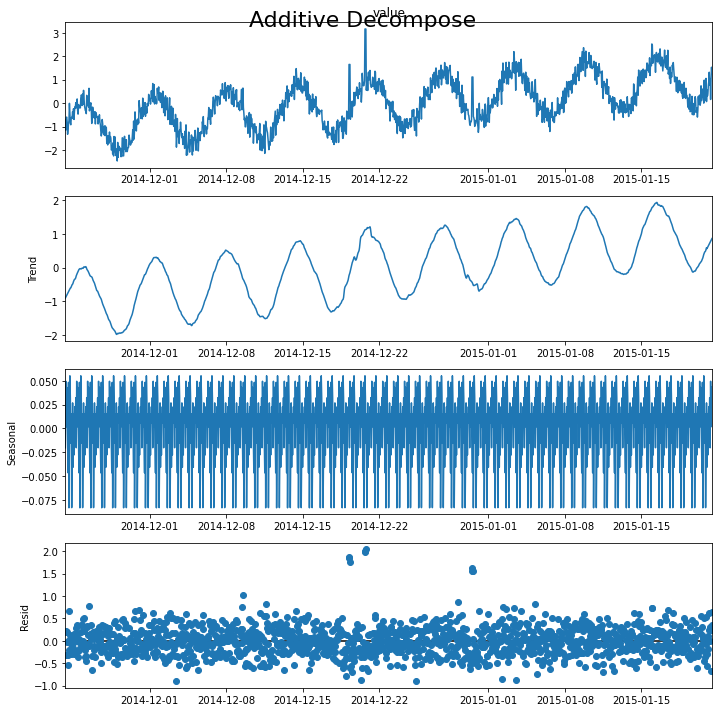



File: A2Benchmarksynthetic_38
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  1.647209           1
2014-12-19 07:00:00  1.647209           1
2014-12-19 08:00:00  1.647209           1
2014-12-20 17:00:00  3.160169           1
2014-12-20 18:00:00  3.160169           1
2014-12-20 19:00:00  3.160169           1
2014-12-30 12:00:00  1.111583           1
2014-12-30 13:00:00  1.111583           1
2014-12-30 14:00:00  1.111583           1
Detected outliers: 68
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.670981
40   2014-11-24 23:00:00  0.513385
52   2014-11-25 11:00:00  0.783789
153  2014-11-29 16:00:00  0.673902
162  2014-11-30 01:00:00  0.695242
...                  ...       ...
1396 2015-01-20 11:00:00  0.547288
1403 2015-01-20 18:00:00  0.516769
1407 2015-01-20 22:00:00  0.527703
1414 2015-01-21 05:00:00  0.611909
1419 2015-01-21 10:00:00  0.651235

[68 rows x 2 columns

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_39add_STL


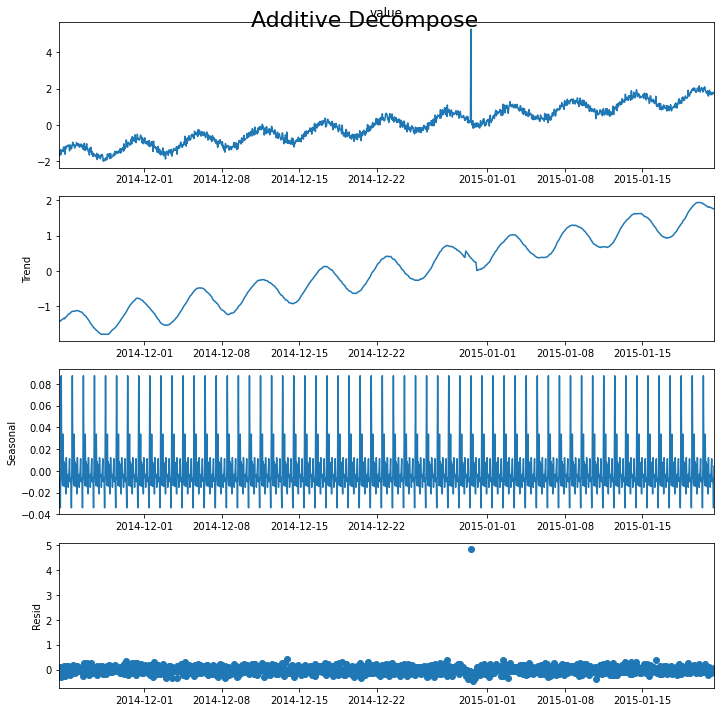



File: A2Benchmarksynthetic_39
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.291048           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.835757
Mean: 632.735854, StandardDeviation: 1043.469684
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00    52.606331           0
1    2014-11-23 08:00:00    53.295687           0
2    2014-11-23 09:00:00   186.898748           0
3    2014-11-23 10:00:00   249.971957           0
4    2014-11-23 11:00:00   279.808264           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1445.887148           0
1417 2015-01-21 08:00:00  1251.159335           0
1418 2015-01-21 09:00:00  1306.733265           0
1419 2015-01-21 10:00:00  1304.380678           0
1420 2015-01-21 11:00:00  1193.405905           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_4add_STL


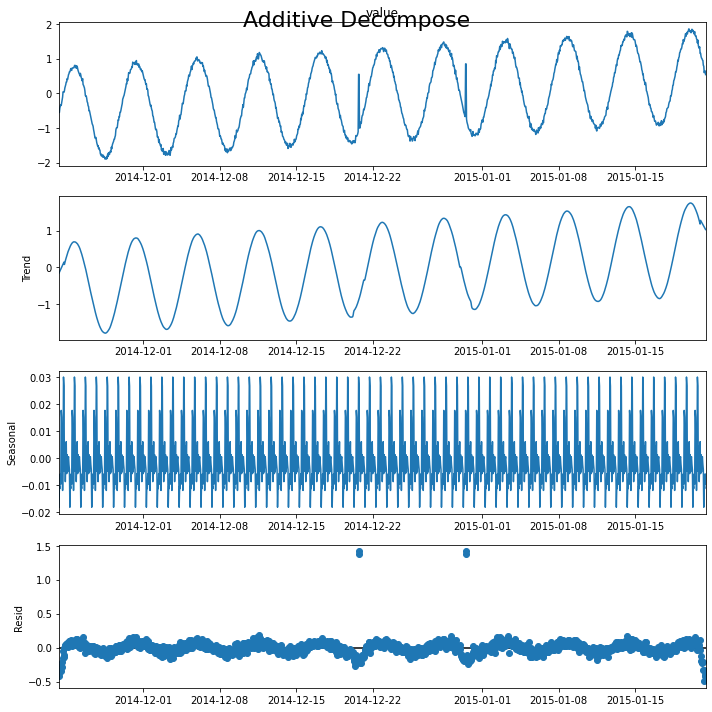



File: A2Benchmarksynthetic_4
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  0.544478           1
2014-12-20 18:00:00  0.544478           1
2014-12-30 12:00:00  0.847142           1
2014-12-30 13:00:00  0.847142           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.415847
659 2014-12-20 18:00:00  1.380350
893 2014-12-30 12:00:00  1.371544
894 2014-12-30 13:00:00  1.420474
Mean: 1588.069123, StandardDeviation: 1364.684820
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   508.681619           0
1    2014-11-23 08:00:00   -52.044324           0
2    2014-11-23 09:00:00   688.353631           0
3    2014-11-23 10:00:00   741.258885           0
4    2014-11-23 11:00:00   472.570612           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3049.616790           0
1417 2015-01-21 08:00:00  1840.01

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_40add_STL


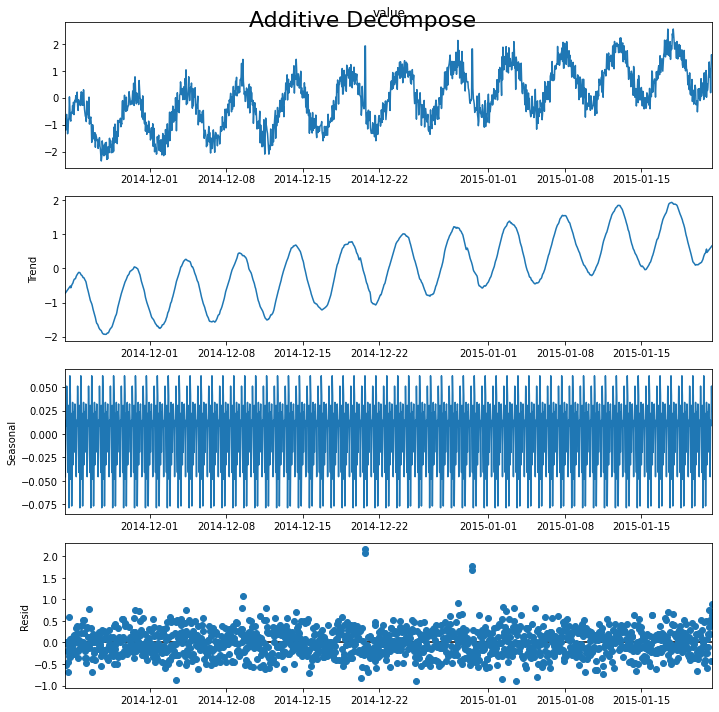



File: A2Benchmarksynthetic_40
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  1.917906           1
2014-12-20 18:00:00  1.917906           1
2014-12-30 12:00:00  1.807941           1
2014-12-30 13:00:00  1.807941           1
Detected outliers: 75
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.597929
38   2014-11-24 21:00:00  0.511099
40   2014-11-24 23:00:00  0.527958
52   2014-11-25 11:00:00  0.771118
125  2014-11-28 12:00:00  0.534173
...                  ...       ...
1407 2015-01-20 22:00:00  0.501789
1414 2015-01-21 05:00:00  0.753946
1416 2015-01-21 07:00:00  0.525304
1419 2015-01-21 10:00:00  0.897861
1420 2015-01-21 11:00:00  0.627728

[75 rows x 2 columns]
Mean: 3224.960580, StandardDeviation: 2265.218133


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   523.484417           0
1    2014-11-23 08:00:00   -41.682913           0
2    2014-11-23 09:00:00   726.637150           0
3    2014-11-23 10:00:00   790.153547           0
4    2014-11-23 11:00:00   523.808007           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  6759.936378           0
1417 2015-01-21 08:00:00  5365.621180           0
1418 2015-01-21 09:00:00  6483.746059           0
1419 2015-01-21 10:00:00  7023.408042           0
1420 2015-01-21 11:00:00  6475.307367           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_41add_STL


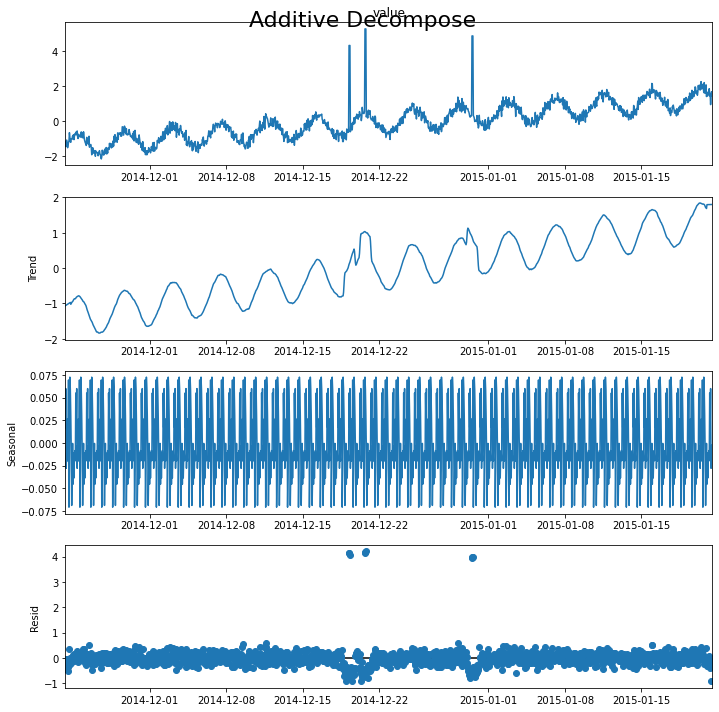



File: A2Benchmarksynthetic_41
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.310493           1
2014-12-19 07:00:00  4.310493           1
2014-12-19 08:00:00  4.310493           1
2014-12-20 17:00:00  5.254139           1
2014-12-20 18:00:00  5.254139           1
2014-12-20 19:00:00  5.254139           1
2014-12-30 12:00:00  4.853774           1
2014-12-30 13:00:00  4.853774           1
2014-12-30 14:00:00  4.853774           1
Detected outliers: 12
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.546895
440 2014-12-11 15:00:00  0.600791
623 2014-12-19 06:00:00  4.150292
624 2014-12-19 07:00:00  4.157572
625 2014-12-19 08:00:00  4.077752
658 2014-12-20 17:00:00  4.149231
659 2014-12-20 18:00:00  4.173470
660 2014-12-20 19:00:00  4.212321
862 2014-12-29 05:00:00  0.605220
893 2014-12-30 12:00:00  3.945228
894 2014-12-30 13:00:00  3.998137
895 2014-12-30 14:00:00  3.980206

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_42add_STL


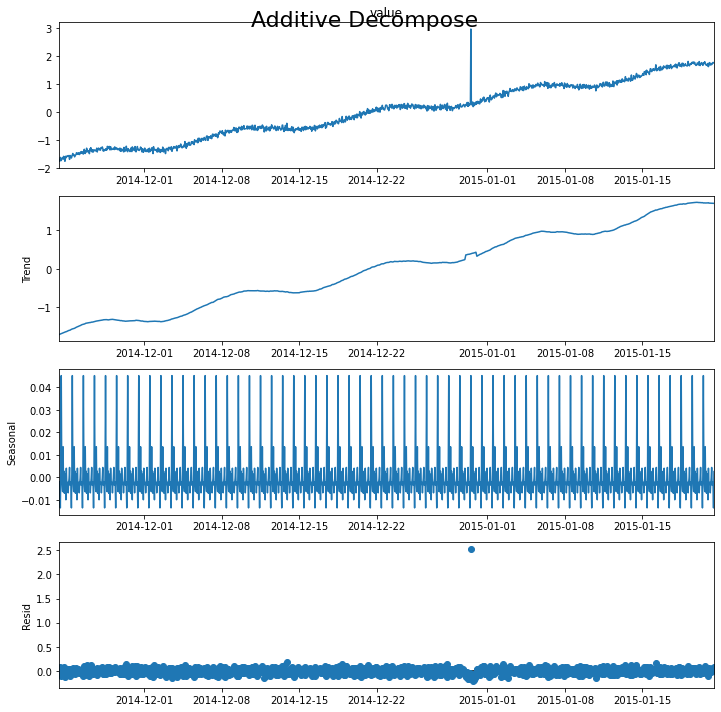



File: A2Benchmarksynthetic_42
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.965268           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.527949
Mean: 1844.380800, StandardDeviation: 1439.541406
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   546.917923           0
1    2014-11-23 08:00:00   -98.273553           0
2    2014-11-23 09:00:00   655.198714           0
3    2014-11-23 10:00:00   670.142109           0
4    2014-11-23 11:00:00   340.026865           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3702.084830           0
1417 2015-01-21 08:00:00  2360.661637           0
1418 2015-01-21 09:00:00  3654.950361           0
1419 2015-01-21 10:00:00  4343.303685           0
1420 2015-01-21 11:00:00  3891.300700           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_43add_STL


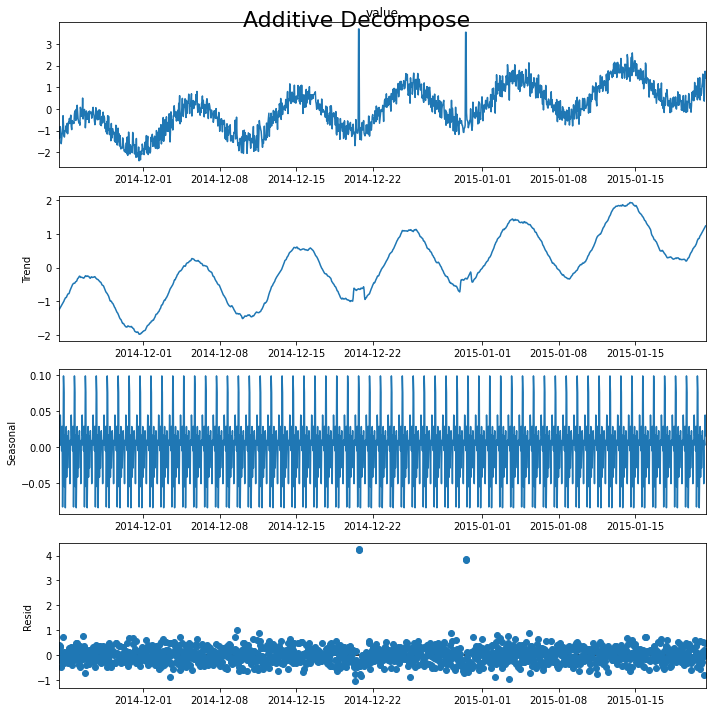



File: A2Benchmarksynthetic_43
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  3.683752           1
2014-12-20 18:00:00  3.683752           1
2014-12-30 12:00:00  3.531873           1
2014-12-30 13:00:00  3.531873           1
Detected outliers: 65
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.743840
52   2014-11-25 11:00:00  0.785061
153  2014-11-29 16:00:00  0.684954
162  2014-11-30 01:00:00  0.692369
170  2014-11-30 09:00:00  0.552166
...                  ...       ...
1376 2015-01-19 15:00:00  0.501601
1396 2015-01-20 11:00:00  0.586694
1403 2015-01-20 18:00:00  0.507607
1407 2015-01-20 22:00:00  0.556166
1414 2015-01-21 05:00:00  0.518693

[65 rows x 2 columns]
Mean: 7485.049903, StandardDeviation: 4477.502832
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    567.318271           0
1    2014-11-23 08:00:00    -76.706404           0
2    

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_44add_STL


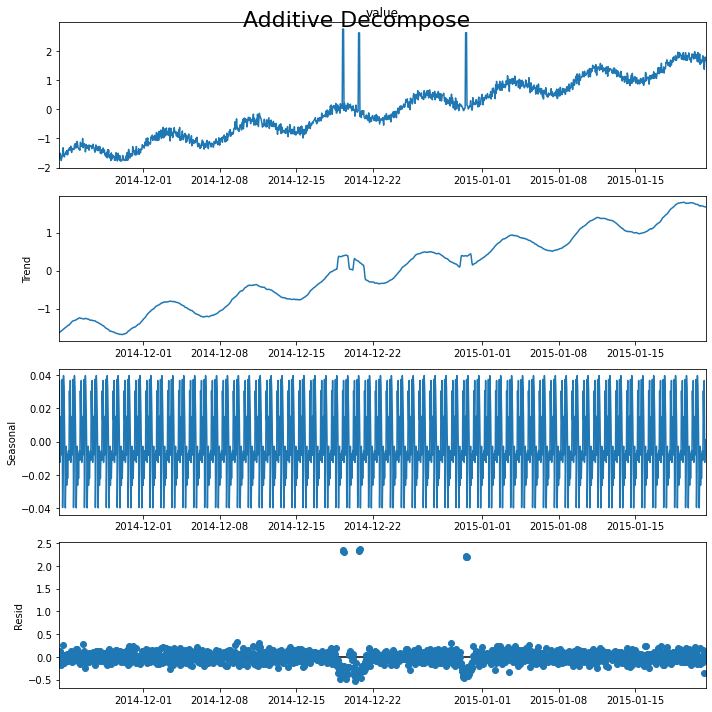



File: A2Benchmarksynthetic_44
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.742542           1
2014-12-19 07:00:00  2.742542           1
2014-12-19 08:00:00  2.742542           1
2014-12-20 17:00:00  2.610071           1
2014-12-20 18:00:00  2.610071           1
2014-12-20 19:00:00  2.610071           1
2014-12-30 12:00:00  2.616068           1
2014-12-30 13:00:00  2.616068           1
2014-12-30 14:00:00  2.616068           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.322403
624 2014-12-19 07:00:00  2.340990
625 2014-12-19 08:00:00  2.316033
658 2014-12-20 17:00:00  2.325908
659 2014-12-20 18:00:00  2.346658
660 2014-12-20 19:00:00  2.374863
893 2014-12-30 12:00:00  2.207397
894 2014-12-30 13:00:00  2.218999
895 2014-12-30 14:00:00  2.191808
Processing index: 40 of 100
Mean: 993.259043, StandardDeviation: 1187.711162
               timestamp 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_45add_STL


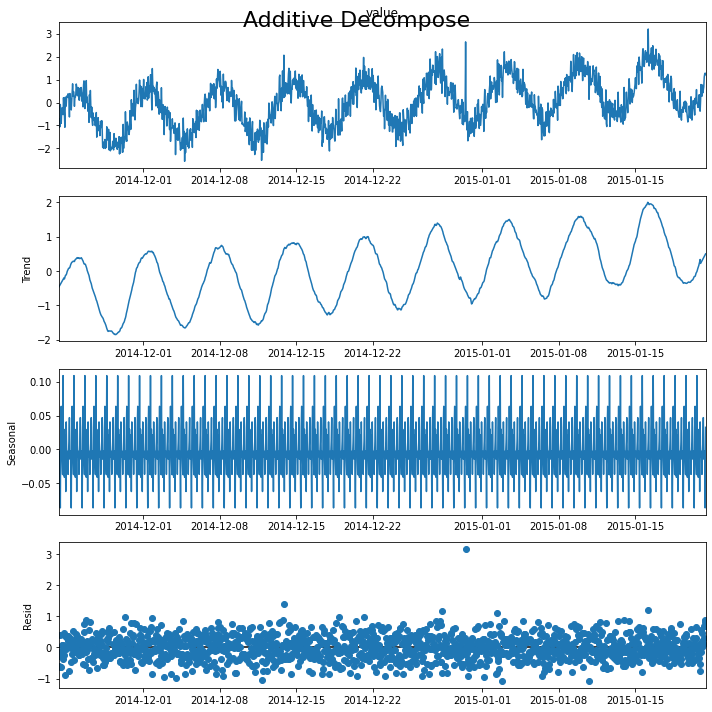



File: A2Benchmarksynthetic_45
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.637652           1
Detected outliers: 145
Outliers:
               timestamp     resid
30   2014-11-24 13:00:00  0.515242
55   2014-11-25 14:00:00  0.744777
60   2014-11-25 19:00:00  0.875062
67   2014-11-26 02:00:00  0.542476
69   2014-11-26 04:00:00  0.826625
...                  ...       ...
1410 2015-01-21 01:00:00  0.546457
1417 2015-01-21 08:00:00  0.690376
1418 2015-01-21 09:00:00  0.797996
1419 2015-01-21 10:00:00  0.892728
1420 2015-01-21 11:00:00  0.681524

[145 rows x 2 columns]
Mean: 4883.689181, StandardDeviation: 3002.178684
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    589.017399           0
1    2014-11-23 08:00:00    -71.781787           0
2    2014-11-23 09:00:00    763.325245           0
3    2014-11-23 10:00:00    808.273347           0
4    2014-11-23 11:00:00   

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_46add_STL


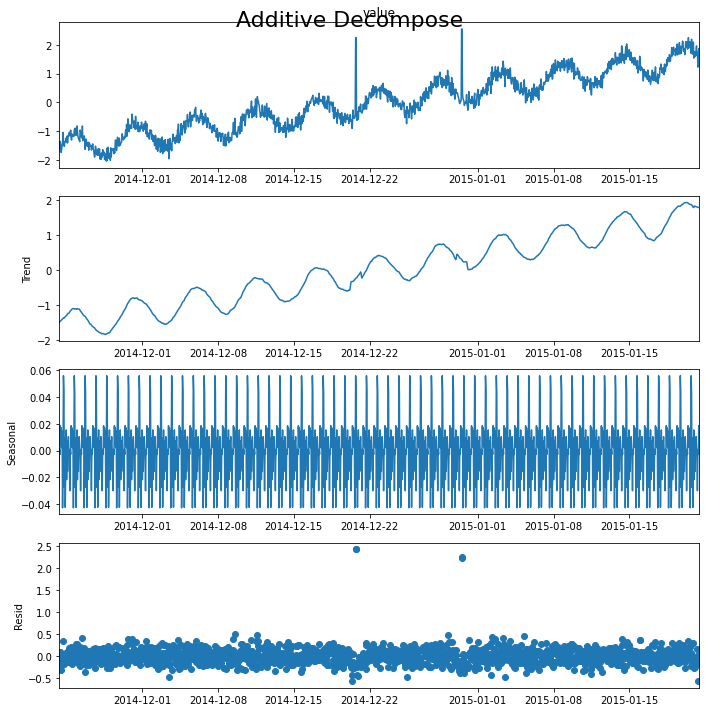



File: A2Benchmarksynthetic_46
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.247531           1
2014-12-20 18:00:00  2.247531           1
2014-12-30 12:00:00  2.547446           1
2014-12-30 13:00:00  2.547446           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.423279
659 2014-12-20 18:00:00  2.427783
893 2014-12-30 12:00:00  2.219730
894 2014-12-30 13:00:00  2.251850
Mean: 2231.122471, StandardDeviation: 1732.376858
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   597.938711           0
1    2014-11-23 08:00:00   -73.180074           0
2    2014-11-23 09:00:00   783.990456           0
3    2014-11-23 10:00:00   833.730107           0
4    2014-11-23 11:00:00   505.846974           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  4285.024814           0
1417 2015-01-21 08:00:00  2851.9

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_47add_STL


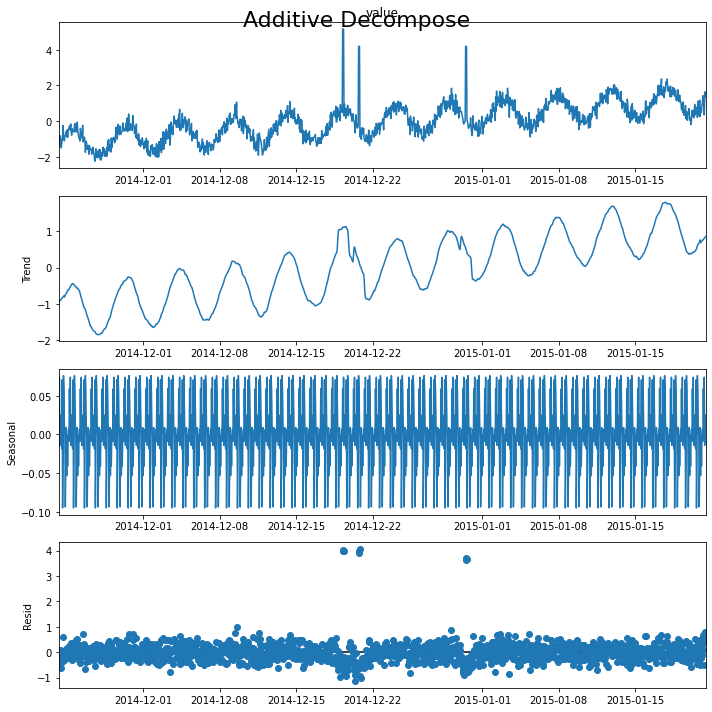



File: A2Benchmarksynthetic_47
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  5.157476           1
2014-12-19 07:00:00  5.157476           1
2014-12-19 08:00:00  5.157476           1
2014-12-20 17:00:00  4.184423           1
2014-12-20 18:00:00  4.184423           1
2014-12-20 19:00:00  4.184423           1
2014-12-30 12:00:00  4.186696           1
2014-12-30 13:00:00  4.186696           1
2014-12-30 14:00:00  4.186696           1
Detected outliers: 56
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.596117
40   2014-11-24 23:00:00  0.502973
52   2014-11-25 11:00:00  0.732557
153  2014-11-29 16:00:00  0.704518
162  2014-11-30 01:00:00  0.696623
170  2014-11-30 09:00:00  0.552875
229  2014-12-02 20:00:00  0.568391
253  2014-12-03 20:00:00  0.520321
265  2014-12-04 08:00:00  0.625677
303  2014-12-05 22:00:00  0.561037
387  2014-12-09 10:00:00  0.752119
390  2014-12-09 13:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_48add_STL


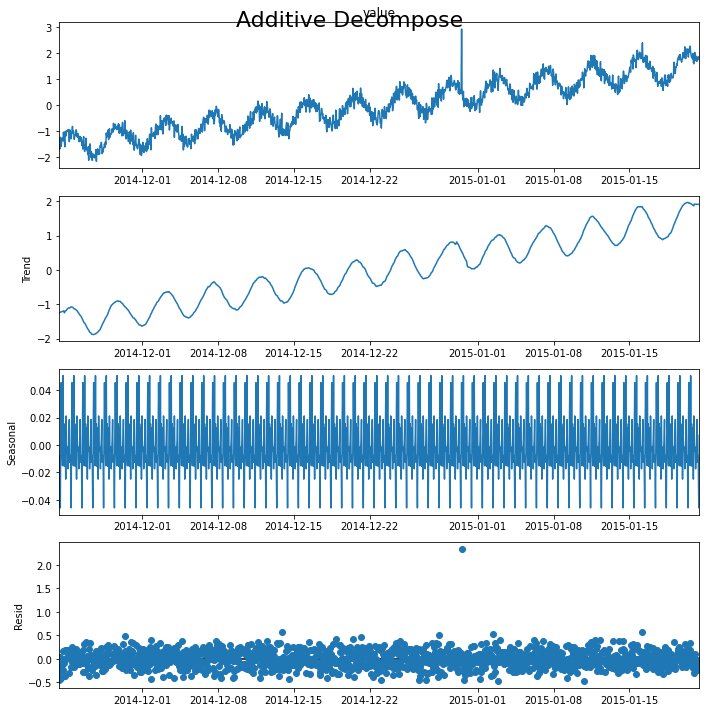



File: A2Benchmarksynthetic_48
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.920773           1
Detected outliers: 5
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.571608
842  2014-12-28 09:00:00  0.509845
893  2014-12-30 12:00:00  2.336030
963  2015-01-02 10:00:00  0.518603
1294 2015-01-16 05:00:00  0.560662
Mean: 15071.243554, StandardDeviation: 8998.690990


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    640.999679           0
1    2014-11-23 08:00:00    -90.528068           0
2    2014-11-23 09:00:00    771.336286           0
3    2014-11-23 10:00:00    791.897883           0
4    2014-11-23 11:00:00    419.421134           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  29925.519117           0
1417 2015-01-21 08:00:00  28345.333133           0
1418 2015-01-21 09:00:00  29767.656950           0
1419 2015-01-21 10:00:00  30499.610657           0
1420 2015-01-21 11:00:00  29932.416867           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_49add_STL


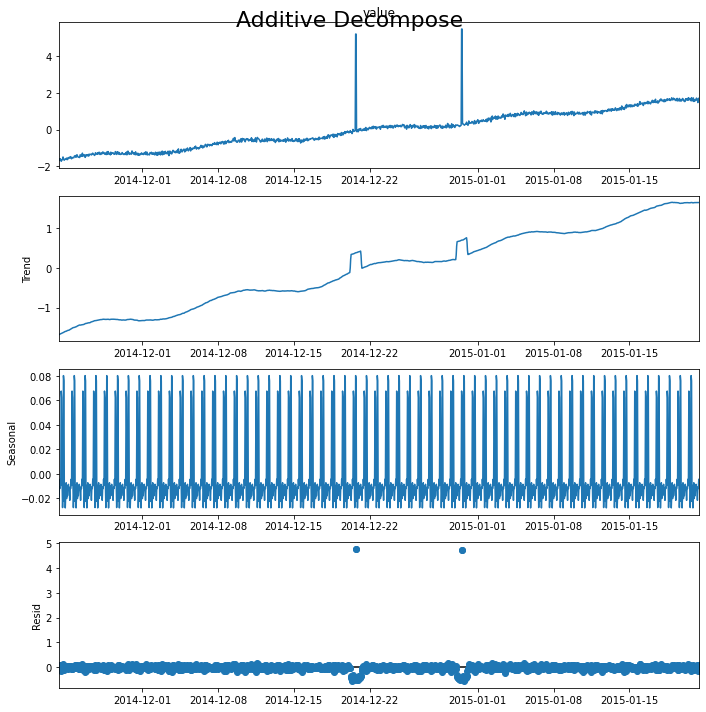



File: A2Benchmarksynthetic_49
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.214945           1
2014-12-20 18:00:00  5.214945           1
2014-12-30 12:00:00  5.490352           1
2014-12-30 13:00:00  5.490352           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.758547
659 2014-12-20 18:00:00  4.761013
893 2014-12-30 12:00:00  4.729836
894 2014-12-30 13:00:00  4.732728
Mean: 37.124113, StandardDeviation: 1004.944051
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00   64.446231           0
1    2014-11-23 08:00:00   57.734576           0
2    2014-11-23 09:00:00  216.319723           0
3    2014-11-23 10:00:00  287.103069           0
4    2014-11-23 11:00:00  316.439168           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00 -222.469280           0
1417 2015-01-21 08:00:00 -312.800711      

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_5add_STL


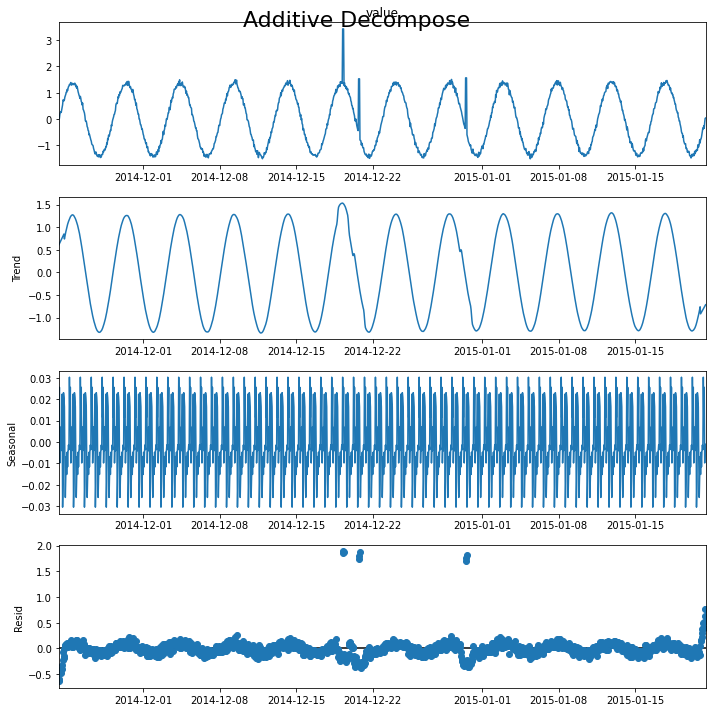



File: A2Benchmarksynthetic_5
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  3.422280           1
2014-12-19 07:00:00  3.422280           1
2014-12-19 08:00:00  3.422280           1
2014-12-20 17:00:00  1.526707           1
2014-12-20 18:00:00  1.526707           1
2014-12-20 19:00:00  1.526707           1
2014-12-30 12:00:00  1.563339           1
2014-12-30 13:00:00  1.563339           1
2014-12-30 14:00:00  1.563339           1
Detected outliers: 13
Outliers:
               timestamp     resid
623  2014-12-19 06:00:00  1.859798
624  2014-12-19 07:00:00  1.887223
625  2014-12-19 08:00:00  1.883905
658  2014-12-20 17:00:00  1.731914
659  2014-12-20 18:00:00  1.800324
660  2014-12-20 19:00:00  1.868853
893  2014-12-30 12:00:00  1.691534
894  2014-12-30 13:00:00  1.761318
895  2014-12-30 14:00:00  1.810082
1416 2015-01-21 07:00:00  0.520301
1418 2015-01-21 09:00:00  0.636211
1419 2015-01-21 10:00:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_50add_STL


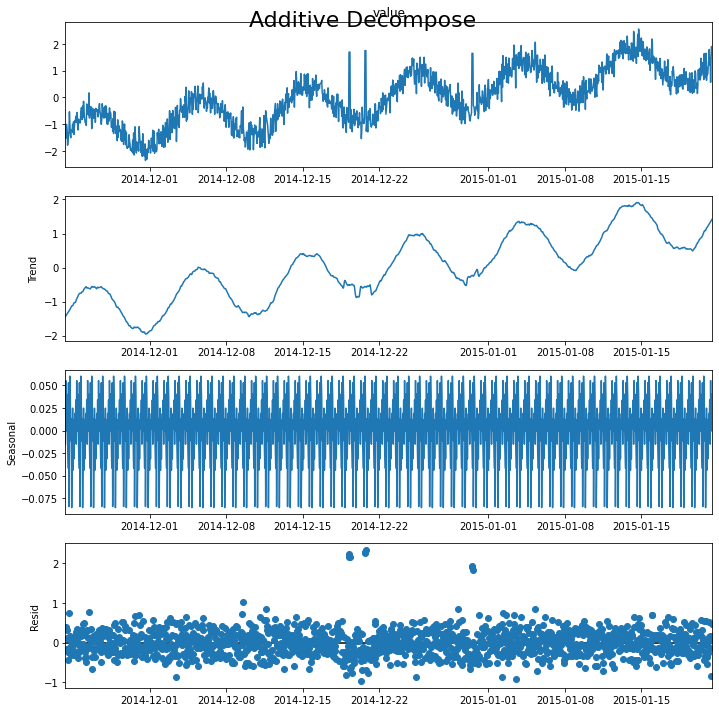



File: A2Benchmarksynthetic_50
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  1.691455           1
2014-12-19 07:00:00  1.691455           1
2014-12-19 08:00:00  1.691455           1
2014-12-20 17:00:00  1.747858           1
2014-12-20 18:00:00  1.747858           1
2014-12-20 19:00:00  1.747858           1
2014-12-30 12:00:00  1.645125           1
2014-12-30 13:00:00  1.645125           1
2014-12-30 14:00:00  1.645125           1
Detected outliers: 69
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.732870
52   2014-11-25 11:00:00  0.767853
125  2014-11-28 12:00:00  0.505287
126  2014-11-28 13:00:00  0.510937
153  2014-11-29 16:00:00  0.673927
...                  ...       ...
1359 2015-01-18 22:00:00  0.515965
1396 2015-01-20 11:00:00  0.577532
1403 2015-01-20 18:00:00  0.533119
1407 2015-01-20 22:00:00  0.547103
1414 2015-01-21 05:00:00  0.503684

[69 rows x 2 columns

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -306.778004           0
1    2014-11-23 08:00:00    166.973172           0
2    2014-11-23 09:00:00   -294.134401           0
3    2014-11-23 10:00:00   1007.698448           0
4    2014-11-23 11:00:00    420.373335           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  19125.220951           0
1417 2015-01-21 08:00:00  19611.483332           0
1418 2015-01-21 09:00:00  19682.663779           0
1419 2015-01-21 10:00:00  19644.463826           0
1420 2015-01-21 11:00:00  19456.286479           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_51add_STL


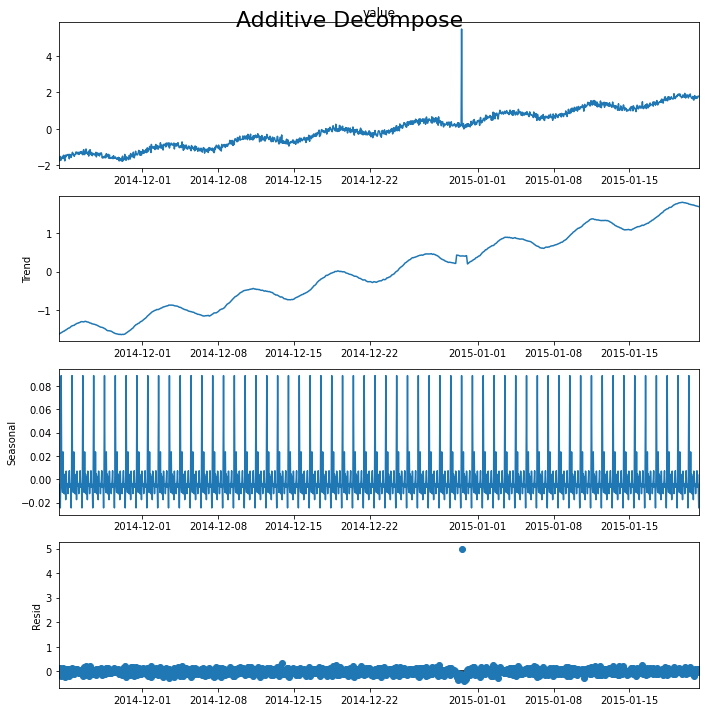



File: A2Benchmarksynthetic_51
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.482078           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.984939
Mean: 2685.056514, StandardDeviation: 1851.148139
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   661.777454           0
1    2014-11-23 08:00:00  -106.673565           0
2    2014-11-23 09:00:00   815.546795           0
3    2014-11-23 10:00:00   844.907797           0
4    2014-11-23 11:00:00   456.986468           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  5359.076389           0
1417 2015-01-21 08:00:00  3748.669117           0
1418 2015-01-21 09:00:00  5324.524126           0
1419 2015-01-21 10:00:00  6168.027620           0
1420 2015-01-21 11:00:00  5633.106076           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_52add_STL


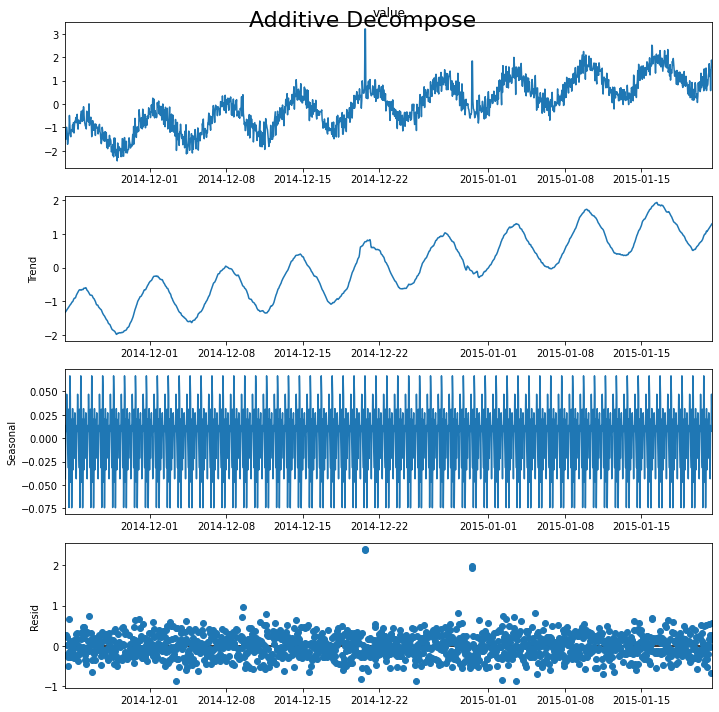



File: A2Benchmarksynthetic_52
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  3.212436           1
2014-12-20 18:00:00  3.212436           1
2014-12-30 12:00:00  1.839129           1
2014-12-30 13:00:00  1.839129           1
Detected outliers: 52
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.661785
52   2014-11-25 11:00:00  0.742202
153  2014-11-29 16:00:00  0.646391
162  2014-11-30 01:00:00  0.664063
170  2014-11-30 09:00:00  0.542397
192  2014-12-01 07:00:00  0.602731
224  2014-12-02 15:00:00  0.503347
229  2014-12-02 20:00:00  0.596532
265  2014-12-04 08:00:00  0.629413
303  2014-12-05 22:00:00  0.565272
387  2014-12-09 10:00:00  0.710619
390  2014-12-09 13:00:00  0.977292
427  2014-12-11 02:00:00  0.594470
436  2014-12-11 11:00:00  0.528463
440  2014-12-11 15:00:00  0.795192
441  2014-12-11 16:00:00  0.527220
461  2014-12-12 12:00:00  0.558682
487  2014-12-13 14:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_53add_STL


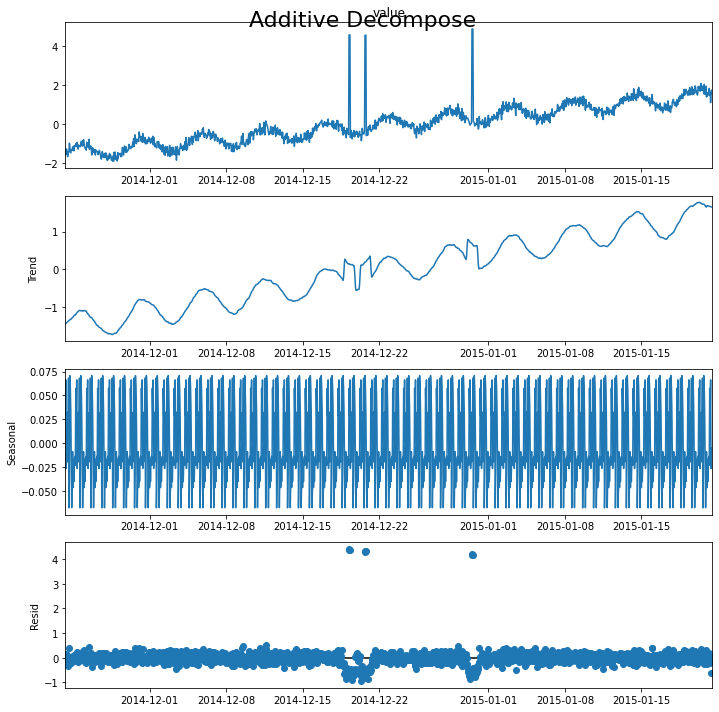



File: A2Benchmarksynthetic_53
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.581084           1
2014-12-19 07:00:00  4.581084           1
2014-12-19 08:00:00  4.581084           1
2014-12-20 17:00:00  4.567789           1
2014-12-20 18:00:00  4.567789           1
2014-12-20 19:00:00  4.567789           1
2014-12-30 12:00:00  4.886633           1
2014-12-30 13:00:00  4.886633           1
2014-12-30 14:00:00  4.886633           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.371079
624 2014-12-19 07:00:00  4.412580
625 2014-12-19 08:00:00  4.383229
658 2014-12-20 17:00:00  4.302594
659 2014-12-20 18:00:00  4.309125
660 2014-12-20 19:00:00  4.326478
893 2014-12-30 12:00:00  4.170161
894 2014-12-30 13:00:00  4.200598
895 2014-12-30 14:00:00  4.170087
Processing index: 50 of 100
Mean: 1428.809330, StandardDeviation: 1357.598995
               timestamp

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_54add_STL


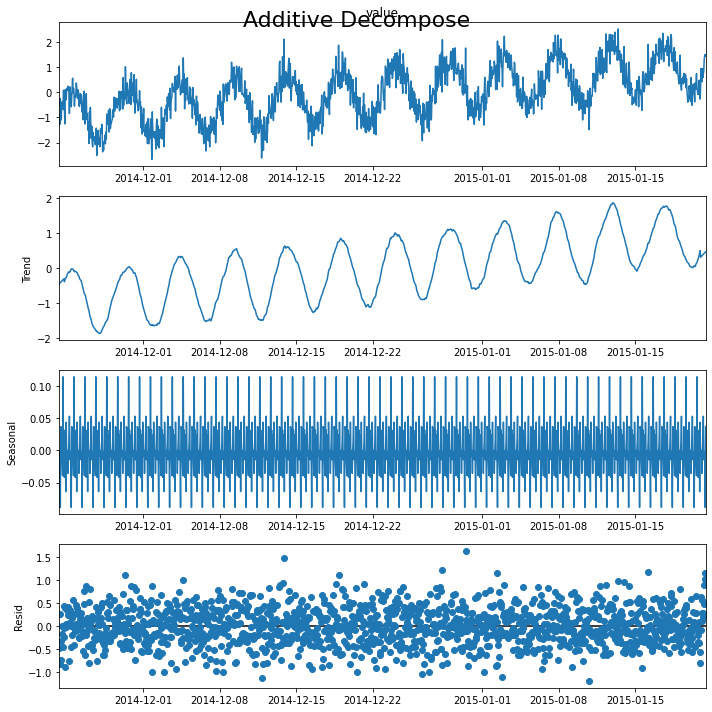



File: A2Benchmarksynthetic_54
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  1.766812           1
Detected outliers: 154
Outliers:
               timestamp     resid
30   2014-11-24 13:00:00  0.566711
55   2014-11-25 14:00:00  0.759244
60   2014-11-25 19:00:00  0.882254
67   2014-11-26 02:00:00  0.517630
69   2014-11-26 04:00:00  0.812229
...                  ...       ...
1413 2015-01-21 04:00:00  0.574937
1417 2015-01-21 08:00:00  0.902307
1418 2015-01-21 09:00:00  1.032833
1419 2015-01-21 10:00:00  1.149986
1420 2015-01-21 11:00:00  0.946153

[154 rows x 2 columns]
Mean: 3493.558825, StandardDeviation: 2366.714471
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   700.730093           0
1    2014-11-23 08:00:00   -86.491432           0
2    2014-11-23 09:00:00   914.105274           0
3    2014-11-23 10:00:00   970.021956           0
4    2014-11-23 11:00:00   584.0

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_55add_STL


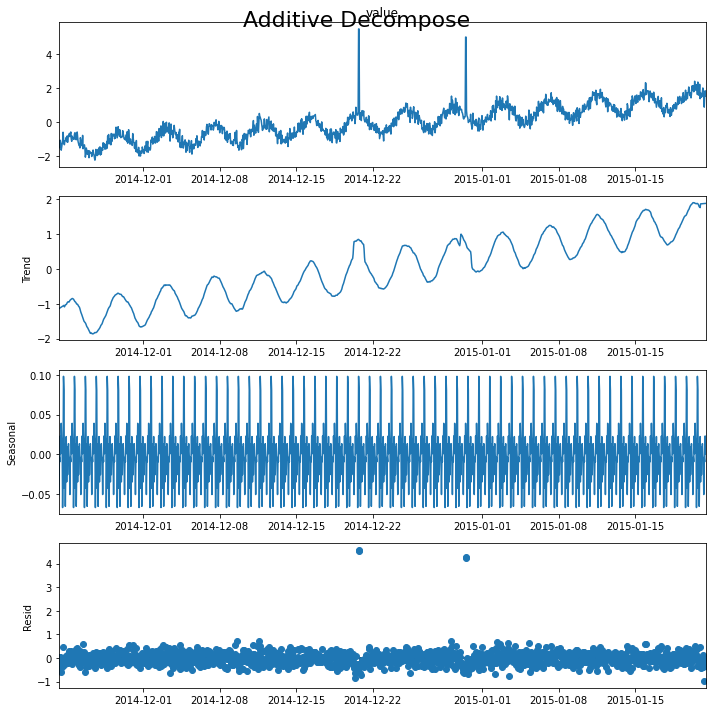



File: A2Benchmarksynthetic_55
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.490880           1
2014-12-20 18:00:00  5.490880           1
2014-12-30 12:00:00  5.011384           1
2014-12-30 13:00:00  5.011384           1
Detected outliers: 31
Outliers:
               timestamp     resid
52   2014-11-25 11:00:00  0.611138
153  2014-11-29 16:00:00  0.558424
162  2014-11-30 01:00:00  0.540182
229  2014-12-02 20:00:00  0.534600
265  2014-12-04 08:00:00  0.550964
387  2014-12-09 10:00:00  0.551967
390  2014-12-09 13:00:00  0.713434
427  2014-12-11 02:00:00  0.540336
436  2014-12-11 11:00:00  0.515998
440  2014-12-11 15:00:00  0.731517
441  2014-12-11 16:00:00  0.510460
658  2014-12-20 17:00:00  4.548751
659  2014-12-20 18:00:00  4.579718
862  2014-12-29 05:00:00  0.736234
864  2014-12-29 07:00:00  0.508527
871  2014-12-29 14:00:00  0.530256
893  2014-12-30 12:00:00  4.232043
894  2014-12-30 13:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_56add_STL


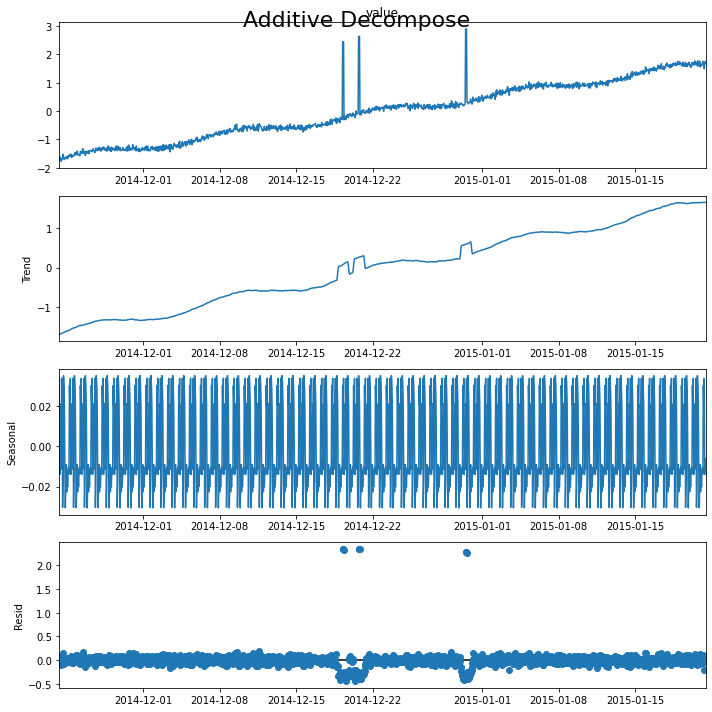



File: A2Benchmarksynthetic_56
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.449570           1
2014-12-19 07:00:00  2.449570           1
2014-12-19 08:00:00  2.449570           1
2014-12-20 17:00:00  2.638781           1
2014-12-20 18:00:00  2.638781           1
2014-12-20 19:00:00  2.638781           1
2014-12-30 12:00:00  2.897896           1
2014-12-30 13:00:00  2.897896           1
2014-12-30 14:00:00  2.897896           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.342217
624 2014-12-19 07:00:00  2.347540
625 2014-12-19 08:00:00  2.327635
658 2014-12-20 17:00:00  2.338676
659 2014-12-20 18:00:00  2.341641
660 2014-12-20 19:00:00  2.348997
893 2014-12-30 12:00:00  2.277670
894 2014-12-30 13:00:00  2.280937
895 2014-12-30 14:00:00  2.261903
Mean: 1594.302942, StandardDeviation: 1417.078635
               timestamp        value  is_anomaly
0 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_57add_STL


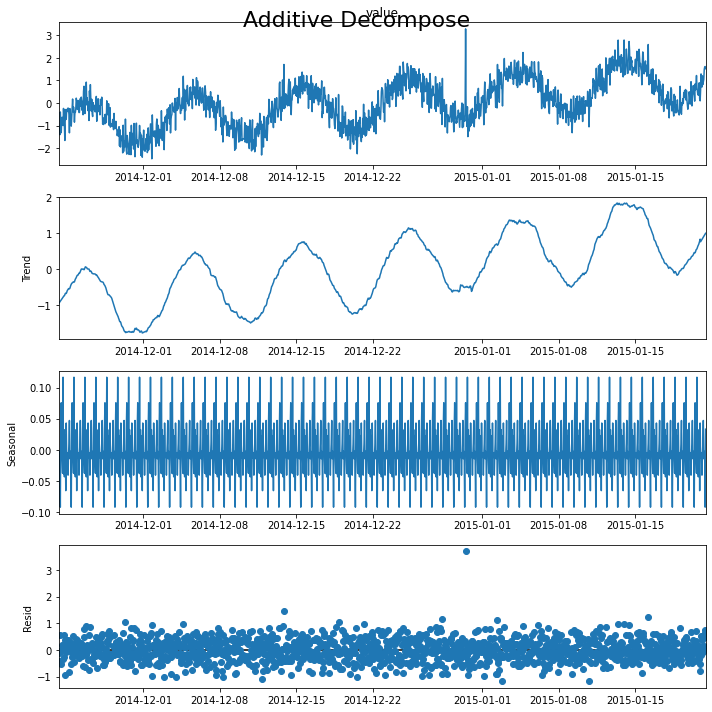



File: A2Benchmarksynthetic_57
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  3.287753           1
Detected outliers: 161
Outliers:
               timestamp     resid
3    2014-11-23 10:00:00  0.576472
10   2014-11-23 17:00:00  0.551433
30   2014-11-24 13:00:00  0.512823
55   2014-11-25 14:00:00  0.766754
60   2014-11-25 19:00:00  0.913069
...                  ...       ...
1400 2015-01-20 15:00:00  0.702577
1410 2015-01-21 01:00:00  0.512485
1417 2015-01-21 08:00:00  0.549978
1418 2015-01-21 09:00:00  0.647276
1419 2015-01-21 10:00:00  0.730777

[161 rows x 2 columns]
Mean: 8984.042125, StandardDeviation: 5305.100902
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    746.294359           0
1    2014-11-23 08:00:00   -118.054098           0
2    2014-11-23 09:00:00    903.019269           0
3    2014-11-23 10:00:00    928.503497           0
4    2014-11-23 11:00:00   

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_58add_STL


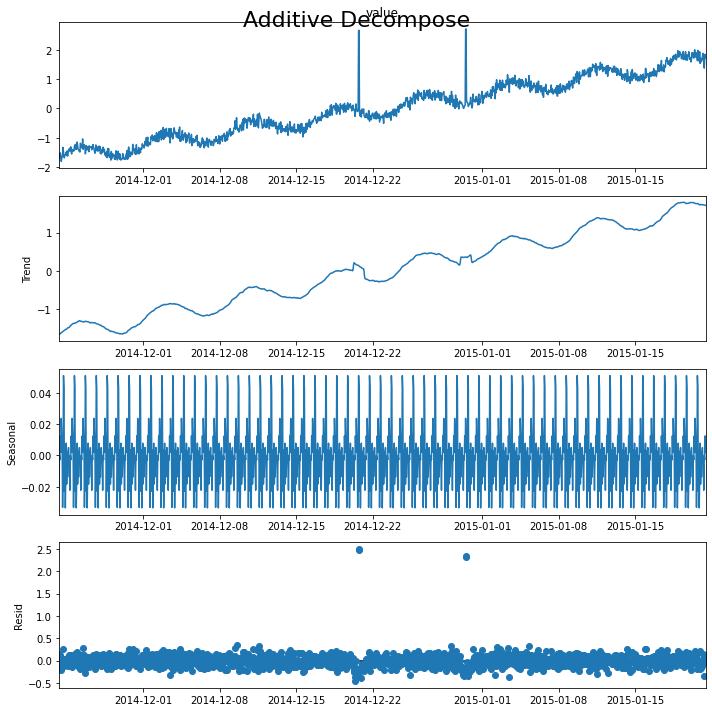



File: A2Benchmarksynthetic_58
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.663647           1
2014-12-20 18:00:00  2.663647           1
2014-12-30 12:00:00  2.709658           1
2014-12-30 13:00:00  2.709658           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.475895
659 2014-12-20 18:00:00  2.496553
893 2014-12-30 12:00:00  2.324577
894 2014-12-30 13:00:00  2.337188
Mean: 3513.971473, StandardDeviation: 2396.965434
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   751.268840           0
1    2014-11-23 08:00:00  -127.340728           0
2    2014-11-23 09:00:00   911.886503           0
3    2014-11-23 10:00:00   938.316196           0
4    2014-11-23 11:00:00   491.434301           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  6926.479162           0
1417 2015-01-21 08:00:00  5092.8

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_59add_STL


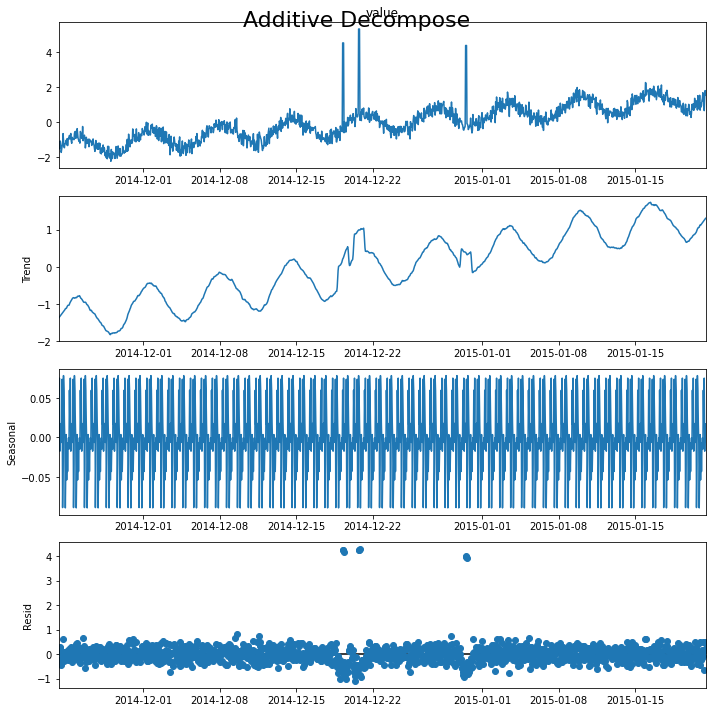



File: A2Benchmarksynthetic_59
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.508653           1
2014-12-19 07:00:00  4.508653           1
2014-12-19 08:00:00  4.508653           1
2014-12-20 17:00:00  5.300077           1
2014-12-20 18:00:00  5.300077           1
2014-12-20 19:00:00  5.300077           1
2014-12-30 12:00:00  4.363141           1
2014-12-30 13:00:00  4.363141           1
2014-12-30 14:00:00  4.363141           1
Detected outliers: 34
Outliers:
               timestamp     resid
9    2014-11-23 16:00:00  0.609562
52   2014-11-25 11:00:00  0.671540
153  2014-11-29 16:00:00  0.590933
162  2014-11-30 01:00:00  0.605589
229  2014-12-02 20:00:00  0.545916
303  2014-12-05 22:00:00  0.520841
387  2014-12-09 10:00:00  0.645562
390  2014-12-09 13:00:00  0.834528
427  2014-12-11 02:00:00  0.547988
440  2014-12-11 15:00:00  0.723588
507  2014-12-14 10:00:00  0.575751
623  2014-12-19 06:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_6add_STL


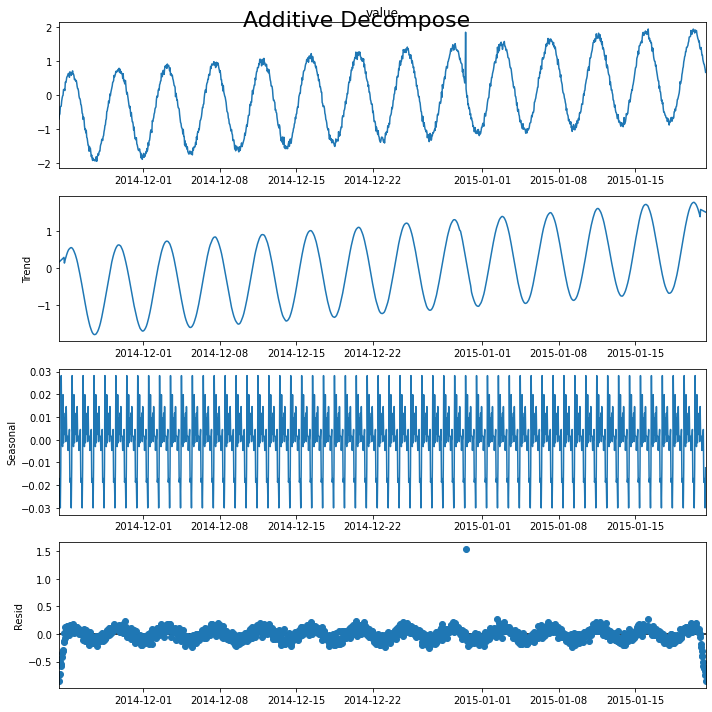



File: A2Benchmarksynthetic_6
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  1.852259           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  1.542453
Mean: 9094.309910, StandardDeviation: 5325.903612
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00     12.090549           0
1    2014-11-23 08:00:00     90.638495           0
2    2014-11-23 09:00:00    167.216745           0
3    2014-11-23 10:00:00    246.964829           0
4    2014-11-23 11:00:00    322.596466           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  18278.748615           0
1417 2015-01-21 08:00:00  18228.301000           0
1418 2015-01-21 09:00:00  18176.621626           0
1419 2015-01-21 10:00:00  18124.448052           0
1420 2015-01-21 11:00:00  18071.840756           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_60add_STL


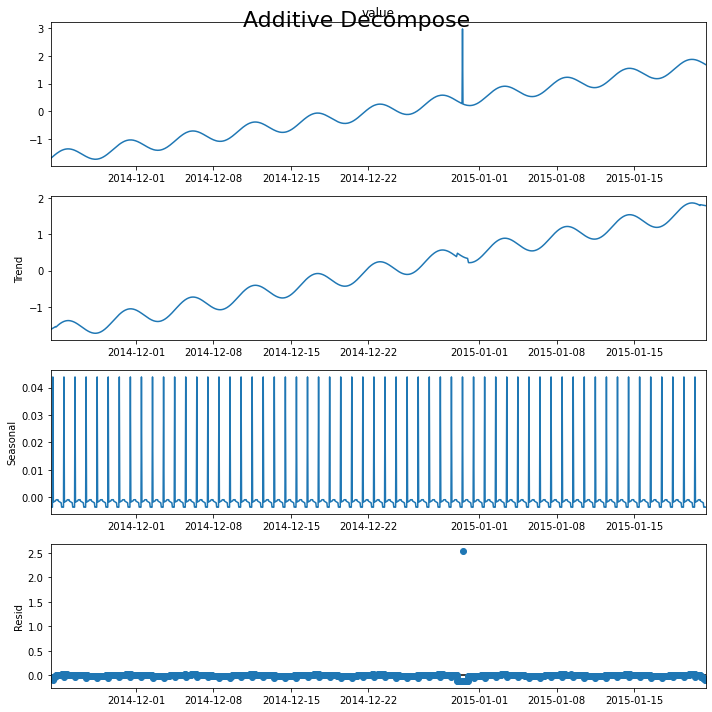



File: A2Benchmarksynthetic_60
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.971187           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.538143
Mean: 72.285228, StandardDeviation: 991.387749
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00   13.986075           0
1    2014-11-23 08:00:00   70.899941           0
2    2014-11-23 09:00:00  163.301800           0
3    2014-11-23 10:00:00  236.437959           0
4    2014-11-23 11:00:00  300.143589           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00 -157.714627           0
1417 2015-01-21 08:00:00 -119.819641           0
1418 2015-01-21 09:00:00  -14.031977           0
1419 2015-01-21 10:00:00   76.707914           0
1420 2015-01-21 11:00:00  138.552344           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_61add_STL


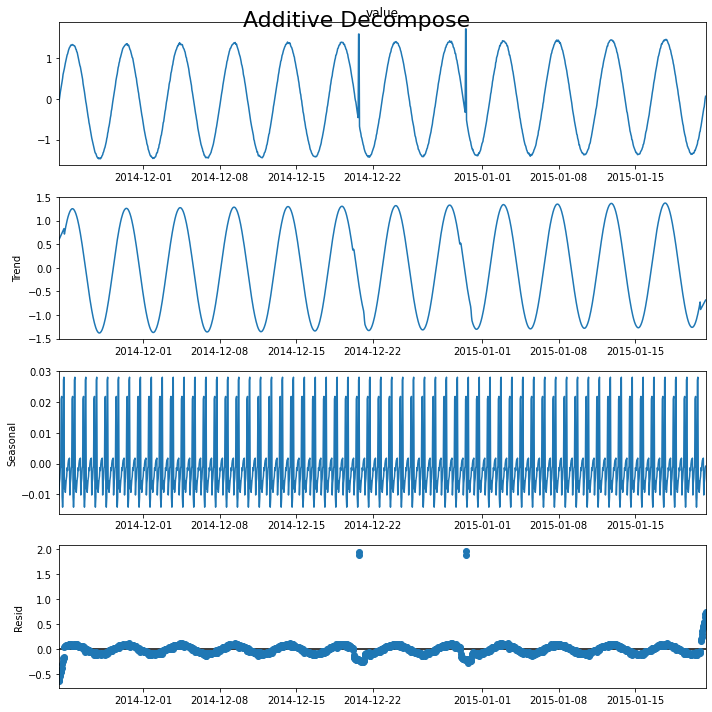



File: A2Benchmarksynthetic_61
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  1.600644           1
2014-12-20 18:00:00  1.600644           1
2014-12-30 12:00:00  1.727900           1
2014-12-30 13:00:00  1.727900           1
Detected outliers: 9
Outliers:
               timestamp     resid
658  2014-12-20 17:00:00  1.892400
659  2014-12-20 18:00:00  1.956267
893  2014-12-30 12:00:00  1.896683
894  2014-12-30 13:00:00  1.962440
1416 2015-01-21 07:00:00  0.535378
1417 2015-01-21 08:00:00  0.551513
1418 2015-01-21 09:00:00  0.638618
1419 2015-01-21 10:00:00  0.708726
1420 2015-01-21 11:00:00  0.752307
Mean: 7244.356891, StandardDeviation: 4338.899363
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00     36.563293           0
1    2014-11-23 08:00:00     96.810192           0
2    2014-11-23 09:00:00    224.908580           0
3    2014-11-23 10:00:00    316.430302          

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_62add_STL


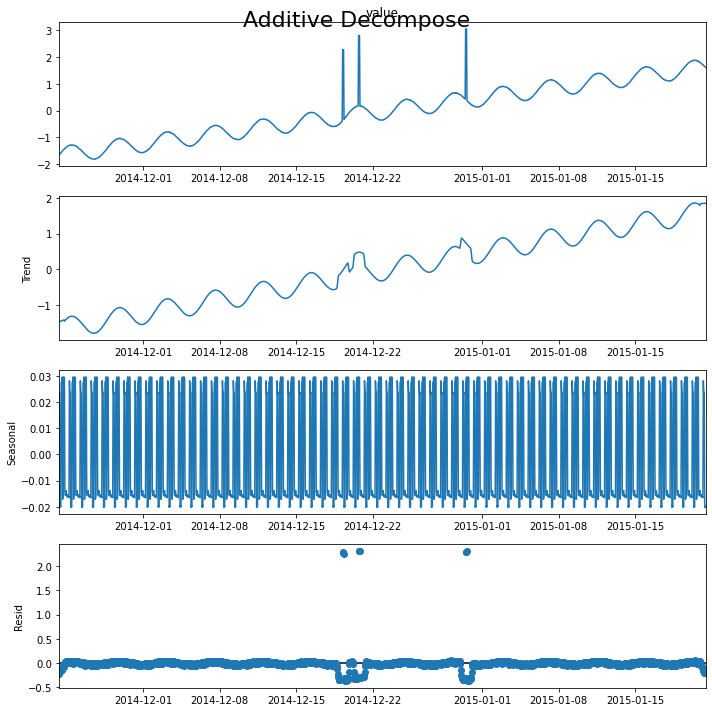



File: A2Benchmarksynthetic_62
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.283666           1
2014-12-19 07:00:00  2.283666           1
2014-12-19 08:00:00  2.283666           1
2014-12-20 17:00:00  2.811126           1
2014-12-20 18:00:00  2.811126           1
2014-12-20 19:00:00  2.811126           1
2014-12-30 12:00:00  3.057652           1
2014-12-30 13:00:00  3.057652           1
2014-12-30 14:00:00  3.057652           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.289370
624 2014-12-19 07:00:00  2.276430
625 2014-12-19 08:00:00  2.256899
658 2014-12-20 17:00:00  2.301343
659 2014-12-20 18:00:00  2.300645
660 2014-12-20 19:00:00  2.300668
893 2014-12-30 12:00:00  2.281183
894 2014-12-30 13:00:00  2.296563
895 2014-12-30 14:00:00  2.310066
Processing index: 60 of 100
Mean: 22214.673041, StandardDeviation: 12919.228619
               timesta

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_63add_STL


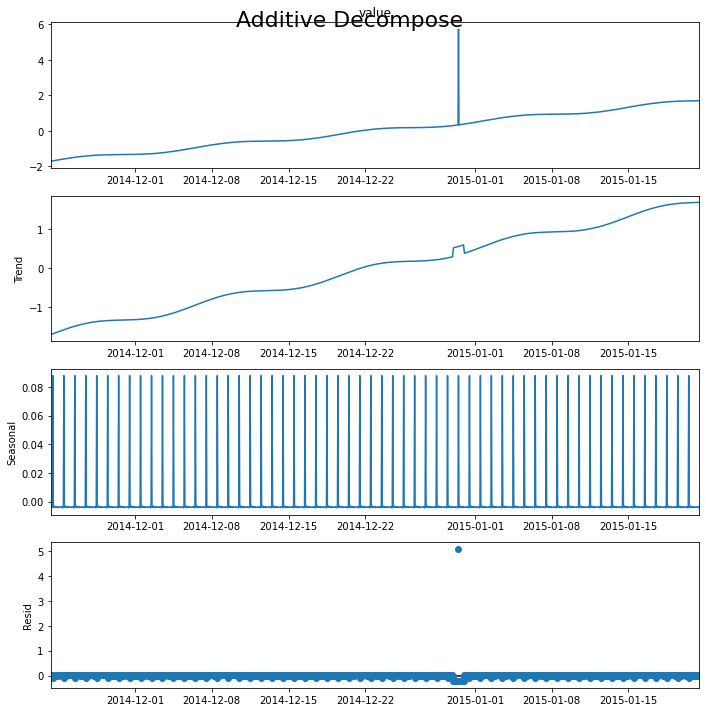



File: A2Benchmarksynthetic_63
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.740462           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.093057
Mean: 262.571053, StandardDeviation: 979.725799
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00   52.147071           0
1    2014-11-23 08:00:00   24.520095           0
2    2014-11-23 09:00:00  129.920957           0
3    2014-11-23 10:00:00  165.019947           0
4    2014-11-23 11:00:00  167.223298           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00  388.040815           0
1417 2015-01-21 08:00:00  294.040857           0
1418 2015-01-21 09:00:00  450.840912           0
1419 2015-01-21 10:00:00  550.047164           0
1420 2015-01-21 11:00:00  540.797748           0

[1421 rows x 3 columns]

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)






A2Benchmark_A2Benchmarksynthetic_64add_STL


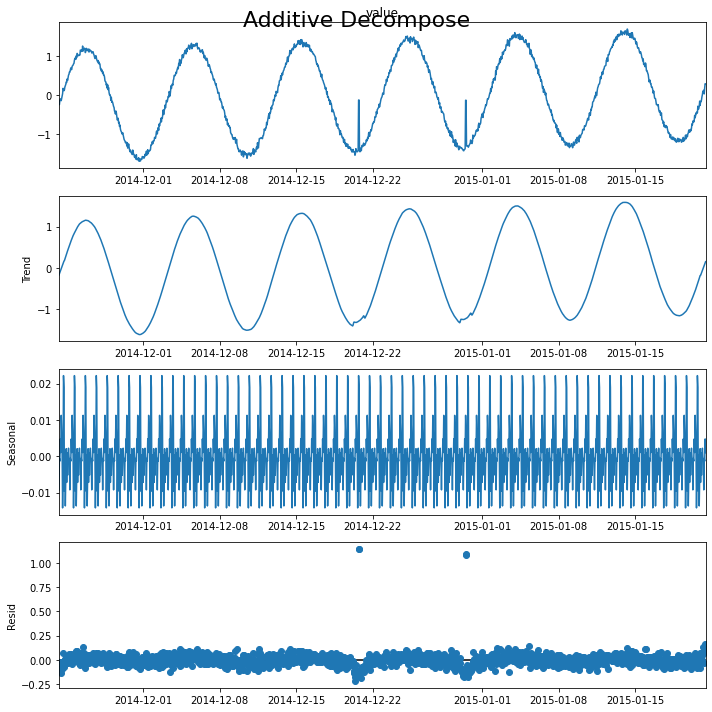



File: A2Benchmarksynthetic_64
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00 -0.124858           1
2014-12-20 18:00:00 -0.124858           1
2014-12-30 12:00:00 -0.130792           1
2014-12-30 13:00:00 -0.130792           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  1.144246
659 2014-12-20 18:00:00  1.141995
893 2014-12-30 12:00:00  1.086840
894 2014-12-30 13:00:00  1.085649
Mean: 13721.578066, StandardDeviation: 8515.530982


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp         value  is_anomaly
0    2014-11-23 07:00:00     83.243795           0
1    2014-11-23 08:00:00     67.479998           0
2    2014-11-23 09:00:00    217.171281           0
3    2014-11-23 10:00:00    279.376786           0
4    2014-11-23 11:00:00    300.607742           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  26894.089183           0
1417 2015-01-21 08:00:00  26703.362585           0
1418 2015-01-21 09:00:00  26824.355851           0
1419 2015-01-21 10:00:00  26873.540658           0
1420 2015-01-21 11:00:00  26787.733460           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_65add_STL


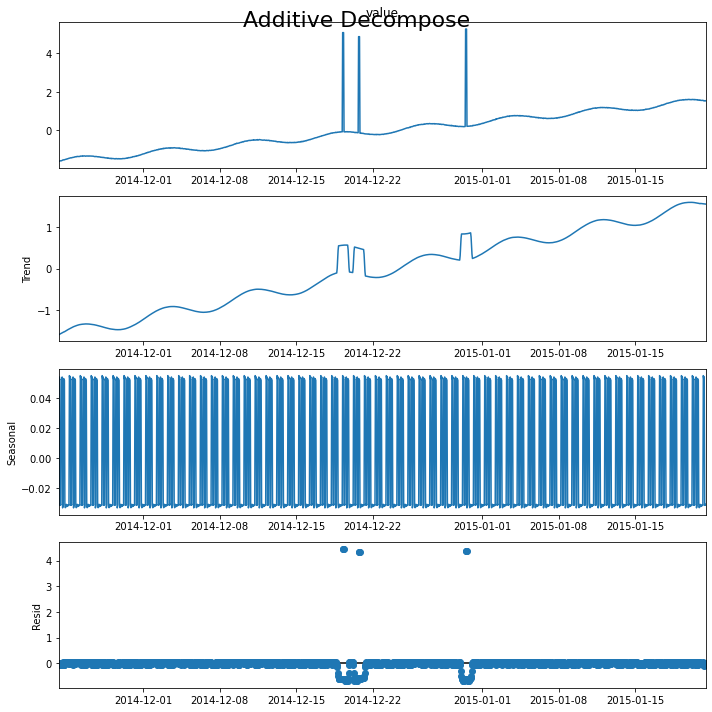



File: A2Benchmarksynthetic_65
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  5.074844           1
2014-12-19 07:00:00  5.074844           1
2014-12-19 08:00:00  5.074844           1
2014-12-20 17:00:00  4.864342           1
2014-12-20 18:00:00  4.864342           1
2014-12-20 19:00:00  4.864342           1
2014-12-30 12:00:00  5.261480           1
2014-12-30 13:00:00  5.261480           1
2014-12-30 14:00:00  5.261480           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.453405
624 2014-12-19 07:00:00  4.454976
625 2014-12-19 08:00:00  4.452806
658 2014-12-20 17:00:00  4.315518
659 2014-12-20 18:00:00  4.319296
660 2014-12-20 19:00:00  4.323476
893 2014-12-30 12:00:00  4.368688
894 2014-12-30 13:00:00  4.368221
895 2014-12-30 14:00:00  4.365246
Mean: 197.655971, StandardDeviation: 986.855883
               timestamp       value  is_anomaly
0    

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_66add_STL


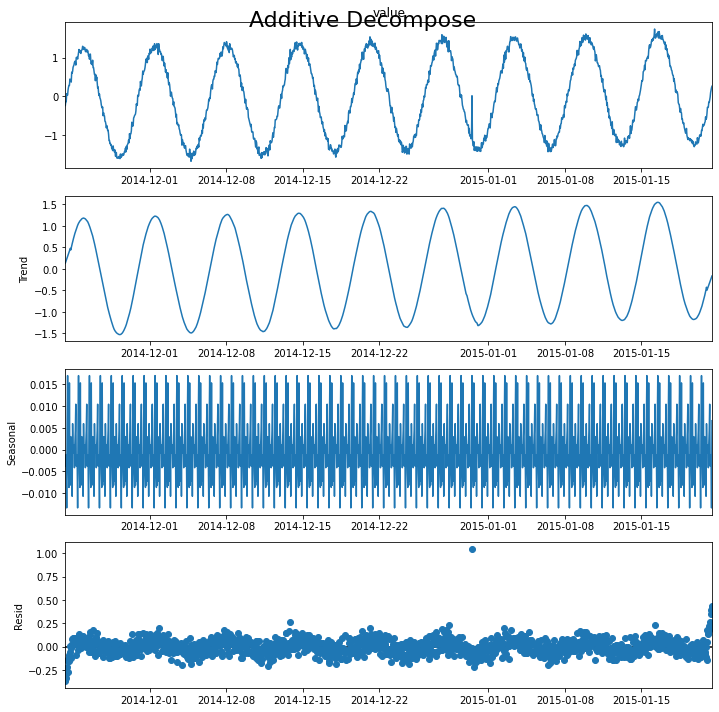



File: A2Benchmarksynthetic_66
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.013994           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  1.046566
Mean: 9755.358345, StandardDeviation: 5869.980223
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    103.211620           0
1    2014-11-23 08:00:00     68.942007           0
2    2014-11-23 09:00:00    264.942708           0
3    2014-11-23 10:00:00    339.011479           0
4    2014-11-23 11:00:00    355.830810           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  19478.485247           0
1417 2015-01-21 08:00:00  19200.347793           0
1418 2015-01-21 09:00:00  19355.966844           0
1419 2015-01-21 10:00:00  19411.479256           0
1420 2015-01-21 11:00:00  19278.992508           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_67add_STL


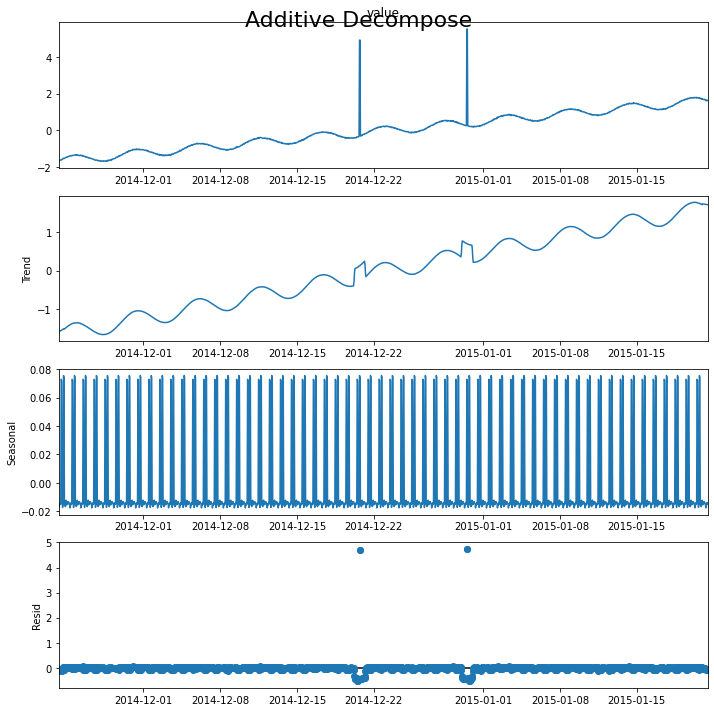



File: A2Benchmarksynthetic_67
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  4.906271           1
2014-12-20 18:00:00  4.906271           1
2014-12-30 12:00:00  5.508347           1
2014-12-30 13:00:00  5.508347           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.705997
659 2014-12-20 18:00:00  4.698244
893 2014-12-30 12:00:00  4.735452
894 2014-12-30 13:00:00  4.742644
Mean: 554.177127, StandardDeviation: 1030.296873
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   103.067447           0
1    2014-11-23 08:00:00    49.412750           0
2    2014-11-23 09:00:00   258.411464           0
3    2014-11-23 10:00:00   328.206299           0
4    2014-11-23 11:00:00   332.541348           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00   828.697336           0
1417 2015-01-21 08:00:00   642.97

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_68add_STL


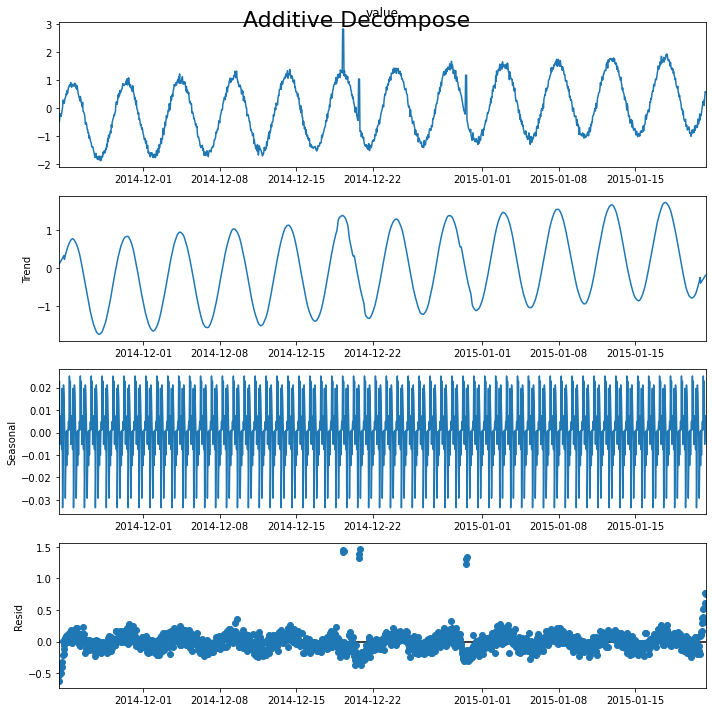



File: A2Benchmarksynthetic_68
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.816559           1
2014-12-19 07:00:00  2.816559           1
2014-12-19 08:00:00  2.816559           1
2014-12-20 17:00:00  1.029591           1
2014-12-20 18:00:00  1.029591           1
2014-12-20 19:00:00  1.029591           1
2014-12-30 12:00:00  1.165544           1
2014-12-30 13:00:00  1.165544           1
2014-12-30 14:00:00  1.165544           1
Detected outliers: 14
Outliers:
               timestamp     resid
623  2014-12-19 06:00:00  1.415977
624  2014-12-19 07:00:00  1.446963
625  2014-12-19 08:00:00  1.435442
658  2014-12-20 17:00:00  1.316042
659  2014-12-20 18:00:00  1.385983
660  2014-12-20 19:00:00  1.458276
893  2014-12-30 12:00:00  1.233155
894  2014-12-30 13:00:00  1.304075
895  2014-12-30 14:00:00  1.343120
1414 2015-01-21 05:00:00  0.521532
1416 2015-01-21 07:00:00  0.526468
1418 2015-01-21 09:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_69add_STL


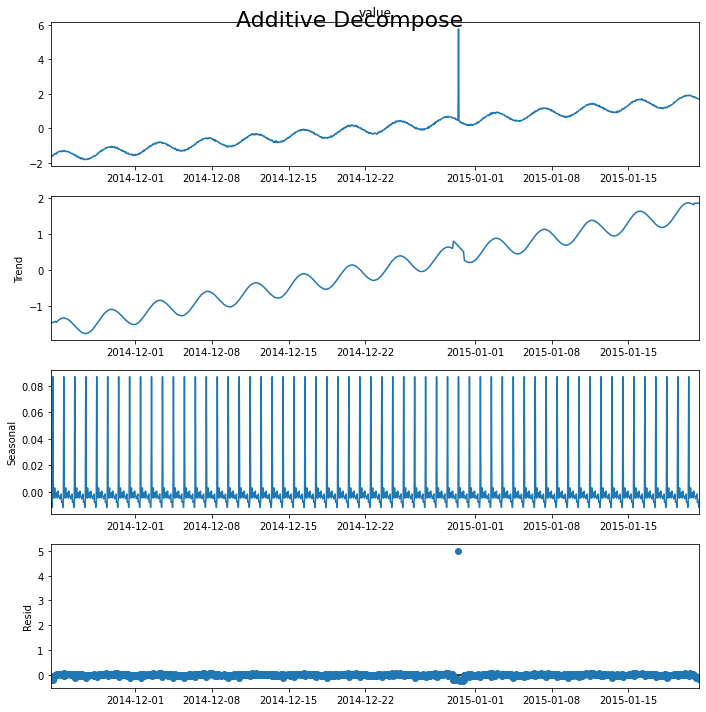



File: A2Benchmarksynthetic_69
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.763673           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.016235
Mean: 2534.131404, StandardDeviation: 1760.471141
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00    93.063930           0
1    2014-11-23 08:00:00    11.500044           0
2    2014-11-23 09:00:00   160.335747           0
3    2014-11-23 10:00:00   187.497770           0
4    2014-11-23 11:00:00   157.796984           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  4951.913174           0
1417 2015-01-21 08:00:00  4700.000458           0
1418 2015-01-21 09:00:00  4882.230876           0
1419 2015-01-21 10:00:00  4964.612907           0
1420 2015-01-21 11:00:00  4859.125051           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_7add_STL


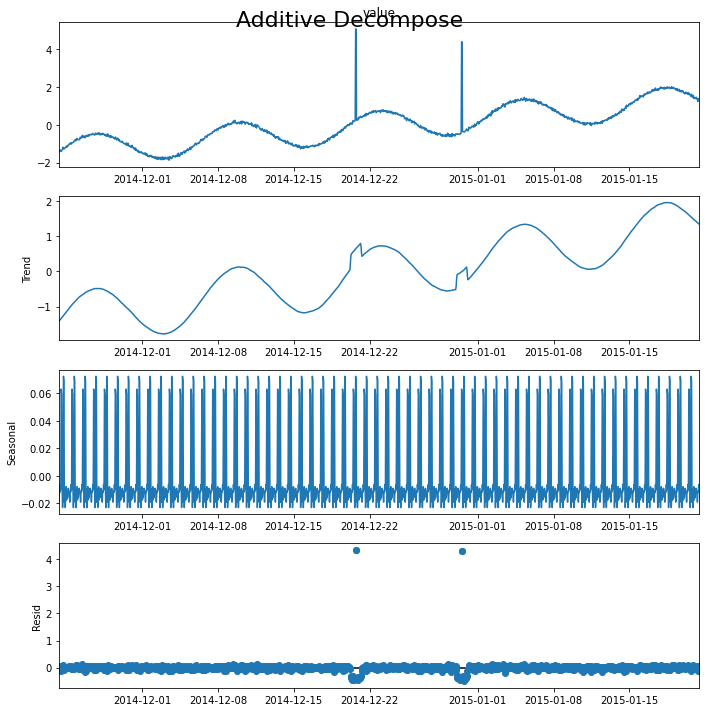



File: A2Benchmarksynthetic_7
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.056955           1
2014-12-20 18:00:00  5.056955           1
2014-12-30 12:00:00  4.377208           1
2014-12-30 13:00:00  4.377208           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.348569
659 2014-12-20 18:00:00  4.338888
893 2014-12-30 12:00:00  4.327391
894 2014-12-30 13:00:00  4.322832
Mean: 24127.274833, StandardDeviation: 13995.205958


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    161.207269           0
1    2014-11-23 08:00:00     62.222465           0
2    2014-11-23 09:00:00    290.993857           0
3    2014-11-23 10:00:00    346.689493           0
4    2014-11-23 11:00:00    321.509781           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  47835.928607           0
1417 2015-01-21 08:00:00  47518.144300           0
1418 2015-01-21 09:00:00  47817.957890           0
1419 2015-01-21 10:00:00  47975.742969           0
1420 2015-01-21 11:00:00  47866.281190           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_70add_STL


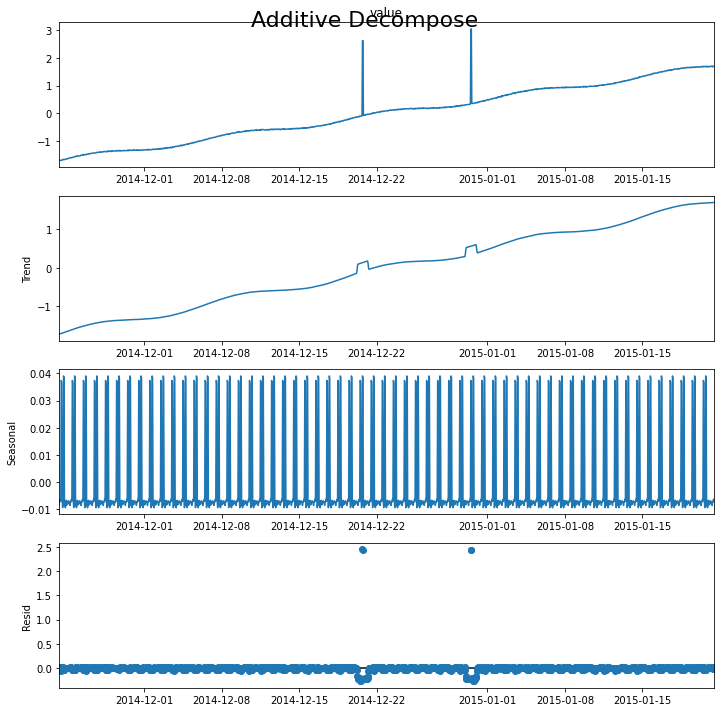



File: A2Benchmarksynthetic_70
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.622465           1
2014-12-20 18:00:00  2.622465           1
2014-12-30 12:00:00  3.043068           1
2014-12-30 13:00:00  3.043068           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.446297
659 2014-12-20 18:00:00  2.443243
893 2014-12-30 12:00:00  2.442789
894 2014-12-30 13:00:00  2.440352
Mean: 801.573541, StandardDeviation: 1050.638599
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   141.287016           0
1    2014-11-23 08:00:00     3.150050           0
2    2014-11-23 09:00:00   225.206341           0
3    2014-11-23 10:00:00   257.022581           0
4    2014-11-23 11:00:00   199.913925           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1457.451465           0
1417 2015-01-21 08:00:00  1139.88

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_71add_STL


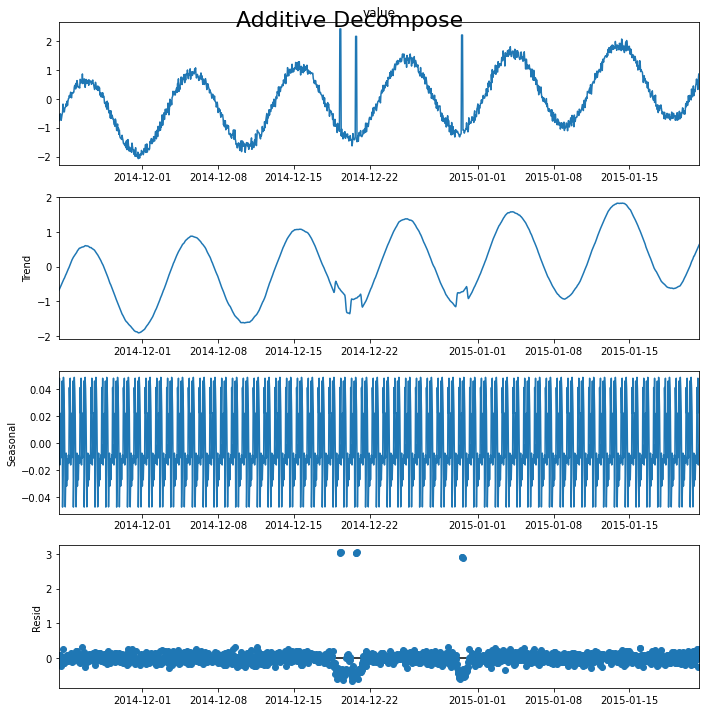



File: A2Benchmarksynthetic_71
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.417565           1
2014-12-19 07:00:00  2.417565           1
2014-12-19 08:00:00  2.417565           1
2014-12-20 17:00:00  2.159464           1
2014-12-20 18:00:00  2.159464           1
2014-12-20 19:00:00  2.159464           1
2014-12-30 12:00:00  2.205598           1
2014-12-30 13:00:00  2.205598           1
2014-12-30 14:00:00  2.205598           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  3.024189
624 2014-12-19 07:00:00  3.066176
625 2014-12-19 08:00:00  3.059383
658 2014-12-20 17:00:00  3.023567
659 2014-12-20 18:00:00  3.029733
660 2014-12-20 19:00:00  3.042784
893 2014-12-30 12:00:00  2.911187
894 2014-12-30 13:00:00  2.917520
895 2014-12-30 14:00:00  2.881697
Processing index: 70 of 100
Mean: 14842.931340, StandardDeviation: 8603.286780
               timestam

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_72add_STL


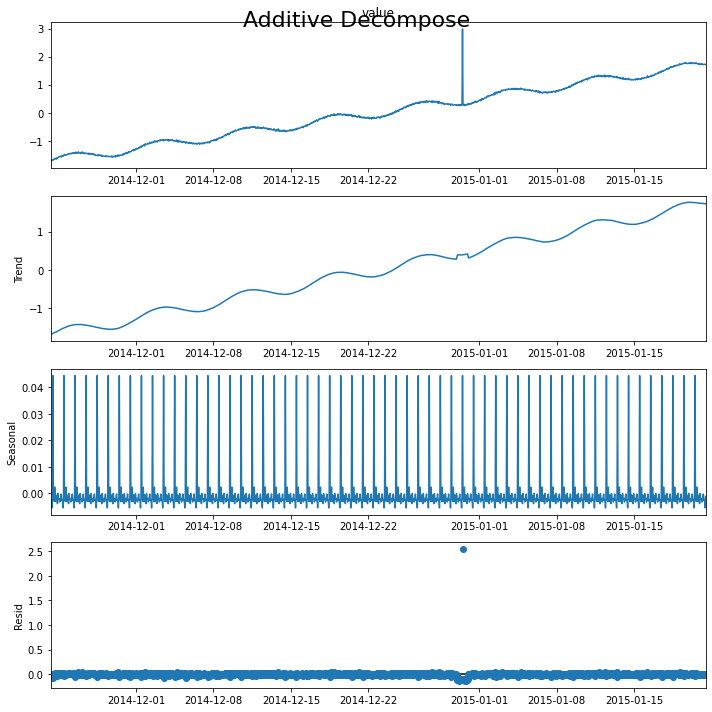



File: A2Benchmarksynthetic_72
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.985381           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.549133
Mean: 956.270534, StandardDeviation: 1118.566136
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   166.780675           0
1    2014-11-23 08:00:00    15.668229           0
2    2014-11-23 09:00:00   289.591259           0
3    2014-11-23 10:00:00   338.881930           0
4    2014-11-23 11:00:00   283.053269           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1724.894581           0
1417 2015-01-21 08:00:00  1361.684617           0
1418 2015-01-21 09:00:00  1799.825030           0
1419 2015-01-21 10:00:00  2053.955526           0
1420 2015-01-21 11:00:00  1961.561625           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_73add_STL


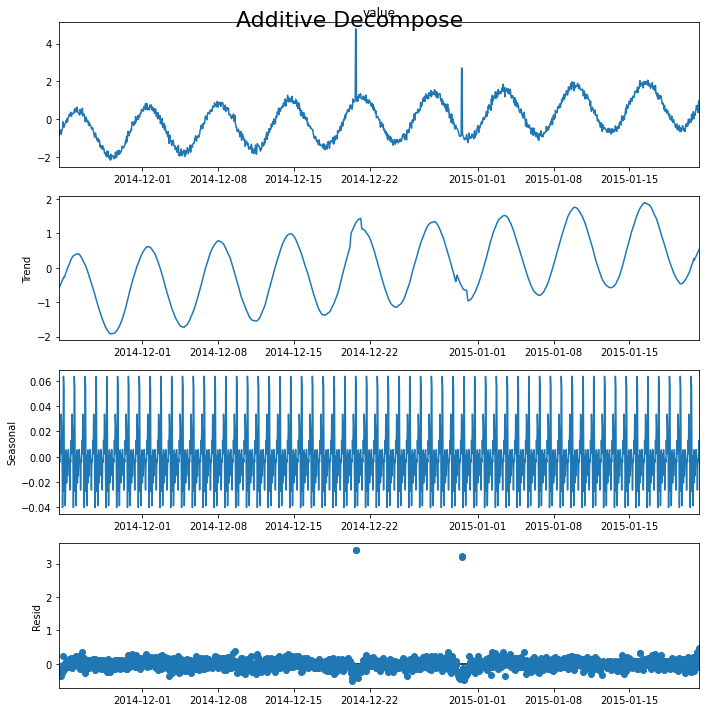



File: A2Benchmarksynthetic_73
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  4.770269           1
2014-12-20 18:00:00  4.770269           1
2014-12-30 12:00:00  2.703619           1
2014-12-30 13:00:00  2.703619           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  3.402556
659 2014-12-20 18:00:00  3.395093
893 2014-12-30 12:00:00  3.195482
894 2014-12-30 13:00:00  3.232765
Mean: 10261.456181, StandardDeviation: 6043.947087
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    192.310834           0
1    2014-11-23 08:00:00     47.490501           0
2    2014-11-23 09:00:00    360.105901           0
3    2014-11-23 10:00:00    430.851191           0
4    2014-11-23 11:00:00    388.317785           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  20490.180946           0
1417 2015-01-21 08:00:0

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_74add_STL


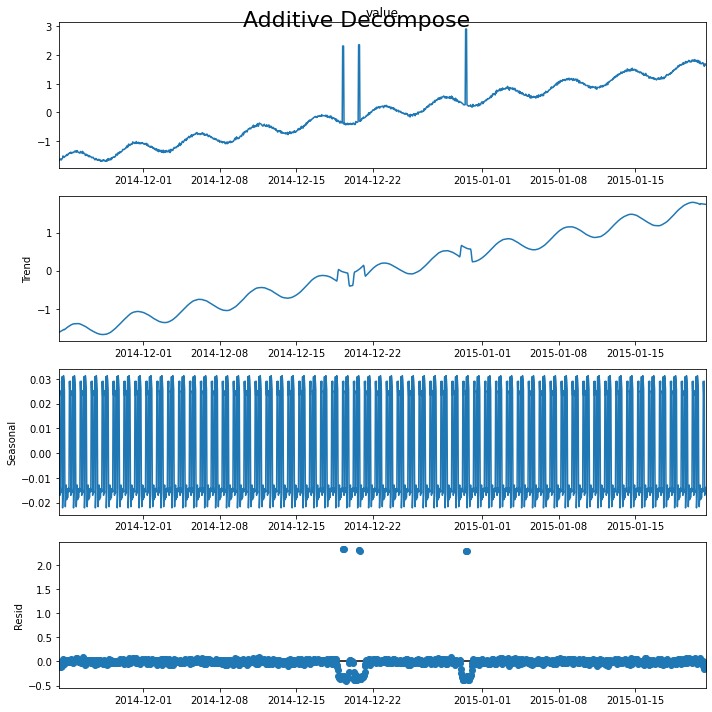



File: A2Benchmarksynthetic_74
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.317184           1
2014-12-19 07:00:00  2.317184           1
2014-12-19 08:00:00  2.317184           1
2014-12-20 17:00:00  2.359844           1
2014-12-20 18:00:00  2.359844           1
2014-12-20 19:00:00  2.359844           1
2014-12-30 12:00:00  2.911748           1
2014-12-30 13:00:00  2.911748           1
2014-12-30 14:00:00  2.911748           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.318457
624 2014-12-19 07:00:00  2.329743
625 2014-12-19 08:00:00  2.328760
658 2014-12-20 17:00:00  2.303785
659 2014-12-20 18:00:00  2.297699
660 2014-12-20 19:00:00  2.292798
893 2014-12-30 12:00:00  2.285087
894 2014-12-30 13:00:00  2.293372
895 2014-12-30 14:00:00  2.292250
Mean: 556.168299, StandardDeviation: 1032.250432
               timestamp        value  is_anomaly
0  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_75add_STL


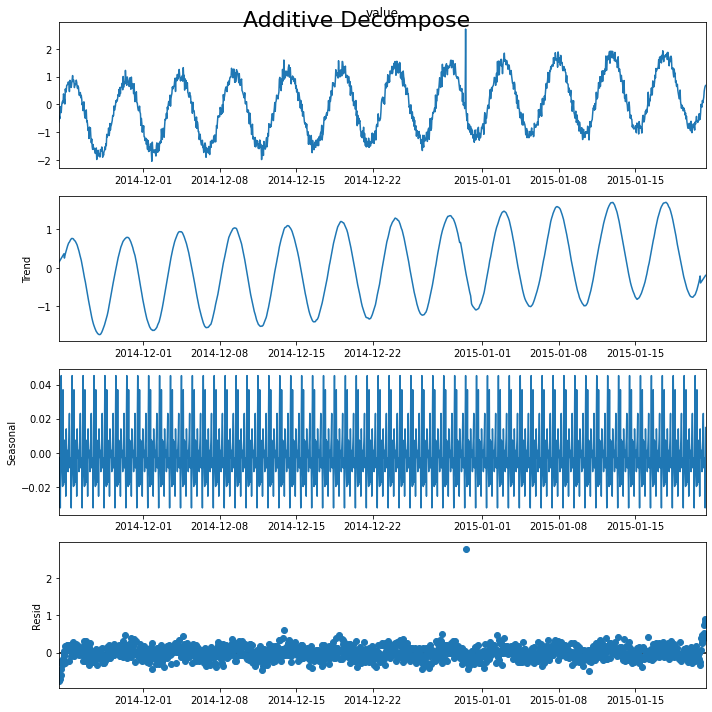



File: A2Benchmarksynthetic_75
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.720477           1
Detected outliers: 7
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.607741
893  2014-12-30 12:00:00  2.771429
1416 2015-01-21 07:00:00  0.536637
1417 2015-01-21 08:00:00  0.733114
1418 2015-01-21 09:00:00  0.818871
1419 2015-01-21 10:00:00  0.900011
1420 2015-01-21 11:00:00  0.863473
Mean: 7759.722960, StandardDeviation: 4605.211318
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    214.160410           0
1    2014-11-23 08:00:00     52.704556           0
2    2014-11-23 09:00:00    413.431028           0
3    2014-11-23 10:00:00    497.704475           0
4    2014-11-23 11:00:00    452.220472           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  15740.289585           0
1417 2015-01-21 08:00:00  15153.441463  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_76add_STL


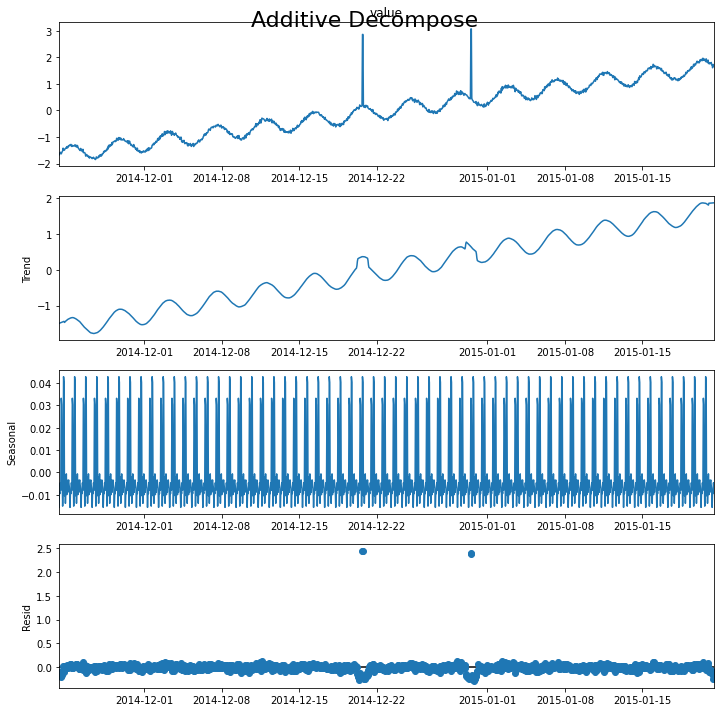



File: A2Benchmarksynthetic_76
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.860542           1
2014-12-20 18:00:00  2.860542           1
2014-12-30 12:00:00  3.068413           1
2014-12-30 13:00:00  3.068413           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.449250
659 2014-12-20 18:00:00  2.452510
893 2014-12-30 12:00:00  2.385978
894 2014-12-30 13:00:00  2.404010
Mean: 26401.054954, StandardDeviation: 16295.078570
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    252.227264           0
1    2014-11-23 08:00:00     44.612520           0
2    2014-11-23 09:00:00    391.919391           0
3    2014-11-23 10:00:00    446.212325           0
4    2014-11-23 11:00:00    363.600656           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  51569.369713           0
1417 2015-01-21 08:00:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_77add_STL


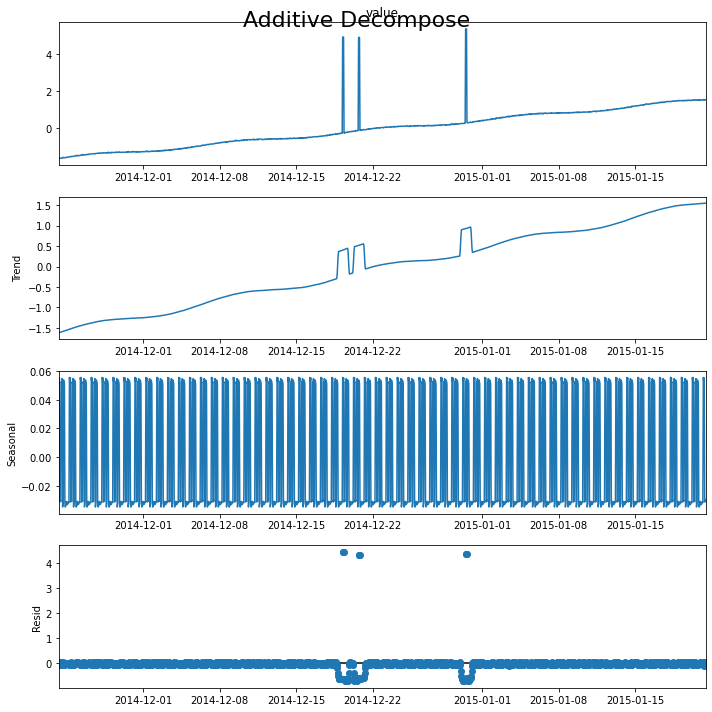



File: A2Benchmarksynthetic_77
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.923091           1
2014-12-19 07:00:00  4.923091           1
2014-12-19 08:00:00  4.923091           1
2014-12-20 17:00:00  4.904308           1
2014-12-20 18:00:00  4.904308           1
2014-12-20 19:00:00  4.904308           1
2014-12-30 12:00:00  5.363630           1
2014-12-30 13:00:00  5.363630           1
2014-12-30 14:00:00  5.363630           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.468317
624 2014-12-19 07:00:00  4.467260
625 2014-12-19 08:00:00  4.460687
658 2014-12-20 17:00:00  4.333877
659 2014-12-20 18:00:00  4.331673
660 2014-12-20 19:00:00  4.330283
893 2014-12-30 12:00:00  4.385312
894 2014-12-30 13:00:00  4.383585
895 2014-12-30 14:00:00  4.377731
Mean: 691.874740, StandardDeviation: 1044.758674
               timestamp        value  is_anomaly
0  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_78add_STL


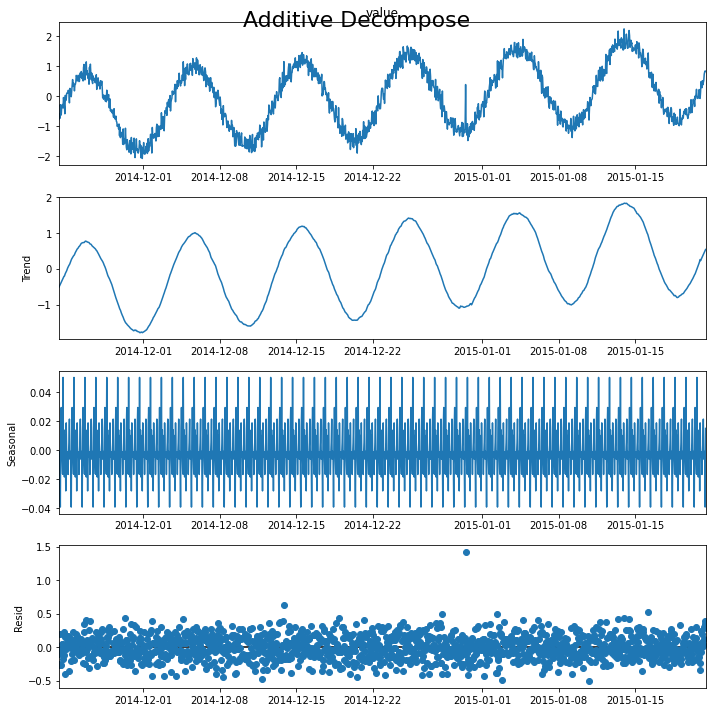



File: A2Benchmarksynthetic_78
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.393997           1
Detected outliers: 4
Outliers:
               timestamp     resid
494  2014-12-13 21:00:00  0.634554
842  2014-12-28 09:00:00  0.500979
893  2014-12-30 12:00:00  1.424752
1294 2015-01-16 05:00:00  0.531650
Mean: 15368.062661, StandardDeviation: 9186.095179
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    262.571325           0
1    2014-11-23 08:00:00     26.835186           0
2    2014-11-23 09:00:00    410.884967           0
3    2014-11-23 10:00:00    467.572609           0
4    2014-11-23 11:00:00    371.227191           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  30517.414841           0
1417 2015-01-21 08:00:00  29880.612767           0
1418 2015-01-21 09:00:00  30411.652778           0
1419 2015-01-21 10:00:00  30674.043758    

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_79add_STL


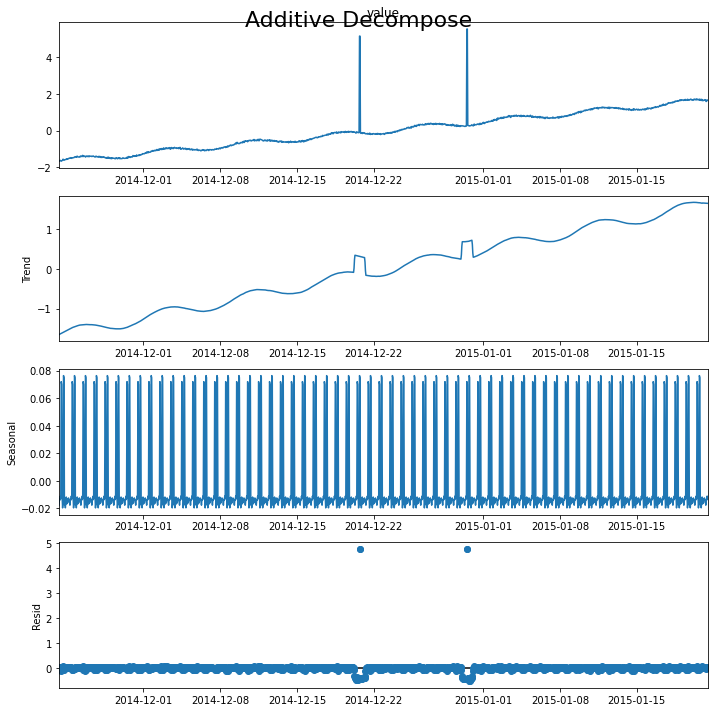



File: A2Benchmarksynthetic_79
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.133387           1
2014-12-20 18:00:00  5.133387           1
2014-12-30 12:00:00  5.518660           1
2014-12-30 13:00:00  5.518660           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.736917
659 2014-12-20 18:00:00  4.742197
893 2014-12-30 12:00:00  4.751705
894 2014-12-30 13:00:00  4.752863
Mean: 68.708294, StandardDeviation: 984.090053
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  102.389668           0
1    2014-11-23 08:00:00   10.919611           0
2    2014-11-23 09:00:00  182.286204           0
3    2014-11-23 10:00:00  214.814822           0
4    2014-11-23 11:00:00  182.431083           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00   15.005324           0
1417 2015-01-21 08:00:00 -207.438610       

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_8add_STL


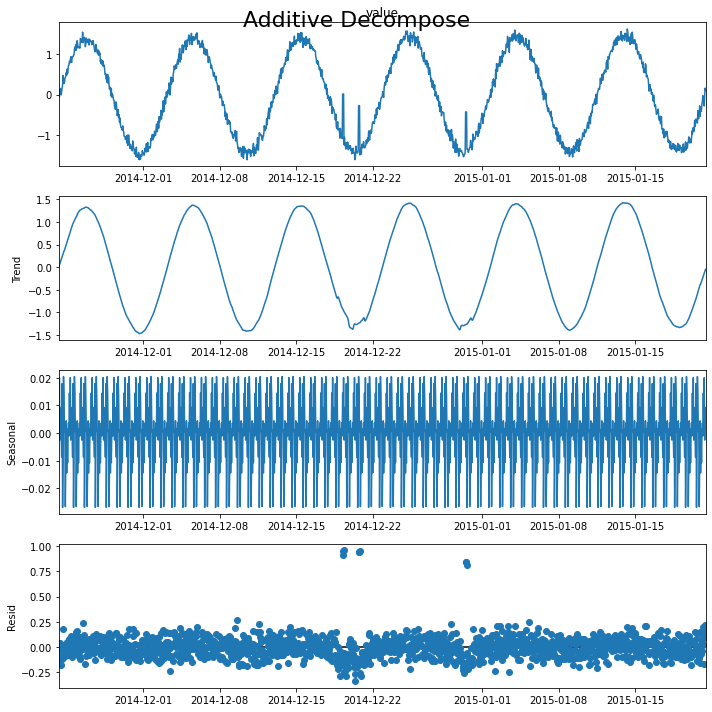



File: A2Benchmarksynthetic_8
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  0.013412           1
2014-12-19 07:00:00  0.013412           1
2014-12-19 08:00:00  0.013412           1
2014-12-20 17:00:00 -0.273472           1
2014-12-20 18:00:00 -0.273472           1
2014-12-20 19:00:00 -0.273472           1
2014-12-30 12:00:00 -0.426353           1
2014-12-30 13:00:00 -0.426353           1
2014-12-30 14:00:00 -0.426353           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  0.915958
624 2014-12-19 07:00:00  0.956065
625 2014-12-19 08:00:00  0.957762
658 2014-12-20 17:00:00  0.943694
659 2014-12-20 18:00:00  0.947189
660 2014-12-20 19:00:00  0.955691
893 2014-12-30 12:00:00  0.842431
894 2014-12-30 13:00:00  0.846480
895 2014-12-30 14:00:00  0.817429
Mean: 1607.222200, StandardDeviation: 1324.676696
               timestamp        value  is_anomaly
0  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_80add_STL


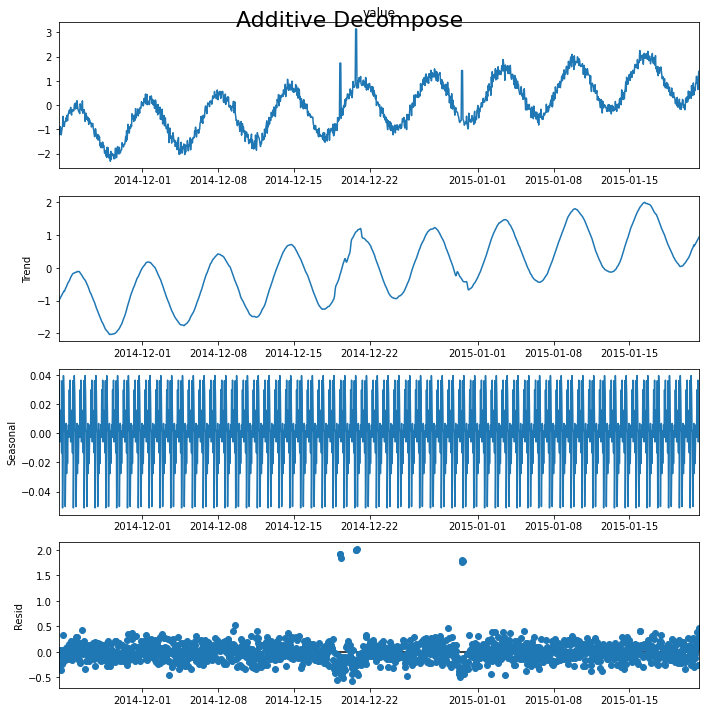



File: A2Benchmarksynthetic_80
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  1.729175           1
2014-12-19 07:00:00  1.729175           1
2014-12-19 08:00:00  1.729175           1
2014-12-20 17:00:00  3.133628           1
2014-12-20 18:00:00  3.133628           1
2014-12-20 19:00:00  3.133628           1
2014-12-30 12:00:00  1.423835           1
2014-12-30 13:00:00  1.423835           1
2014-12-30 14:00:00  1.423835           1
Detected outliers: 10
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.527601
623 2014-12-19 06:00:00  1.922157
624 2014-12-19 07:00:00  1.912750
625 2014-12-19 08:00:00  1.832528
658 2014-12-20 17:00:00  2.005452
659 2014-12-20 18:00:00  2.005576
660 2014-12-20 19:00:00  2.017938
893 2014-12-30 12:00:00  1.757932
894 2014-12-30 13:00:00  1.795187
895 2014-12-30 14:00:00  1.771814
Processing index: 80 of 100
Mean: 11436.166506, StandardDeviation: 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_81add_STL


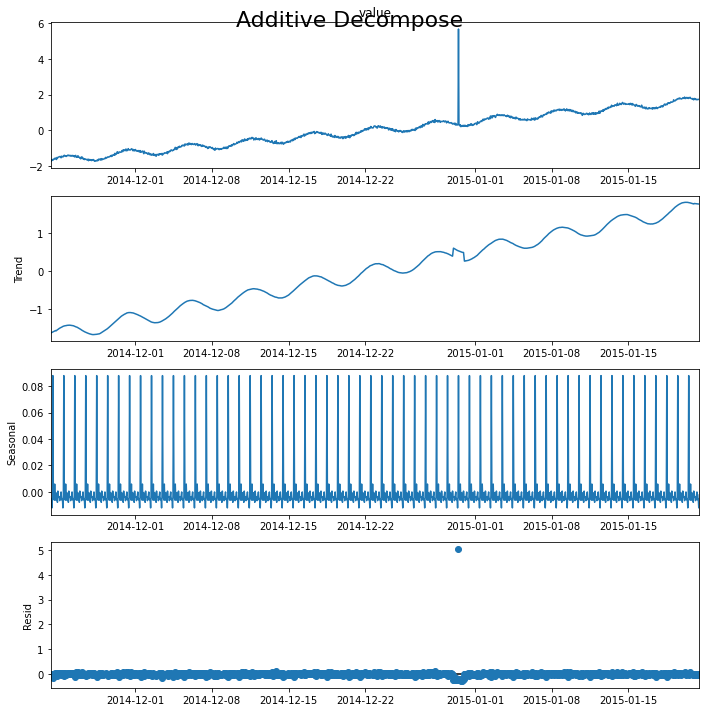



File: A2Benchmarksynthetic_81
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.658333           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  5.038939
Mean: 1800.062459, StandardDeviation: 1407.250292
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   281.640205           0
1    2014-11-23 08:00:00     7.258396           0
2    2014-11-23 09:00:00   449.860835           0
3    2014-11-23 10:00:00   513.383037           0
4    2014-11-23 11:00:00   399.386940           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3382.512072           0
1417 2015-01-21 08:00:00  2749.956679           0
1418 2015-01-21 09:00:00  3469.477298           0
1419 2015-01-21 10:00:00  3878.689282           0
1420 2015-01-21 11:00:00  3703.367001           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_82add_STL


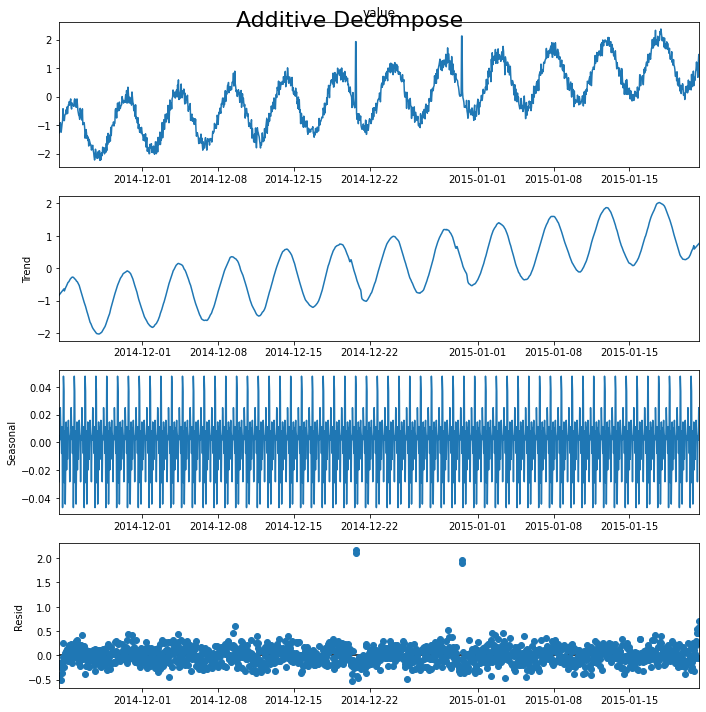



File: A2Benchmarksynthetic_82
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  1.924748           1
2014-12-20 18:00:00  1.924748           1
2014-12-30 12:00:00  2.122196           1
2014-12-30 13:00:00  2.122196           1
Detected outliers: 9
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.596376
658  2014-12-20 17:00:00  2.108928
659  2014-12-20 18:00:00  2.172272
862  2014-12-29 05:00:00  0.522110
893  2014-12-30 12:00:00  1.904208
894  2014-12-30 13:00:00  1.967040
1414 2015-01-21 05:00:00  0.534444
1419 2015-01-21 10:00:00  0.700538
1420 2015-01-21 11:00:00  0.573651
Mean: 8016.500290, StandardDeviation: 5055.484515


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    302.753961           0
1    2014-11-23 08:00:00     30.241723           0
2    2014-11-23 09:00:00    507.077230           0
3    2014-11-23 10:00:00    587.521533           0
4    2014-11-23 11:00:00    482.179128           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  16035.459791           0
1417 2015-01-21 08:00:00  15224.503717           0
1418 2015-01-21 09:00:00  15825.259148           0
1419 2015-01-21 10:00:00  16100.632421           0
1420 2015-01-21 11:00:00  15764.504869           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_83add_STL


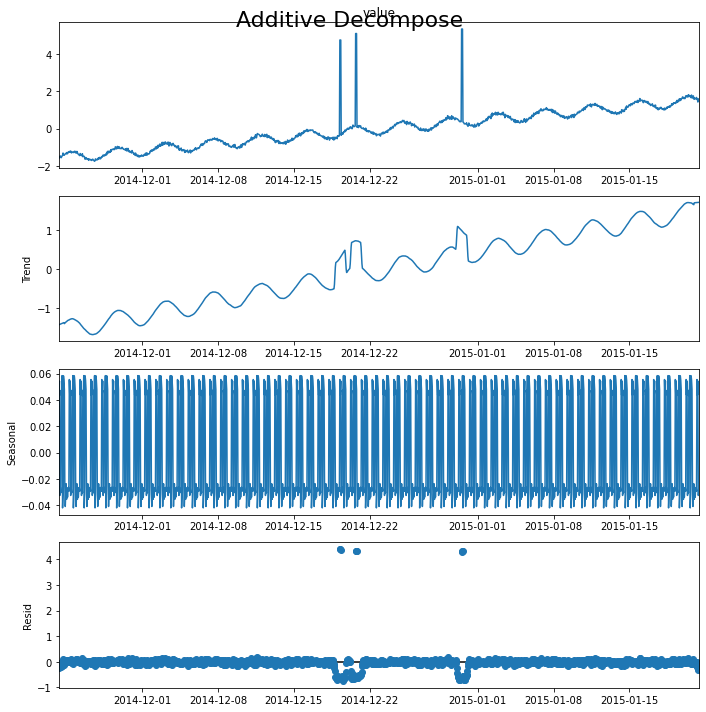



File: A2Benchmarksynthetic_83
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.751598           1
2014-12-19 07:00:00  4.751598           1
2014-12-19 08:00:00  4.751598           1
2014-12-20 17:00:00  5.100007           1
2014-12-20 18:00:00  5.100007           1
2014-12-20 19:00:00  5.100007           1
2014-12-30 12:00:00  5.342319           1
2014-12-30 13:00:00  5.342319           1
2014-12-30 14:00:00  5.342319           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.409363
624 2014-12-19 07:00:00  4.405732
625 2014-12-19 08:00:00  4.377959
658 2014-12-20 17:00:00  4.314393
659 2014-12-20 18:00:00  4.319187
660 2014-12-20 19:00:00  4.327791
893 2014-12-30 12:00:00  4.304559
894 2014-12-30 13:00:00  4.322639
895 2014-12-30 14:00:00  4.322883
Mean: 28683.962627, StandardDeviation: 16557.612808
               timestamp         value  is_anomaly

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_84add_STL


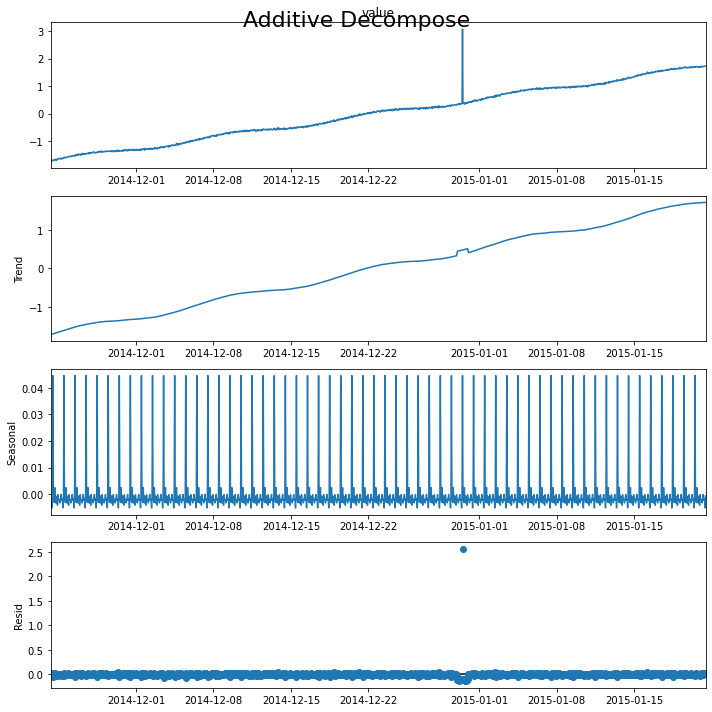



File: A2Benchmarksynthetic_84
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  3.080009           1
Detected outliers: 1
Outliers:
              timestamp   resid
893 2014-12-30 12:00:00  2.5588
Mean: 2129.056749, StandardDeviation: 1517.746802


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   319.976921           0
1    2014-11-23 08:00:00   -38.770010           0
2    2014-11-23 09:00:00   417.007154           0
3    2014-11-23 10:00:00   442.667907           0
4    2014-11-23 11:00:00   267.345252           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  4177.263576           0
1417 2015-01-21 08:00:00  3412.988960           0
1418 2015-01-21 09:00:00  4183.697689           0
1419 2015-01-21 10:00:00  4601.551756           0
1420 2015-01-21 11:00:00  4355.311348           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_85add_STL


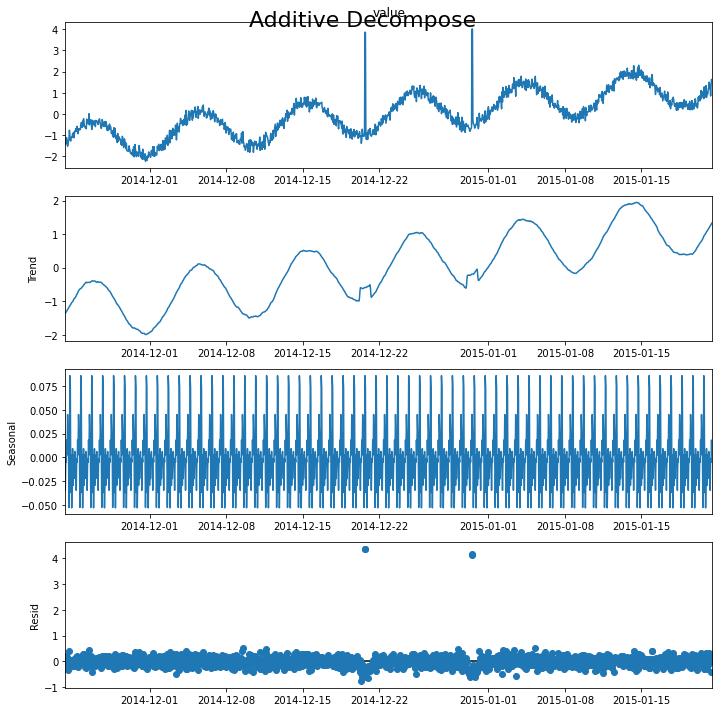



File: A2Benchmarksynthetic_85
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  3.849825           1
2014-12-20 18:00:00  3.849825           1
2014-12-30 12:00:00  4.007059           1
2014-12-30 13:00:00  4.007059           1
Detected outliers: 6
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.511608
658  2014-12-20 17:00:00  4.351933
659  2014-12-20 18:00:00  4.367379
893  2014-12-30 12:00:00  4.152770
894  2014-12-30 13:00:00  4.167193
1032 2015-01-05 07:00:00  0.511715
Mean: 16138.431827, StandardDeviation: 9461.186154
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    352.030082           0
1    2014-11-23 08:00:00      6.102766           0
2    2014-11-23 09:00:00    507.126788           0
3    2014-11-23 10:00:00    560.850491           0
4    2014-11-23 11:00:00    405.511879           0
...                  ...           ...         ...

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_86add_STL


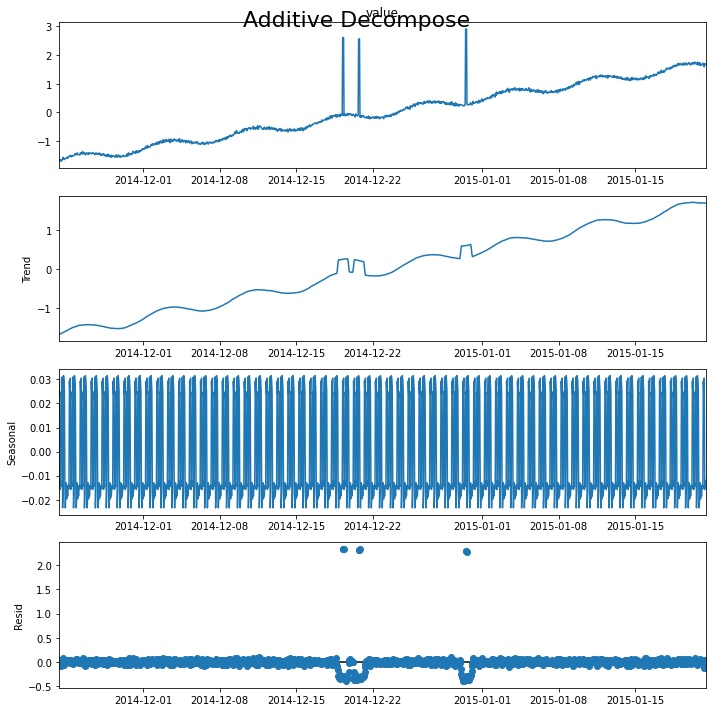



File: A2Benchmarksynthetic_86
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.610746           1
2014-12-19 07:00:00  2.610746           1
2014-12-19 08:00:00  2.610746           1
2014-12-20 17:00:00  2.564485           1
2014-12-20 18:00:00  2.564485           1
2014-12-20 19:00:00  2.564485           1
2014-12-30 12:00:00  2.911057           1
2014-12-30 13:00:00  2.911057           1
2014-12-30 14:00:00  2.911057           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.336470
624 2014-12-19 07:00:00  2.340990
625 2014-12-19 08:00:00  2.332884
658 2014-12-20 17:00:00  2.318577
659 2014-12-20 18:00:00  2.324589
660 2014-12-20 19:00:00  2.332668
893 2014-12-30 12:00:00  2.291685
894 2014-12-30 13:00:00  2.293603
895 2014-12-30 14:00:00  2.284593
Mean: 1157.094306, StandardDeviation: 1176.287387
               timestamp        value  is_anomaly
0 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_87add_STL


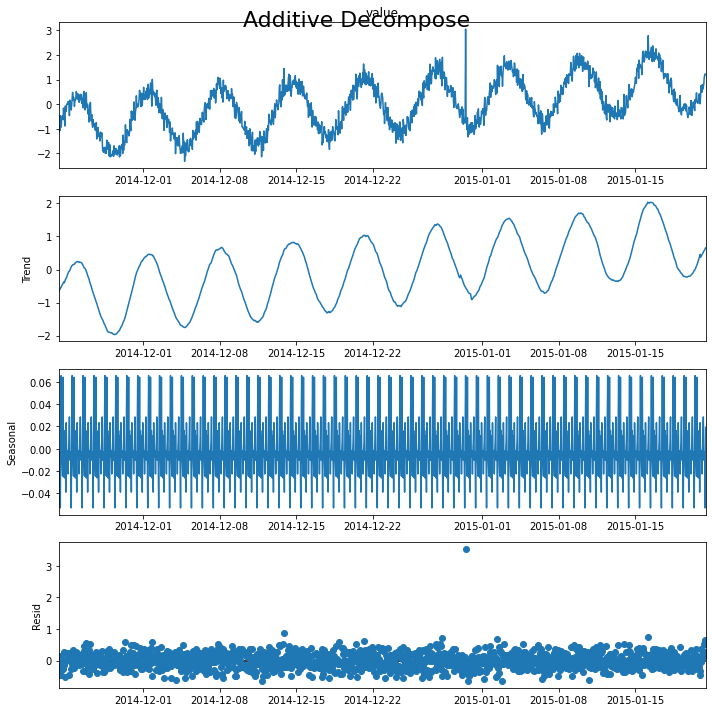



File: A2Benchmarksynthetic_87
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  3.054031           1
Detected outliers: 24
Outliers:
               timestamp     resid
60   2014-11-25 19:00:00  0.544487
69   2014-11-26 04:00:00  0.508661
146  2014-11-29 09:00:00  0.584630
205  2014-12-01 20:00:00  0.592068
349  2014-12-07 20:00:00  0.512985
491  2014-12-13 18:00:00  0.537922
494  2014-12-13 21:00:00  0.862443
614  2014-12-18 21:00:00  0.577672
652  2014-12-20 11:00:00  0.522099
669  2014-12-21 04:00:00  0.610723
827  2014-12-27 18:00:00  0.530103
836  2014-12-28 03:00:00  0.521304
842  2014-12-28 09:00:00  0.716404
893  2014-12-30 12:00:00  3.533404
963  2015-01-02 10:00:00  0.671506
978  2015-01-03 01:00:00  0.520863
1019 2015-01-04 18:00:00  0.527582
1241 2015-01-14 00:00:00  0.517555
1252 2015-01-14 11:00:00  0.506539
1294 2015-01-16 05:00:00  0.743587
1417 2015-01-21 08:00:00  0.513442
1418 20

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_88add_STL


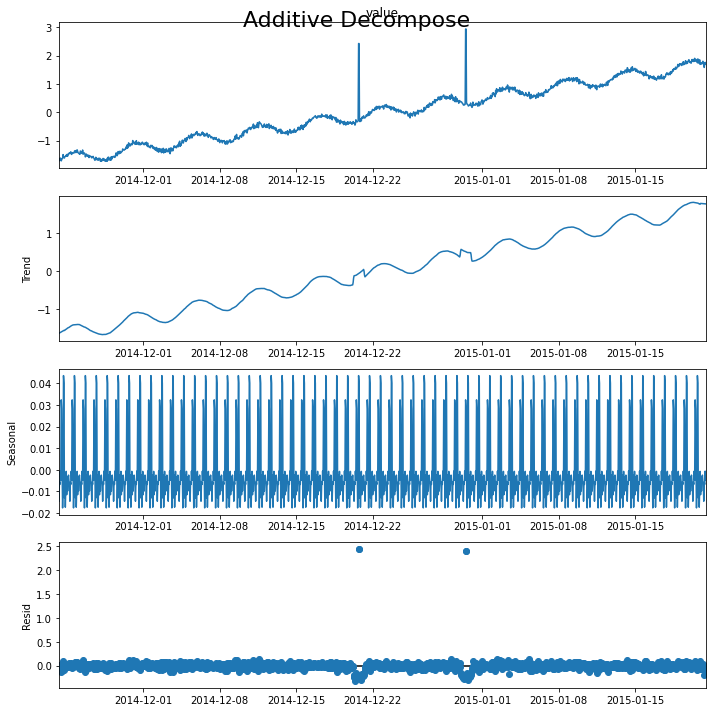



File: A2Benchmarksynthetic_88
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.423693           1
2014-12-20 18:00:00  2.423693           1
2014-12-30 12:00:00  2.935572           1
2014-12-30 13:00:00  2.935572           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  2.444009
659 2014-12-20 18:00:00  2.441041
893 2014-12-30 12:00:00  2.391470
894 2014-12-30 13:00:00  2.401846
Mean: 2615.639684, StandardDeviation: 1883.715525


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   371.131592           0
1    2014-11-23 08:00:00   -13.408767           0
2    2014-11-23 09:00:00   546.200543           0
3    2014-11-23 10:00:00   606.791435           0
4    2014-11-23 11:00:00   433.834773           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  4949.914846           0
1417 2015-01-21 08:00:00  4094.149336           0
1418 2015-01-21 09:00:00  5018.520950           0
1419 2015-01-21 10:00:00  5534.163641           0
1420 2015-01-21 11:00:00  5280.059132           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_89add_STL


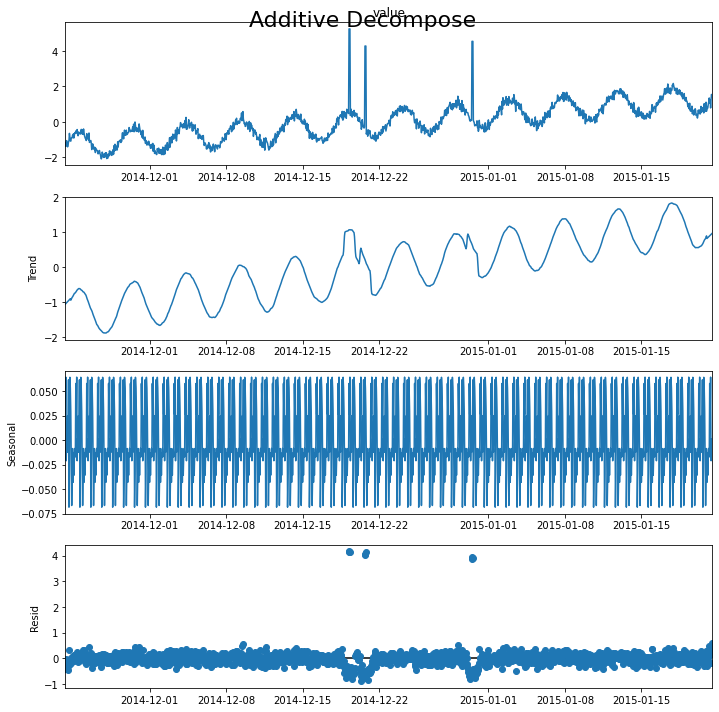



File: A2Benchmarksynthetic_89
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  5.262630           1
2014-12-19 07:00:00  5.262630           1
2014-12-19 08:00:00  5.262630           1
2014-12-20 17:00:00  4.291913           1
2014-12-20 18:00:00  4.291913           1
2014-12-20 19:00:00  4.291913           1
2014-12-30 12:00:00  4.557729           1
2014-12-30 13:00:00  4.557729           1
2014-12-30 14:00:00  4.557729           1
Detected outliers: 12
Outliers:
               timestamp     resid
390  2014-12-09 13:00:00  0.553158
623  2014-12-19 06:00:00  4.132266
624  2014-12-19 07:00:00  4.167630
625  2014-12-19 08:00:00  4.130801
658  2014-12-20 17:00:00  4.011156
659  2014-12-20 18:00:00  4.062904
660  2014-12-20 19:00:00  4.124505
862  2014-12-29 05:00:00  0.522551
893  2014-12-30 12:00:00  3.878829
894  2014-12-30 13:00:00  3.929737
895  2014-12-30 14:00:00  3.919668
1419 2015-01-21 10:00

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_9add_STL


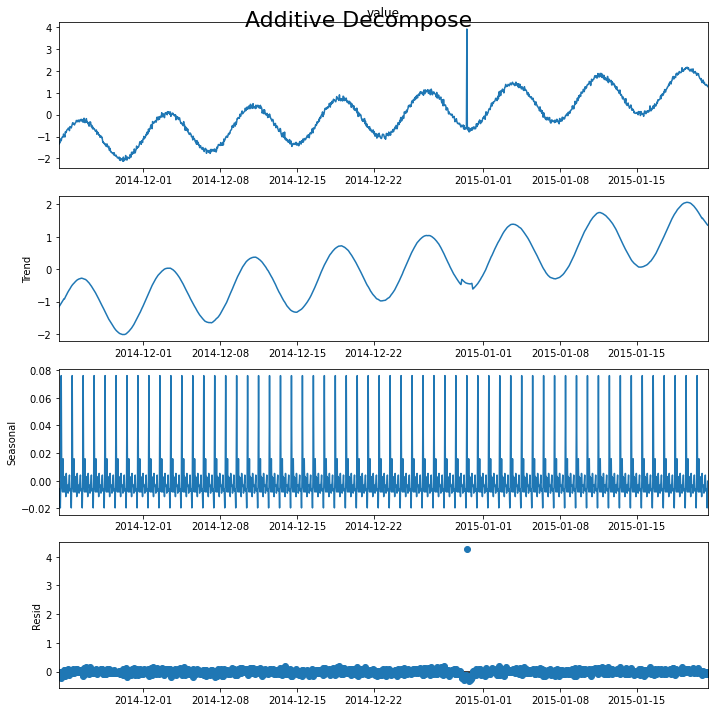



File: A2Benchmarksynthetic_9
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  3.915113           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  4.272283
Processing index: 90 of 100
Mean: 9260.052047, StandardDeviation: 5432.702685
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -175.593664           0
1    2014-11-23 08:00:00    164.793093           0
2    2014-11-23 09:00:00    -45.758379           0
3    2014-11-23 10:00:00    781.599526           0
4    2014-11-23 11:00:00    495.365852           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  18730.286148           0
1417 2015-01-21 08:00:00  18967.212094           0
1418 2015-01-21 09:00:00  18958.837821           0
1419 2015-01-21 10:00:00  18885.499014           0
1420 2015-01-21 11:00:00  18723.549353           0

[1421 rows x 3 colum

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_90add_STL


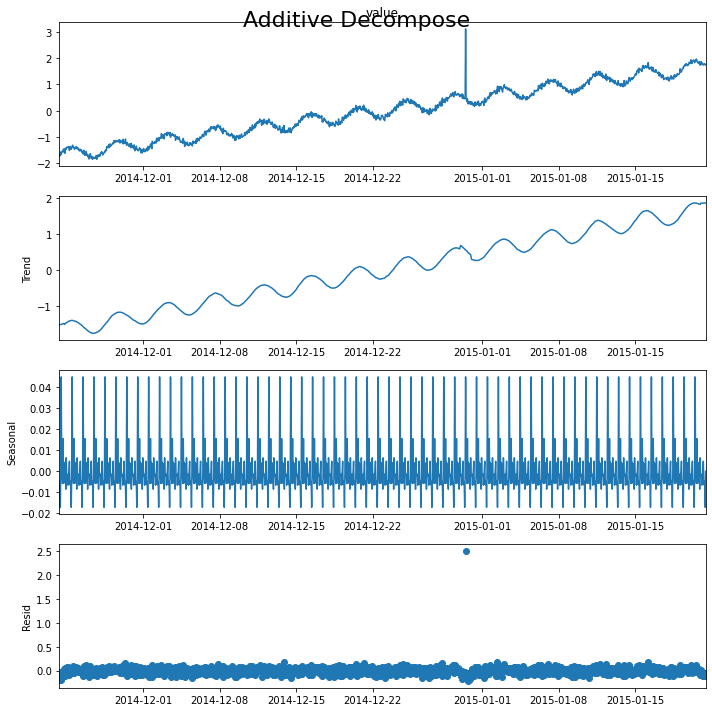



File: A2Benchmarksynthetic_90
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  3.109271           1
Detected outliers: 1
Outliers:
              timestamp     resid
893 2014-12-30 12:00:00  2.506382
Mean: 29558.600651, StandardDeviation: 17611.290616
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    433.857239           0
1    2014-11-23 08:00:00      8.572600           0
2    2014-11-23 09:00:00    592.540413           0
3    2014-11-23 10:00:00    643.617932           0
4    2014-11-23 11:00:00    445.732334           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  58455.261116           0
1417 2015-01-21 08:00:00  57472.022271           0
1418 2015-01-21 09:00:00  58390.564656           0
1419 2015-01-21 10:00:00  58871.817669           0
1420 2015-01-21 11:00:00  58530.185018           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_91add_STL


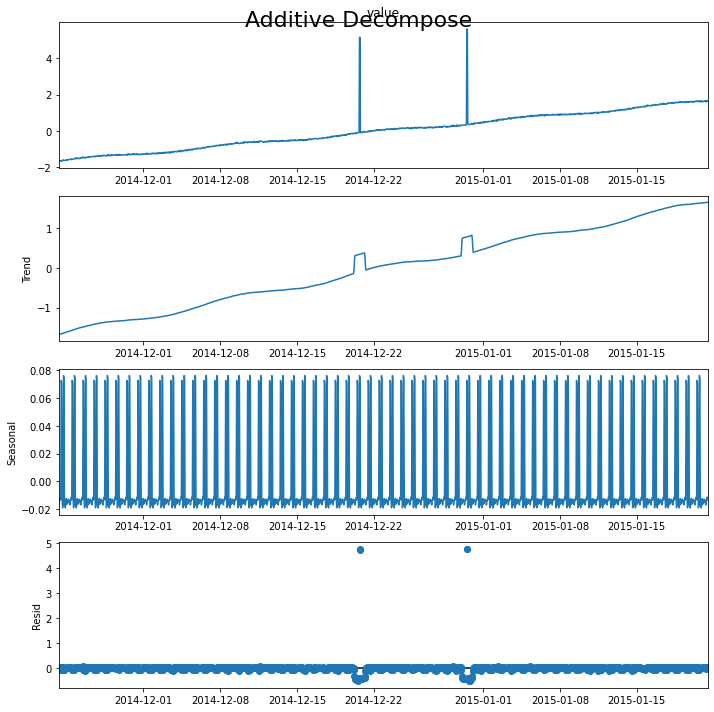



File: A2Benchmarksynthetic_91
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.157234           1
2014-12-20 18:00:00  5.157234           1
2014-12-30 12:00:00  5.613527           1
2014-12-30 13:00:00  5.613527           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.743414
659 2014-12-20 18:00:00  4.742174
893 2014-12-30 12:00:00  4.766111
894 2014-12-30 13:00:00  4.765214
Mean: 2949.875475, StandardDeviation: 1884.576544
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   409.526881           0
1    2014-11-23 08:00:00   -59.320025           0
2    2014-11-23 09:00:00   513.522583           0
3    2014-11-23 10:00:00   536.310600           0
4    2014-11-23 11:00:00   302.085952           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  5827.665037           0
1417 2015-01-21 08:00:00  4840.2

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_92add_STL


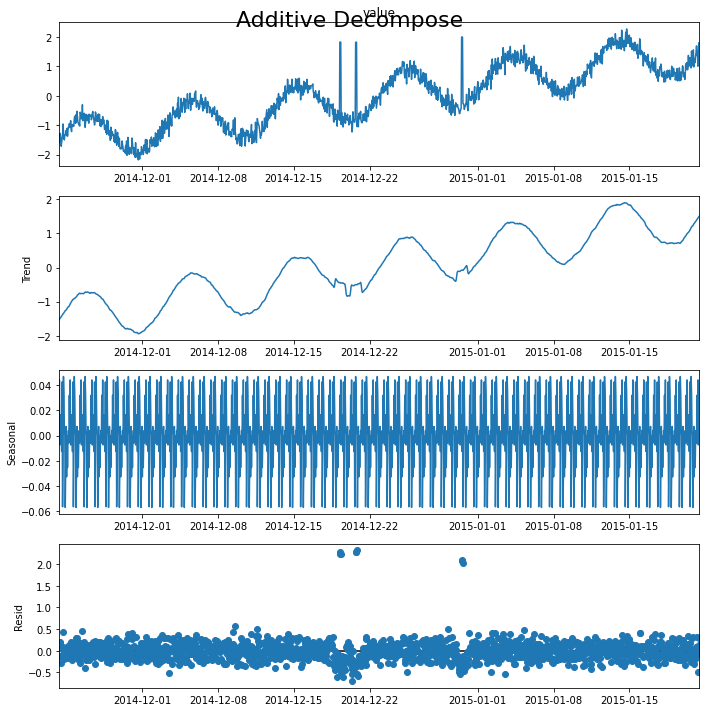



File: A2Benchmarksynthetic_92
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  1.823968           1
2014-12-19 07:00:00  1.823968           1
2014-12-19 08:00:00  1.823968           1
2014-12-20 17:00:00  1.818159           1
2014-12-20 18:00:00  1.818159           1
2014-12-20 19:00:00  1.818159           1
2014-12-30 12:00:00  1.994622           1
2014-12-30 13:00:00  1.994622           1
2014-12-30 14:00:00  1.994622           1
Detected outliers: 11
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.571870
623 2014-12-19 06:00:00  2.227866
624 2014-12-19 07:00:00  2.269009
625 2014-12-19 08:00:00  2.234616
658 2014-12-20 17:00:00  2.271063
659 2014-12-20 18:00:00  2.287897
660 2014-12-20 19:00:00  2.317132
862 2014-12-29 05:00:00  0.500102
893 2014-12-30 12:00:00  2.067801
894 2014-12-30 13:00:00  2.083352
895 2014-12-30 14:00:00  2.031879
Mean: 18212.607413, StandardDevia

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -181.874566           0
1    2014-11-23 08:00:00    158.200876           0
2    2014-11-23 09:00:00   -107.295997           0
3    2014-11-23 10:00:00    769.114909           0
4    2014-11-23 11:00:00    421.770693           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  36316.944906           0
1417 2015-01-21 08:00:00  36632.507258           0
1418 2015-01-21 09:00:00  36679.146514           0
1419 2015-01-21 10:00:00  36654.898651           0
1420 2015-01-21 11:00:00  36533.484987           0

[1421 rows x 3 columns]



A2Benchmark_A2Benchmarksynthetic_93add_STL


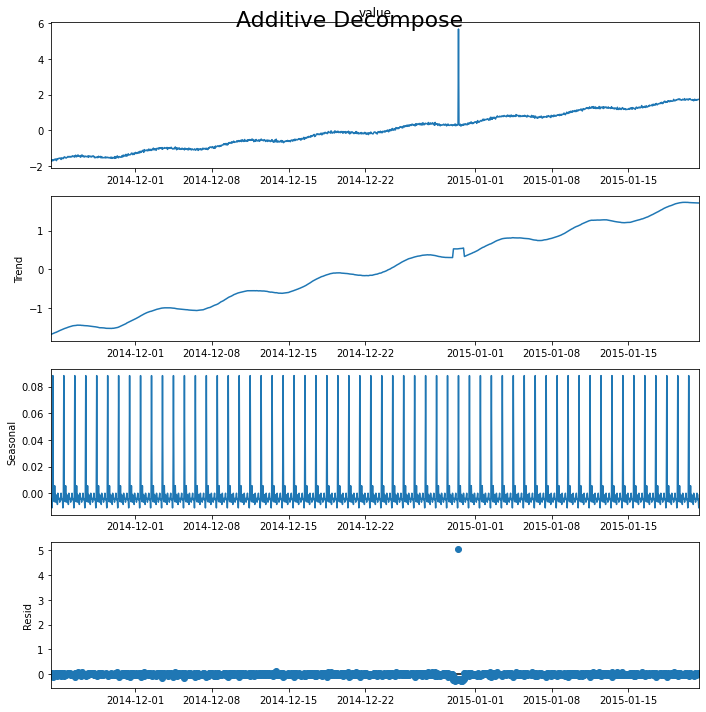



File: A2Benchmarksynthetic_93
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.680854           1
Detected outliers: 1
Outliers:
              timestamp    resid
893 2014-12-30 12:00:00  5.06255
Mean: 3183.865172, StandardDeviation: 2051.585692
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   435.137687           0
1    2014-11-23 08:00:00   -46.567552           0
2    2014-11-23 09:00:00   578.258941           0
3    2014-11-23 10:00:00   618.638537           0
4    2014-11-23 11:00:00   385.811032           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  6261.105527           0
1417 2015-01-21 08:00:00  5228.148067           0
1418 2015-01-21 09:00:00  6280.724316           0
1419 2015-01-21 10:00:00  6854.029788           0
1420 2015-01-21 11:00:00  6525.172057           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_94add_STL


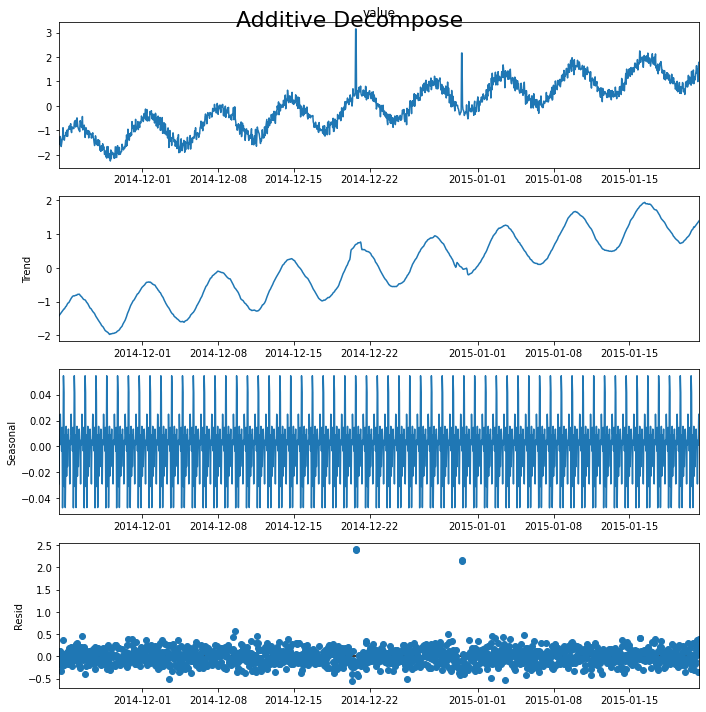



File: A2Benchmarksynthetic_94
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  3.147495           1
2014-12-20 18:00:00  3.147495           1
2014-12-30 12:00:00  2.163635           1
2014-12-30 13:00:00  2.163635           1
Detected outliers: 5
Outliers:
              timestamp     resid
390 2014-12-09 13:00:00  0.563655
658 2014-12-20 17:00:00  2.403258
659 2014-12-20 18:00:00  2.411439
893 2014-12-30 12:00:00  2.137486
894 2014-12-30 13:00:00  2.168799
Mean: 11272.001575, StandardDeviation: 6995.543247
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    458.788450           0
1    2014-11-23 08:00:00    -18.504074           0
2    2014-11-23 09:00:00    643.135392           0
3    2014-11-23 10:00:00    703.090210           0
4    2014-11-23 11:00:00    481.678563           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  22363.286419  

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_95add_STL


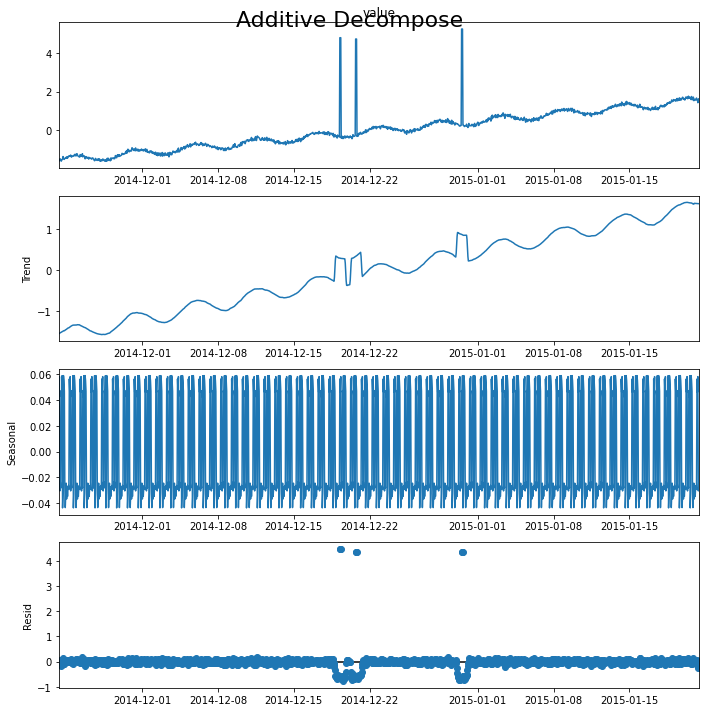



File: A2Benchmarksynthetic_95
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.803645           1
2014-12-19 07:00:00  4.803645           1
2014-12-19 08:00:00  4.803645           1
2014-12-20 17:00:00  4.735132           1
2014-12-20 18:00:00  4.735132           1
2014-12-20 19:00:00  4.735132           1
2014-12-30 12:00:00  5.256701           1
2014-12-30 13:00:00  5.256701           1
2014-12-30 14:00:00  5.256701           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  4.454777
624 2014-12-19 07:00:00  4.470032
625 2014-12-19 08:00:00  4.461186
658 2014-12-20 17:00:00  4.339065
659 2014-12-20 18:00:00  4.337664
660 2014-12-20 19:00:00  4.339593
893 2014-12-30 12:00:00  4.339371
894 2014-12-30 13:00:00  4.350015
895 2014-12-30 14:00:00  4.340807
Mean: 1698.695896, StandardDeviation: 1393.114383
               timestamp        value  is_anomaly
0 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_96add_STL


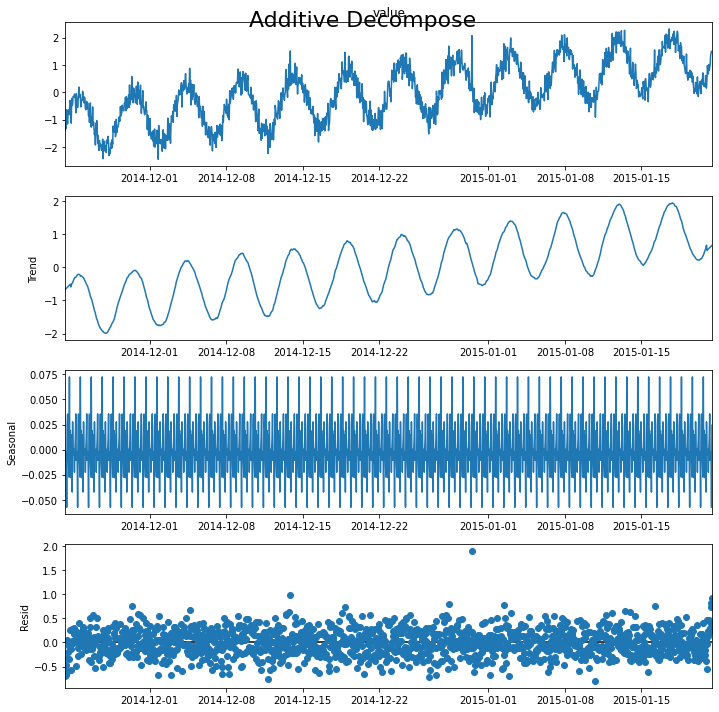



File: A2Benchmarksynthetic_96
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.072946           1
Detected outliers: 51
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.500673
60   2014-11-25 19:00:00  0.573464
69   2014-11-26 04:00:00  0.516270
146  2014-11-29 09:00:00  0.745202
159  2014-11-29 22:00:00  0.592770
165  2014-11-30 04:00:00  0.568407
170  2014-11-30 09:00:00  0.515306
205  2014-12-01 20:00:00  0.549897
264  2014-12-04 07:00:00  0.501145
273  2014-12-04 16:00:00  0.673513
349  2014-12-07 20:00:00  0.505481
379  2014-12-09 02:00:00  0.551980
461  2014-12-12 12:00:00  0.512755
484  2014-12-13 11:00:00  0.564473
485  2014-12-13 12:00:00  0.587279
491  2014-12-13 18:00:00  0.625519
494  2014-12-13 21:00:00  0.991034
505  2014-12-14 08:00:00  0.521877
608  2014-12-18 15:00:00  0.607739
614  2014-12-18 21:00:00  0.742087
622  2014-12-19 05:00:00  0.543257
623  20

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_97add_STL


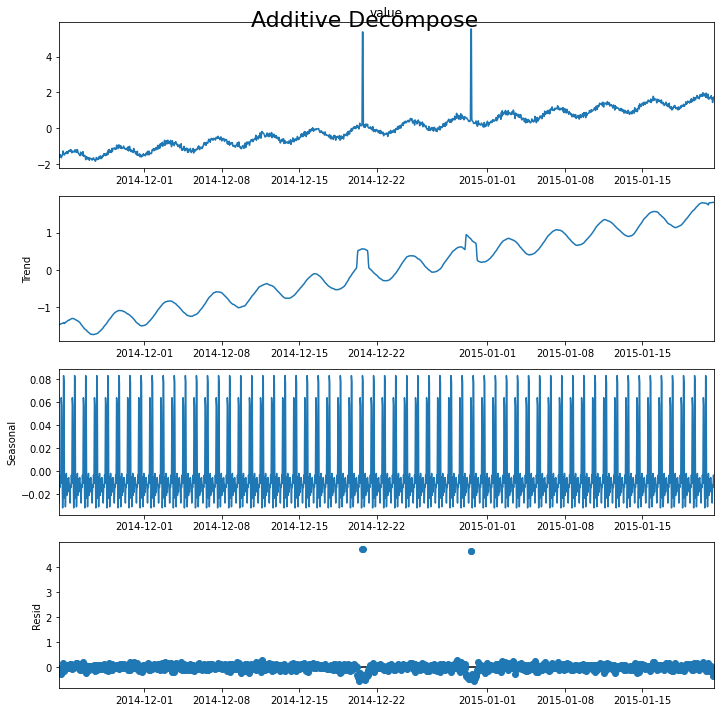



File: A2Benchmarksynthetic_97
threshold:0.5
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.373197           1
2014-12-20 18:00:00  5.373197           1
2014-12-30 12:00:00  5.539767           1
2014-12-30 13:00:00  5.539767           1
Detected outliers: 4
Outliers:
              timestamp     resid
658 2014-12-20 17:00:00  4.723413
659 2014-12-20 18:00:00  4.732347
893 2014-12-30 12:00:00  4.645440
894 2014-12-30 13:00:00  4.667944
Mean: 31170.980497, StandardDeviation: 18199.274453
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    524.467220           0
1    2014-11-23 08:00:00     -9.857375           0
2    2014-11-23 09:00:00    692.235903           0
3    2014-11-23 10:00:00    741.500706           0
4    2014-11-23 11:00:00    485.773136           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  61607.711412           0
1417 2015-01-21 08:00:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_98add_STL


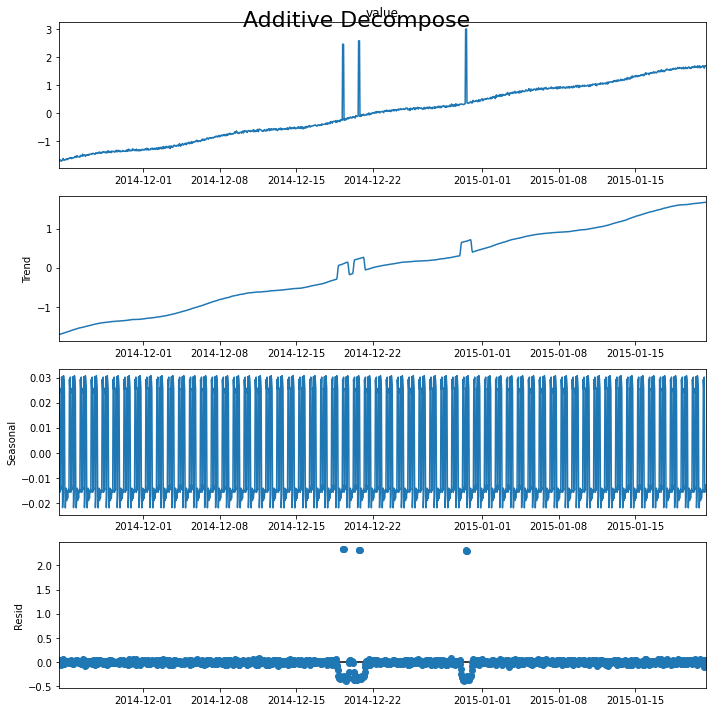



File: A2Benchmarksynthetic_98
threshold:0.5
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.462040           1
2014-12-19 07:00:00  2.462040           1
2014-12-19 08:00:00  2.462040           1
2014-12-20 17:00:00  2.582976           1
2014-12-20 18:00:00  2.582976           1
2014-12-20 19:00:00  2.582976           1
2014-12-30 12:00:00  3.006316           1
2014-12-30 13:00:00  3.006316           1
2014-12-30 14:00:00  3.006316           1
Detected outliers: 9
Outliers:
              timestamp     resid
623 2014-12-19 06:00:00  2.338564
624 2014-12-19 07:00:00  2.338881
625 2014-12-19 08:00:00  2.329610
658 2014-12-20 17:00:00  2.322031
659 2014-12-20 18:00:00  2.321229
660 2014-12-20 19:00:00  2.322042
893 2014-12-30 12:00:00  2.306172
894 2014-12-30 13:00:00  2.305655
895 2014-12-30 14:00:00  2.296935
Mean: 1899.806116, StandardDeviation: 1455.974788
               timestamp        value  is_anomaly
0 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_99add_STL


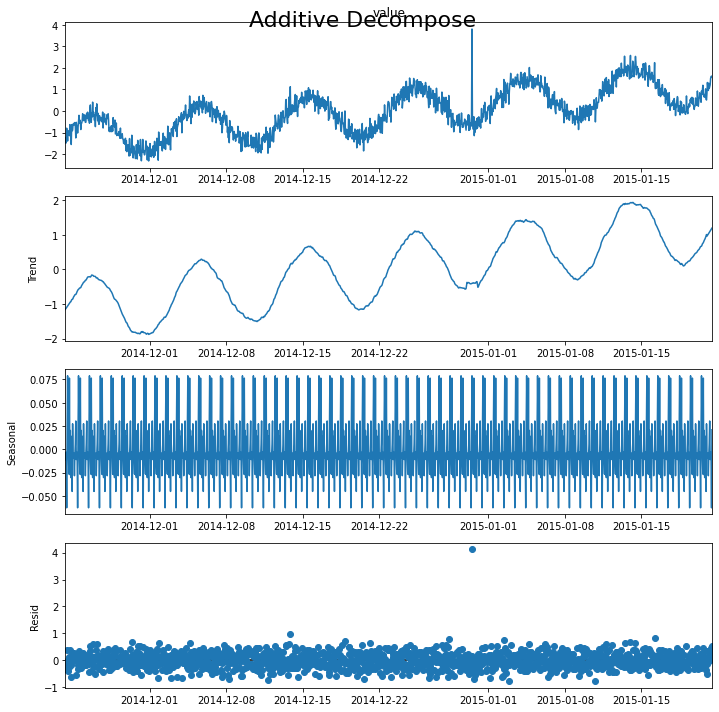



File: A2Benchmarksynthetic_99
threshold:0.5
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  3.802306           1
Detected outliers: 40
Outliers:
               timestamp     resid
55   2014-11-25 14:00:00  0.517567
60   2014-11-25 19:00:00  0.614923
69   2014-11-26 04:00:00  0.590716
146  2014-11-29 09:00:00  0.694524
159  2014-11-29 22:00:00  0.543656
165  2014-11-30 04:00:00  0.536474
205  2014-12-01 20:00:00  0.627948
273  2014-12-04 16:00:00  0.645113
349  2014-12-07 20:00:00  0.549436
379  2014-12-09 02:00:00  0.500597
461  2014-12-12 12:00:00  0.526241
484  2014-12-13 11:00:00  0.556601
485  2014-12-13 12:00:00  0.531224
491  2014-12-13 18:00:00  0.599198
494  2014-12-13 21:00:00  0.975157
608  2014-12-18 15:00:00  0.568389
614  2014-12-18 21:00:00  0.697070
652  2014-12-20 11:00:00  0.555131
669  2014-12-21 04:00:00  0.647428
756  2014-12-24 19:00:00  0.565976
815  2014-12-27 06:00:00  0.515937
827  20

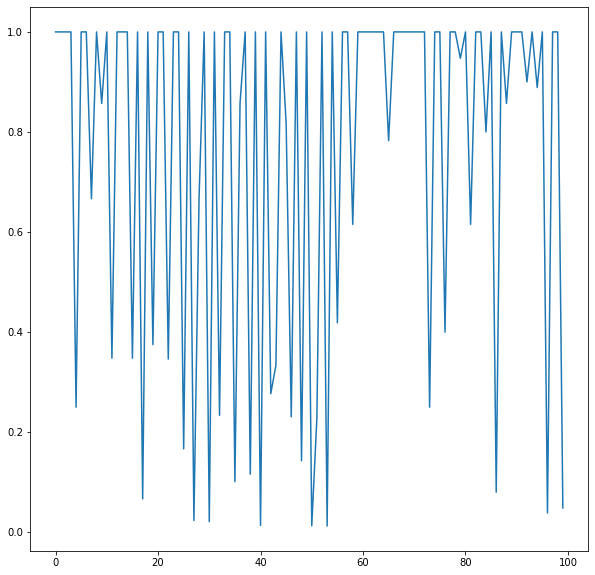

In [99]:
start_time = datetime.now() 
f1_plot = []
for index,file in enumerate(all_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
#     if index > 30:
#         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    
    # prepare data for standardization
    values = df_indexed.copy()
    values = values.drop(columns=['is_anomaly'],axis=1)
    #values = values.reshape((len(values), 1))
    
    # train the standardization
    scaler2 = StandardScaler()
    scaler2 = scaler2.fit(values)
    print('Mean: %f, StandardDeviation: %f' % (scaler2.mean_, sqrt(scaler2.var_)))
    # standardize the dataset
    standardaized = scaler2.transform(values)
    
    #jugaad, change so that standardized is used from here on.
    for i in range(len(df)):
        df_indexed['value'].iloc[i] = standardaized[i]
        
    print(df)
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A2Benchmark_" + fname +"add_STL")
    print("\n\n\nA2Benchmark_" + fname +"add_STL")
    plt.show()
    threshold=0.5
    residualdf = result_add.resid
    residualdf = residualdf.reset_index()
    
    outliers = residualdf[residualdf.resid > threshold]
    not_outliers = residualdf.reset_index().merge(outliers, how = 'outer' ,indicator=True).loc[lambda x : x['_merge']=='left_only']
    anomalies = df_indexed.join(outliers.set_index('timestamp'),on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers.set_index('timestamp'),on='timestamp',how='inner')
    #not_outliers = residualdf[residualdf < threshold]
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    f1 = 2 * (precision * recall)/(precision + recall)
    f1_plot.append(f1)
    
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print(f"threshold:{threshold}")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
    print("--------------------")
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print(f1_plot)
plt.plot(f1_plot)

In [100]:
print(sum(f1_plot)/len(f1_plot))

0.7615574683059201


### Changing Manual threshold to k std devs

Now that we have the standardized values of the TS applied, we change the value of the threshold from a static to a dynamically set value. First we try the k standard deviations method of deciding the threshold.

Processing index: 0 of 100
Mean: 6.368346, StandardDeviation: 987.420584
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00   13.894031           0
1    2014-11-23 08:00:00   33.578274           0
2    2014-11-23 09:00:00   88.933746           0
3    2014-11-23 10:00:00  125.389424           0
4    2014-11-23 11:00:00  152.962000           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00 -141.419766           0
1417 2015-01-21 08:00:00 -139.657834           0
1418 2015-01-21 09:00:00  -70.550652           0
1419 2015-01-21 10:00:00  -16.857148           0
1420 2015-01-21 11:00:00    7.757660           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_1add_STL


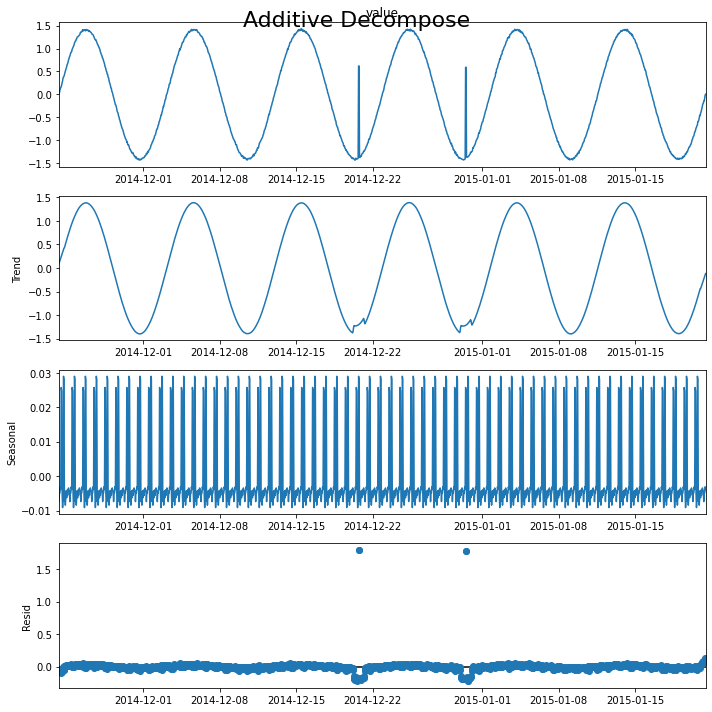



File: A2Benchmarksynthetic_1
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  0.617816           1
2014-12-20 18:00:00  0.617816           1
2014-12-30 12:00:00  0.588934           1
2014-12-30 13:00:00  0.588934           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    1.794800
2014-12-20 18:00:00    1.788847
2014-12-30 12:00:00    1.782777
2014-12-30 13:00:00    1.778251
Name: resid, dtype: float64
----------------
Mean: 100.510082, StandardDeviation: 994.197252
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  127.699238           0
1    2014-11-23 08:00:00   23.069614           0
2    2014-11-23 09:00:00  246.118857           0
3    2014-11-23 10:00:00  295.937818           0
4    2014-11-23 11:00:00  264.649986           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00   21.595423           0
1417 2015-01-21 08:00:00 -246

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_10add_STL


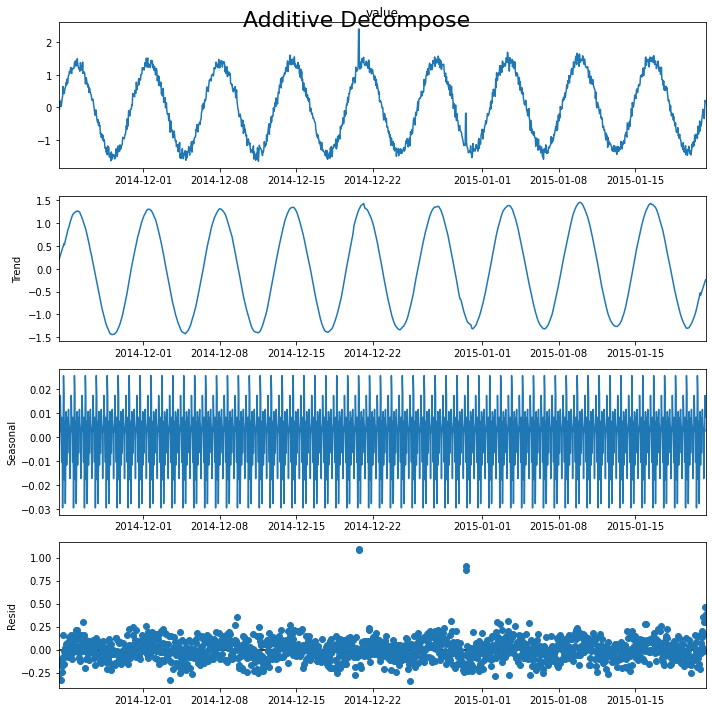



File: A2Benchmarksynthetic_10
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.403750           1
2014-12-20 18:00:00  2.403750           1
2014-12-30 12:00:00 -0.185198           1
2014-12-30 13:00:00 -0.185198           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    1.095023
2014-12-20 18:00:00    1.083752
2014-12-30 12:00:00    0.866077
2014-12-30 13:00:00    0.905521
Name: resid, dtype: float64
----------------
Mean: 17255.105564, StandardDeviation: 10042.787001
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    530.537582           0
1    2014-11-23 08:00:00    -36.182104           0
2    2014-11-23 09:00:00    698.380385           0
3    2014-11-23 10:00:00    745.766197           0
4    2014-11-23 11:00:00    472.031180           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  34499.926302           0
1417 201

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_100add_STL


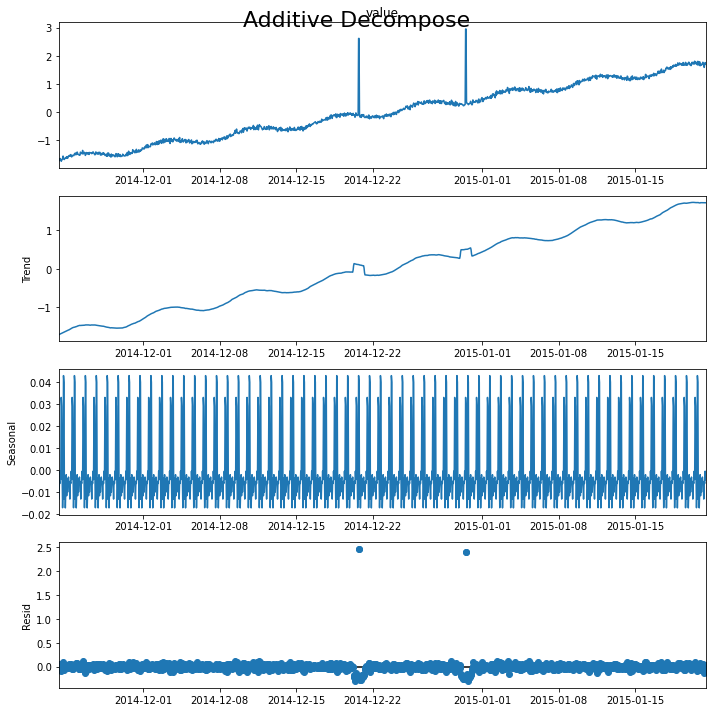



File: A2Benchmarksynthetic_100
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.615356           1
2014-12-20 18:00:00  2.615356           1
2014-12-30 12:00:00  2.950290           1
2014-12-30 13:00:00  2.950290           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    2.459075
2014-12-20 18:00:00    2.466446
2014-12-30 12:00:00    2.407609
2014-12-30 13:00:00    2.410951
Name: resid, dtype: float64
----------------
Mean: 1613.761107, StandardDeviation: 1381.918933
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   142.349854           0
1    2014-11-23 08:00:00    33.132799           0
2    2014-11-23 09:00:00   283.994868           0
3    2014-11-23 10:00:00   344.388904           0
4    2014-11-23 11:00:00   315.516784           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3370.568406           0
1417 2015-01-21 0

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_11add_STL


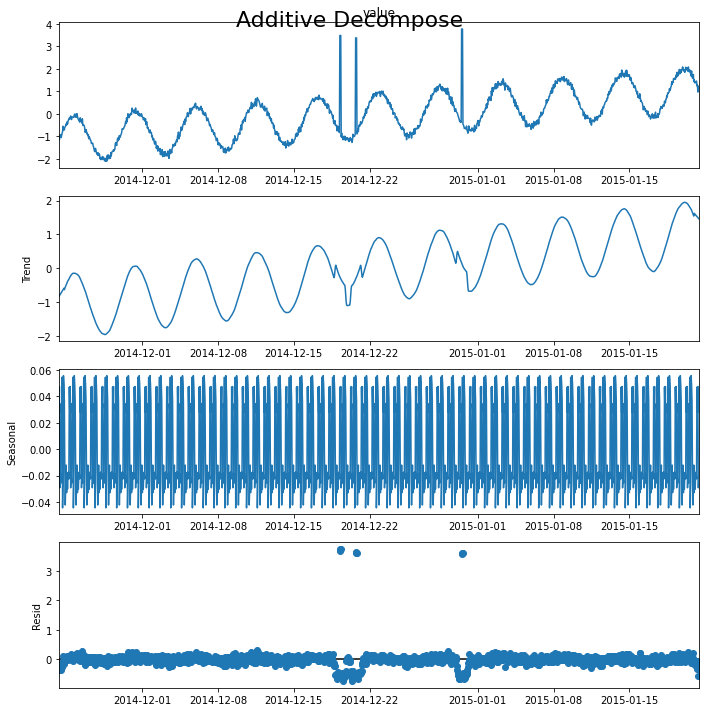



File: A2Benchmarksynthetic_11
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  3.480926           1
2014-12-19 07:00:00  3.480926           1
2014-12-19 08:00:00  3.480926           1
2014-12-20 17:00:00  3.372082           1
2014-12-20 18:00:00  3.372082           1
2014-12-20 19:00:00  3.372082           1
2014-12-30 12:00:00  3.767044           1
2014-12-30 13:00:00  3.767044           1
2014-12-30 14:00:00  3.767044           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    3.688824
2014-12-19 07:00:00    3.741715
2014-12-19 08:00:00    3.751663
2014-12-20 17:00:00    3.638748
2014-12-20 18:00:00    3.617800
2014-12-20 19:00:00    3.600371
2014-12-30 12:00:00    3.575888
2014-12-30 13:00:00    3.618063
2014-12-30 14:00:00    3.627575
Name: resid, dtype: float64
----------------
Mean: 70.366661, StandardDeviation: 994.123425
               timestamp       value  is_anomaly
0 

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_12add_STL


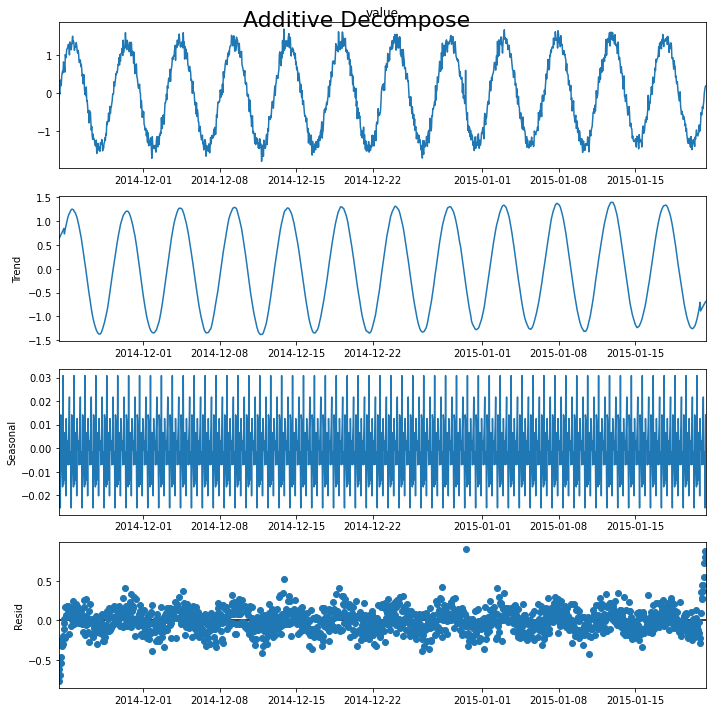



File: A2Benchmarksynthetic_12
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.604069           1
Detected outliers: 7
Outliers:
timestamp
2014-12-13 21:00:00    0.521293
2014-12-30 12:00:00    0.904908
2015-01-21 07:00:00    0.549320
2015-01-21 08:00:00    0.723506
2015-01-21 09:00:00    0.805690
2015-01-21 10:00:00    0.884116
2015-01-21 11:00:00    0.864671
Name: resid, dtype: float64
----------------
Mean: 1399.681750, StandardDeviation: 1305.117440
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   167.353006           0
1    2014-11-23 08:00:00    44.654007           0
2    2014-11-23 09:00:00   346.780724           0
3    2014-11-23 10:00:00   423.856495           0
4    2014-11-23 11:00:00   395.187353           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  3089.294936           0
1417 2015-01-21 08:00:00  2589.654340           

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_13add_STL


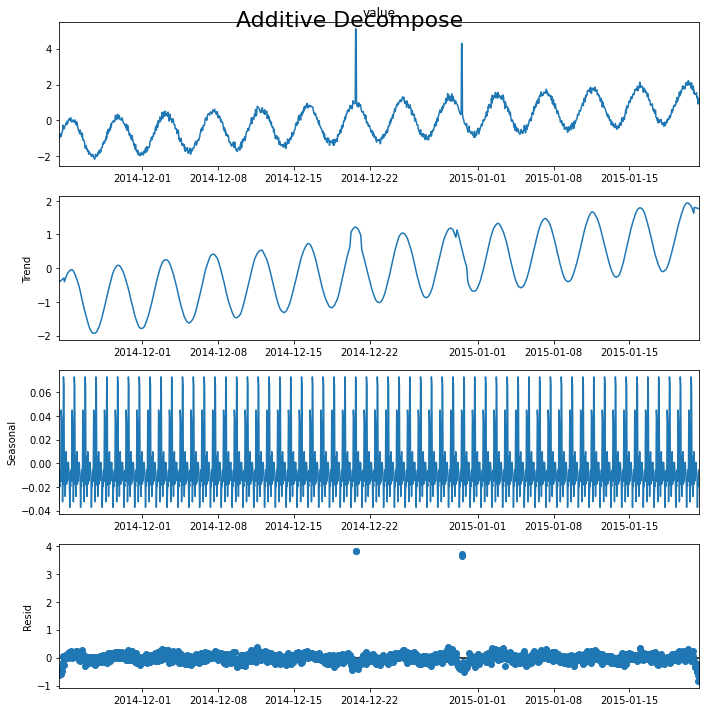



File: A2Benchmarksynthetic_13
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  5.100373           1
2014-12-20 18:00:00  5.100373           1
2014-12-30 12:00:00  4.287849           1
2014-12-30 13:00:00  4.287849           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    3.805289
2014-12-20 18:00:00    3.820420
2014-12-30 12:00:00    3.626537
2014-12-30 13:00:00    3.694080
Name: resid, dtype: float64
----------------
Mean: 4873.417218, StandardDeviation: 2960.351286
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   184.728233           0
1    2014-11-23 08:00:00    -4.821284           0
2    2014-11-23 09:00:00   263.194207           0
3    2014-11-23 10:00:00   289.597838           0
4    2014-11-23 11:00:00   203.109403           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  9598.339840           0
1417 2015-01-21 08

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_14add_STL


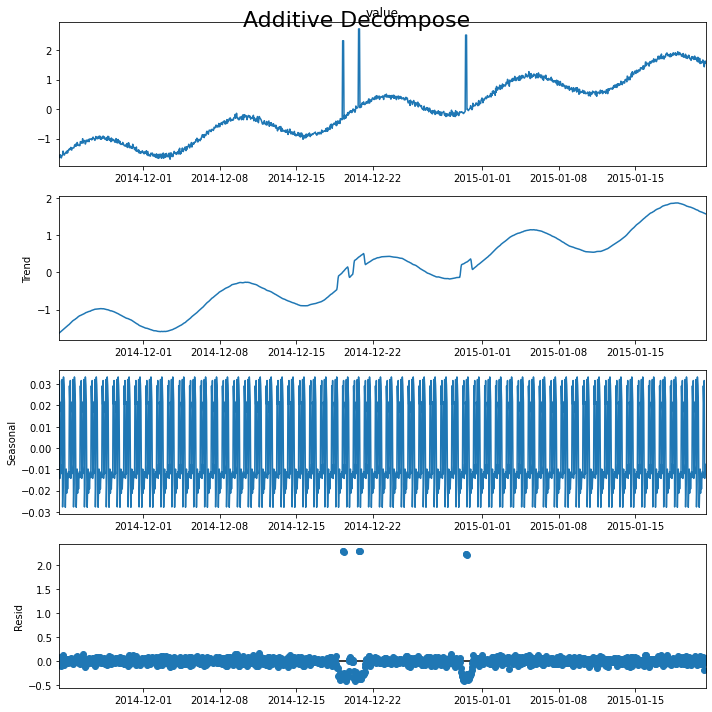



File: A2Benchmarksynthetic_14
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.320077           1
2014-12-19 07:00:00  2.320077           1
2014-12-19 08:00:00  2.320077           1
2014-12-20 17:00:00  2.722561           1
2014-12-20 18:00:00  2.722561           1
2014-12-20 19:00:00  2.722561           1
2014-12-30 12:00:00  2.513307           1
2014-12-30 13:00:00  2.513307           1
2014-12-30 14:00:00  2.513307           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    2.286676
2014-12-19 07:00:00    2.284346
2014-12-19 08:00:00    2.260638
2014-12-20 17:00:00    2.283556
2014-12-20 18:00:00    2.279894
2014-12-20 19:00:00    2.279935
2014-12-30 12:00:00    2.229762
2014-12-30 13:00:00    2.228854
2014-12-30 14:00:00    2.209185
Name: resid, dtype: float64
----------------
Mean: 110.688388, StandardDeviation: 1004.712332
               timestamp       value  is_anomaly


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_15add_STL


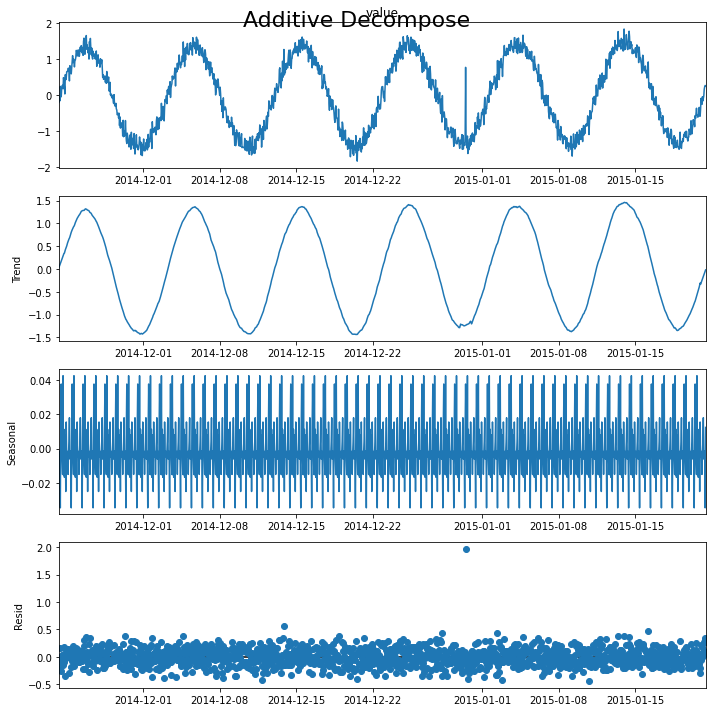



File: A2Benchmarksynthetic_15
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.770344           1
Detected outliers: 2
Outliers:
timestamp
2014-12-13 21:00:00    0.553079
2014-12-30 12:00:00    1.964553
Name: resid, dtype: float64
----------------
Mean: 3191.408691, StandardDeviation: 2074.503331
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   207.726035           0
1    2014-11-23 08:00:00     2.708866           0
2    2014-11-23 09:00:00   320.121007           0
3    2014-11-23 10:00:00   361.573087           0
4    2014-11-23 11:00:00   274.004645           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  6476.736575           0
1417 2015-01-21 08:00:00  5919.104142           0
1418 2015-01-21 09:00:00  6345.859032           0
1419 2015-01-21 10:00:00  6546.145013           0
1420 2015-01-21 11:00:00  6320.390090           0

[1421 r

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_16add_STL


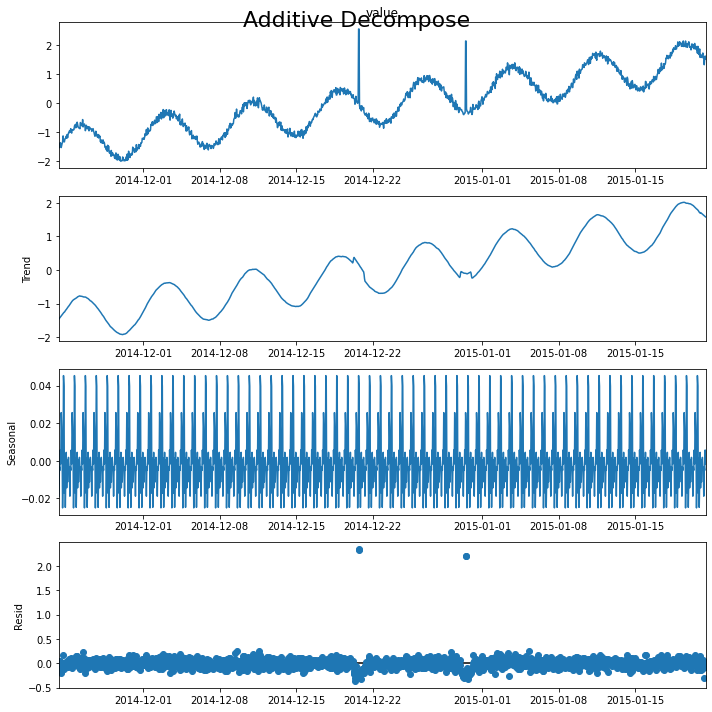



File: A2Benchmarksynthetic_16
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.544810           1
2014-12-20 18:00:00  2.544810           1
2014-12-30 12:00:00  2.131365           1
2014-12-30 13:00:00  2.131365           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    2.321884
2014-12-20 18:00:00    2.351360
2014-12-30 12:00:00    2.202763
2014-12-30 13:00:00    2.214161
Name: resid, dtype: float64
----------------
Mean: 299.954448, StandardDeviation: 1024.294474
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  216.370595           0
1    2014-11-23 08:00:00    0.762393           0
2    2014-11-23 09:00:00  339.998476           0
3    2014-11-23 10:00:00  386.066099           0
4    2014-11-23 11:00:00  294.997672           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00  427.016575           0
1417 2015-01-21 08:00:00  -

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_17add_STL


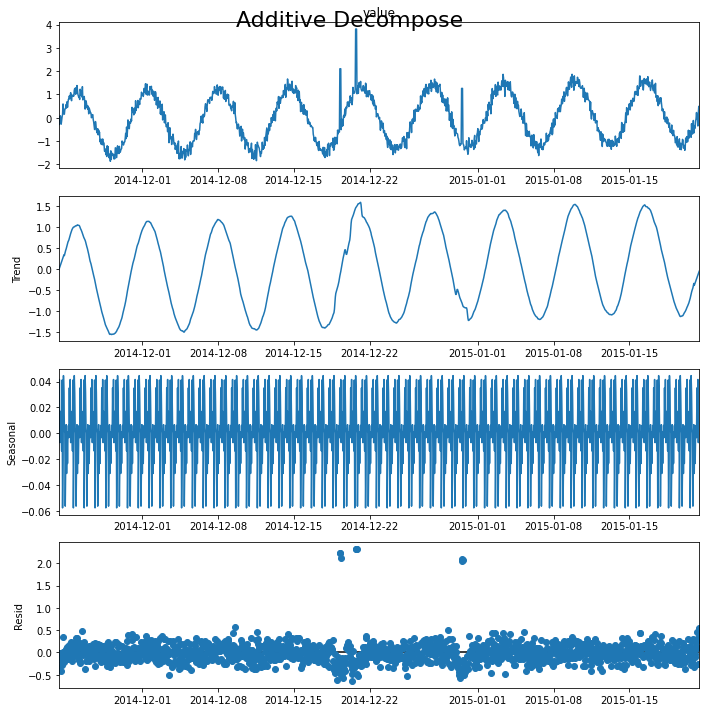



File: A2Benchmarksynthetic_17
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.103996           1
2014-12-19 07:00:00  2.103996           1
2014-12-19 08:00:00  2.103996           1
2014-12-20 17:00:00  3.814266           1
2014-12-20 18:00:00  3.814266           1
2014-12-20 19:00:00  3.814266           1
2014-12-30 12:00:00  1.260559           1
2014-12-30 13:00:00  1.260559           1
2014-12-30 14:00:00  1.260559           1
Detected outliers: 12
Outliers:
timestamp
2014-12-09 13:00:00    0.580740
2014-12-19 06:00:00    2.233107
2014-12-19 07:00:00    2.217607
2014-12-19 08:00:00    2.123253
2014-12-20 17:00:00    2.310747
2014-12-20 18:00:00    2.308735
2014-12-20 19:00:00    2.320300
2014-12-29 05:00:00    0.509084
2014-12-30 12:00:00    2.044445
2014-12-30 13:00:00    2.090815
2014-12-30 14:00:00    2.070218
2015-01-21 10:00:00    0.556620
Name: resid, dtype: float64
----------------
P

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_18add_STL


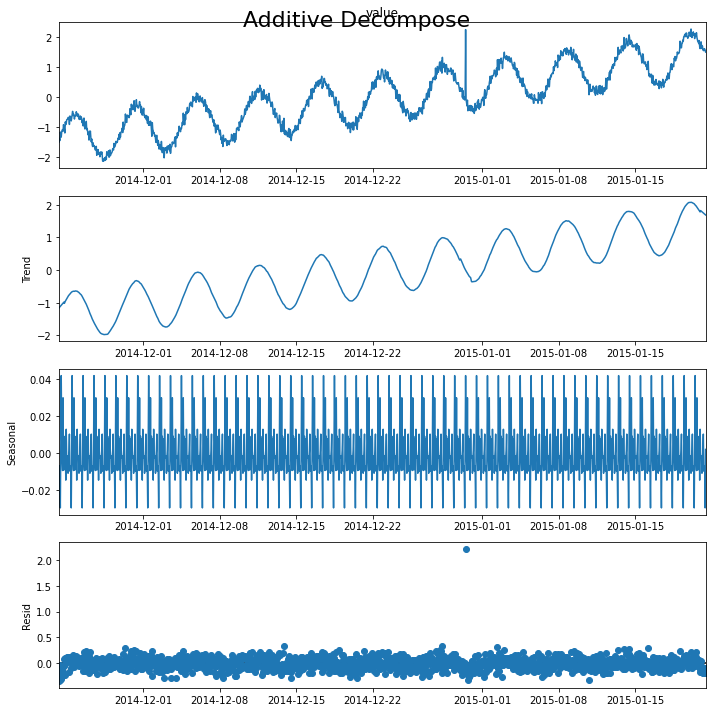



File: A2Benchmarksynthetic_18
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.254806           1
Detected outliers: 1
Outliers:
timestamp
2014-12-30 12:00:00    2.214789
Name: resid, dtype: float64
----------------
Mean: 362.532163, StandardDeviation: 1021.057616
               timestamp       value  is_anomaly
0    2014-11-23 07:00:00  241.730372           0
1    2014-11-23 08:00:00   13.002987           0
2    2014-11-23 09:00:00  403.903242           0
3    2014-11-23 10:00:00  467.125337           0
4    2014-11-23 11:00:00  376.841672           0
...                  ...         ...         ...
1416 2015-01-21 07:00:00  505.374338           0
1417 2015-01-21 08:00:00  -33.075959           0
1418 2015-01-21 09:00:00  597.094994           0
1419 2015-01-21 10:00:00  959.137435           0
1420 2015-01-21 11:00:00  816.022583           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_19add_STL


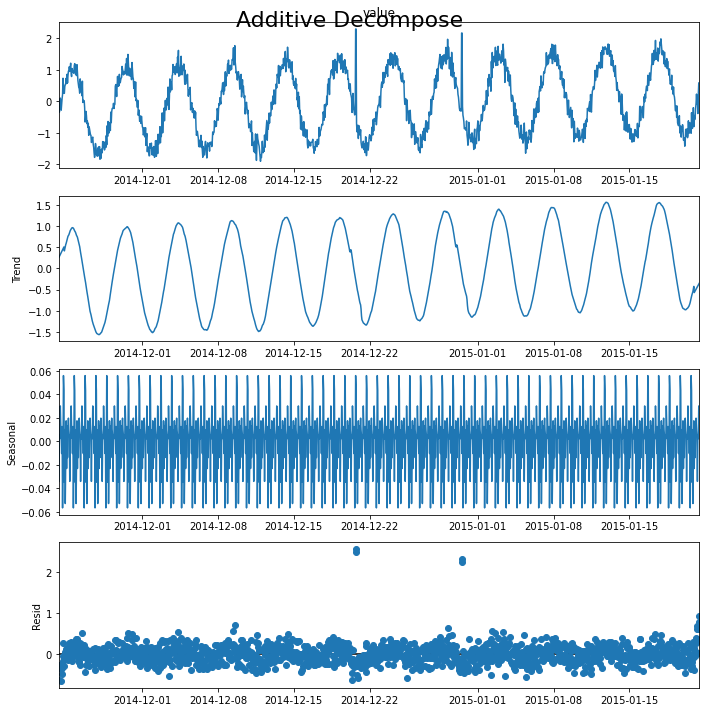



File: A2Benchmarksynthetic_19
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.290352           1
2014-12-20 18:00:00  2.290352           1
2014-12-30 12:00:00  2.162908           1
2014-12-30 13:00:00  2.162908           1
Detected outliers: 19
Outliers:
timestamp
2014-11-25 11:00:00    0.510236
2014-11-29 16:00:00    0.528006
2014-11-30 01:00:00    0.505150
2014-12-04 08:00:00    0.530395
2014-12-09 10:00:00    0.558331
2014-12-09 13:00:00    0.723112
2014-12-20 17:00:00    2.490710
2014-12-20 18:00:00    2.576010
2014-12-29 05:00:00    0.633068
2014-12-30 12:00:00    2.255597
2014-12-30 13:00:00    2.340555
2015-01-02 08:00:00    0.557982
2015-01-02 15:00:00    0.519019
2015-01-03 08:00:00    0.549966
2015-01-21 05:00:00    0.690044
2015-01-21 07:00:00    0.604629
2015-01-21 09:00:00    0.618237
2015-01-21 10:00:00    0.925076
2015-01-21 11:00:00    0.781225
Name: resid, dtype: float64
----

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_2add_STL


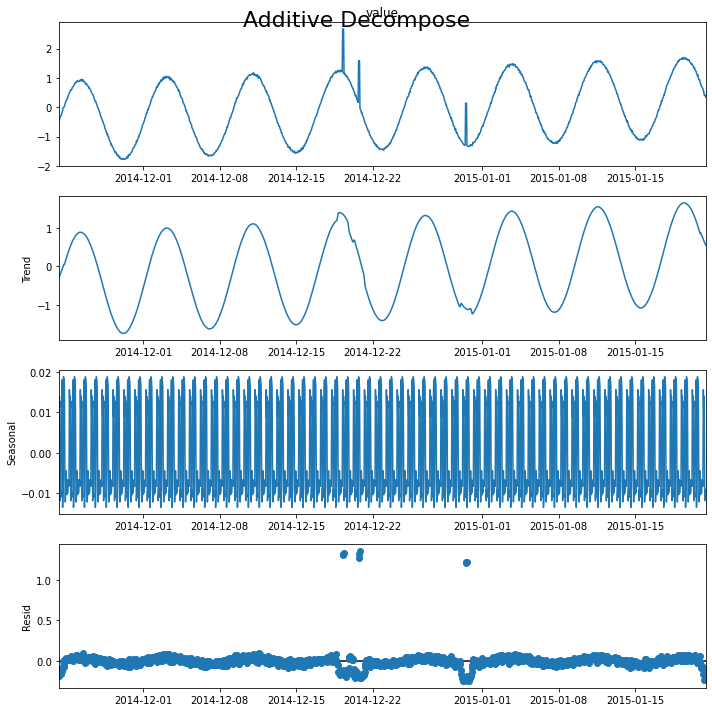



File: A2Benchmarksynthetic_2
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.673989           1
2014-12-19 07:00:00  2.673989           1
2014-12-19 08:00:00  2.673989           1
2014-12-20 17:00:00  1.588931           1
2014-12-20 18:00:00  1.588931           1
2014-12-20 19:00:00  1.588931           1
2014-12-30 12:00:00  0.141373           1
2014-12-30 13:00:00  0.141373           1
2014-12-30 14:00:00  0.141373           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    1.304327
2014-12-19 07:00:00    1.322486
2014-12-19 08:00:00    1.329592
2014-12-20 17:00:00    1.270474
2014-12-20 18:00:00    1.315454
2014-12-20 19:00:00    1.361520
2014-12-30 12:00:00    1.215138
2014-12-30 13:00:00    1.225196
2014-12-30 14:00:00    1.225835
Name: resid, dtype: float64
----------------
Mean: 1995.674055, StandardDeviation: 1534.256092
               timestamp        value  is_anomaly

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_20add_STL


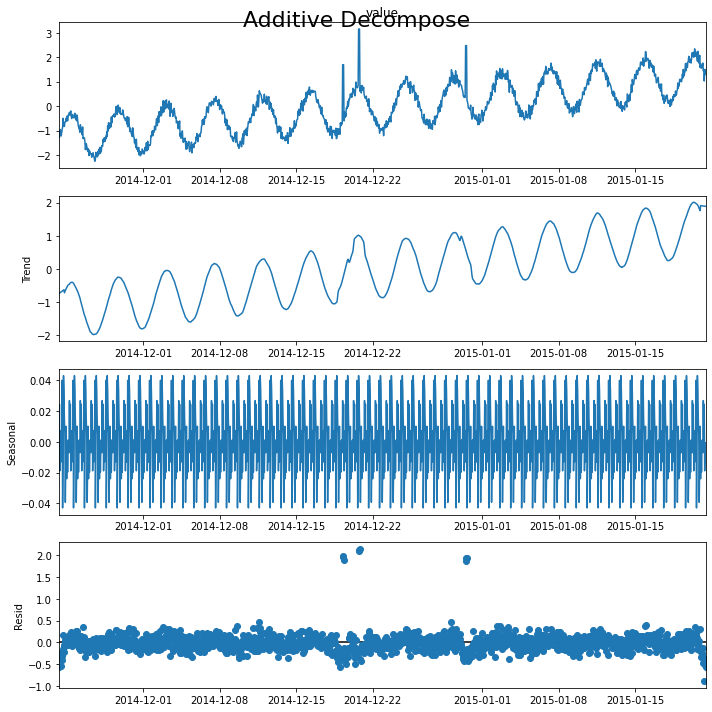



File: A2Benchmarksynthetic_20
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  1.694426           1
2014-12-19 07:00:00  1.694426           1
2014-12-19 08:00:00  1.694426           1
2014-12-20 17:00:00  3.156465           1
2014-12-20 18:00:00  3.156465           1
2014-12-20 19:00:00  3.156465           1
2014-12-30 12:00:00  2.475857           1
2014-12-30 13:00:00  2.475857           1
2014-12-30 14:00:00  2.475857           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    1.976275
2014-12-19 07:00:00    1.963655
2014-12-19 08:00:00    1.882537
2014-12-20 17:00:00    2.099450
2014-12-20 18:00:00    2.117918
2014-12-20 19:00:00    2.147444
2014-12-30 12:00:00    1.876114
2014-12-30 13:00:00    1.938604
2014-12-30 14:00:00    1.949961
Name: resid, dtype: float64
----------------
Mean: 7282.327986, StandardDeviation: 4298.843109
               timestamp         value  is_anoma

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_21add_STL


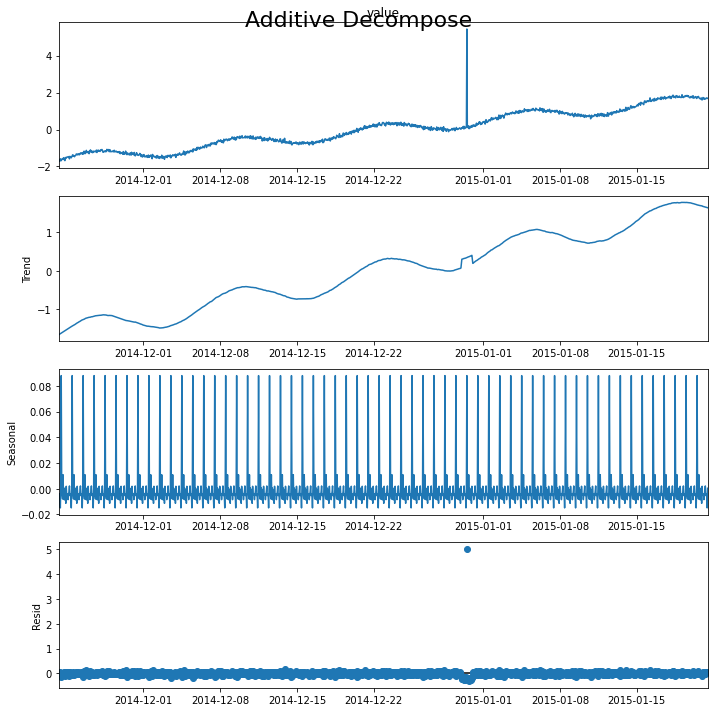



File: A2Benchmarksynthetic_21
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.445587           1
Detected outliers: 1
Outliers:
timestamp
2014-12-30 12:00:00    5.013185
Name: resid, dtype: float64
----------------
Mean: 480.352675, StandardDeviation: 1013.895439
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   279.790955           0
1    2014-11-23 08:00:00   -33.577684           0
2    2014-11-23 09:00:00   370.221164           0
3    2014-11-23 10:00:00   395.305678           0
4    2014-11-23 11:00:00   243.419322           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00   908.846316           0
1417 2015-01-21 08:00:00   238.400663           0
1418 2015-01-21 09:00:00   919.483595           0
1419 2015-01-21 10:00:00  1289.891987           0
1420 2015-01-21 11:00:00  1075.582876           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_22add_STL


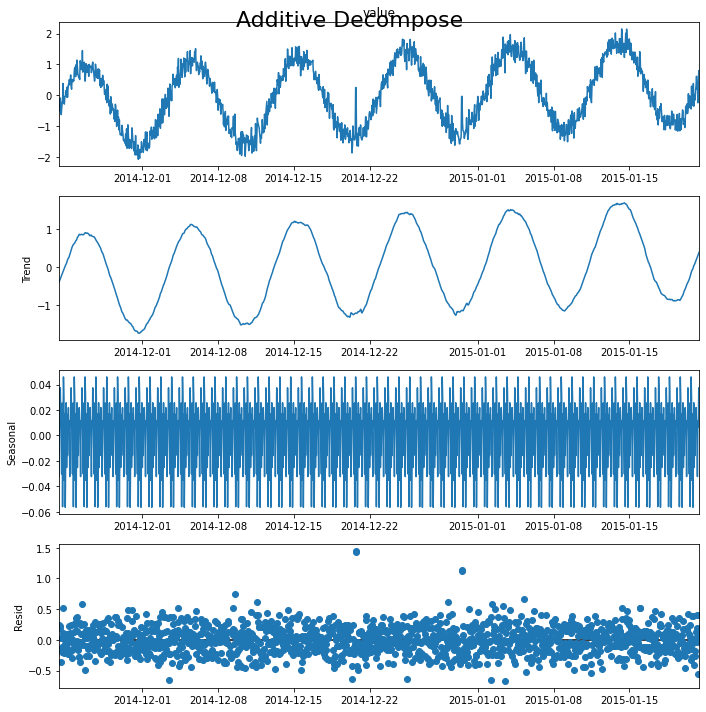



File: A2Benchmarksynthetic_22
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  0.253864           1
2014-12-20 18:00:00  0.253864           1
2014-12-30 12:00:00 -0.033395           1
2014-12-30 13:00:00 -0.033395           1
Detected outliers: 19
Outliers:
timestamp
2014-11-23 16:00:00    0.520624
2014-11-25 11:00:00    0.577330
2014-12-04 08:00:00    0.522155
2014-12-09 10:00:00    0.525323
2014-12-09 13:00:00    0.740203
2014-12-11 15:00:00    0.617825
2014-12-20 17:00:00    1.426831
2014-12-20 18:00:00    1.448206
2014-12-29 05:00:00    0.617578
2014-12-30 12:00:00    1.125472
2014-12-30 13:00:00    1.145680
2014-12-31 04:00:00    0.503498
2015-01-02 08:00:00    0.579775
2015-01-02 15:00:00    0.510930
2015-01-03 08:00:00    0.559901
2015-01-05 07:00:00    0.663284
2015-01-14 07:00:00    0.516264
2015-01-15 23:00:00    0.517094
2015-01-16 00:00:00    0.514944
Name: resid, dtype: float64
----

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_23add_STL


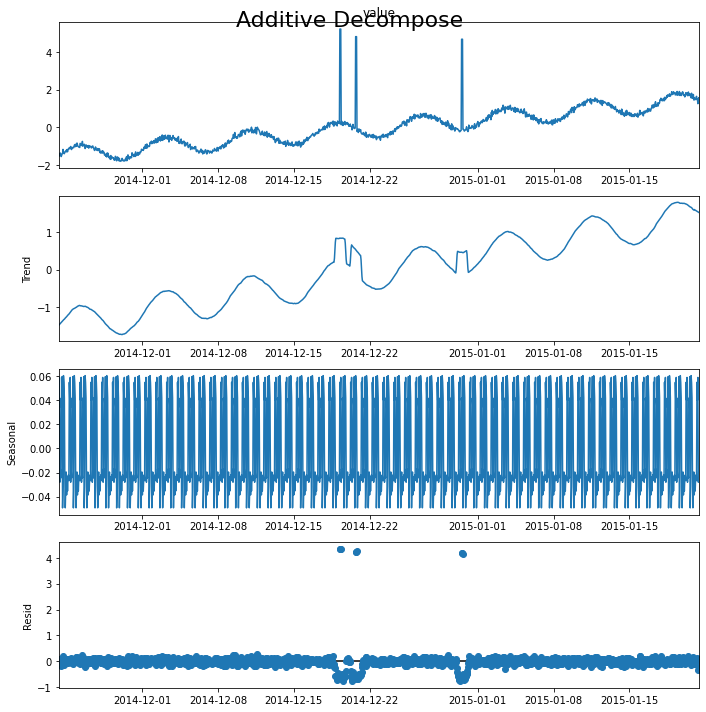



File: A2Benchmarksynthetic_23
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  5.219308           1
2014-12-19 07:00:00  5.219308           1
2014-12-19 08:00:00  5.219308           1
2014-12-20 17:00:00  4.813770           1
2014-12-20 18:00:00  4.813770           1
2014-12-20 19:00:00  4.813770           1
2014-12-30 12:00:00  4.676965           1
2014-12-30 13:00:00  4.676965           1
2014-12-30 14:00:00  4.676965           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    4.328168
2014-12-19 07:00:00    4.345846
2014-12-19 08:00:00    4.327784
2014-12-20 17:00:00    4.220636
2014-12-20 18:00:00    4.244184
2014-12-20 19:00:00    4.273628
2014-12-30 12:00:00    4.174008
2014-12-30 13:00:00    4.184441
2014-12-30 14:00:00    4.163538
Name: resid, dtype: float64
----------------
Mean: 281.561558, StandardDeviation: 1014.996111
               timestamp       value  is_anomaly


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_24add_STL


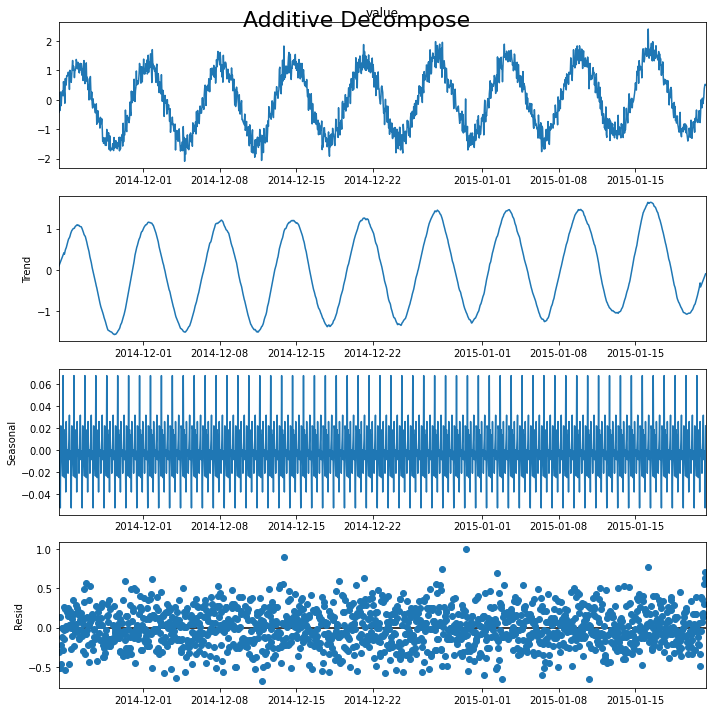



File: A2Benchmarksynthetic_24
threshold: 500
Actual Outliers: 1
                      value  is_anomaly
timestamp                              
2014-12-30 12:00:00  0.0314           1
Detected outliers: 29
Outliers:
timestamp
2014-11-25 19:00:00    0.563138
2014-11-26 04:00:00    0.524147
2014-11-29 09:00:00    0.597933
2014-12-01 20:00:00    0.613729
2014-12-04 16:00:00    0.506717
2014-12-07 20:00:00    0.532335
2014-12-13 11:00:00    0.506084
2014-12-13 12:00:00    0.536728
2014-12-13 18:00:00    0.556317
2014-12-13 21:00:00    0.891118
2014-12-18 21:00:00    0.589770
2014-12-20 11:00:00    0.540179
2014-12-21 04:00:00    0.632875
2014-12-27 18:00:00    0.550286
2014-12-28 03:00:00    0.540503
2014-12-28 09:00:00    0.741279
2014-12-30 12:00:00    0.999042
2015-01-02 10:00:00    0.693478
2015-01-03 01:00:00    0.540092
2015-01-04 18:00:00    0.543419
2015-01-11 19:00:00    0.503044
2015-01-13 11:00:00    0.504150
2015-01-14 00:00:00    0.526939
2015-01-14 11:00:00    0.517600
2015

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_25add_STL


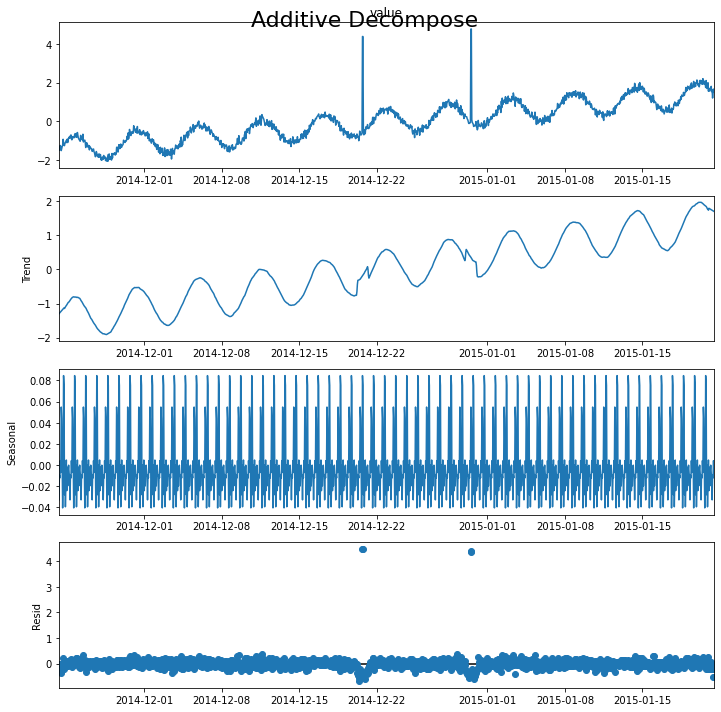



File: A2Benchmarksynthetic_25
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  4.382979           1
2014-12-20 18:00:00  4.382979           1
2014-12-30 12:00:00  4.771106           1
2014-12-30 13:00:00  4.771106           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    4.479447
2014-12-20 18:00:00    4.473660
2014-12-30 12:00:00    4.357858
2014-12-30 13:00:00    4.392092
Name: resid, dtype: float64
----------------
Mean: 677.021695, StandardDeviation: 1078.857833
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   330.577449           0
1    2014-11-23 08:00:00    -8.952793           0
2    2014-11-23 09:00:00   498.310024           0
3    2014-11-23 10:00:00   557.956500           0
4    2014-11-23 11:00:00   408.067961           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1159.791552           0
1417 2015-01-21 08:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_26add_STL


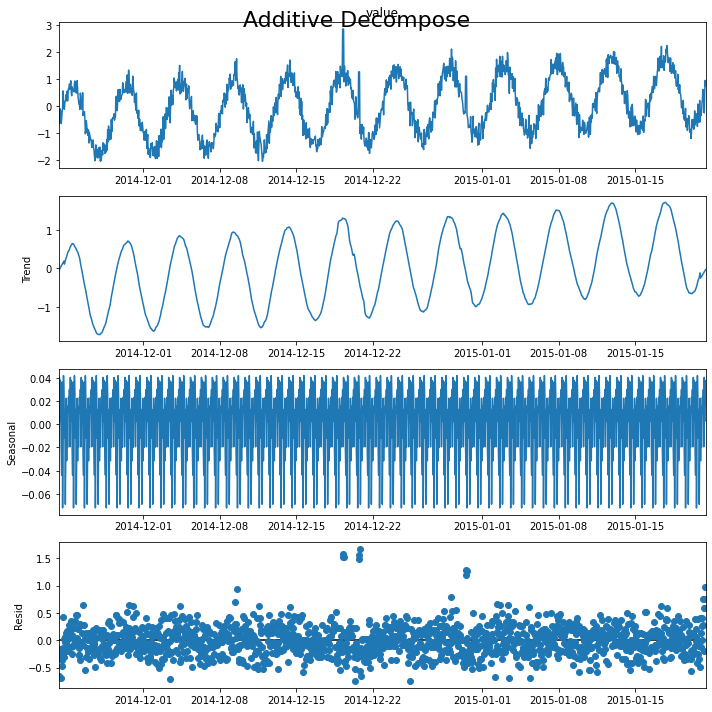



File: A2Benchmarksynthetic_26
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.853780           1
2014-12-19 07:00:00  2.853780           1
2014-12-19 08:00:00  2.853780           1
2014-12-20 17:00:00  1.265167           1
2014-12-20 18:00:00  1.265167           1
2014-12-20 19:00:00  1.265167           1
2014-12-30 12:00:00  1.101959           1
2014-12-30 13:00:00  1.101959           1
2014-12-30 14:00:00  1.101959           1
Detected outliers: 39
Outliers:
timestamp
2014-11-25 11:00:00    0.649922
2014-11-29 13:00:00    0.509870
2014-11-29 16:00:00    0.651173
2014-11-30 01:00:00    0.631780
2014-12-04 08:00:00    0.620682
2014-12-09 10:00:00    0.691914
2014-12-09 13:00:00    0.935120
2014-12-11 15:00:00    0.630923
2014-12-14 10:00:00    0.607359
2014-12-18 15:00:00    0.516726
2014-12-19 06:00:00    1.516674
2014-12-19 07:00:00    1.574884
2014-12-19 08:00:00    1.520253
2014-12-20 17:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_27add_STL


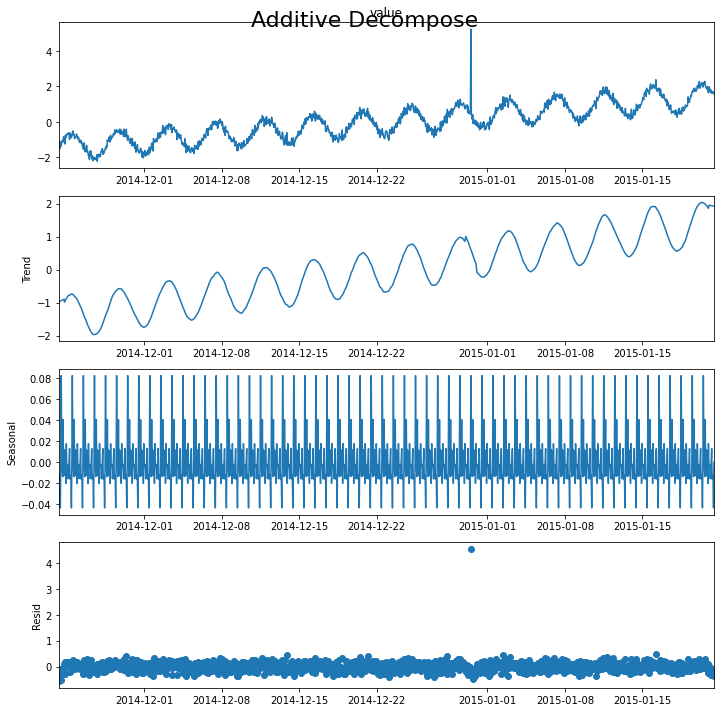



File: A2Benchmarksynthetic_27
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  5.229278           1
Detected outliers: 1
Outliers:
timestamp
2014-12-30 12:00:00    4.541667
Name: resid, dtype: float64
----------------
Mean: 9202.203480, StandardDeviation: 5383.176339
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    367.646826           0
1    2014-11-23 08:00:00    -38.283968           0
2    2014-11-23 09:00:00    467.681082           0
3    2014-11-23 10:00:00    492.157914           0
4    2014-11-23 11:00:00    291.684169           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  18310.202361           0
1417 2015-01-21 08:00:00  17394.768033           0
1418 2015-01-21 09:00:00  18197.660173           0
1419 2015-01-21 10:00:00  18605.443064           0
1420 2015-01-21 11:00:00  18269.717263           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_28add_STL


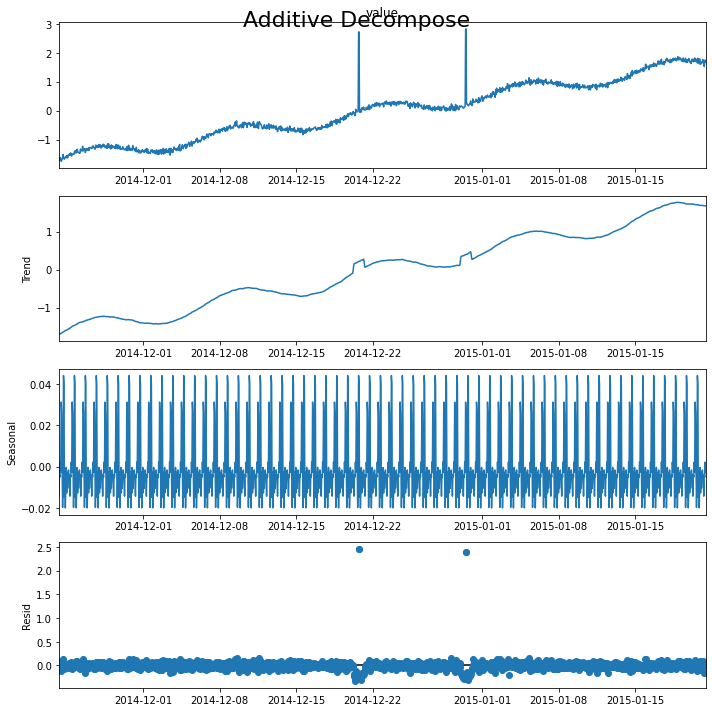



File: A2Benchmarksynthetic_28
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  2.716944           1
2014-12-20 18:00:00  2.716944           1
2014-12-30 12:00:00  2.818085           1
2014-12-30 13:00:00  2.818085           1
Detected outliers: 4
Outliers:
timestamp
2014-12-20 17:00:00    2.459186
2014-12-20 18:00:00    2.459552
2014-12-30 12:00:00    2.391466
2014-12-30 13:00:00    2.393025
Name: resid, dtype: float64
----------------
Mean: 853.154308, StandardDeviation: 1095.773774
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   368.696606           0
1    2014-11-23 08:00:00   -55.416317           0
2    2014-11-23 09:00:00   464.803666           0
3    2014-11-23 10:00:00   486.371135           0
4    2014-11-23 11:00:00   274.938478           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1646.262217           0
1417 2015-01-21 08:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_29add_STL


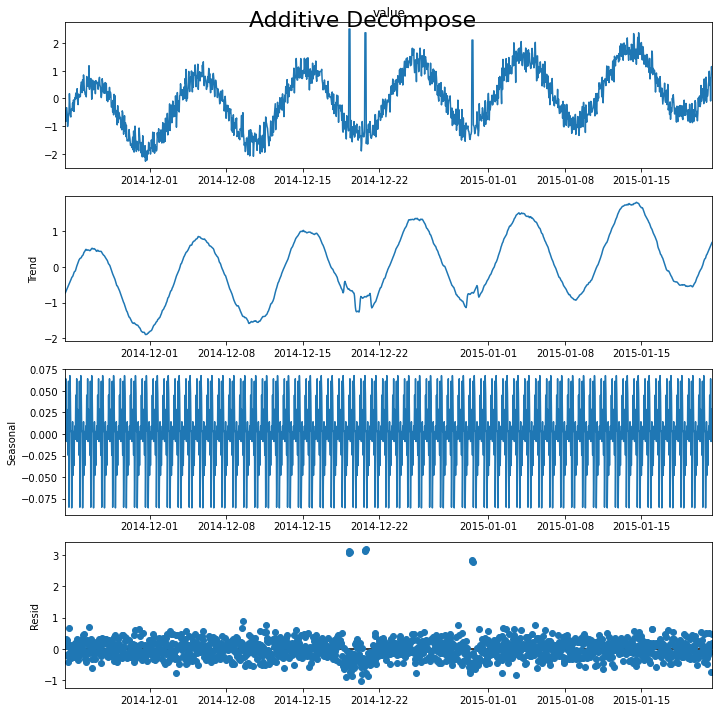



File: A2Benchmarksynthetic_29
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.506368           1
2014-12-19 07:00:00  2.506368           1
2014-12-19 08:00:00  2.506368           1
2014-12-20 17:00:00  2.369639           1
2014-12-20 18:00:00  2.369639           1
2014-12-20 19:00:00  2.369639           1
2014-12-30 12:00:00  2.106412           1
2014-12-30 13:00:00  2.106412           1
2014-12-30 14:00:00  2.106412           1
Detected outliers: 43
Outliers:
timestamp
2014-11-23 16:00:00    0.660854
2014-11-25 11:00:00    0.713651
2014-11-29 16:00:00    0.612984
2014-11-30 01:00:00    0.618318
2014-12-02 20:00:00    0.565982
2014-12-04 08:00:00    0.581557
2014-12-05 22:00:00    0.583048
2014-12-09 10:00:00    0.662057
2014-12-09 13:00:00    0.894954
2014-12-11 02:00:00    0.582609
2014-12-11 11:00:00    0.523226
2014-12-11 15:00:00    0.774846
2014-12-11 16:00:00    0.522154
2014-12-12 12:

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_3add_STL


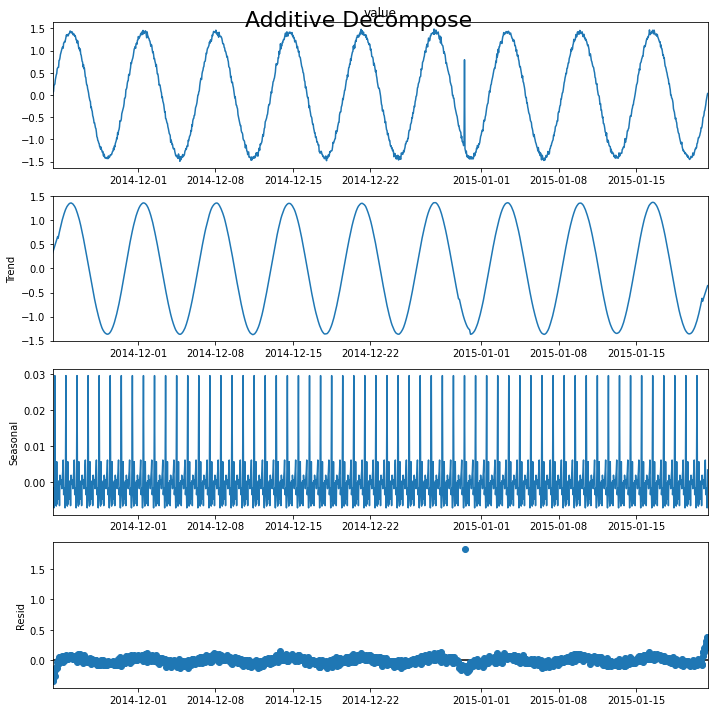



File: A2Benchmarksynthetic_3
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.794893           1
Detected outliers: 1
Outliers:
timestamp
2014-12-30 12:00:00    1.830217
Name: resid, dtype: float64
----------------
Mean: 5950.417354, StandardDeviation: 3552.981132
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00   -180.280563           0
1    2014-11-23 08:00:00    118.292354           0
2    2014-11-23 09:00:00   -133.825972           0
3    2014-11-23 10:00:00    652.458040           0
4    2014-11-23 11:00:00    325.887404           0
...                  ...           ...         ...
1416 2015-01-21 07:00:00  11942.906157           0
1417 2015-01-21 08:00:00  12210.795268           0
1418 2015-01-21 09:00:00  12234.121089           0
1419 2015-01-21 10:00:00  12192.975338           0
1420 2015-01-21 11:00:00  12063.465718           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_30add_STL


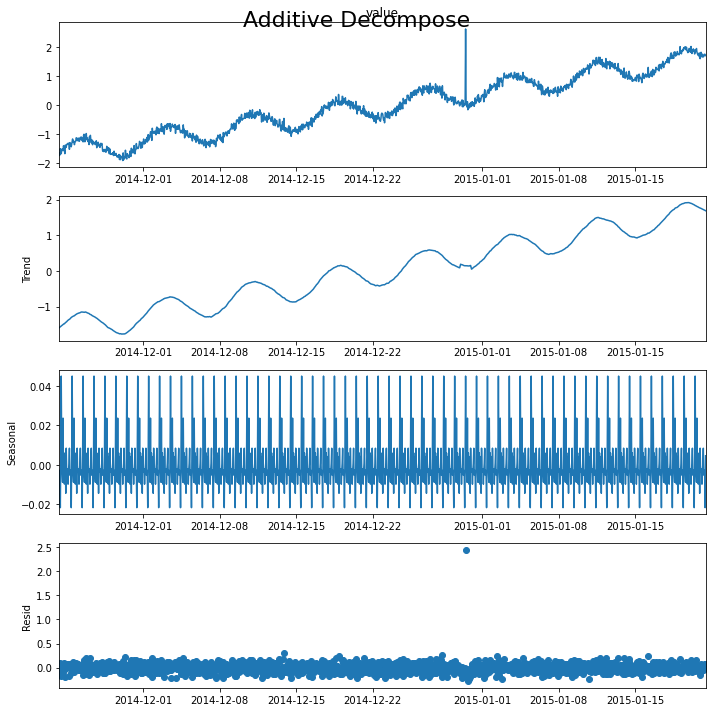



File: A2Benchmarksynthetic_30
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.638754           1
Detected outliers: 1
Outliers:
timestamp
2014-12-30 12:00:00    2.447457
Name: resid, dtype: float64
----------------
Mean: 959.394771, StandardDeviation: 1155.849408
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   394.123324           0
1    2014-11-23 08:00:00   -43.032020           0
2    2014-11-23 09:00:00   528.987760           0
3    2014-11-23 10:00:00   567.962720           0
4    2014-11-23 11:00:00   357.743117           0
...                  ...          ...         ...
1416 2015-01-21 07:00:00  1818.849690           0
1417 2015-01-21 08:00:00   878.892797           0
1418 2015-01-21 09:00:00  1841.014851           0
1419 2015-01-21 10:00:00  2366.046251           0
1420 2015-01-21 11:00:00  2068.291420           0

[1421 rows x 3 columns]


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_31add_STL


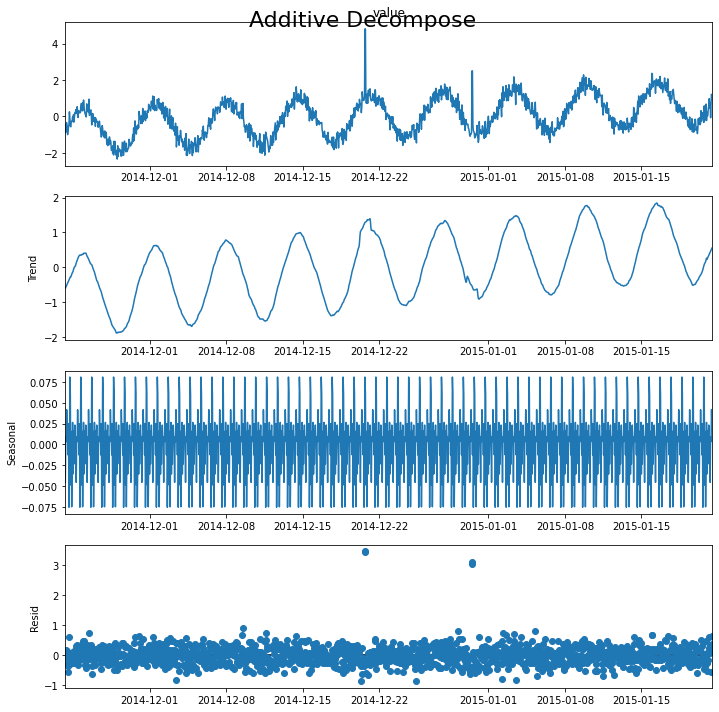



File: A2Benchmarksynthetic_31
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  4.810664           1
2014-12-20 18:00:00  4.810664           1
2014-12-30 12:00:00  2.504158           1
2014-12-30 13:00:00  2.504158           1
Detected outliers: 44
Outliers:
timestamp
2014-11-23 16:00:00    0.601638
2014-11-25 11:00:00    0.728642
2014-11-29 16:00:00    0.618920
2014-11-30 01:00:00    0.640955
2014-11-30 09:00:00    0.530632
2014-12-01 07:00:00    0.598285
2014-12-02 20:00:00    0.579578
2014-12-04 08:00:00    0.588821
2014-12-05 22:00:00    0.535320
2014-12-09 10:00:00    0.687937
2014-12-09 13:00:00    0.920031
2014-12-11 02:00:00    0.553476
2014-12-11 15:00:00    0.746885
2014-12-12 12:00:00    0.508204
2014-12-13 14:00:00    0.513233
2014-12-14 10:00:00    0.626519
2014-12-15 12:00:00    0.504377
2014-12-20 17:00:00    3.440724
2014-12-20 18:00:00    3.454416
2014-12-21 15:00:00    0.546483


C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_32add_STL


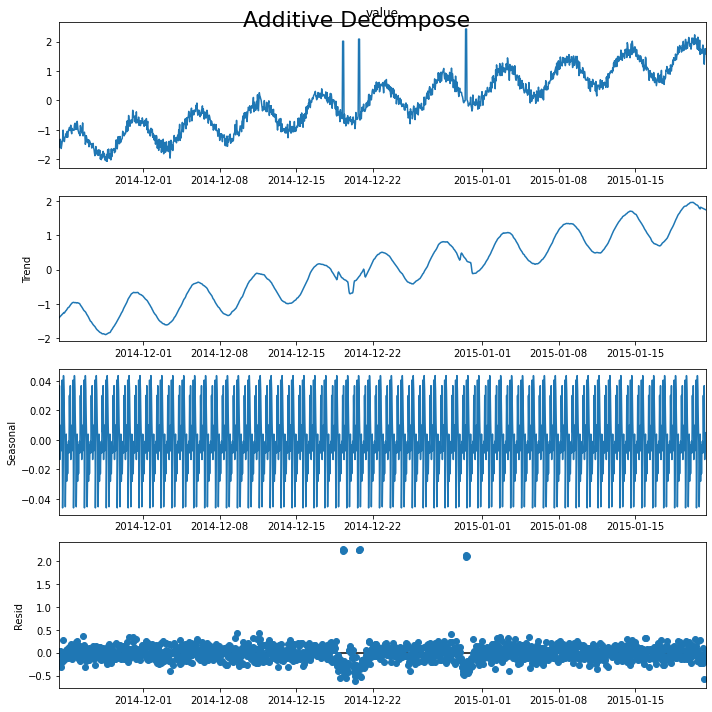



File: A2Benchmarksynthetic_32
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  2.011083           1
2014-12-19 07:00:00  2.011083           1
2014-12-19 08:00:00  2.011083           1
2014-12-20 17:00:00  2.082462           1
2014-12-20 18:00:00  2.082462           1
2014-12-20 19:00:00  2.082462           1
2014-12-30 12:00:00  2.426199           1
2014-12-30 13:00:00  2.426199           1
2014-12-30 14:00:00  2.426199           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    2.225130
2014-12-19 07:00:00    2.268422
2014-12-19 08:00:00    2.250446
2014-12-20 17:00:00    2.251123
2014-12-20 18:00:00    2.249546
2014-12-20 19:00:00    2.256528
2014-12-30 12:00:00    2.098356
2014-12-30 13:00:00    2.131279
2014-12-30 14:00:00    2.112369
Name: resid, dtype: float64
----------------
Mean: 533.967462, StandardDeviation: 1069.884522
               timestamp        value  is_anomaly

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_33add_STL


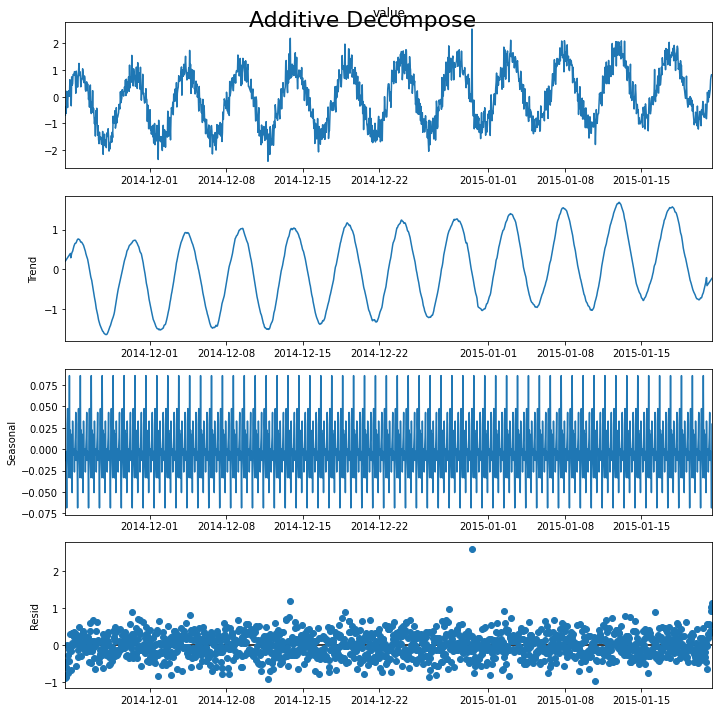



File: A2Benchmarksynthetic_33
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  2.540857           1
Detected outliers: 84
Outliers:
timestamp
2014-11-25 14:00:00    0.600060
2014-11-25 19:00:00    0.684625
2014-11-26 04:00:00    0.612549
2014-11-29 04:00:00    0.579407
2014-11-29 09:00:00    0.897084
                         ...   
2015-01-21 07:00:00    0.553591
2015-01-21 08:00:00    0.909445
2015-01-21 09:00:00    1.030441
2015-01-21 10:00:00    1.141206
2015-01-21 11:00:00    1.002848
Name: resid, Length: 84, dtype: float64
----------------
Mean: 2873.685166, StandardDeviation: 1957.027297
               timestamp        value  is_anomaly
0    2014-11-23 07:00:00   434.656572           0
1    2014-11-23 08:00:00   -19.688669           0
2    2014-11-23 09:00:00   632.288066           0
3    2014-11-23 10:00:00   699.399314           0
4    2014-11-23 11:00:00   492.677880           0
...    

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_34add_STL


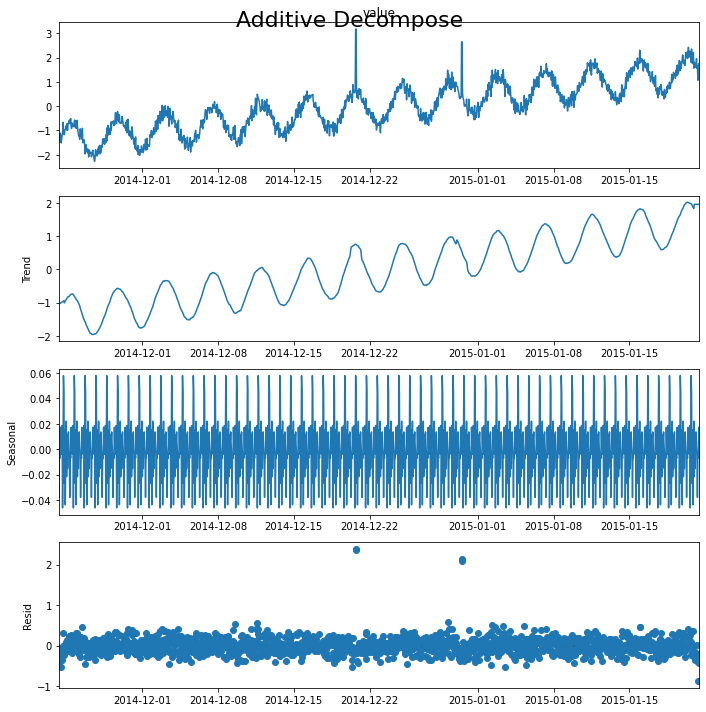



File: A2Benchmarksynthetic_34
threshold: 500
Actual Outliers: 4
                        value  is_anomaly
timestamp                                
2014-12-20 17:00:00  3.175623           1
2014-12-20 18:00:00  3.175623           1
2014-12-30 12:00:00  2.648310           1
2014-12-30 13:00:00  2.648310           1
Detected outliers: 8
Outliers:
timestamp
2014-12-09 13:00:00    0.528567
2014-12-11 15:00:00    0.564329
2014-12-20 17:00:00    2.363915
2014-12-20 18:00:00    2.387377
2014-12-29 05:00:00    0.569166
2014-12-30 12:00:00    2.076552
2014-12-30 13:00:00    2.133641
2015-01-02 08:00:00    0.513981
Name: resid, dtype: float64
----------------
Mean: 11410.899789, StandardDeviation: 7069.718250
               timestamp         value  is_anomaly
0    2014-11-23 07:00:00    458.901115           0
1    2014-11-23 08:00:00    -55.425325           0
2    2014-11-23 09:00:00    569.309498           0
3    2014-11-23 10:00:00    592.617923           0
4    2014-11-23 11:00:00    334.94

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_35add_STL


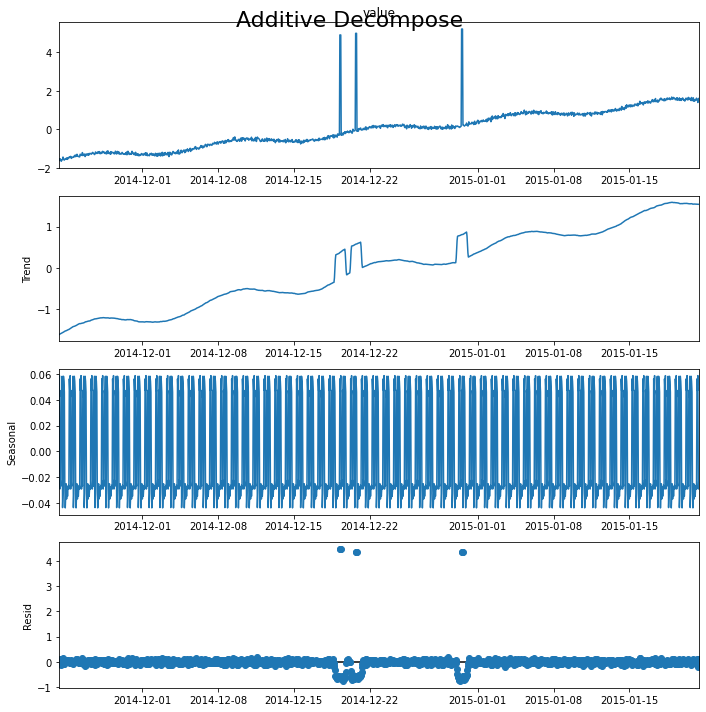



File: A2Benchmarksynthetic_35
threshold: 500
Actual Outliers: 9
                        value  is_anomaly
timestamp                                
2014-12-19 06:00:00  4.892303           1
2014-12-19 07:00:00  4.892303           1
2014-12-19 08:00:00  4.892303           1
2014-12-20 17:00:00  4.977022           1
2014-12-20 18:00:00  4.977022           1
2014-12-20 19:00:00  4.977022           1
2014-12-30 12:00:00  5.200080           1
2014-12-30 13:00:00  5.200080           1
2014-12-30 14:00:00  5.200080           1
Detected outliers: 9
Outliers:
timestamp
2014-12-19 06:00:00    4.465019
2014-12-19 07:00:00    4.468640
2014-12-19 08:00:00    4.449730
2014-12-20 17:00:00    4.346615
2014-12-20 18:00:00    4.347828
2014-12-20 19:00:00    4.352873
2014-12-30 12:00:00    4.349485
2014-12-30 13:00:00    4.351485
2014-12-30 14:00:00    4.334026
Name: resid, dtype: float64
----------------
Processing index: 30 of 100
Mean: 634.296881, StandardDeviation: 1095.076584
               timest

C:\Users\Sanke\anaconda3\lib\site-packages\pandas\core\indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)





A2Benchmark_A2Benchmarksynthetic_36add_STL


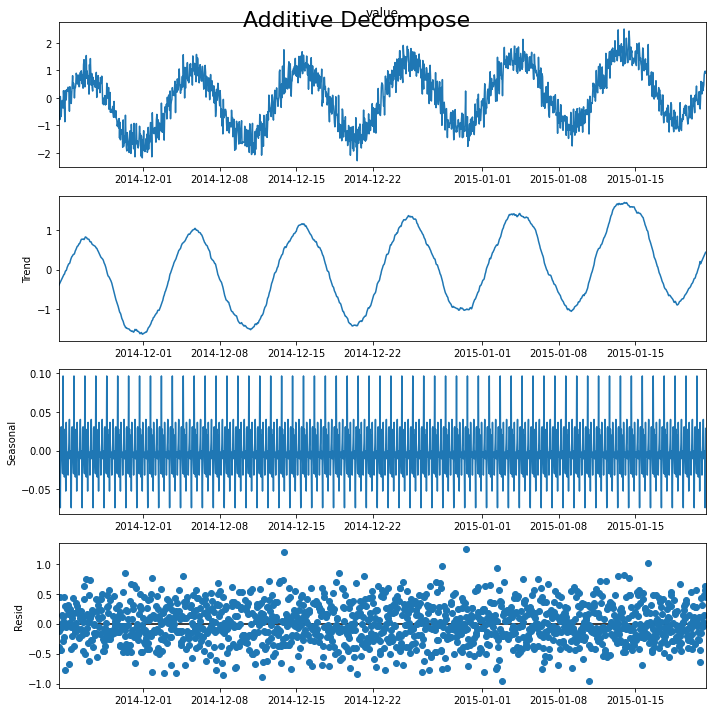



File: A2Benchmarksynthetic_36
threshold: 500
Actual Outliers: 1
                        value  is_anomaly
timestamp                                
2014-12-30 12:00:00  0.250416           1
Detected outliers: 93
Outliers:
timestamp
2014-11-25 14:00:00    0.634176
2014-11-25 19:00:00    0.753635
2014-11-26 04:00:00    0.723792
2014-11-27 20:00:00    0.567187
2014-11-29 04:00:00    0.522568
                         ...   
2015-01-19 03:00:00    0.663696
2015-01-20 03:00:00    0.530601
2015-01-20 15:00:00    0.569722
2015-01-21 09:00:00    0.560921
2015-01-21 10:00:00    0.631954
Name: resid, Length: 93, dtype: float64
----------------
STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:0:00:25.505655
[0.7272727272727273, 1.0, 1.0, 0.782608695652174, 0.25, 0.7272727272727273, 0.782608695652174, 0.6666666666666666, 0.7272727272727273, 0.6923076923076924, 1.0, 0.3076923076923077, 0.782608695652174, 1.0, 1.0, 0.3076923076923077, 0.782608695652174, 0.06666666

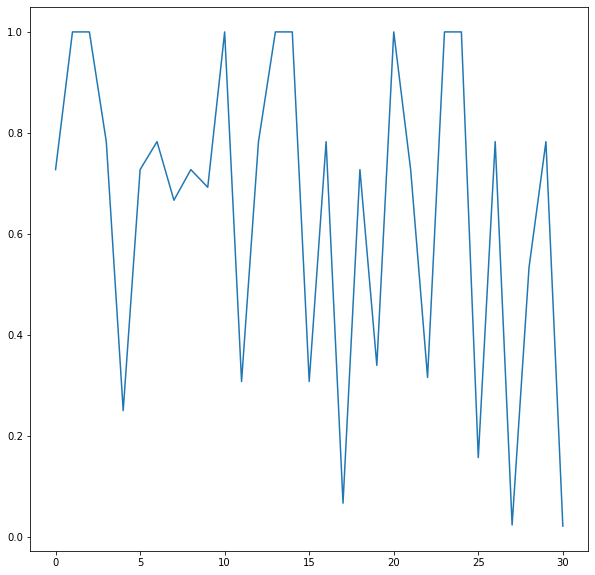

In [62]:
start_time = datetime.now() 
f1_plot = []
for index,file in enumerate(all_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
    if index > 30:
        break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    
    # prepare data for standardization
    values = df_indexed.copy()
    values = values.drop(columns=['is_anomaly'],axis=1)
    #values = values.reshape((len(values), 1))
    
    # train the standardization
    scaler2 = StandardScaler()
    scaler2 = scaler2.fit(values)
    print('Mean: %f, StandardDeviation: %f' % (scaler2.mean_, sqrt(scaler2.var_)))
    # standardize the dataset
    standardaized = scaler2.transform(values)
    
    #jugaad, should change so that standardized is used from here on.
    for i in range(len(df_indexed)):
        df_indexed['value'].iloc[i] = standardaized[i]
        
    print(df)
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    #plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A2Benchmark_" + fname +"add_STL")
    print("\n\n\nA2Benchmark_" + fname +"add_STL")
    plt.show()
    
    
    threshold=0.5
    
    residualdf = result_add.resid
    outliers = residualdf[residualdf > threshold]
    
    not_outliers = residualdf[residualdf < threshold]
    anomalies = df_indexed.join(outliers,on='timestamp',how='inner')
    not_anomalies = df_indexed.join(not_outliers,on='timestamp',how='inner')
    
    p = df_indexed.loc[df_indexed['is_anomaly'] == 1]
    
    n = df_indexed.loc[df_indexed['is_anomaly'] == 0]
    
    truepositives = anomalies.loc[anomalies['is_anomaly'] == 1]
    
    falsepositives = anomalies.loc[anomalies['is_anomaly'] == 0]
    
    truenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 0]
    
    falsenegatives = not_anomalies.loc[not_anomalies['is_anomaly'] == 1]
    
    #Traditional FPR and TPR formmulae
    #tpr = truepositives.count()/(truepositives.count() + falsenegatives.count())
    #fpr = falsepositives.count()/(falsepositives.count() + truenegatives.count())
    
    #IDEAL Paper based TRP/FPR rates
    fpr = len(falsepositives)/len(n)
    tpr = len(truepositives)/len(p)
    fnr = 1-tpr
    tnr = 1-fpr
    
    precision = len(truepositives)/(len(truepositives) + len(falsepositives))
    recall = len(truepositives)/(len(truepositives) + len(falsenegatives))
    
    f1 = 2 * (precision * recall)/(precision + recall)
    f1_plot.append(f1)
    
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        file.write("\n\n\n Statistics:")
        file.write(f"\ntrue positives:{len(truepositives)}")
        file.write(f"\nfalse positives:{len(falsepositives)}")
        file.write(f"\ntrue negatives:{len(truenegatives)}")
        file.write(f"\nfalse negatives:{len(falsenegatives)}")
        file.write(f"\nFPR:{fpr}")
        file.write(f"\nTPR:{tpr}")
        file.write(f"\nFNR:{fnr}")
        file.write(f"\nTNR:{tnr}")
        
        file.write(f"\nPrecision:{precision}")
        file.write(f"\nREcall:{recall}")
        file.write(f"\nF1:{f1}")
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Actual Outliers:", len(p))
    print(p)
    print("Detected outliers:", len(outliers))
    print("Outliers:")
    print(outliers)
    print("----------------")
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A2 Benchmark processing complete. Time taken:{end_time-start_time}")
print(f1_plot)
plt.plot(f1_plot)

In [63]:
print(sum(f1_plot)/len(f1_plot))

0.6455953436269912


In [64]:
residualdf.mean()

0.0008207124598037187

In [65]:
residualdf.std()

0.3302331716379146

In [ ]:
upper_threshold = residualdf.mean() + residualdf.std()
lower_threshold = residualdf.mean() - residualdf.std()
upper_threshold, lower_threshold

## A1 Folder - real Yahoo server traffic dataset

In [ ]:
a1_csv = glob.glob(f'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A1Benchmark/**/*.csv', recursive=True)
start_time = datetime.now() 
print(f'Loaded the paths of {len(a1_csv)} files from disk. Begin processing at: {start_time}')
for index,file in enumerate(a1_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(a1_csv)}')
    if index > 50:
         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A1Benchmark_" + fname +"_add_STL")
    print("\n\n\nA1Benchmark_" + fname +"_add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    outliers = residualdf[residualdf > threshold]
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A1 Benchmark processing complete. Time taken:{end_time-start_time}")

## A3 Folder - Synthetic data with outliers specified

In [ ]:
a3_csv = glob.glob(f'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A3Benchmark/A3Benchmark-TS*.csv', recursive=True)
start_time = datetime.now() 
for index,file in enumerate(a3_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(a3_csv)}')
    if index > 50:
         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A3Benchmark_" + fname +"_add_STL")
    print("\n\n\nA3Benchmark_" + fname +"_add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    outliers = residualdf[residualdf > threshold]
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A3 Benchmark processing complete. Time taken:{end_time-start_time}")

## A4 Folder - Synthetic data with outliers, changepoints and seasonalities.

In [ ]:
a4_csv = glob.glob(f'../data/yahoo/dataset/ydata-labeled-time-series-anomalies-v1_0/A3Benchmark/A4Benchmark-TS*.csv', recursive=True)
start_time = datetime.now() 
for index,file in enumerate(all_csv):
    if index%10 == 0:
        print(f'Processing index: {index} of {len(all_csv)}')
    if index > 50:
         break
    fname = file.split("/")[5].replace('\\','').split(".")[0]
    df = pd.read_csv(file)
    df['timestamp'] = pd.to_datetime(df['timestamp'],unit='s')
    df_indexed = df.set_index('timestamp')
    result_add = seasonal_decompose(df_indexed['value'], model='additive', extrapolate_trend='freq')
    # Plot
    plt.rcParams.update({'figure.figsize': (10,10)})
    result_add.plot().suptitle('Additive Decompose', fontsize=22)
    plt.savefig("./STLoutput/A4Benchmark_" + fname +"_add_STL")
    print("\n\n\nA4Benchmark_" + fname +"_add_STL")
    plt.show()
    threshold=500
    residualdf = result_add.resid
    outliers = residualdf[residualdf > threshold]
    with open("./STLoutput/"+ fname + ".txt", 'w') as file:
        file.write(f"\n\nFile: {fname}")
        file.write("\nthreshold: 500")
        file.write("\nOutliers:\n")
        file.write(outliers.to_csv())
        
        
    print(f"\n\nFile: {fname}")
    print("threshold: 500")
    print("Outliers:")
    print(outliers)
end_time=datetime.now()
print(f"STL Additive decomposition of Yahoo S5 A4 Benchmark processing complete. Time taken:{end_time-start_time}")

# Extracting useful features from Time-Series

it is possible to use and derive various features from time-series. we can use these features to compare time series and post-comparison: we can detect any anomalous records/subsequences.

![Image of Features](./img/features.png)

References 78 and 79 deal with this: 78 offers a comparison between time series using a combination of PCA on the abovementioned features and then uses a multidimensional outlier detection 

to be able to incorporate these features, we must first extract them. acc to the authors of [78], their code included on open source R package on CRAM to automatically extract all the abovementioned features. We can use this library in python via the rpy2 package 

In [ ]:
import rpy2
import rpy2.robjects as robjects
import rpy2.robjects.packages as rpackages
from rpy2.robjects.packages import importr
from rpy2.robjects import r, pandas2ri
import rpy2.robjects as ro
from rpy2.robjects.conversion import localconverter

In [ ]:
import rpy2
import rpy2.robjects.packages as rpackages
from rpy2.robjects.packages import importr
from rpy2.robjects import r, pandas2ri
import rpy2.robjects as ro
from rpy2.robjects.conversion import localconverter

def extract_features(timeseries):
    try:
        oddstream=importr('oddstream')
    except:
        ro.r(f'install.packages("oddstream")')
        oddstream = importr('oddstream')

    #r_timeseries = pandas2ri.py2ri(timeseries)
    with localconverter(ro.default_converter + pandas2ri.converter):
        for col in timeseries.columns.values:
            timeseries[col]=timeseries[col].astype(str) 
        #r_timeseries = ro.conversion.py2rpy(timeseries)
        features=oddstream.extract_tsfeatures(timeseries)
        #features= ro.conversion.rpy2py(features)
        return features
    return []


In [ ]:
df_indexed

In [ ]:
features = extract_features(df_indexed)
print(features)

This matrix contains all the needed values except Season, Peak, Trough, and Trend. We can try to get these 

In [ ]:
type(features)

In [ ]:
tsfeatures1  = pandas2ri.ri2py(features)
tsfeatures1

In the above array, the first row contains the values for the value column, and the second for the is_anomaly column

In [ ]:
type(pandas2ri.ri2py(features))

In [ ]:
tsfeatures1[0,0]

In [ ]:
result_add